In [1]:
import os
LOAD = False         # True = load previously saved model from disk?  False = (re)train the model
SAVE = "\_TFT_model_02.pth.tar"   # file name to save the model under

EPOCHS = 200
INLEN = 16          # input size
HIDDEN = 32         # hidden layers    
LSTMLAYERS = 2      # recurrent layers

ATTH = 2            # attention heads
BATCH = 64          # batch size
LEARN = 1e-3        # learning rate
DROPOUT = 0.1       # dropout rate
VALWAIT = 1         # epochs to wait before evaluating the loss on the test/validation set
N_FC = 2            # output size

RAND = 42           # random seed
N_SAMPLES = 100     # number of times a prediction is sampled from a probabilistic model
N_JOBS = -1          # parallel processors to use;  -1 = all processors

# default quantiles for QuantileRegression
QUANTILES = [0.01, 0.1, 0.2, 0.5, 0.8, 0.9, 0.99]

SPLIT = 0.9         # train/test %

FIGSIZE = (9, 6)


qL1, qL2 = 0.01, 0.10        # percentiles of predictions: lower bounds
qU1, qU2 = 1-qL1, 1-qL2,     # upper bounds derived from lower bounds
label_q1 = f'{int(qU1 * 100)} / {int(qL1 * 100)} percentile band'
label_q2 = f'{int(qU2 * 100)} / {int(qL2 * 100)} percentile band'

mpath = os.path.abspath(os.getcwd()) + SAVE     # path and file name to save the model

In [2]:
%matplotlib inline
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os
import sys
import missingno as mno

import warnings
warnings.filterwarnings("ignore")
import logging
logging.disable(logging.CRITICAL)


from darts import TimeSeries, concatenate
from darts.dataprocessing.transformers import Scaler
from darts.models import TransformerModel, NBEATSModel, TFTModel
from darts.metrics import mape, rmse, smape
from darts.utils.timeseries_generation import datetime_attribute_timeseries
from darts.utils.likelihood_models import QuantileRegression
from pytorch_lightning.callbacks.early_stopping import EarlyStopping

pd.set_option("display.precision",2)
np.set_printoptions(precision=2, suppress=True)
pd.options.display.float_format = '{:,.2f}'.format

In [3]:
import pandas as pd
xls = pd.ExcelFile('../../data_complete.xlsx')
df_radon={}
for key in ['48','9']:
    df_radon[key] = pd.read_excel(xls, key)
    df_radon[key] = df_radon[key].loc[(df_radon[key]['SyncDate']>='2022-8-10')]

In [4]:
df_radon.keys()

dict_keys(['48', '9'])

In [5]:
#using 21 as the example since it has the most data
df = df_radon['48']

In [6]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4163 entries, 0 to 4162
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     4163 non-null   object        
 1   DeviceName   4163 non-null   object        
 2   SyncDate     4163 non-null   datetime64[ns]
 3   Radon        4163 non-null   float64       
 4   eC02         4163 non-null   int64         
 5   VOC          4163 non-null   int64         
 6   Temperature  4163 non-null   int64         
 7   AirPressure  4163 non-null   float64       
 8   Humidity     4163 non-null   int64         
 9   LogIndex     4163 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 357.8+ KB


In [7]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [8]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:05:58,49,61,30.02,28.90
1,2023-02-11 16:05:58,56,53,30.08,25.40
2,2023-02-11 15:05:58,58,51,30.08,25.30
3,2023-02-11 14:05:58,57,51,30.13,25.30
4,2023-02-11 12:05:58,61,49,30.15,28.40
...,...,...,...,...,...
4158,2022-08-10 05:16:07,79,71,30.17,81.10
4159,2022-08-10 04:16:07,78,71,30.15,87.20
4160,2022-08-10 03:16:07,78,72,30.15,86.90
4161,2022-08-10 02:16:07,79,72,30.15,93.00


In [9]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [10]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,84.36,67.68,30.17,72.56
2022-08-11,84.54,67.96,30.11,77.36
2022-08-12,87.40,66.70,30.03,99.93
2022-08-13,85.67,65.33,30.08,53.24
2022-08-14,86.61,62.39,30.05,35.03
...,...,...,...,...
2023-02-07,61.57,45.22,30.27,0.68
2023-02-08,64.96,49.57,30.24,0.65
2023-02-09,63.95,59.23,30.13,0.78


In [11]:
df = df[df.index<= '2022-11-10']

In [12]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,84.36,67.68,30.17,72.56
2022-08-11,84.54,67.96,30.11,77.36
2022-08-12,87.40,66.70,30.03,99.93
2022-08-13,85.67,65.33,30.08,53.24
2022-08-14,86.61,62.39,30.05,35.03
...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57
2022-11-07,77.91,61.26,30.26,18.97
2022-11-08,76.00,57.38,30.32,27.45


In [13]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [14]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [15]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [16]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [17]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [18]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,84.36,67.68,30.17,72.56,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,84.54,67.96,30.11,77.36,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,87.40,66.70,30.03,99.93,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,85.67,65.33,30.08,53.24,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,86.61,62.39,30.05,35.03,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,77.91,61.26,30.26,18.97,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,76.00,57.38,30.32,27.45,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [19]:
df.dropna(inplace=True)

In [20]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,84.36,67.68,30.17,72.56,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,84.54,67.96,30.11,77.36,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,87.40,66.70,30.03,99.93,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,85.67,65.33,30.08,53.24,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,86.61,62.39,30.05,35.03,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,77.39,61.17,30.12,18.57,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,77.91,61.26,30.26,18.97,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,76.00,57.38,30.32,27.45,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [21]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [22]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [23]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,77.63,65.69,30.07,31.87,67.45,0.13,0.54,3.36,296.43,0.00,0.10,0.03,0.30,1.65,42.03,29.02,77.72,29.02,304.88,0.07
std,7.86,12.38,0.10,17.08,8.11,0.12,0.49,2.50,12.64,0.01,0.28,0.10,0.52,1.24,2.25,0.10,9.98,0.10,9.92,0.08
min,63.20,38.48,29.86,0.46,45.54,0.00,0.00,0.00,258.31,0.00,0.00,0.00,0.00,0.00,37.50,28.80,54.15,28.80,267.15,0.00
25%,71.17,58.95,30.01,22.04,61.25,0.02,0.19,1.87,288.74,0.00,0.00,0.00,0.00,0.14,40.48,28.95,70.64,28.95,298.27,0.01
50%,77.39,68.75,30.07,30.11,68.04,0.11,0.46,3.40,299.35,0.00,0.00,0.00,0.00,1.99,42.52,29.01,78.96,29.01,306.57,0.05
75%,84.57,75.79,30.13,35.80,75.01,0.20,0.75,4.45,305.92,0.00,0.04,0.00,0.34,2.09,43.96,29.08,85.25,29.08,312.89,0.10
max,89.57,84.20,30.34,99.93,78.23,0.53,2.44,10.24,317.34,0.06,1.79,0.74,1.91,5.11,44.87,29.29,95.93,29.29,319.39,0.37


In [24]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [25]:
df.fillna(0, inplace=True)

In [26]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Temperature,0.45
Outdoor h Temperature (°F),0.35
Humidity (%),0.29
Monthly Rain (in)_lag_1,0.29
...,...
Temperature_lag_23,-0.62
Humidity_lag_23,-0.63
Outdoor h Temperature (°F)_lag_23,-0.63
Yearly Rain (in)_lag_3,-0.63


In [27]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Temperature 0.44675920868759905
Outdoor h Temperature (°F) 0.34972987587752263
Humidity (%) 0.2930539271625921
Monthly Rain (in)_lag_1 0.2857739946574713
Monthly Rain (in) 0.26948965643507833
Avg Wind Direction (10 mins) (°) 0.25828568766295806
Hourly Rain (in/hr)_lag_2 0.2567713279400043
Event Rain (in)_lag_1 0.22856915717422302
Event Rain (in)_lag_2 0.22660025196419986
Wind Direction (°) 0.22124187914579804
Daily Rain (in)_lag_2 0.20217714410468574
Weekly Rain (in) 0.15411326296271688
Hourly Rain (in/hr)_lag_3 0.15114634130075696
Hourly Rain (in/hr)_lag_1 0.14195252405408845
Event Rain (in) 0.1404649655056779
Monthly Rain (in)_lag_2 0.14015862798479334
Daily Rain (in)_lag_1 0.1093128893813916
Event Rain (in)_lag_7 0.10191618951276368
Humidity (%)_lag_1 0.09989043183426365
Hourly Rain (in/hr)_lag_8 0.08623335973987847
Daily Rain (in)_lag_3 0.07680685630858945
Daily Rain (in)_lag_7 0.07491718673651498
Hourly Rain (in/hr)_lag_9 0.07240711564146511
Weekly Rain (in)_lag_1 0.0723

In [28]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.44]
df_corrH

,Radon
Radon,1.00
Temperature,0.45
Humidity_lag_5,-0.44
Wind Speed (mph)_lag_20,-0.44
Temperature_lag_9,-0.44
...,...
Temperature_lag_23,-0.62
Humidity_lag_23,-0.63
Outdoor h Temperature (°F)_lag_23,-0.63
Yearly Rain (in)_lag_3,-0.63


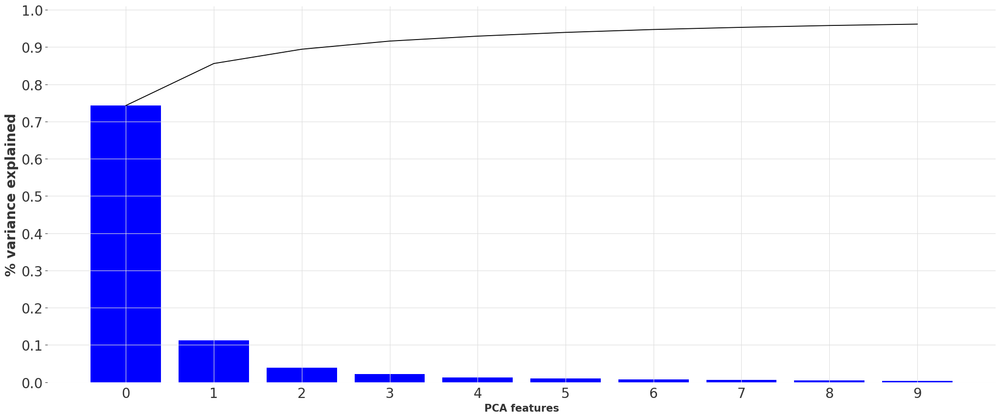

In [29]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=10)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [30]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9'],
      dtype='object')

In [31]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,0.61
pca5,0.30
pca3,0.16
pca9,0.14
pca2,0.11
pca1,-0.12
pca7,-0.15
pca6,-0.16


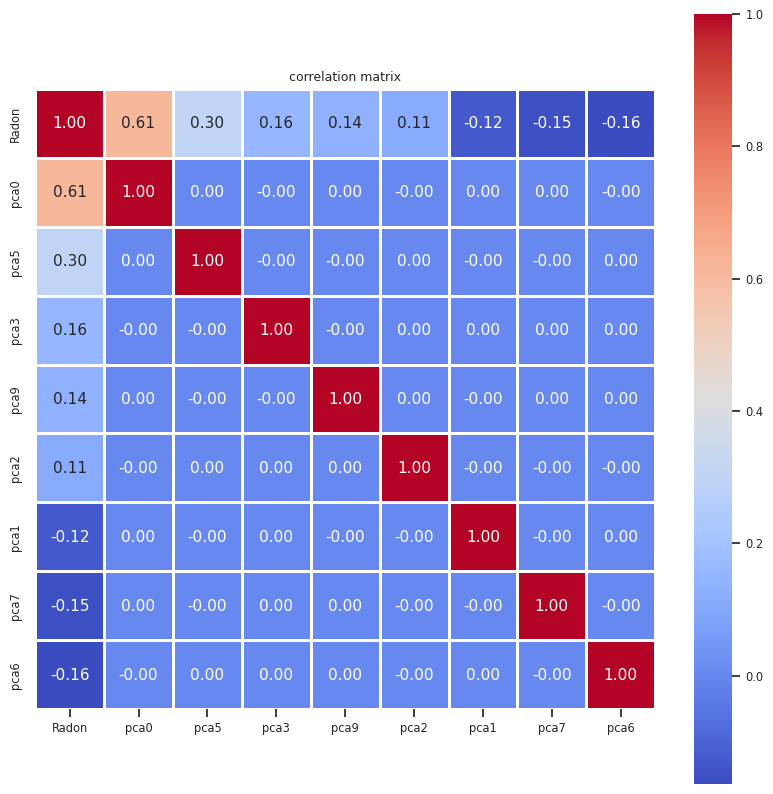

In [32]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [33]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Data columns (total 9 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
 2   pca5    93 non-null     float32
 3   pca3    93 non-null     float32
 4   pca9    93 non-null     float32
 5   pca2    93 non-null     float32
 6   pca1    93 non-null     float32
 7   pca7    93 non-null     float32
 8   pca6    93 non-null     float32
dtypes: float32(9)
memory usage: 4.0 KB


In [34]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [35]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0', 'pca5', 'pca3', 'pca9', 'pca2', 'pca1', 'pca7', 'pca6'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: False


In [36]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 8, 1)

In [37]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [38]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-08-10 00:00:00
training end: 2022-10-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-10-23 00:00:00
test end: 2022-11-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-08-10,0.72
2022-11-10,0.42


In [39]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0,pca5,pca3,pca9,pca2,pca1,pca7,pca6
SyncDate,,,,,,,,
2022-08-10,1.00,0.66,0.88,0.65,1.00,0.00,0.08,0.28
2022-11-10,0.09,1.08,0.50,0.61,0.42,0.36,0.43,0.61


In [40]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-08-10,0.72
2022-10-22,0.35


In [41]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [42]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [43]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [44]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-22 22:48:49 (running for 00:00:00.20)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |          lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+----------

(build_fit_tft_model pid=1014871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1014871)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1014871) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1014871)   rank_zero_deprecation(
(build_fit_tft_model pid=1014871) Auto select gpus: [0]
(build_fit_tft_model pid=1014871) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1014871) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1014871) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1014871) HPU available: False, using: 0 HPUs
(build_fit_tft

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_003e1a9e,2023-02-23_02-35-51,True,,dd8ae8d5b8644385b38a4c7ff410a61b,ip-172-31-10-87,40,0.101943,172.31.10.87,1298069,0.668044,15.0338,0.210167,15.0338,1677119751,0,,40,003e1a9e,0.00568962
build_fit_tft_model_008120a9,2023-02-23_00-39-40,True,,7b9a556816ec4591a5b990c853b8ee4e,ip-172-31-10-87,59,0.111005,172.31.10.87,1145471,0.259467,26.2784,0.328107,26.2784,1677112780,0,,59,008120a9,0.0151372
build_fit_tft_model_00a08964,2023-02-23_01-17-45,True,,c10c6c15ae5c46fa8502f5d9c5facfee,ip-172-31-10-87,20,0.115336,172.31.10.87,1193967,0.590461,12.699,0.238646,12.699,1677115065,0,,20,00a08964,0.00676084
build_fit_tft_model_00e7039b,2023-02-23_00-21-47,True,,92831eadcfc94ab6ba31ed10949b099c,ip-172-31-10-87,48,0.10487,172.31.10.87,1122722,0.342371,20.7668,0.309987,20.7668,1677111707,0,,48,00e7039b,0.0132186
build_fit_tft_model_012ab2b2,2023-02-22_23-26-27,True,,4a0b46746ba94d8180f691dac5e75e81,ip-172-31-10-87,20,0.168694,172.31.10.87,1050278,0.793384,12.2828,0.329954,12.2828,1677108387,0,,20,012ab2b2,0.00737572
build_fit_tft_model_02830b39,2023-02-23_00-55-01,True,,b893ca36c4c24ad78fdb7fbd6656bc65,ip-172-31-10-87,40,0.108687,172.31.10.87,1164696,0.495262,18.5973,0.311273,18.5973,1677113701,0,,40,02830b39,0.00836539
build_fit_tft_model_029eab58,2023-02-23_01-02-50,True,,68e182c017fc4e9187dcac7b2dd35a10,ip-172-31-10-87,10,0.342076,172.31.10.87,1175017,1.18196,9.67457,0.416953,9.67457,1677114170,0,,10,029eab58,0.00687838
build_fit_tft_model_02f68998,2023-02-23_01-52-01,True,,fd170985a59748d299355c15774cb7cd,ip-172-31-10-87,10,0.34386,172.31.10.87,1238528,1.02132,12.6591,0.395169,12.6591,1677117121,0,,10,02f68998,0.0104311
build_fit_tft_model_035ed08c,2023-02-23_01-13-01,True,,7a73621d20d04e80932f81c40bf27a14,ip-172-31-10-87,33,0.129791,172.31.10.87,1187818,0.412214,18.3616,0.313129,18.3616,1677114781,0,,33,035ed08c,0.0329981
build_fit_tft_model_03a7d115,2023-02-23_02-29-49,True,,422a790017814804876fc5c3b73203d1,ip-172-31-10-87,10,0.517377,172.31.10.87,1290658,1.03095,10.0749,0.354472,10.0749,1677119389,0,,10,03a7d115,0.00668311


== Status ==
Current time: 2023-02-22 22:49:01 (running for 00:00:12.30)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 294326db with sMAPE=1.7987760305404663 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.28910482422772904, 'lr': 0.0006580532541115066, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+----------------------+
| Trial name                   | status 

== Status ==
Current time: 2023-02-22 22:49:22 (running for 00:00:33.37)
Memory usage on this node: 5.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.2487558126449585 | Iter 10.000: -1.6942567825317383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 294326db with sMAPE=0.8637962341308594 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.28910482422772904, 'lr': 0.0006580532541115066, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+------------

(build_fit_tft_model pid=1015128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015128)   rank_zero_deprecation(
(build_fit_tft_model pid=1015128) Auto select gpus: [0]
(build_fit_tft_model pid=1015128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015128) 
(build_fit_tft_model pid=1015128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015128) ---------------

== Status ==
Current time: 2023-02-22 22:49:34 (running for 00:00:45.76)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.2487558126449585 | Iter 10.000: -1.6942567825317383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 294326db with sMAPE=0.8637962341308594 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.28910482422772904, 'lr': 0.0006580532541115066, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+-

(build_fit_tft_model pid=1015305) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015305)   rank_zero_deprecation(
(build_fit_tft_model pid=1015305) Auto select gpus: [0]
(build_fit_tft_model pid=1015305) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015305) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015305) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015305) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015305) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015305) 
(build_fit_tft_model pid=1015305)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015305) ---------------

== Status ==
Current time: 2023-02-22 22:49:58 (running for 00:01:09.15)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.017372488975525 | Iter 20.000: -1.1964349746704102 | Iter 10.000: -1.5408725142478943
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 294326db with sMAPE=0.8637962341308594 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 8, 'dropout': 0.28910482422772904, 'lr': 0.0006580532541115066, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+----------+--

== Status ==
Current time: 2023-02-22 22:50:18 (running for 00:01:29.79)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.1441141366958618 | Iter 10.000: -1.3874882459640503
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.35926318168640137 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1015552) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015552)   rank_zero_deprecation(
(build_fit_tft_model pid=1015552) Auto select gpus: [0]
(build_fit_tft_model pid=1015552) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015552) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015552) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015552) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015552) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015552) 
(build_fit_tft_model pid=1015552)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015552) ---------------

== Status ==
Current time: 2023-02-22 22:50:32 (running for 00:01:43.34)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.1441141366958618 | Iter 10.000: -1.3874882459640503
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1015739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1015739)   rank_zero_deprecation(
(build_fit_tft_model pid=1015739) Auto select gpus: [0]
(build_fit_tft_model pid=1015739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1015739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1015739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1015739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1015739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1015739) 
(build_fit_tft_model pid=1015739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1015739) ---------------

== Status ==
Current time: 2023-02-22 22:50:54 (running for 00:02:05.51)
Memory usage on this node: 7.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.8882385492324829 | Iter 20.000: -1.0817961692810059 | Iter 10.000: -1.2930123209953308
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:51:09 (running for 00:02:20.74)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.25193918496370316 | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.01947820186615 | Iter 10.000: -1.1985363960266113
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1016044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1016044)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1016044) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016044)   rank_zero_deprecation(
(build_fit_tft_model pid=1016044) Auto select gpus: [0]
(build_fit_tft_model pid=1016044) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016044) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016044) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016044) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:51:26 (running for 00:02:37.55)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.25193918496370316 | Iter 40.000: -0.7360420227050781 | Iter 20.000: -1.01947820186615 | Iter 10.000: -1.1985363960266113
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1016244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1016244)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1016244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016244)   rank_zero_deprecation(
(build_fit_tft_model pid=1016244) Auto select gpus: [0]
(build_fit_tft_model pid=1016244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016244) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:51:47 (running for 00:02:58.71)
Memory usage on this node: 6.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.25193918496370316 | Iter 40.000: -0.6726342737674713 | Iter 20.000: -0.8524190783500671 | Iter 10.000: -1.1659724712371826
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1016418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016418)   rank_zero_deprecation(
(build_fit_tft_model pid=1016418) Auto select gpus: [0]
(build_fit_tft_model pid=1016418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016418) 
(build_fit_tft_model pid=1016418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016418) ---------------

== Status ==
Current time: 2023-02-22 22:52:07 (running for 00:03:18.51)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.25193918496370316 | Iter 40.000: -0.6726342737674713 | Iter 20.000: -0.6853599548339844 | Iter 10.000: -1.133408546447754
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

== Status ==
Current time: 2023-02-22 22:52:22 (running for 00:03:33.78)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.25193918496370316 | Iter 40.000: -0.6092265248298645 | Iter 20.000: -0.647121012210846 | Iter 10.000: -0.9367873668670654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1016667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016667)   rank_zero_deprecation(
(build_fit_tft_model pid=1016667) Auto select gpus: [0]
(build_fit_tft_model pid=1016667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1016667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1016667) 
(build_fit_tft_model pid=1016667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1016667) ---------------

== Status ==
Current time: 2023-02-22 22:52:35 (running for 00:03:46.36)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.6092265248298645 | Iter 20.000: -0.647121012210846 | Iter 10.000: -0.9367873668670654
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:52:50 (running for 00:04:01.59)
Memory usage on this node: 6.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.533633217215538 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.7523611187934875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1016924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1016924)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1016924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1016924)   rank_zero_deprecation(
(build_fit_tft_model pid=1016924) Auto select gpus: [0]
(build_fit_tft_model pid=1016924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1016924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1016924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1016924) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:53:12 (running for 00:04:23.48)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.533633217215538 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.7523611187934875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

== Status ==
Current time: 2023-02-22 22:53:22 (running for 00:04:33.91)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.533633217215538 | Iter 20.000: -0.6046896278858185 | Iter 10.000: -0.7462636530399323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1017152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017152)   rank_zero_deprecation(
(build_fit_tft_model pid=1017152) Auto select gpus: [0]
(build_fit_tft_model pid=1017152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017152) 
(build_fit_tft_model pid=1017152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017152) ---------------

== Status ==
Current time: 2023-02-22 22:53:39 (running for 00:04:50.27)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6046896278858185 | Iter 10.000: -0.7462636530399323
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1017273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017273)   rank_zero_deprecation(
(build_fit_tft_model pid=1017273) Auto select gpus: [0]
(build_fit_tft_model pid=1017273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017273) 
(build_fit_tft_model pid=1017273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017273) ---------------

== Status ==
Current time: 2023-02-22 22:53:54 (running for 00:05:05.41)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6046896278858185 | Iter 10.000: -0.7523611187934875
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1017475) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017475)   rank_zero_deprecation(
(build_fit_tft_model pid=1017475) Auto select gpus: [0]
(build_fit_tft_model pid=1017475) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017475) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017475) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017475) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017475) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017475) 
(build_fit_tft_model pid=1017475)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017475) ---------------

== Status ==
Current time: 2023-02-22 22:54:07 (running for 00:05:18.51)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6046896278858185 | Iter 10.000: -0.9428848326206207
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 22:54:21 (running for 00:05:32.46)
Memory usage on this node: 4.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.496487632393837 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1017696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017696)   rank_zero_deprecation(
(build_fit_tft_model pid=1017696) Auto select gpus: [0]
(build_fit_tft_model pid=1017696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017696) 
(build_fit_tft_model pid=1017696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017696) ---------------

== Status ==
Current time: 2023-02-22 22:54:27 (running for 00:05:38.31)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.496487632393837 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1017815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017815)   rank_zero_deprecation(
(build_fit_tft_model pid=1017815) Auto select gpus: [0]
(build_fit_tft_model pid=1017815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017815) 
(build_fit_tft_model pid=1017815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017815) ---------------

== Status ==
Current time: 2023-02-22 22:54:40 (running for 00:05:51.42)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.496487632393837 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.9063603281974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1017982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1017982)   rank_zero_deprecation(
(build_fit_tft_model pid=1017982) Auto select gpus: [0]
(build_fit_tft_model pid=1017982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1017982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1017982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1017982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1017982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1017982) 
(build_fit_tft_model pid=1017982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1017982) ---------------

== Status ==
Current time: 2023-02-22 22:54:53 (running for 00:06:04.45)
Memory usage on this node: 6.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.496487632393837 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.9431436657905579
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-22 22:55:06 (running for 00:06:17.46)
Memory usage on this node: 4.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.9063603281974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1018152) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018152)   rank_zero_deprecation(
(build_fit_tft_model pid=1018152) Auto select gpus: [0]
(build_fit_tft_model pid=1018152) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018152) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018152) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018152) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018152) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018152) 
(build_fit_tft_model pid=1018152)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018152) ---------------

== Status ==
Current time: 2023-02-22 22:55:12 (running for 00:06:23.61)
Memory usage on this node: 7.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.9063603281974792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1018321) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018321)   rank_zero_deprecation(
(build_fit_tft_model pid=1018321) Auto select gpus: [0]
(build_fit_tft_model pid=1018321) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018321) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018321) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018321) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018321) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018321) 
(build_fit_tft_model pid=1018321)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018321) ---------------

== Status ==
Current time: 2023-02-22 22:55:28 (running for 00:06:39.36)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8930697441101074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018410) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018410)   rank_zero_deprecation(
(build_fit_tft_model pid=1018410) Auto select gpus: [0]
(build_fit_tft_model pid=1018410) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018410) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018410) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018410) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018410) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018410) 
(build_fit_tft_model pid=1018410)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018410) ---------------

== Status ==
Current time: 2023-02-22 22:55:44 (running for 00:06:55.43)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.881323367357254
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1018596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018596)   rank_zero_deprecation(
(build_fit_tft_model pid=1018596) Auto select gpus: [0]
(build_fit_tft_model pid=1018596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018596) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018596) 
(build_fit_tft_model pid=1018596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018596) ---------------

== Status ==
Current time: 2023-02-22 22:55:58 (running for 00:07:10.09)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5349353551864624 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:56:09 (running for 00:07:20.27)
Memory usage on this node: 7.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8550017178058624
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018831)   rank_zero_deprecation(
(build_fit_tft_model pid=1018831) Auto select gpus: [0]
(build_fit_tft_model pid=1018831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018831) 
(build_fit_tft_model pid=1018831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018831) ---------------

== Status ==
Current time: 2023-02-22 22:56:25 (running for 00:07:36.43)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8550017178058624
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1018998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1018998)   rank_zero_deprecation(
(build_fit_tft_model pid=1018998) Auto select gpus: [0]
(build_fit_tft_model pid=1018998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1018998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1018998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1018998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1018998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1018998) 
(build_fit_tft_model pid=1018998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1018998) ---------------

== Status ==
Current time: 2023-02-22 22:56:38 (running for 00:07:49.45)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019135) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019135)   rank_zero_deprecation(
(build_fit_tft_model pid=1019135) Auto select gpus: [0]
(build_fit_tft_model pid=1019135) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019135) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019135) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019135) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019135) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019135) 
(build_fit_tft_model pid=1019135)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019135) ---------------

== Status ==
Current time: 2023-02-22 22:56:53 (running for 00:08:04.35)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8672733306884766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019303)   rank_zero_deprecation(
(build_fit_tft_model pid=1019303) Auto select gpus: [0]
(build_fit_tft_model pid=1019303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019303) 
(build_fit_tft_model pid=1019303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019303) ---------------

== Status ==
Current time: 2023-02-22 22:57:06 (running for 00:08:17.39)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019470)   rank_zero_deprecation(
(build_fit_tft_model pid=1019470) Auto select gpus: [0]
(build_fit_tft_model pid=1019470) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019470) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019470) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019470) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019470) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019470) 
(build_fit_tft_model pid=1019470)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019470) ---------------

== Status ==
Current time: 2023-02-22 22:57:19 (running for 00:08:30.47)
Memory usage on this node: 5.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.881323367357254
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1019636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019636)   rank_zero_deprecation(
(build_fit_tft_model pid=1019636) Auto select gpus: [0]
(build_fit_tft_model pid=1019636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019636) 
(build_fit_tft_model pid=1019636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019636) ---------------

== Status ==
Current time: 2023-02-22 22:57:32 (running for 00:08:43.29)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5003595054149628 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8930697441101074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 22:57:42 (running for 00:08:53.38)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.881323367357254
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-------

(build_fit_tft_model pid=1019831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019831)   rank_zero_deprecation(
(build_fit_tft_model pid=1019831) Auto select gpus: [0]
(build_fit_tft_model pid=1019831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019831) 
(build_fit_tft_model pid=1019831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019831) ---------------

== Status ==
Current time: 2023-02-22 22:57:53 (running for 00:09:04.30)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.881323367357254
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1019998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1019998)   rank_zero_deprecation(
(build_fit_tft_model pid=1019998) Auto select gpus: [0]
(build_fit_tft_model pid=1019998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1019998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1019998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1019998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1019998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1019998) 
(build_fit_tft_model pid=1019998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1019998) ---------------

== Status ==
Current time: 2023-02-22 22:58:06 (running for 00:09:17.45)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8930697441101074
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020168) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020168)   rank_zero_deprecation(
(build_fit_tft_model pid=1020168) Auto select gpus: [0]
(build_fit_tft_model pid=1020168) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020168) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020168) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020168) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020168) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020168) 
(build_fit_tft_model pid=1020168)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020168) ---------------

== Status ==
Current time: 2023-02-22 22:58:22 (running for 00:09:33.64)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8910486698150635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:58:32 (running for 00:09:43.89)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:58:46 (running for 00:09:57.50)
Memory usage on this node: 4.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020430) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020430)   rank_zero_deprecation(
(build_fit_tft_model pid=1020430) Auto select gpus: [0]
(build_fit_tft_model pid=1020430) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020430) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020430) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020430) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020430) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020430) 
(build_fit_tft_model pid=1020430)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020430) ---------------

== Status ==
Current time: 2023-02-22 22:58:52 (running for 00:10:03.74)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020605) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020605)   rank_zero_deprecation(
(build_fit_tft_model pid=1020605) Auto select gpus: [0]
(build_fit_tft_model pid=1020605) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020605) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020605) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020605) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020605) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020605) 
(build_fit_tft_model pid=1020605)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020605) ---------------

== Status ==
Current time: 2023-02-22 22:59:05 (running for 00:10:16.84)
Memory usage on this node: 7.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8910486698150635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1020775)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1020775) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020775)   rank_zero_deprecation(
(build_fit_tft_model pid=1020775) Auto select gpus: [0]
(build_fit_tft_model pid=1020775) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020775) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020775) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020775) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 22:59:20 (running for 00:10:31.78)
Memory usage on this node: 7.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1020960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1020960)   rank_zero_deprecation(
(build_fit_tft_model pid=1020960) Auto select gpus: [0]
(build_fit_tft_model pid=1020960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1020960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1020960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1020960) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1020960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1020960) 
(build_fit_tft_model pid=1020960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1020960) ---------------

== Status ==
Current time: 2023-02-22 22:59:34 (running for 00:10:45.50)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8910486698150635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 22:59:48 (running for 00:10:59.50)
Memory usage on this node: 3.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021189) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021189)   rank_zero_deprecation(
(build_fit_tft_model pid=1021189) Auto select gpus: [0]
(build_fit_tft_model pid=1021189) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021189) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021189) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021189) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021189) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021189) 
(build_fit_tft_model pid=1021189)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021189) ---------------

== Status ==
Current time: 2023-02-22 22:59:54 (running for 00:11:05.69)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021354)   rank_zero_deprecation(
(build_fit_tft_model pid=1021354) Auto select gpus: [0]
(build_fit_tft_model pid=1021354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021354) 
(build_fit_tft_model pid=1021354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021354) ---------------

== Status ==
Current time: 2023-02-22 23:00:08 (running for 00:11:19.69)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8910486698150635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:00:22 (running for 00:11:33.51)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.48511677980422974 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1021547) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021547)   rank_zero_deprecation(
(build_fit_tft_model pid=1021547) Auto select gpus: [0]
(build_fit_tft_model pid=1021547) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021547) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021547) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021547) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1021547) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1021547) 
(build_fit_tft_model pid=1021547)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1021547) ---------------

== Status ==
Current time: 2023-02-22 23:00:28 (running for 00:11:39.68)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.48511677980422974 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:00:42 (running for 00:11:53.50)
Memory usage on this node: 4.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1021761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1021761)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1021761) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021761)   rank_zero_deprecation(
(build_fit_tft_model pid=1021761) Auto select gpus: [0]
(build_fit_tft_model pid=1021761) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021761) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021761) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021761) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:00:48 (running for 00:11:59.49)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:01:00 (running for 00:12:11.51)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1021956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1021956)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1021956) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1021956)   rank_zero_deprecation(
(build_fit_tft_model pid=1021956) Auto select gpus: [0]
(build_fit_tft_model pid=1021956) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1021956) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1021956) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1021956) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:01:06 (running for 00:12:17.40)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022124)   rank_zero_deprecation(
(build_fit_tft_model pid=1022124) Auto select gpus: [0]
(build_fit_tft_model pid=1022124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022124) 
(build_fit_tft_model pid=1022124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022124) ---------------

== Status ==
Current time: 2023-02-22 23:01:20 (running for 00:12:31.65)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022295)   rank_zero_deprecation(
(build_fit_tft_model pid=1022295) Auto select gpus: [0]
(build_fit_tft_model pid=1022295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022295) 
(build_fit_tft_model pid=1022295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022295) ---------------

== Status ==
Current time: 2023-02-22 23:01:35 (running for 00:12:46.70)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:01:46 (running for 00:12:57.25)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1022517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1022517)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1022517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022517)   rank_zero_deprecation(
(build_fit_tft_model pid=1022517) Auto select gpus: [0]
(build_fit_tft_model pid=1022517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022517) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:02:00 (running for 00:13:11.66)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:02:12 (running for 00:13:23.51)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022711) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022711)   rank_zero_deprecation(
(build_fit_tft_model pid=1022711) Auto select gpus: [0]
(build_fit_tft_model pid=1022711) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022711) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022711) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022711) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022711) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022711) 
(build_fit_tft_model pid=1022711)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022711) ---------------

== Status ==
Current time: 2023-02-22 23:02:18 (running for 00:13:29.53)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1022854) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1022854)   rank_zero_deprecation(
(build_fit_tft_model pid=1022854) Auto select gpus: [0]
(build_fit_tft_model pid=1022854) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1022854) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1022854) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1022854) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1022854) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1022854) 
(build_fit_tft_model pid=1022854)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1022854) ---------------

== Status ==
Current time: 2023-02-22 23:02:32 (running for 00:13:43.36)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1023049) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023049)   rank_zero_deprecation(
(build_fit_tft_model pid=1023049) Auto select gpus: [0]
(build_fit_tft_model pid=1023049) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023049) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023049) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023049) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023049) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023049) 
(build_fit_tft_model pid=1023049)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023049) ---------------

== Status ==
Current time: 2023-02-22 23:02:45 (running for 00:13:56.43)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:02:57 (running for 00:14:08.54)
Memory usage on this node: 4.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5044499039649963 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1023221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023221)   rank_zero_deprecation(
(build_fit_tft_model pid=1023221) Auto select gpus: [0]
(build_fit_tft_model pid=1023221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023221) 
(build_fit_tft_model pid=1023221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023221) ---------------

== Status ==
Current time: 2023-02-22 23:03:03 (running for 00:14:14.49)
Memory usage on this node: 6.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5044499039649963 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1023386) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023386)   rank_zero_deprecation(
(build_fit_tft_model pid=1023386) Auto select gpus: [0]
(build_fit_tft_model pid=1023386) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023386) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023386) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023386) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023386) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023386) 
(build_fit_tft_model pid=1023386)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023386) ---------------

== Status ==
Current time: 2023-02-22 23:03:16 (running for 00:14:27.41)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5044499039649963 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1023524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023524)   rank_zero_deprecation(
(build_fit_tft_model pid=1023524) Auto select gpus: [0]
(build_fit_tft_model pid=1023524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023524) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023524) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023524) 
(build_fit_tft_model pid=1023524)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023524) ---------------

== Status ==
Current time: 2023-02-22 23:03:29 (running for 00:14:40.54)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5044499039649963 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8910486698150635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1023717) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023717)   rank_zero_deprecation(
(build_fit_tft_model pid=1023717) Auto select gpus: [0]
(build_fit_tft_model pid=1023717) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023717) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023717) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023717) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023717) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023717) 
(build_fit_tft_model pid=1023717)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023717) ---------------

== Status ==
Current time: 2023-02-22 23:03:44 (running for 00:14:55.39)
Memory usage on this node: 5.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5044499039649963 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:03:57 (running for 00:15:08.53)
Memory usage on this node: 4.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1023895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1023895)   rank_zero_deprecation(
(build_fit_tft_model pid=1023895) Auto select gpus: [0]
(build_fit_tft_model pid=1023895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1023895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1023895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1023895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1023895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1023895) 
(build_fit_tft_model pid=1023895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1023895) ---------------

== Status ==
Current time: 2023-02-22 23:04:03 (running for 00:15:14.47)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1024061) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024061)   rank_zero_deprecation(
(build_fit_tft_model pid=1024061) Auto select gpus: [0]
(build_fit_tft_model pid=1024061) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024061) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024061) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024061) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024061) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024061) 
(build_fit_tft_model pid=1024061)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024061) ---------------

== Status ==
Current time: 2023-02-22 23:04:16 (running for 00:15:27.43)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.582852303981781 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1024226) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024226)   rank_zero_deprecation(
(build_fit_tft_model pid=1024226) Auto select gpus: [0]
(build_fit_tft_model pid=1024226) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024226) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024226) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024226) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024226) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024226) 
(build_fit_tft_model pid=1024226)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024226) ---------------

== Status ==
Current time: 2023-02-22 23:04:31 (running for 00:15:42.33)
Memory usage on this node: 6.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1024400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024400)   rank_zero_deprecation(
(build_fit_tft_model pid=1024400) Auto select gpus: [0]
(build_fit_tft_model pid=1024400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024400) 
(build_fit_tft_model pid=1024400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024400) ---------------

== Status ==
Current time: 2023-02-22 23:04:47 (running for 00:15:58.55)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1024570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024570)   rank_zero_deprecation(
(build_fit_tft_model pid=1024570) Auto select gpus: [0]
(build_fit_tft_model pid=1024570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024570) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024570) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024570) 
(build_fit_tft_model pid=1024570)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024570) ---------------

== Status ==
Current time: 2023-02-22 23:05:00 (running for 00:16:11.58)
Memory usage on this node: 7.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1024739) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024739)   rank_zero_deprecation(
(build_fit_tft_model pid=1024739) Auto select gpus: [0]
(build_fit_tft_model pid=1024739) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024739) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024739) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024739) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024739) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024739) 
(build_fit_tft_model pid=1024739)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024739) ---------------

== Status ==
Current time: 2023-02-22 23:05:15 (running for 00:16:26.64)
Memory usage on this node: 7.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1024906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1024906)   rank_zero_deprecation(
(build_fit_tft_model pid=1024906) Auto select gpus: [0]
(build_fit_tft_model pid=1024906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1024906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1024906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1024906) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1024906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1024906) 
(build_fit_tft_model pid=1024906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1024906) ---------------

== Status ==
Current time: 2023-02-22 23:05:28 (running for 00:16:39.60)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:05:38 (running for 00:16:49.76)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1025123) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025123)   rank_zero_deprecation(
(build_fit_tft_model pid=1025123) Auto select gpus: [0]
(build_fit_tft_model pid=1025123) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025123) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025123) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025123) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025123) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025123) 
(build_fit_tft_model pid=1025123)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025123) ---------------

== Status ==
Current time: 2023-02-22 23:05:54 (running for 00:17:05.63)
Memory usage on this node: 7.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1025289) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025289)   rank_zero_deprecation(
(build_fit_tft_model pid=1025289) Auto select gpus: [0]
(build_fit_tft_model pid=1025289) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025289) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025289) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025289) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025289) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025289) 
(build_fit_tft_model pid=1025289)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025289) ---------------

== Status ==
Current time: 2023-02-22 23:06:08 (running for 00:17:20.04)
Memory usage on this node: 7.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1025458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025458)   rank_zero_deprecation(
(build_fit_tft_model pid=1025458) Auto select gpus: [0]
(build_fit_tft_model pid=1025458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025458) 
(build_fit_tft_model pid=1025458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025458) ---------------

== Status ==
Current time: 2023-02-22 23:06:22 (running for 00:17:33.59)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1025619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025619)   rank_zero_deprecation(
(build_fit_tft_model pid=1025619) Auto select gpus: [0]
(build_fit_tft_model pid=1025619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025619) 
(build_fit_tft_model pid=1025619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025619) ---------------

== Status ==
Current time: 2023-02-22 23:06:37 (running for 00:17:48.58)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1025789) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025789)   rank_zero_deprecation(
(build_fit_tft_model pid=1025789) Auto select gpus: [0]
(build_fit_tft_model pid=1025789) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025789) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025789) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025789) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025789) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025789) 
(build_fit_tft_model pid=1025789)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025789) ---------------

== Status ==
Current time: 2023-02-22 23:06:50 (running for 00:18:01.43)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8890275955200195
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1025960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1025960)   rank_zero_deprecation(
(build_fit_tft_model pid=1025960) Auto select gpus: [0]
(build_fit_tft_model pid=1025960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1025960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1025960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1025960) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1025960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1025960) 
(build_fit_tft_model pid=1025960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1025960) ---------------

== Status ==
Current time: 2023-02-22 23:07:05 (running for 00:18:16.61)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8793022930622101
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026105) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026105)   rank_zero_deprecation(
(build_fit_tft_model pid=1026105) Auto select gpus: [0]
(build_fit_tft_model pid=1026105) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026105) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026105) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026105) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026105) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026105) 
(build_fit_tft_model pid=1026105)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026105) ---------------

== Status ==
Current time: 2023-02-22 23:07:21 (running for 00:18:32.56)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:07:33 (running for 00:18:44.57)
Memory usage on this node: 4.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026222) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026222)   rank_zero_deprecation(
(build_fit_tft_model pid=1026222) Auto select gpus: [0]
(build_fit_tft_model pid=1026222) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026222) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026222) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026222) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026222) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026222) 
(build_fit_tft_model pid=1026222)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026222) ---------------

== Status ==
Current time: 2023-02-22 23:07:39 (running for 00:18:50.44)
Memory usage on this node: 6.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:07:49 (running for 00:19:00.52)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----

(build_fit_tft_model pid=1026396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026396)   rank_zero_deprecation(
(build_fit_tft_model pid=1026396) Auto select gpus: [0]
(build_fit_tft_model pid=1026396) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026396) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026396) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026396) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026396) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026396) 
(build_fit_tft_model pid=1026396)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026396) ---------------

== Status ==
Current time: 2023-02-22 23:08:00 (running for 00:19:11.73)
Memory usage on this node: 7.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026563) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026563)   rank_zero_deprecation(
(build_fit_tft_model pid=1026563) Auto select gpus: [0]
(build_fit_tft_model pid=1026563) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026563) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026563) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026563) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026563) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026563) 
(build_fit_tft_model pid=1026563)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026563) ---------------

== Status ==
Current time: 2023-02-22 23:08:14 (running for 00:19:25.87)
Memory usage on this node: 8.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026731)   rank_zero_deprecation(
(build_fit_tft_model pid=1026731) Auto select gpus: [0]
(build_fit_tft_model pid=1026731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026731) 
(build_fit_tft_model pid=1026731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026731) ---------------

== Status ==
Current time: 2023-02-22 23:08:28 (running for 00:19:39.51)
Memory usage on this node: 6.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1026891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1026891)   rank_zero_deprecation(
(build_fit_tft_model pid=1026891) Auto select gpus: [0]
(build_fit_tft_model pid=1026891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1026891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1026891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1026891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1026891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1026891) 
(build_fit_tft_model pid=1026891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1026891) ---------------

== Status ==
Current time: 2023-02-22 23:08:44 (running for 00:19:55.73)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:08:57 (running for 00:20:08.57)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1027070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1027070)   rank_zero_deprecation(
(build_fit_tft_model pid=1027070) Auto select gpus: [0]
(build_fit_tft_model pid=1027070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1027070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1027070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1027070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1027070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1027070) 
(build_fit_tft_model pid=1027070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1027070) ---------------

== Status ==
Current time: 2023-02-22 23:09:03 (running for 00:20:14.68)
Memory usage on this node: 6.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:09:13 (running for 00:20:25.08)
Memory usage on this node: 6.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:09:24 (running for 00:20:35.33)
Memory usage on this node: 8.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1028009) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028009)   rank_zero_deprecation(
(build_fit_tft_model pid=1028009) Auto select gpus: [0]
(build_fit_tft_model pid=1028009) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028009) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028009) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028009) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028009) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028009) 
(build_fit_tft_model pid=1028009)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028009) ---------------

== Status ==
Current time: 2023-02-22 23:09:39 (running for 00:20:50.42)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1028146) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028146)   rank_zero_deprecation(
(build_fit_tft_model pid=1028146) Auto select gpus: [0]
(build_fit_tft_model pid=1028146) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028146) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028146) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028146) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028146) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028146) 
(build_fit_tft_model pid=1028146)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028146) ---------------

== Status ==
Current time: 2023-02-22 23:09:55 (running for 00:21:06.13)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1028420) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028420)   rank_zero_deprecation(
(build_fit_tft_model pid=1028420) Auto select gpus: [0]
(build_fit_tft_model pid=1028420) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028420) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028420) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028420) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028420) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028420) 
(build_fit_tft_model pid=1028420)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028420) ---------------

== Status ==
Current time: 2023-02-22 23:10:09 (running for 00:21:20.49)
Memory usage on this node: 7.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1028660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028660)   rank_zero_deprecation(
(build_fit_tft_model pid=1028660) Auto select gpus: [0]
(build_fit_tft_model pid=1028660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028660) 
(build_fit_tft_model pid=1028660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028660) ---------------

== Status ==
Current time: 2023-02-22 23:10:24 (running for 00:21:35.28)
Memory usage on this node: 9.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8695769906044006
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1028885) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1028885)   rank_zero_deprecation(
(build_fit_tft_model pid=1028885) Auto select gpus: [0]
(build_fit_tft_model pid=1028885) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1028885) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1028885) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1028885) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1028885) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1028885) 
(build_fit_tft_model pid=1028885)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1028885) ---------------

== Status ==
Current time: 2023-02-22 23:10:39 (running for 00:21:51.08)
Memory usage on this node: 9.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8682094514369965
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-22 23:10:53 (running for 00:22:04.60)
Memory usage on this node: 5.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1029141) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029141)   rank_zero_deprecation(
(build_fit_tft_model pid=1029141) Auto select gpus: [0]
(build_fit_tft_model pid=1029141) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029141) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029141) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029141) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029141) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029141) 
(build_fit_tft_model pid=1029141)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029141) ---------------

== Status ==
Current time: 2023-02-22 23:11:00 (running for 00:22:11.14)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8668419122695923
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1029380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1029380)   rank_zero_deprecation(
(build_fit_tft_model pid=1029380) Auto select gpus: [0]
(build_fit_tft_model pid=1029380) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1029380) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1029380) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1029380) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1029380) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1029380) 
(build_fit_tft_model pid=1029380)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1029380) ---------------

== Status ==
Current time: 2023-02-22 23:11:20 (running for 00:22:31.14)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:11:30 (running for 00:22:41.64)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1030388) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030388)   rank_zero_deprecation(
(build_fit_tft_model pid=1030388) Auto select gpus: [0]
(build_fit_tft_model pid=1030388) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030388) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030388) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030388) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030388) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030388) 
(build_fit_tft_model pid=1030388)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030388) ---------------

== Status ==
Current time: 2023-02-22 23:11:38 (running for 00:22:49.21)
Memory usage on this node: 8.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1030772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1030772)   rank_zero_deprecation(
(build_fit_tft_model pid=1030772) Auto select gpus: [0]
(build_fit_tft_model pid=1030772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1030772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1030772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1030772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1030772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1030772) 
(build_fit_tft_model pid=1030772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1030772) ---------------

== Status ==
Current time: 2023-02-22 23:11:58 (running for 00:23:09.36)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:12:09 (running for 00:23:20.65)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1031770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1031770)   rank_zero_deprecation(
(build_fit_tft_model pid=1031770) Auto select gpus: [0]
(build_fit_tft_model pid=1031770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1031770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1031770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1031770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1031770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1031770) 
(build_fit_tft_model pid=1031770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1031770) ---------------

== Status ==
Current time: 2023-02-22 23:12:18 (running for 00:23:29.86)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1032114) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1032114)   rank_zero_deprecation(
(build_fit_tft_model pid=1032114) Auto select gpus: [0]
(build_fit_tft_model pid=1032114) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1032114) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1032114) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1032114) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1032114) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1032114) 
(build_fit_tft_model pid=1032114)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1032114) ---------------

== Status ==
Current time: 2023-02-22 23:12:38 (running for 00:23:49.91)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8659057915210724
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:12:50 (running for 00:24:01.66)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1033257) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033257)   rank_zero_deprecation(
(build_fit_tft_model pid=1033257) Auto select gpus: [0]
(build_fit_tft_model pid=1033257) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033257) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033257) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033257) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033257) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033257) 
(build_fit_tft_model pid=1033257)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033257) ---------------

== Status ==
Current time: 2023-02-22 23:13:00 (running for 00:24:11.98)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:13:13 (running for 00:24:24.65)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1033677) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1033677)   rank_zero_deprecation(
(build_fit_tft_model pid=1033677) Auto select gpus: [0]
(build_fit_tft_model pid=1033677) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1033677) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1033677) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1033677) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1033677) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1033677) 
(build_fit_tft_model pid=1033677)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1033677) ---------------

== Status ==
Current time: 2023-02-22 23:13:27 (running for 00:24:38.44)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:13:37 (running for 00:24:48.75)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:13:51 (running for 00:25:02.66)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1034432) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034432)   rank_zero_deprecation(
(build_fit_tft_model pid=1034432) Auto select gpus: [0]
(build_fit_tft_model pid=1034432) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034432) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034432) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034432) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034432) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034432) 
(build_fit_tft_model pid=1034432)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034432) ---------------

== Status ==
Current time: 2023-02-22 23:14:02 (running for 00:25:13.59)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:14:14 (running for 00:25:25.68)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8442916572093964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1034930) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1034930)   rank_zero_deprecation(
(build_fit_tft_model pid=1034930) Auto select gpus: [0]
(build_fit_tft_model pid=1034930) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1034930) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1034930) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1034930) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1034930) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1034930) 
(build_fit_tft_model pid=1034930)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1034930) ---------------

== Status ==
Current time: 2023-02-22 23:14:26 (running for 00:25:37.13)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8442916572093964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1035460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035460)   rank_zero_deprecation(
(build_fit_tft_model pid=1035460) Auto select gpus: [0]
(build_fit_tft_model pid=1035460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035460) 
(build_fit_tft_model pid=1035460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035460) ---------------

== Status ==
Current time: 2023-02-22 23:14:45 (running for 00:25:56.85)
Memory usage on this node: 10.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1035891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1035891)   rank_zero_deprecation(
(build_fit_tft_model pid=1035891) Auto select gpus: [0]
(build_fit_tft_model pid=1035891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1035891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1035891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1035891) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1035891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1035891) 
(build_fit_tft_model pid=1035891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1035891) ---------------

== Status ==
Current time: 2023-02-22 23:15:06 (running for 00:26:17.41)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1036422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1036422)   rank_zero_deprecation(
(build_fit_tft_model pid=1036422) Auto select gpus: [0]
(build_fit_tft_model pid=1036422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1036422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1036422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1036422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1036422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1036422) 
(build_fit_tft_model pid=1036422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1036422) ---------------

== Status ==
Current time: 2023-02-22 23:15:27 (running for 00:26:38.87)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8649696707725525
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:15:38 (running for 00:26:49.22)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:15:48 (running for 00:26:59.34)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eb7a3cf4 with sMAPE=0.2099122554063797 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.462317090149832, 'lr': 0.01213669820987984, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1037334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037334)   rank_zero_deprecation(
(build_fit_tft_model pid=1037334) Auto select gpus: [0]
(build_fit_tft_model pid=1037334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037334) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037334) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037334) 
(build_fit_tft_model pid=1037334)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037334) ---------------

== Status ==
Current time: 2023-02-22 23:16:09 (running for 00:27:20.18)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8559786677360535
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:16:21 (running for 00:27:32.73)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1037940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1037940)   rank_zero_deprecation(
(build_fit_tft_model pid=1037940) Auto select gpus: [0]
(build_fit_tft_model pid=1037940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1037940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1037940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1037940) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1037940) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1037940) 
(build_fit_tft_model pid=1037940)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1037940) ---------------

== Status ==
Current time: 2023-02-22 23:16:32 (running for 00:27:43.54)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6140700578689575 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:16:42 (running for 00:27:53.88)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8442916572093964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1038570) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1038570)   rank_zero_deprecation(
(build_fit_tft_model pid=1038570) Auto select gpus: [0]
(build_fit_tft_model pid=1038570) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1038570) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1038570) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1038570) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1038570) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1038570) 
(build_fit_tft_model pid=1038570)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1038570) ---------------

== Status ==
Current time: 2023-02-22 23:17:02 (running for 00:28:13.64)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6114760637283325 | Iter 10.000: -0.8442916572093964
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:17:12 (running for 00:28:24.01)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:17:22 (running for 00:28:34.08)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3406321853399277 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 085e001a with sMAPE=0.2425096035003662 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.42462467394627856, 'lr': 0.016110268113099065, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-22 23:17:33 (running for 00:28:44.56)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.19324147701263428 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:17:47 (running for 00:28:58.79)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1039691) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1039691)   rank_zero_deprecation(
(build_fit_tft_model pid=1039691) Auto select gpus: [0]
(build_fit_tft_model pid=1039691) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1039691) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1039691) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1039691) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1039691) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1039691) 
(build_fit_tft_model pid=1039691)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1039691) ---------------

== Status ==
Current time: 2023-02-22 23:17:58 (running for 00:29:09.29)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:18:08 (running for 00:29:19.58)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4876445084810257 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:18:19 (running for 00:29:30.74)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1040425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1040425)   rank_zero_deprecation(
(build_fit_tft_model pid=1040425) Auto select gpus: [0]
(build_fit_tft_model pid=1040425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1040425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1040425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1040425) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1040425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1040425) 
(build_fit_tft_model pid=1040425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1040425) ---------------

== Status ==
Current time: 2023-02-22 23:18:30 (running for 00:29:41.93)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:18:40 (running for 00:29:52.09)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1041106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041106)   rank_zero_deprecation(
(build_fit_tft_model pid=1041106) Auto select gpus: [0]
(build_fit_tft_model pid=1041106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041106) 
(build_fit_tft_model pid=1041106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041106) ---------------

== Status ==
Current time: 2023-02-22 23:19:01 (running for 00:30:12.69)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:19:11 (running for 00:30:23.00)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1041605) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1041605)   rank_zero_deprecation(
(build_fit_tft_model pid=1041605) Auto select gpus: [0]
(build_fit_tft_model pid=1041605) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1041605) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1041605) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1041605) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1041605) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1041605) 
(build_fit_tft_model pid=1041605)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1041605) ---------------

== Status ==
Current time: 2023-02-22 23:19:29 (running for 00:30:40.29)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:19:42 (running for 00:30:53.79)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1042130) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042130)   rank_zero_deprecation(
(build_fit_tft_model pid=1042130) Auto select gpus: [0]
(build_fit_tft_model pid=1042130) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042130) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042130) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042130) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042130) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042130) 
(build_fit_tft_model pid=1042130)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042130) ---------------

== Status ==
Current time: 2023-02-22 23:19:52 (running for 00:31:03.40)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1042611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042611)   rank_zero_deprecation(
(build_fit_tft_model pid=1042611) Auto select gpus: [0]
(build_fit_tft_model pid=1042611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042611) 
(build_fit_tft_model pid=1042611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042611) ---------------

== Status ==
Current time: 2023-02-22 23:20:14 (running for 00:31:25.41)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1042997) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1042997)   rank_zero_deprecation(
(build_fit_tft_model pid=1042997) Auto select gpus: [0]
(build_fit_tft_model pid=1042997) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1042997) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1042997) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1042997) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1042997) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1042997) 
(build_fit_tft_model pid=1042997)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1042997) ---------------

== Status ==
Current time: 2023-02-22 23:20:34 (running for 00:31:45.44)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:20:47 (running for 00:31:58.77)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6103595793247223 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1043551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1043551)   rank_zero_deprecation(
(build_fit_tft_model pid=1043551) Auto select gpus: [0]
(build_fit_tft_model pid=1043551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1043551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1043551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1043551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1043551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1043551) 
(build_fit_tft_model pid=1043551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1043551) ---------------

== Status ==
Current time: 2023-02-22 23:20:58 (running for 00:32:09.34)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6103595793247223 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:21:08 (running for 00:32:19.90)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5028883516788483 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:21:19 (running for 00:32:30.29)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1044424) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1044424)   rank_zero_deprecation(
(build_fit_tft_model pid=1044424) Auto select gpus: [0]
(build_fit_tft_model pid=1044424) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1044424) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1044424) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1044424) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1044424) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1044424) 
(build_fit_tft_model pid=1044424)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1044424) ---------------

== Status ==
Current time: 2023-02-22 23:21:38 (running for 00:32:49.61)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-22 23:21:48 (running for 00:32:59.95)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1045029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045029)   rank_zero_deprecation(
(build_fit_tft_model pid=1045029) Auto select gpus: [0]
(build_fit_tft_model pid=1045029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045029) 
(build_fit_tft_model pid=1045029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045029) ---------------

== Status ==
Current time: 2023-02-22 23:22:09 (running for 00:33:20.17)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1045480) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045480)   rank_zero_deprecation(
(build_fit_tft_model pid=1045480) Auto select gpus: [0]
(build_fit_tft_model pid=1045480) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045480) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045480) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045480) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045480) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045480) 
(build_fit_tft_model pid=1045480)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045480) ---------------

== Status ==
Current time: 2023-02-22 23:22:29 (running for 00:33:40.71)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1045962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1045962)   rank_zero_deprecation(
(build_fit_tft_model pid=1045962) Auto select gpus: [0]
(build_fit_tft_model pid=1045962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1045962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1045962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1045962) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1045962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1045962) 
(build_fit_tft_model pid=1045962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1045962) ---------------

== Status ==
Current time: 2023-02-22 23:22:50 (running for 00:34:01.56)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:23:03 (running for 00:34:14.84)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1046466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046466)   rank_zero_deprecation(
(build_fit_tft_model pid=1046466) Auto select gpus: [0]
(build_fit_tft_model pid=1046466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046466) 
(build_fit_tft_model pid=1046466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046466) ---------------

== Status ==
Current time: 2023-02-22 23:23:14 (running for 00:34:25.39)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1046946) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1046946)   rank_zero_deprecation(
(build_fit_tft_model pid=1046946) Auto select gpus: [0]
(build_fit_tft_model pid=1046946) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1046946) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1046946) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1046946) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1046946) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1046946) 
(build_fit_tft_model pid=1046946)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1046946) ---------------

== Status ==
Current time: 2023-02-22 23:23:34 (running for 00:34:45.76)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:23:45 (running for 00:34:56.33)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:23:55 (running for 00:35:06.77)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1047635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1047635)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1047635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1047635)   rank_zero_deprecation(
(build_fit_tft_model pid=1047635) Auto select gpus: [0]
(build_fit_tft_model pid=1047635) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1047635) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1047635) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1047635) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:24:14 (running for 00:35:25.94)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:24:25 (running for 00:35:36.70)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1048330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1048330)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1048330) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048330)   rank_zero_deprecation(
(build_fit_tft_model pid=1048330) Auto select gpus: [0]
(build_fit_tft_model pid=1048330) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048330) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048330) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048330) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:24:42 (running for 00:35:53.46)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:24:53 (running for 00:36:04.92)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1048741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1048741)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1048741) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1048741)   rank_zero_deprecation(
(build_fit_tft_model pid=1048741) Auto select gpus: [0]
(build_fit_tft_model pid=1048741) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1048741) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1048741) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1048741) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:25:05 (running for 00:36:16.21)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:25:15 (running for 00:36:26.44)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:25:25 (running for 00:36:36.79)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1049629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1049629)   rank_zero_deprecation(
(build_fit_tft_model pid=1049629) Auto select gpus: [0]
(build_fit_tft_model pid=1049629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1049629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1049629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1049629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1049629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1049629) 
(build_fit_tft_model pid=1049629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1049629) ---------------

== Status ==
Current time: 2023-02-22 23:25:44 (running for 00:36:55.90)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:25:55 (running for 00:37:06.23)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:26:09 (running for 00:37:20.87)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1050278) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050278)   rank_zero_deprecation(
(build_fit_tft_model pid=1050278) Auto select gpus: [0]
(build_fit_tft_model pid=1050278) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050278) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050278) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050278) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050278) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050278) 
(build_fit_tft_model pid=1050278)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050278) ---------------

== Status ==
Current time: 2023-02-22 23:26:20 (running for 00:37:31.84)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:26:33 (running for 00:37:44.89)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8267014622688293
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1050791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1050791)   rank_zero_deprecation(
(build_fit_tft_model pid=1050791) Auto select gpus: [0]
(build_fit_tft_model pid=1050791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1050791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1050791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1050791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1050791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1050791) 
(build_fit_tft_model pid=1050791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1050791) ---------------

== Status ==
Current time: 2023-02-22 23:26:45 (running for 00:37:56.35)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8267014622688293
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1051243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051243)   rank_zero_deprecation(
(build_fit_tft_model pid=1051243) Auto select gpus: [0]
(build_fit_tft_model pid=1051243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051243) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051243) 
(build_fit_tft_model pid=1051243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051243) ---------------

== Status ==
Current time: 2023-02-22 23:27:05 (running for 00:38:16.78)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1051779) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1051779)   rank_zero_deprecation(
(build_fit_tft_model pid=1051779) Auto select gpus: [0]
(build_fit_tft_model pid=1051779) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1051779) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1051779) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1051779) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1051779) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1051779) 
(build_fit_tft_model pid=1051779)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1051779) ---------------

== Status ==
Current time: 2023-02-22 23:27:26 (running for 00:38:38.05)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8345378637313843
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1052307) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052307)   rank_zero_deprecation(
(build_fit_tft_model pid=1052307) Auto select gpus: [0]
(build_fit_tft_model pid=1052307) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052307) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052307) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052307) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052307) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052307) 
(build_fit_tft_model pid=1052307)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052307) ---------------

== Status ==
Current time: 2023-02-22 23:27:47 (running for 00:38:58.85)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1052706) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1052706)   rank_zero_deprecation(
(build_fit_tft_model pid=1052706) Auto select gpus: [0]
(build_fit_tft_model pid=1052706) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1052706) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1052706) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1052706) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1052706) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1052706) 
(build_fit_tft_model pid=1052706)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1052706) ---------------

== Status ==
Current time: 2023-02-22 23:28:07 (running for 00:39:19.03)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1053269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053269)   rank_zero_deprecation(
(build_fit_tft_model pid=1053269) Auto select gpus: [0]
(build_fit_tft_model pid=1053269) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053269) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053269) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053269) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:28:28 (running for 00:39:39.40)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1053269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053269) 
(build_fit_tft_model pid=1053269)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053269) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1053269) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1053269) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1053269) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1053269) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1053269) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1053269) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:28:33 (running for 00:39:44.73)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-22 23:28:46 (running for 00:39:57.90)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1053881) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1053881)   rank_zero_deprecation(
(build_fit_tft_model pid=1053881) Auto select gpus: [0]
(build_fit_tft_model pid=1053881) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1053881) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1053881) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1053881) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1053881) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1053881) 
(build_fit_tft_model pid=1053881)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1053881) ---------------

== Status ==
Current time: 2023-02-22 23:28:57 (running for 00:40:08.93)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1054301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054301)   rank_zero_deprecation(
(build_fit_tft_model pid=1054301) Auto select gpus: [0]
(build_fit_tft_model pid=1054301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054301) 
(build_fit_tft_model pid=1054301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054301) ---------------

== Status ==
Current time: 2023-02-22 23:29:17 (running for 00:40:28.82)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1054842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1054842)   rank_zero_deprecation(
(build_fit_tft_model pid=1054842) Auto select gpus: [0]
(build_fit_tft_model pid=1054842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1054842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1054842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1054842) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1054842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1054842) 
(build_fit_tft_model pid=1054842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1054842) ---------------

== Status ==
Current time: 2023-02-22 23:29:38 (running for 00:40:49.54)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1055352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055352)   rank_zero_deprecation(
(build_fit_tft_model pid=1055352) Auto select gpus: [0]
(build_fit_tft_model pid=1055352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055352) 
(build_fit_tft_model pid=1055352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055352) ---------------

== Status ==
Current time: 2023-02-22 23:30:00 (running for 00:41:11.24)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1055781) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1055781)   rank_zero_deprecation(
(build_fit_tft_model pid=1055781) Auto select gpus: [0]
(build_fit_tft_model pid=1055781) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1055781) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1055781) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1055781) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1055781) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1055781) 
(build_fit_tft_model pid=1055781)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1055781) ---------------

== Status ==
Current time: 2023-02-22 23:30:20 (running for 00:41:31.31)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1056288) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056288)   rank_zero_deprecation(
(build_fit_tft_model pid=1056288) Auto select gpus: [0]
(build_fit_tft_model pid=1056288) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056288) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056288) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056288) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056288) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056288) 
(build_fit_tft_model pid=1056288)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056288) ---------------

== Status ==
Current time: 2023-02-22 23:30:40 (running for 00:41:51.87)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-22 23:30:54 (running for 00:42:05.97)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1056828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1056828)   rank_zero_deprecation(
(build_fit_tft_model pid=1056828) Auto select gpus: [0]
(build_fit_tft_model pid=1056828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1056828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1056828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1056828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1056828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1056828) 
(build_fit_tft_model pid=1056828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1056828) ---------------

== Status ==
Current time: 2023-02-22 23:31:06 (running for 00:42:17.35)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1057350) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1057350)   rank_zero_deprecation(
(build_fit_tft_model pid=1057350) Auto select gpus: [0]
(build_fit_tft_model pid=1057350) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1057350) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1057350) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1057350) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1057350) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1057350) 
(build_fit_tft_model pid=1057350)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1057350) ---------------

== Status ==
Current time: 2023-02-22 23:31:25 (running for 00:42:37.08)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6084678769111633 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-22 23:31:36 (running for 00:42:47.35)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-22 23:31:46 (running for 00:42:57.81)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.3284303545951843 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:31:57 (running for 00:43:08.98)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1058262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058262)   rank_zero_deprecation(
(build_fit_tft_model pid=1058262) Auto select gpus: [0]
(build_fit_tft_model pid=1058262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058262) 
(build_fit_tft_model pid=1058262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058262) ---------------

== Status ==
Current time: 2023-02-22 23:32:08 (running for 00:43:19.86)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1058756) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1058756)   rank_zero_deprecation(
(build_fit_tft_model pid=1058756) Auto select gpus: [0]
(build_fit_tft_model pid=1058756) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1058756) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1058756) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1058756) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1058756) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1058756) 
(build_fit_tft_model pid=1058756)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1058756) ---------------

== Status ==
Current time: 2023-02-22 23:32:29 (running for 00:43:40.27)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:32:41 (running for 00:43:53.00)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1059318) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059318)   rank_zero_deprecation(
(build_fit_tft_model pid=1059318) Auto select gpus: [0]
(build_fit_tft_model pid=1059318) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059318) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059318) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059318) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059318) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059318) 
(build_fit_tft_model pid=1059318)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059318) ---------------

== Status ==
Current time: 2023-02-22 23:32:52 (running for 00:44:03.18)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1059746) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1059746)   rank_zero_deprecation(
(build_fit_tft_model pid=1059746) Auto select gpus: [0]
(build_fit_tft_model pid=1059746) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1059746) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1059746) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1059746) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1059746) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1059746) 
(build_fit_tft_model pid=1059746)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1059746) ---------------

== Status ==
Current time: 2023-02-22 23:33:12 (running for 00:44:23.91)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1060219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060219)   rank_zero_deprecation(
(build_fit_tft_model pid=1060219) Auto select gpus: [0]
(build_fit_tft_model pid=1060219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060219) 
(build_fit_tft_model pid=1060219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060219) ---------------

== Status ==
Current time: 2023-02-22 23:33:32 (running for 00:44:43.92)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8555909395217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:33:45 (running for 00:44:57.03)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1060788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1060788)   rank_zero_deprecation(
(build_fit_tft_model pid=1060788) Auto select gpus: [0]
(build_fit_tft_model pid=1060788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1060788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1060788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1060788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1060788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1060788) 
(build_fit_tft_model pid=1060788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1060788) ---------------

== Status ==
Current time: 2023-02-22 23:33:57 (running for 00:45:08.25)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:34:10 (running for 00:45:22.01)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1061384) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1061384)   rank_zero_deprecation(
(build_fit_tft_model pid=1061384) Auto select gpus: [0]
(build_fit_tft_model pid=1061384) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1061384) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1061384) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1061384) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1061384) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1061384) 
(build_fit_tft_model pid=1061384)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1061384) ---------------

== Status ==
Current time: 2023-02-22 23:34:21 (running for 00:45:32.51)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:34:31 (running for 00:45:42.98)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:34:43 (running for 00:45:55.02)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1062023) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062023)   rank_zero_deprecation(
(build_fit_tft_model pid=1062023) Auto select gpus: [0]
(build_fit_tft_model pid=1062023) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062023) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062023) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062023) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062023) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062023) 
(build_fit_tft_model pid=1062023)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062023) ---------------

== Status ==
Current time: 2023-02-22 23:34:54 (running for 00:46:05.46)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:35:07 (running for 00:46:19.07)
Memory usage on this node: 8.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1062523) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1062523)   rank_zero_deprecation(
(build_fit_tft_model pid=1062523) Auto select gpus: [0]
(build_fit_tft_model pid=1062523) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1062523) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1062523) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1062523) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1062523) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1062523) 
(build_fit_tft_model pid=1062523)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1062523) ---------------

== Status ==
Current time: 2023-02-22 23:35:19 (running for 00:46:30.21)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1063070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063070)   rank_zero_deprecation(
(build_fit_tft_model pid=1063070) Auto select gpus: [0]
(build_fit_tft_model pid=1063070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063070) 
(build_fit_tft_model pid=1063070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063070) ---------------

== Status ==
Current time: 2023-02-22 23:35:40 (running for 00:46:51.32)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1063589) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1063589)   rank_zero_deprecation(
(build_fit_tft_model pid=1063589) Auto select gpus: [0]
(build_fit_tft_model pid=1063589) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1063589) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1063589) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1063589) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1063589) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1063589) 
(build_fit_tft_model pid=1063589)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1063589) ---------------

== Status ==
Current time: 2023-02-22 23:36:01 (running for 00:47:12.85)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1064025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064025)   rank_zero_deprecation(
(build_fit_tft_model pid=1064025) Auto select gpus: [0]
(build_fit_tft_model pid=1064025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064025) 
(build_fit_tft_model pid=1064025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064025) ---------------

== Status ==
Current time: 2023-02-22 23:36:22 (running for 00:47:33.99)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1064414) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064414)   rank_zero_deprecation(
(build_fit_tft_model pid=1064414) Auto select gpus: [0]
(build_fit_tft_model pid=1064414) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064414) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064414) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064414) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064414) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064414) 
(build_fit_tft_model pid=1064414)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064414) ---------------

== Status ==
Current time: 2023-02-22 23:36:43 (running for 00:47:54.55)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8555909395217896
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1064906) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1064906)   rank_zero_deprecation(
(build_fit_tft_model pid=1064906) Auto select gpus: [0]
(build_fit_tft_model pid=1064906) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1064906) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1064906) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1064906) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1064906) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1064906) 
(build_fit_tft_model pid=1064906)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1064906) ---------------

== Status ==
Current time: 2023-02-22 23:37:04 (running for 00:48:15.35)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8641942143440247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1065295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065295)   rank_zero_deprecation(
(build_fit_tft_model pid=1065295) Auto select gpus: [0]
(build_fit_tft_model pid=1065295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1065295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065295) 
(build_fit_tft_model pid=1065295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065295) ---------------

== Status ==
Current time: 2023-02-22 23:37:25 (running for 00:48:36.32)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8645819425582886
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:37:37 (running for 00:48:49.08)
Memory usage on this node: 8.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8641942143440247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1065847) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1065847)   rank_zero_deprecation(
(build_fit_tft_model pid=1065847) Auto select gpus: [0]
(build_fit_tft_model pid=1065847) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1065847) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1065847) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1065847) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:37:48 (running for 00:48:59.35)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8641942143440247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1065847) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1065847) 
(build_fit_tft_model pid=1065847)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1065847) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1065847) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1065847) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1065847) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1065847) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1065847) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1065847) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:37:53 (running for 00:49:04.55)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8630431890487671
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:38:07 (running for 00:49:19.08)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8630431890487671
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1066462) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1066462)   rank_zero_deprecation(
(build_fit_tft_model pid=1066462) Auto select gpus: [0]
(build_fit_tft_model pid=1066462) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1066462) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1066462) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1066462) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1066462) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1066462) 
(build_fit_tft_model pid=1066462)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1066462) ---------------

== Status ==
Current time: 2023-02-22 23:38:19 (running for 00:49:30.34)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8630431890487671
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:38:29 (running for 00:49:40.61)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8618921637535095
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1067102) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067102)   rank_zero_deprecation(
(build_fit_tft_model pid=1067102) Auto select gpus: [0]
(build_fit_tft_model pid=1067102) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067102) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067102) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067102) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067102) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067102) 
(build_fit_tft_model pid=1067102)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067102) ---------------

== Status ==
Current time: 2023-02-22 23:38:49 (running for 00:50:00.37)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8618921637535095
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:39:01 (running for 00:50:13.10)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.854439914226532
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1067721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1067721)   rank_zero_deprecation(
(build_fit_tft_model pid=1067721) Auto select gpus: [0]
(build_fit_tft_model pid=1067721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1067721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1067721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1067721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1067721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1067721) 
(build_fit_tft_model pid=1067721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1067721) ---------------

== Status ==
Current time: 2023-02-22 23:39:12 (running for 00:50:24.05)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.854439914226532
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1068206) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068206)   rank_zero_deprecation(
(build_fit_tft_model pid=1068206) Auto select gpus: [0]
(build_fit_tft_model pid=1068206) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068206) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068206) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068206) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068206) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068206) 
(build_fit_tft_model pid=1068206)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068206) ---------------

== Status ==
Current time: 2023-02-22 23:39:34 (running for 00:50:45.36)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8618921637535095
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1068670) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1068670)   rank_zero_deprecation(
(build_fit_tft_model pid=1068670) Auto select gpus: [0]
(build_fit_tft_model pid=1068670) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1068670) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1068670) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1068670) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1068670) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1068670) 
(build_fit_tft_model pid=1068670)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1068670) ---------------

== Status ==
Current time: 2023-02-22 23:39:55 (running for 00:51:06.38)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8630431890487671
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:40:05 (running for 00:51:16.60)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8618921637535095
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1069380) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1069380)   rank_zero_deprecation(
(build_fit_tft_model pid=1069380) Auto select gpus: [0]
(build_fit_tft_model pid=1069380) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1069380) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1069380) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1069380) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1069380) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1069380) 
(build_fit_tft_model pid=1069380)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1069380) ---------------

== Status ==
Current time: 2023-02-22 23:40:25 (running for 00:51:36.73)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8618921637535095
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:40:36 (running for 00:51:47.12)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.854439914226532
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1070108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070108)   rank_zero_deprecation(
(build_fit_tft_model pid=1070108) Auto select gpus: [0]
(build_fit_tft_model pid=1070108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070108) 
(build_fit_tft_model pid=1070108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070108) ---------------

== Status ==
Current time: 2023-02-22 23:40:55 (running for 00:52:06.41)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.854439914226532
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-22 23:41:10 (running for 00:52:21.15)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1070626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1070626)   rank_zero_deprecation(
(build_fit_tft_model pid=1070626) Auto select gpus: [0]
(build_fit_tft_model pid=1070626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1070626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1070626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1070626) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1070626) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1070626) 
(build_fit_tft_model pid=1070626)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1070626) ---------------

== Status ==
Current time: 2023-02-22 23:41:20 (running for 00:52:31.96)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:41:34 (running for 00:52:45.12)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1071135) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071135)   rank_zero_deprecation(
(build_fit_tft_model pid=1071135) Auto select gpus: [0]
(build_fit_tft_model pid=1071135) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071135) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071135) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071135) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:41:44 (running for 00:52:55.88)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1071135) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071135) 
(build_fit_tft_model pid=1071135)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071135) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1071135) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1071135) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1071135) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1071135) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1071135) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1071135) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:41:50 (running for 00:53:01.15)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1071660) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1071660)   rank_zero_deprecation(
(build_fit_tft_model pid=1071660) Auto select gpus: [0]
(build_fit_tft_model pid=1071660) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1071660) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1071660) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1071660) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1071660) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1071660) 
(build_fit_tft_model pid=1071660)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1071660) ---------------

== Status ==
Current time: 2023-02-22 23:42:09 (running for 00:53:21.02)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1072173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072173)   rank_zero_deprecation(
(build_fit_tft_model pid=1072173) Auto select gpus: [0]
(build_fit_tft_model pid=1072173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072173) 
(build_fit_tft_model pid=1072173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072173) ---------------

== Status ==
Current time: 2023-02-22 23:42:32 (running for 00:53:43.99)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:42:47 (running for 00:53:58.17)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6092226505279541 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1072690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1072690)   rank_zero_deprecation(
(build_fit_tft_model pid=1072690) Auto select gpus: [0]
(build_fit_tft_model pid=1072690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1072690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1072690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1072690) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1072690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1072690) 
(build_fit_tft_model pid=1072690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1072690) ---------------

== Status ==
Current time: 2023-02-22 23:42:58 (running for 00:54:09.20)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6092226505279541 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:43:08 (running for 00:54:19.58)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6092226505279541 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:43:22 (running for 00:54:33.22)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1073418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1073418)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1073418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073418)   rank_zero_deprecation(
(build_fit_tft_model pid=1073418) Auto select gpus: [0]
(build_fit_tft_model pid=1073418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073418) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:43:33 (running for 00:54:44.46)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:43:45 (running for 00:54:56.24)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1073964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1073964)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1073964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1073964)   rank_zero_deprecation(
(build_fit_tft_model pid=1073964) Auto select gpus: [0]
(build_fit_tft_model pid=1073964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1073964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1073964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1073964) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-22 23:43:57 (running for 00:55:08.27)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:44:07 (running for 00:55:19.01)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:44:18 (running for 00:55:29.23)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:44:31 (running for 00:55:42.20)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1074934) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1074934)   rank_zero_deprecation(
(build_fit_tft_model pid=1074934) Auto select gpus: [0]
(build_fit_tft_model pid=1074934) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1074934) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1074934) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1074934) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1074934) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1074934) 
(build_fit_tft_model pid=1074934)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1074934) ---------------

== Status ==
Current time: 2023-02-22 23:44:42 (running for 00:55:53.33)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1075426) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075426)   rank_zero_deprecation(
(build_fit_tft_model pid=1075426) Auto select gpus: [0]
(build_fit_tft_model pid=1075426) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075426) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075426) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075426) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075426) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075426) 
(build_fit_tft_model pid=1075426)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075426) ---------------

== Status ==
Current time: 2023-02-22 23:45:02 (running for 00:56:13.92)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:45:16 (running for 00:56:27.20)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1075962) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1075962)   rank_zero_deprecation(
(build_fit_tft_model pid=1075962) Auto select gpus: [0]
(build_fit_tft_model pid=1075962) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1075962) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1075962) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1075962) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1075962) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1075962) 
(build_fit_tft_model pid=1075962)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1075962) ---------------

== Status ==
Current time: 2023-02-22 23:45:27 (running for 00:56:38.58)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6088820695877075 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:45:37 (running for 00:56:48.97)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1076525) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1076525)   rank_zero_deprecation(
(build_fit_tft_model pid=1076525) Auto select gpus: [0]
(build_fit_tft_model pid=1076525) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1076525) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1076525) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1076525) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1076525) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1076525) 
(build_fit_tft_model pid=1076525)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1076525) ---------------

== Status ==
Current time: 2023-02-22 23:45:57 (running for 00:57:08.85)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1077019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077019)   rank_zero_deprecation(
(build_fit_tft_model pid=1077019) Auto select gpus: [0]
(build_fit_tft_model pid=1077019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077019) 
(build_fit_tft_model pid=1077019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077019) ---------------

== Status ==
Current time: 2023-02-22 23:46:19 (running for 00:57:30.12)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:46:29 (running for 00:57:40.51)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8415956497192383
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+---

(build_fit_tft_model pid=1077636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1077636)   rank_zero_deprecation(
(build_fit_tft_model pid=1077636) Auto select gpus: [0]
(build_fit_tft_model pid=1077636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1077636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1077636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1077636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1077636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1077636) 
(build_fit_tft_model pid=1077636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1077636) ---------------

== Status ==
Current time: 2023-02-22 23:46:45 (running for 00:57:56.60)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:46:59 (running for 00:58:10.25)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1078098) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078098)   rank_zero_deprecation(
(build_fit_tft_model pid=1078098) Auto select gpus: [0]
(build_fit_tft_model pid=1078098) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078098) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078098) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078098) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078098) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078098) 
(build_fit_tft_model pid=1078098)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078098) ---------------

== Status ==
Current time: 2023-02-22 23:47:09 (running for 00:58:20.70)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-22 23:47:19 (running for 00:58:31.05)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1078730) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1078730)   rank_zero_deprecation(
(build_fit_tft_model pid=1078730) Auto select gpus: [0]
(build_fit_tft_model pid=1078730) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1078730) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1078730) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1078730) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1078730) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1078730) 
(build_fit_tft_model pid=1078730)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1078730) ---------------

== Status ==
Current time: 2023-02-22 23:47:40 (running for 00:58:51.99)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1079143) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079143)   rank_zero_deprecation(
(build_fit_tft_model pid=1079143) Auto select gpus: [0]
(build_fit_tft_model pid=1079143) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079143) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079143) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079143) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079143) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079143) 
(build_fit_tft_model pid=1079143)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079143) ---------------

== Status ==
Current time: 2023-02-22 23:48:00 (running for 00:59:12.10)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1079577) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1079577)   rank_zero_deprecation(
(build_fit_tft_model pid=1079577) Auto select gpus: [0]
(build_fit_tft_model pid=1079577) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1079577) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1079577) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1079577) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1079577) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1079577) 
(build_fit_tft_model pid=1079577)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1079577) ---------------

== Status ==
Current time: 2023-02-22 23:48:21 (running for 00:59:32.19)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:48:31 (running for 00:59:42.64)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:48:41 (running for 00:59:52.93)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30446143448352814 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:48:52 (running for 01:00:03.44)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:49:02 (running for 01:00:13.72)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:49:13 (running for 01:00:24.26)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1080842) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1080842)   rank_zero_deprecation(
(build_fit_tft_model pid=1080842) Auto select gpus: [0]
(build_fit_tft_model pid=1080842) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1080842) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1080842) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1080842) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:49:23 (running for 01:00:34.98)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1080842) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1080842) 
(build_fit_tft_model pid=1080842)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1080842) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1080842) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1080842) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1080842) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1080842) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1080842) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1080842) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:49:29 (running for 01:00:40.21)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1081442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081442)   rank_zero_deprecation(
(build_fit_tft_model pid=1081442) Auto select gpus: [0]
(build_fit_tft_model pid=1081442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081442) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081442) 
(build_fit_tft_model pid=1081442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081442) ---------------

== Status ==
Current time: 2023-02-22 23:49:48 (running for 01:00:59.98)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:50:02 (running for 01:01:13.28)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1081850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1081850)   rank_zero_deprecation(
(build_fit_tft_model pid=1081850) Auto select gpus: [0]
(build_fit_tft_model pid=1081850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1081850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1081850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1081850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1081850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1081850) 
(build_fit_tft_model pid=1081850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1081850) ---------------

== Status ==
Current time: 2023-02-22 23:50:13 (running for 01:01:24.27)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1082326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082326)   rank_zero_deprecation(
(build_fit_tft_model pid=1082326) Auto select gpus: [0]
(build_fit_tft_model pid=1082326) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082326) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082326) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082326) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082326) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082326) 
(build_fit_tft_model pid=1082326)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082326) ---------------

== Status ==
Current time: 2023-02-22 23:50:34 (running for 01:01:45.39)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1082778) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1082778)   rank_zero_deprecation(
(build_fit_tft_model pid=1082778) Auto select gpus: [0]
(build_fit_tft_model pid=1082778) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1082778) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1082778) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1082778) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1082778) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1082778) 
(build_fit_tft_model pid=1082778)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1082778) ---------------

== Status ==
Current time: 2023-02-22 23:50:54 (running for 01:02:05.87)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6085616946220398 | Iter 10.000: -0.8410110473632812
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:51:05 (running for 01:02:16.40)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:51:15 (running for 01:02:26.82)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1083633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1083633)   rank_zero_deprecation(
(build_fit_tft_model pid=1083633) Auto select gpus: [0]
(build_fit_tft_model pid=1083633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1083633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1083633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1083633) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1083633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1083633) 
(build_fit_tft_model pid=1083633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1083633) ---------------

== Status ==
Current time: 2023-02-22 23:51:33 (running for 01:02:44.54)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1084154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084154)   rank_zero_deprecation(
(build_fit_tft_model pid=1084154) Auto select gpus: [0]
(build_fit_tft_model pid=1084154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084154) 
(build_fit_tft_model pid=1084154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084154) ---------------

== Status ==
Current time: 2023-02-22 23:51:53 (running for 01:03:05.03)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:52:04 (running for 01:03:15.19)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1084724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1084724)   rank_zero_deprecation(
(build_fit_tft_model pid=1084724) Auto select gpus: [0]
(build_fit_tft_model pid=1084724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1084724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1084724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1084724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1084724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1084724) 
(build_fit_tft_model pid=1084724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1084724) ---------------

== Status ==
Current time: 2023-02-22 23:52:24 (running for 01:03:35.81)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:52:35 (running for 01:03:46.33)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1085247) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1085247)   rank_zero_deprecation(
(build_fit_tft_model pid=1085247) Auto select gpus: [0]
(build_fit_tft_model pid=1085247) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1085247) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1085247) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1085247) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1085247) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1085247) 
(build_fit_tft_model pid=1085247)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1085247) ---------------

== Status ==
Current time: 2023-02-22 23:52:45 (running for 01:03:56.71)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:52:56 (running for 01:04:07.63)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:53:11 (running for 01:04:22.33)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1086029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086029)   rank_zero_deprecation(
(build_fit_tft_model pid=1086029) Auto select gpus: [0]
(build_fit_tft_model pid=1086029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086029) 
(build_fit_tft_model pid=1086029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086029) ---------------

== Status ==
Current time: 2023-02-22 23:53:21 (running for 01:04:32.85)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:53:32 (running for 01:04:43.51)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:53:42 (running for 01:04:53.97)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1086896) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1086896)   rank_zero_deprecation(
(build_fit_tft_model pid=1086896) Auto select gpus: [0]
(build_fit_tft_model pid=1086896) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1086896) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1086896) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1086896) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1086896) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1086896) 
(build_fit_tft_model pid=1086896)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1086896) ---------------

== Status ==
Current time: 2023-02-22 23:54:03 (running for 01:05:14.13)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1087379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087379)   rank_zero_deprecation(
(build_fit_tft_model pid=1087379) Auto select gpus: [0]
(build_fit_tft_model pid=1087379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087379) 
(build_fit_tft_model pid=1087379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087379) ---------------

== Status ==
Current time: 2023-02-22 23:54:23 (running for 01:05:34.84)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:54:37 (running for 01:05:48.38)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1087861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1087861)   rank_zero_deprecation(
(build_fit_tft_model pid=1087861) Auto select gpus: [0]
(build_fit_tft_model pid=1087861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1087861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1087861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1087861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1087861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1087861) 
(build_fit_tft_model pid=1087861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1087861) ---------------

== Status ==
Current time: 2023-02-22 23:54:47 (running for 01:05:58.63)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1088338) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088338)   rank_zero_deprecation(
(build_fit_tft_model pid=1088338) Auto select gpus: [0]
(build_fit_tft_model pid=1088338) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088338) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088338) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088338) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088338) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088338) 
(build_fit_tft_model pid=1088338)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088338) ---------------

== Status ==
Current time: 2023-02-22 23:55:06 (running for 01:06:18.11)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1088750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1088750)   rank_zero_deprecation(
(build_fit_tft_model pid=1088750) Auto select gpus: [0]
(build_fit_tft_model pid=1088750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1088750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1088750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1088750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1088750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1088750) 
(build_fit_tft_model pid=1088750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1088750) ---------------

== Status ==
Current time: 2023-02-22 23:55:27 (running for 01:06:38.43)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:55:37 (running for 01:06:48.67)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-22 23:55:48 (running for 01:06:59.36)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1089394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1089394)   rank_zero_deprecation(
(build_fit_tft_model pid=1089394) Auto select gpus: [0]
(build_fit_tft_model pid=1089394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1089394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1089394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1089394) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:56:00 (running for 01:07:11.97)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1089394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1089394) 
(build_fit_tft_model pid=1089394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1089394) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1089394) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1089394) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1089394) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1089394) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1089394) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1089394) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:56:06 (running for 01:07:17.11)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6042754352092743 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1090037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090037)   rank_zero_deprecation(
(build_fit_tft_model pid=1090037) Auto select gpus: [0]
(build_fit_tft_model pid=1090037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1090037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090037) 
(build_fit_tft_model pid=1090037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090037) ---------------

== Status ==
Current time: 2023-02-22 23:56:25 (running for 01:07:36.33)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:56:39 (running for 01:07:50.41)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1090560) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1090560)   rank_zero_deprecation(
(build_fit_tft_model pid=1090560) Auto select gpus: [0]
(build_fit_tft_model pid=1090560) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1090560) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1090560) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1090560) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:56:49 (running for 01:08:00.74)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1090560) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1090560) 
(build_fit_tft_model pid=1090560)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1090560) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1090560) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1090560) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1090560) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1090560) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1090560) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1090560) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:56:59 (running for 01:08:10.36)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1091025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091025)   rank_zero_deprecation(
(build_fit_tft_model pid=1091025) Auto select gpus: [0]
(build_fit_tft_model pid=1091025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1091025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091025) 
(build_fit_tft_model pid=1091025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091025) ---------------

== Status ==
Current time: 2023-02-22 23:57:09 (running for 01:08:20.93)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:57:22 (running for 01:08:33.41)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1091482) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1091482)   rank_zero_deprecation(
(build_fit_tft_model pid=1091482) Auto select gpus: [0]
(build_fit_tft_model pid=1091482) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1091482) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1091482) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1091482) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:57:33 (running for 01:08:44.75)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1091482) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1091482) 
(build_fit_tft_model pid=1091482)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1091482) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1091482) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1091482) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1091482) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1091482) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1091482) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1091482) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:57:38 (running for 01:08:50.07)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6082413196563721 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:57:51 (running for 01:09:02.40)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1092089) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092089)   rank_zero_deprecation(
(build_fit_tft_model pid=1092089) Auto select gpus: [0]
(build_fit_tft_model pid=1092089) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092089) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092089) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092089) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092089) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092089) 
(build_fit_tft_model pid=1092089)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092089) ---------------

== Status ==
Current time: 2023-02-22 23:58:02 (running for 01:09:13.19)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1092545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1092545)   rank_zero_deprecation(
(build_fit_tft_model pid=1092545) Auto select gpus: [0]
(build_fit_tft_model pid=1092545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1092545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1092545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1092545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1092545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1092545) 
(build_fit_tft_model pid=1092545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1092545) ---------------

== Status ==
Current time: 2023-02-22 23:58:22 (running for 01:09:33.26)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1093045) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093045)   rank_zero_deprecation(
(build_fit_tft_model pid=1093045) Auto select gpus: [0]
(build_fit_tft_model pid=1093045) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093045) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093045) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093045) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1093045) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093045) 
(build_fit_tft_model pid=1093045)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093045) ---------------

== Status ==
Current time: 2023-02-22 23:58:43 (running for 01:09:54.21)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1093551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093551)   rank_zero_deprecation(
(build_fit_tft_model pid=1093551) Auto select gpus: [0]
(build_fit_tft_model pid=1093551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093551) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:59:03 (running for 01:10:14.43)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1093551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093551) 
(build_fit_tft_model pid=1093551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093551) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1093551) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1093551) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1093551) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1093551) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1093551) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1093551) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:59:13 (running for 01:10:24.41)
Memory usage on this node: 8.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1093911) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1093911)   rank_zero_deprecation(
(build_fit_tft_model pid=1093911) Auto select gpus: [0]
(build_fit_tft_model pid=1093911) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1093911) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1093911) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1093911) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-22 23:59:24 (running for 01:10:35.85)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1093911) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1093911) 
(build_fit_tft_model pid=1093911)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1093911) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1093911) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1093911) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1093911) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1093911) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1093911) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1093911) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-22 23:59:34 (running for 01:10:45.43)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1094440) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1094440)   rank_zero_deprecation(
(build_fit_tft_model pid=1094440) Auto select gpus: [0]
(build_fit_tft_model pid=1094440) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1094440) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1094440) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1094440) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1094440) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1094440) 
(build_fit_tft_model pid=1094440)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1094440) ---------------

== Status ==
Current time: 2023-02-22 23:59:44 (running for 01:10:55.58)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6081475019454956 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-22 23:59:54 (running for 01:11:06.03)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1095155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095155)   rank_zero_deprecation(
(build_fit_tft_model pid=1095155) Auto select gpus: [0]
(build_fit_tft_model pid=1095155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095155) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095155) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095155) 
(build_fit_tft_model pid=1095155)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095155) ---------------

== Status ==
Current time: 2023-02-23 00:00:13 (running for 01:11:24.33)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1095637) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1095637)   rank_zero_deprecation(
(build_fit_tft_model pid=1095637) Auto select gpus: [0]
(build_fit_tft_model pid=1095637) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1095637) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1095637) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1095637) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1095637) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1095637) 
(build_fit_tft_model pid=1095637)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1095637) ---------------

== Status ==
Current time: 2023-02-23 00:00:34 (running for 01:11:45.68)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1096160) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096160)   rank_zero_deprecation(
(build_fit_tft_model pid=1096160) Auto select gpus: [0]
(build_fit_tft_model pid=1096160) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096160) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096160) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096160) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:00:55 (running for 01:12:06.65)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1096160) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096160) 
(build_fit_tft_model pid=1096160)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096160) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1096160) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1096160) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1096160) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1096160) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1096160) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1096160) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:01:01 (running for 01:12:12.36)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

(build_fit_tft_model pid=1096631) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1096631)   rank_zero_deprecation(
(build_fit_tft_model pid=1096631) Auto select gpus: [0]
(build_fit_tft_model pid=1096631) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1096631) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1096631) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1096631) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1096631) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1096631) 
(build_fit_tft_model pid=1096631)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1096631) ---------------

== Status ==
Current time: 2023-02-23 00:01:17 (running for 01:12:28.52)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1097112) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097112)   rank_zero_deprecation(
(build_fit_tft_model pid=1097112) Auto select gpus: [0]
(build_fit_tft_model pid=1097112) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097112) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097112) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097112) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097112) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097112) 
(build_fit_tft_model pid=1097112)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097112) ---------------

== Status ==
Current time: 2023-02-23 00:01:38 (running for 01:12:49.49)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6080536842346191 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:01:48 (running for 01:12:59.83)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1097697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1097697)   rank_zero_deprecation(
(build_fit_tft_model pid=1097697) Auto select gpus: [0]
(build_fit_tft_model pid=1097697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1097697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1097697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1097697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1097697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1097697) 
(build_fit_tft_model pid=1097697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1097697) ---------------

== Status ==
Current time: 2023-02-23 00:02:08 (running for 01:13:20.08)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1098177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098177)   rank_zero_deprecation(
(build_fit_tft_model pid=1098177) Auto select gpus: [0]
(build_fit_tft_model pid=1098177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098177) 
(build_fit_tft_model pid=1098177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098177) ---------------

== Status ==
Current time: 2023-02-23 00:02:29 (running for 01:13:40.73)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1098640) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1098640)   rank_zero_deprecation(
(build_fit_tft_model pid=1098640) Auto select gpus: [0]
(build_fit_tft_model pid=1098640) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1098640) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1098640) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1098640) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1098640) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1098640) 
(build_fit_tft_model pid=1098640)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1098640) ---------------

== Status ==
Current time: 2023-02-23 00:02:50 (running for 01:14:01.41)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8469876646995544
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:03:00 (running for 01:14:11.56)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.5013267993927002 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:03:10 (running for 01:14:21.69)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:03:23 (running for 01:14:34.54)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1099586) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1099586)   rank_zero_deprecation(
(build_fit_tft_model pid=1099586) Auto select gpus: [0]
(build_fit_tft_model pid=1099586) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1099586) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1099586) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1099586) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1099586) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1099586) 
(build_fit_tft_model pid=1099586)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1099586) ---------------

== Status ==
Current time: 2023-02-23 00:03:34 (running for 01:14:45.72)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:03:48 (running for 01:14:59.54)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1100142) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100142)   rank_zero_deprecation(
(build_fit_tft_model pid=1100142) Auto select gpus: [0]
(build_fit_tft_model pid=1100142) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100142) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100142) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100142) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100142) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100142) 
(build_fit_tft_model pid=1100142)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100142) ---------------

== Status ==
Current time: 2023-02-23 00:03:59 (running for 01:15:10.27)
Memory usage on this node: 11.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1100658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1100658)   rank_zero_deprecation(
(build_fit_tft_model pid=1100658) Auto select gpus: [0]
(build_fit_tft_model pid=1100658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1100658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1100658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1100658) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1100658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1100658) 
(build_fit_tft_model pid=1100658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1100658) ---------------

== Status ==
Current time: 2023-02-23 00:04:19 (running for 01:15:30.60)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6071301102638245 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:04:29 (running for 01:15:40.75)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4978529214859009 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:04:39 (running for 01:15:51.07)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1101464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101464)   rank_zero_deprecation(
(build_fit_tft_model pid=1101464) Auto select gpus: [0]
(build_fit_tft_model pid=1101464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101464) 
(build_fit_tft_model pid=1101464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101464) ---------------

== Status ==
Current time: 2023-02-23 00:04:59 (running for 01:16:10.97)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1101861) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1101861)   rank_zero_deprecation(
(build_fit_tft_model pid=1101861) Auto select gpus: [0]
(build_fit_tft_model pid=1101861) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1101861) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1101861) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1101861) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1101861) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1101861) 
(build_fit_tft_model pid=1101861)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1101861) ---------------

== Status ==
Current time: 2023-02-23 00:05:20 (running for 01:16:31.35)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8448152542114258
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:05:30 (running for 01:16:41.72)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.49437904357910156 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:05:40 (running for 01:16:52.10)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1102693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1102693)   rank_zero_deprecation(
(build_fit_tft_model pid=1102693) Auto select gpus: [0]
(build_fit_tft_model pid=1102693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1102693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1102693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1102693) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1102693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1102693) 
(build_fit_tft_model pid=1102693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1102693) ---------------

== Status ==
Current time: 2023-02-23 00:05:59 (running for 01:17:10.11)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8426428437232971
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:06:11 (running for 01:17:22.60)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1103215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1103215)   rank_zero_deprecation(
(build_fit_tft_model pid=1103215) Auto select gpus: [0]
(build_fit_tft_model pid=1103215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1103215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1103215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1103215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1103215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1103215) 
(build_fit_tft_model pid=1103215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1103215) ---------------

== Status ==
Current time: 2023-02-23 00:06:22 (running for 01:17:33.50)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6062065362930298 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:06:32 (running for 01:17:43.73)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4841706305742264 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:06:42 (running for 01:17:53.91)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48328152298927307 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 1b8efe3f with sMAPE=0.20333640277385712 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.4118327524103777, 'lr': 0.010243115490779497, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:06:54 (running for 01:18:05.55)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48328152298927307 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1104101) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104101)   rank_zero_deprecation(
(build_fit_tft_model pid=1104101) Auto select gpus: [0]
(build_fit_tft_model pid=1104101) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104101) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104101) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104101) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104101) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104101) 
(build_fit_tft_model pid=1104101)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104101) ---------------

== Status ==
Current time: 2023-02-23 00:07:05 (running for 01:18:16.46)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48328152298927307 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1104611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1104611)   rank_zero_deprecation(
(build_fit_tft_model pid=1104611) Auto select gpus: [0]
(build_fit_tft_model pid=1104611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1104611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1104611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1104611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1104611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1104611) 
(build_fit_tft_model pid=1104611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1104611) ---------------

== Status ==
Current time: 2023-02-23 00:07:24 (running for 01:18:35.94)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48328152298927307 | Iter 20.000: -0.6033518612384796 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:07:35 (running for 01:18:46.42)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48328152298927307 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:07:45 (running for 01:18:56.86)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48296982049942017 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1105331) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105331)   rank_zero_deprecation(
(build_fit_tft_model pid=1105331) Auto select gpus: [0]
(build_fit_tft_model pid=1105331) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105331) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105331) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105331) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1105331) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105331) 
(build_fit_tft_model pid=1105331)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105331) ---------------

== Status ==
Current time: 2023-02-23 00:08:04 (running for 01:19:15.46)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48296982049942017 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1105852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1105852)   rank_zero_deprecation(
(build_fit_tft_model pid=1105852) Auto select gpus: [0]
(build_fit_tft_model pid=1105852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1105852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1105852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1105852) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:08:25 (running for 01:19:36.31)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48296982049942017 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8421192467212677
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1105852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1105852) 
(build_fit_tft_model pid=1105852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1105852) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1105852) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1105852) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1105852) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1105852) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1105852) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1105852) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:08:30 (running for 01:19:41.38)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48296982049942017 | Iter 20.000: -0.6004971861839294 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:08:40 (running for 01:19:51.76)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48265811800956726 | Iter 20.000: -0.6001294851303101 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:08:50 (running for 01:20:02.08)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.48265811800956726 | Iter 20.000: -0.6001294851303101 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1106786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1106786)   rank_zero_deprecation(
(build_fit_tft_model pid=1106786) Auto select gpus: [0]
(build_fit_tft_model pid=1106786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1106786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1106786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1106786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1106786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1106786) 
(build_fit_tft_model pid=1106786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1106786) ---------------

== Status ==
Current time: 2023-02-23 00:09:08 (running for 01:20:19.60)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48265811800956726 | Iter 20.000: -0.6001294851303101 | Iter 10.000: -0.8415956497192383
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:09:18 (running for 01:20:29.78)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48265811800956726 | Iter 20.000: -0.5997617840766907 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:09:31 (running for 01:20:42.67)
Memory usage on this node: 8.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48259931802749634 | Iter 20.000: -0.5997617840766907 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1107562) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1107562)   rank_zero_deprecation(
(build_fit_tft_model pid=1107562) Auto select gpus: [0]
(build_fit_tft_model pid=1107562) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1107562) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1107562) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1107562) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1107562) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1107562) 
(build_fit_tft_model pid=1107562)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1107562) ---------------

== Status ==
Current time: 2023-02-23 00:09:41 (running for 01:20:52.80)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48259931802749634 | Iter 20.000: -0.5997617840766907 | Iter 10.000: -0.8411556482315063
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:09:51 (running for 01:21:03.10)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48259931802749634 | Iter 20.000: -0.5986677706241608 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:10:03 (running for 01:21:14.65)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825405180454254 | Iter 20.000: -0.5986677706241608 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1108207) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1108207)   rank_zero_deprecation(
(build_fit_tft_model pid=1108207) Auto select gpus: [0]
(build_fit_tft_model pid=1108207) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1108207) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1108207) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1108207) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1108207) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1108207) 
(build_fit_tft_model pid=1108207)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1108207) ---------------

== Status ==
Current time: 2023-02-23 00:10:14 (running for 01:21:25.30)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825405180454254 | Iter 20.000: -0.5986677706241608 | Iter 10.000: -0.8407156467437744
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:10:24 (running for 01:21:35.72)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825405180454254 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:10:34 (running for 01:21:45.85)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.48252877593040466 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 2d4d465b with sMAPE=0.21723850071430206 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 5, 'dropout': 0.40087169893764113, 'lr': 0.011083248850182473, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:10:45 (running for 01:21:56.67)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.48252877593040466 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1109098) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1109098)   rank_zero_deprecation(
(build_fit_tft_model pid=1109098) Auto select gpus: [0]
(build_fit_tft_model pid=1109098) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1109098) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1109098) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1109098) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1109098) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1109098) 
(build_fit_tft_model pid=1109098)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1109098) ---------------

== Status ==
Current time: 2023-02-23 00:10:56 (running for 01:22:07.90)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.48252877593040466 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:11:07 (running for 01:22:18.53)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.48252877593040466 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:11:17 (running for 01:22:28.99)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4825170338153839 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:11:32 (running for 01:22:43.71)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825170338153839 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1110068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110068)   rank_zero_deprecation(
(build_fit_tft_model pid=1110068) Auto select gpus: [0]
(build_fit_tft_model pid=1110068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110068) 
(build_fit_tft_model pid=1110068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110068) ---------------

== Status ==
Current time: 2023-02-23 00:11:43 (running for 01:22:55.10)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825170338153839 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1110550) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1110550)   rank_zero_deprecation(
(build_fit_tft_model pid=1110550) Auto select gpus: [0]
(build_fit_tft_model pid=1110550) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1110550) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1110550) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1110550) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1110550) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1110550) 
(build_fit_tft_model pid=1110550)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1110550) ---------------

== Status ==
Current time: 2023-02-23 00:12:04 (running for 01:23:15.58)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825170338153839 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:12:14 (running for 01:23:25.75)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4825170338153839 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:12:25 (running for 01:23:36.35)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47836682200431824 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:12:39 (running for 01:23:50.72)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47836682200431824 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1111408) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111408)   rank_zero_deprecation(
(build_fit_tft_model pid=1111408) Auto select gpus: [0]
(build_fit_tft_model pid=1111408) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111408) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111408) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111408) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1111408) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111408) 
(build_fit_tft_model pid=1111408)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111408) ---------------

== Status ==
Current time: 2023-02-23 00:12:50 (running for 01:24:01.99)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47836682200431824 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1111868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1111868)   rank_zero_deprecation(
(build_fit_tft_model pid=1111868) Auto select gpus: [0]
(build_fit_tft_model pid=1111868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1111868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1111868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1111868) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:13:11 (running for 01:24:22.52)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47836682200431824 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8405710458755493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1111868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1111868) 
(build_fit_tft_model pid=1111868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1111868) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1111868) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1111868) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1111868) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1111868) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1111868) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1111868) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:13:16 (running for 01:24:27.56)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47836682200431824 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:13:26 (running for 01:24:37.90)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.582472026348114 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:13:37 (running for 01:24:48.39)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.582472026348114 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1112795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1112795)   rank_zero_deprecation(
(build_fit_tft_model pid=1112795) Auto select gpus: [0]
(build_fit_tft_model pid=1112795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1112795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1112795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1112795) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1112795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1112795) 
(build_fit_tft_model pid=1112795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1112795) ---------------

== Status ==
Current time: 2023-02-23 00:13:54 (running for 01:25:05.92)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.582472026348114 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:14:07 (running for 01:25:18.75)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1113345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113345)   rank_zero_deprecation(
(build_fit_tft_model pid=1113345) Auto select gpus: [0]
(build_fit_tft_model pid=1113345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1113345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113345) 
(build_fit_tft_model pid=1113345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113345) ---------------

== Status ==
Current time: 2023-02-23 00:14:18 (running for 01:25:29.54)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1113853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1113853)   rank_zero_deprecation(
(build_fit_tft_model pid=1113853) Auto select gpus: [0]
(build_fit_tft_model pid=1113853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1113853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1113853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1113853) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:14:40 (running for 01:25:51.28)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1113853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1113853) 
(build_fit_tft_model pid=1113853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1113853) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1113853) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1113853) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1113853) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1113853) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1113853) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1113853) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:14:45 (running for 01:25:56.54)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

(build_fit_tft_model pid=1114377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1114377)   rank_zero_deprecation(
(build_fit_tft_model pid=1114377) Auto select gpus: [0]
(build_fit_tft_model pid=1114377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1114377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1114377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1114377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1114377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1114377) 
(build_fit_tft_model pid=1114377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1114377) ---------------

== Status ==
Current time: 2023-02-23 00:15:05 (running for 01:26:16.71)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:15:15 (running for 01:26:27.02)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47421661019325256 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------

== Status ==
Current time: 2023-02-23 00:15:26 (running for 01:26:37.55)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 436a97e1 with sMAPE=0.21881969273090363 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 7, 'dropout': 0.44568563572413733, 'lr': 0.008117058537219954, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1115195) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115195)   rank_zero_deprecation(
(build_fit_tft_model pid=1115195) Auto select gpus: [0]
(build_fit_tft_model pid=1115195) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115195) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115195) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115195) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115195) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115195) 
(build_fit_tft_model pid=1115195)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115195) ---------------

== Status ==
Current time: 2023-02-23 00:15:46 (running for 01:26:57.14)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1115642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1115642)   rank_zero_deprecation(
(build_fit_tft_model pid=1115642) Auto select gpus: [0]
(build_fit_tft_model pid=1115642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1115642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1115642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1115642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1115642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1115642) 
(build_fit_tft_model pid=1115642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1115642) ---------------

== Status ==
Current time: 2023-02-23 00:16:06 (running for 01:27:17.84)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:16:19 (running for 01:27:30.83)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1116166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116166)   rank_zero_deprecation(
(build_fit_tft_model pid=1116166) Auto select gpus: [0]
(build_fit_tft_model pid=1116166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116166) 
(build_fit_tft_model pid=1116166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116166) ---------------

== Status ==
Current time: 2023-02-23 00:16:31 (running for 01:27:42.45)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5925622582435608 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:16:43 (running for 01:27:54.77)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1116641) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1116641)   rank_zero_deprecation(
(build_fit_tft_model pid=1116641) Auto select gpus: [0]
(build_fit_tft_model pid=1116641) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1116641) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1116641) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1116641) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1116641) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1116641) 
(build_fit_tft_model pid=1116641)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1116641) ---------------

== Status ==
Current time: 2023-02-23 00:16:54 (running for 01:28:06.06)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1117115) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117115)   rank_zero_deprecation(
(build_fit_tft_model pid=1117115) Auto select gpus: [0]
(build_fit_tft_model pid=1117115) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117115) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117115) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117115) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117115) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117115) 
(build_fit_tft_model pid=1117115)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117115) ---------------

== Status ==
Current time: 2023-02-23 00:17:14 (running for 01:28:25.13)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1117543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117543)   rank_zero_deprecation(
(build_fit_tft_model pid=1117543) Auto select gpus: [0]
(build_fit_tft_model pid=1117543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117543) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117543) 
(build_fit_tft_model pid=1117543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117543) ---------------

== Status ==
Current time: 2023-02-23 00:17:34 (running for 01:28:45.70)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1117967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1117967)   rank_zero_deprecation(
(build_fit_tft_model pid=1117967) Auto select gpus: [0]
(build_fit_tft_model pid=1117967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1117967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1117967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1117967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1117967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1117967) 
(build_fit_tft_model pid=1117967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1117967) ---------------

== Status ==
Current time: 2023-02-23 00:17:55 (running for 01:29:06.45)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8404264450073242
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:18:07 (running for 01:29:18.84)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5986677706241608 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1118441) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1118441)   rank_zero_deprecation(
(build_fit_tft_model pid=1118441) Auto select gpus: [0]
(build_fit_tft_model pid=1118441) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1118441) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1118441) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1118441) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1118441) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1118441) 
(build_fit_tft_model pid=1118441)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1118441) ---------------

== Status ==
Current time: 2023-02-23 00:18:17 (running for 01:29:29.00)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5986677706241608 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:18:28 (running for 01:29:39.26)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4740894138813019 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1119135) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119135)   rank_zero_deprecation(
(build_fit_tft_model pid=1119135) Auto select gpus: [0]
(build_fit_tft_model pid=1119135) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119135) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119135) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119135) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119135) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119135) 
(build_fit_tft_model pid=1119135)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119135) ---------------

== Status ==
Current time: 2023-02-23 00:18:49 (running for 01:30:00.93)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4739622175693512 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1119597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1119597)   rank_zero_deprecation(
(build_fit_tft_model pid=1119597) Auto select gpus: [0]
(build_fit_tft_model pid=1119597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1119597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1119597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1119597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1119597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1119597) 
(build_fit_tft_model pid=1119597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1119597) ---------------

== Status ==
Current time: 2023-02-23 00:19:09 (running for 01:30:21.06)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4739622175693512 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:19:20 (running for 01:30:31.39)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4739622175693512 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:19:30 (running for 01:30:41.73)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1120377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120377)   rank_zero_deprecation(
(build_fit_tft_model pid=1120377) Auto select gpus: [0]
(build_fit_tft_model pid=1120377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120377) 
(build_fit_tft_model pid=1120377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120377) ---------------

== Status ==
Current time: 2023-02-23 00:19:50 (running for 01:31:01.83)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:20:04 (running for 01:31:15.84)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1120942) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1120942)   rank_zero_deprecation(
(build_fit_tft_model pid=1120942) Auto select gpus: [0]
(build_fit_tft_model pid=1120942) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1120942) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1120942) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1120942) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1120942) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1120942) 
(build_fit_tft_model pid=1120942)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1120942) ---------------

== Status ==
Current time: 2023-02-23 00:20:15 (running for 01:31:26.27)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:20:25 (running for 01:31:36.88)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1121458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121458)   rank_zero_deprecation(
(build_fit_tft_model pid=1121458) Auto select gpus: [0]
(build_fit_tft_model pid=1121458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121458) 
(build_fit_tft_model pid=1121458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121458) ---------------

== Status ==
Current time: 2023-02-23 00:20:36 (running for 01:31:47.66)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1121967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1121967)   rank_zero_deprecation(
(build_fit_tft_model pid=1121967) Auto select gpus: [0]
(build_fit_tft_model pid=1121967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1121967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1121967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1121967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1121967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1121967) 
(build_fit_tft_model pid=1121967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1121967) ---------------

== Status ==
Current time: 2023-02-23 00:20:57 (running for 01:32:08.87)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.5975737571716309 | Iter 10.000: -0.8384551107883453
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:21:07 (running for 01:32:19.02)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47335541248321533 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:21:20 (running for 01:32:31.87)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47274860739707947 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1122722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1122722)   rank_zero_deprecation(
(build_fit_tft_model pid=1122722) Auto select gpus: [0]
(build_fit_tft_model pid=1122722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1122722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1122722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1122722) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1122722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1122722) 
(build_fit_tft_model pid=1122722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1122722) ---------------

== Status ==
Current time: 2023-02-23 00:21:31 (running for 01:32:42.95)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47274860739707947 | Iter 20.000: -0.597055584192276 | Iter 10.000: -0.8364837765693665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:21:42 (running for 01:32:53.19)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.47274860739707947 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:21:53 (running for 01:33:04.87)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1123449) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1123449)   rank_zero_deprecation(
(build_fit_tft_model pid=1123449) Auto select gpus: [0]
(build_fit_tft_model pid=1123449) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1123449) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1123449) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1123449) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1123449) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1123449) 
(build_fit_tft_model pid=1123449)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1123449) ---------------

== Status ==
Current time: 2023-02-23 00:22:04 (running for 01:33:15.62)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:22:14 (running for 01:33:25.85)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1124042) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124042)   rank_zero_deprecation(
(build_fit_tft_model pid=1124042) Auto select gpus: [0]
(build_fit_tft_model pid=1124042) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124042) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124042) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124042) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124042) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124042) 
(build_fit_tft_model pid=1124042)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124042) ---------------

== Status ==
Current time: 2023-02-23 00:22:34 (running for 01:33:45.85)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:22:46 (running for 01:33:57.91)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1124535) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1124535)   rank_zero_deprecation(
(build_fit_tft_model pid=1124535) Auto select gpus: [0]
(build_fit_tft_model pid=1124535) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1124535) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1124535) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1124535) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1124535) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1124535) 
(build_fit_tft_model pid=1124535)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1124535) ---------------

== Status ==
Current time: 2023-02-23 00:22:57 (running for 01:34:08.85)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1125020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125020)   rank_zero_deprecation(
(build_fit_tft_model pid=1125020) Auto select gpus: [0]
(build_fit_tft_model pid=1125020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125020) 
(build_fit_tft_model pid=1125020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125020) ---------------

== Status ==
Current time: 2023-02-23 00:23:18 (running for 01:34:29.27)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:23:28 (running for 01:34:39.59)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4692661315202713 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:23:38 (running for 01:34:49.93)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1125816) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1125816)   rank_zero_deprecation(
(build_fit_tft_model pid=1125816) Auto select gpus: [0]
(build_fit_tft_model pid=1125816) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1125816) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1125816) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1125816) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1125816) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1125816) 
(build_fit_tft_model pid=1125816)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1125816) ---------------

== Status ==
Current time: 2023-02-23 00:23:58 (running for 01:35:09.60)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:24:10 (running for 01:35:21.91)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1126224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126224)   rank_zero_deprecation(
(build_fit_tft_model pid=1126224) Auto select gpus: [0]
(build_fit_tft_model pid=1126224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126224) 
(build_fit_tft_model pid=1126224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126224) ---------------

== Status ==
Current time: 2023-02-23 00:24:22 (running for 01:35:33.37)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1126732) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1126732)   rank_zero_deprecation(
(build_fit_tft_model pid=1126732) Auto select gpus: [0]
(build_fit_tft_model pid=1126732) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1126732) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1126732) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1126732) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1126732) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1126732) 
(build_fit_tft_model pid=1126732)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1126732) ---------------

== Status ==
Current time: 2023-02-23 00:24:43 (running for 01:35:54.45)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1127172) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127172)   rank_zero_deprecation(
(build_fit_tft_model pid=1127172) Auto select gpus: [0]
(build_fit_tft_model pid=1127172) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127172) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127172) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127172) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127172) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127172) 
(build_fit_tft_model pid=1127172)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127172) ---------------

== Status ==
Current time: 2023-02-23 00:25:04 (running for 01:36:15.92)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:25:15 (running for 01:36:26.21)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1127796) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1127796)   rank_zero_deprecation(
(build_fit_tft_model pid=1127796) Auto select gpus: [0]
(build_fit_tft_model pid=1127796) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1127796) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1127796) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1127796) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1127796) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1127796) 
(build_fit_tft_model pid=1127796)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1127796) ---------------

== Status ==
Current time: 2023-02-23 00:25:34 (running for 01:36:45.51)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1128257) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128257)   rank_zero_deprecation(
(build_fit_tft_model pid=1128257) Auto select gpus: [0]
(build_fit_tft_model pid=1128257) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128257) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128257) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128257) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128257) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128257) 
(build_fit_tft_model pid=1128257)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128257) ---------------

== Status ==
Current time: 2023-02-23 00:25:54 (running for 01:37:05.98)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1128740) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1128740)   rank_zero_deprecation(
(build_fit_tft_model pid=1128740) Auto select gpus: [0]
(build_fit_tft_model pid=1128740) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1128740) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1128740) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1128740) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1128740) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1128740) 
(build_fit_tft_model pid=1128740)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1128740) ---------------

== Status ==
Current time: 2023-02-23 00:26:16 (running for 01:37:27.73)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8326394557952881
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:26:28 (running for 01:37:39.96)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1129347) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1129347)   rank_zero_deprecation(
(build_fit_tft_model pid=1129347) Auto select gpus: [0]
(build_fit_tft_model pid=1129347) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1129347) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1129347) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1129347) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1129347) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1129347) 
(build_fit_tft_model pid=1129347)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1129347) ---------------

== Status ==
Current time: 2023-02-23 00:26:40 (running for 01:37:51.13)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8287951350212097
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 00:26:50 (running for 01:38:01.44)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:27:00 (running for 01:38:11.81)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:27:15 (running for 01:38:26.90)
Memory usage on this node: 9.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1130326) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130326)   rank_zero_deprecation(
(build_fit_tft_model pid=1130326) Auto select gpus: [0]
(build_fit_tft_model pid=1130326) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130326) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130326) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130326) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130326) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130326) 
(build_fit_tft_model pid=1130326)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130326) ---------------

== Status ==
Current time: 2023-02-23 00:27:27 (running for 01:38:38.54)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.828722208738327
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:27:37 (running for 01:38:49.10)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1130933) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1130933)   rank_zero_deprecation(
(build_fit_tft_model pid=1130933) Auto select gpus: [0]
(build_fit_tft_model pid=1130933) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1130933) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1130933) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1130933) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1130933) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1130933) 
(build_fit_tft_model pid=1130933)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1130933) ---------------

== Status ==
Current time: 2023-02-23 00:27:55 (running for 01:39:06.47)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:28:06 (running for 01:39:17.36)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5965374112129211 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:28:16 (running for 01:39:27.76)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1131868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1131868)   rank_zero_deprecation(
(build_fit_tft_model pid=1131868) Auto select gpus: [0]
(build_fit_tft_model pid=1131868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1131868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1131868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1131868) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1131868) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1131868) 
(build_fit_tft_model pid=1131868)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1131868) ---------------

== Status ==
Current time: 2023-02-23 00:28:35 (running for 01:39:47.11)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1132304) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132304)   rank_zero_deprecation(
(build_fit_tft_model pid=1132304) Auto select gpus: [0]
(build_fit_tft_model pid=1132304) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132304) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132304) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132304) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1132304) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132304) 
(build_fit_tft_model pid=1132304)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132304) ---------------

== Status ==
Current time: 2023-02-23 00:28:56 (running for 01:40:07.92)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:29:07 (running for 01:40:18.38)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46578365564346313 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:29:19 (running for 01:40:31.00)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1132970) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1132970)   rank_zero_deprecation(
(build_fit_tft_model pid=1132970) Auto select gpus: [0]
(build_fit_tft_model pid=1132970) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1132970) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1132970) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1132970) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:29:30 (running for 01:40:41.81)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1132970) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1132970) 
(build_fit_tft_model pid=1132970)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1132970) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1132970) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1132970) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1132970) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1132970) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1132970) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1132970) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:29:35 (running for 01:40:46.85)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+

(build_fit_tft_model pid=1133496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133496)   rank_zero_deprecation(
(build_fit_tft_model pid=1133496) Auto select gpus: [0]
(build_fit_tft_model pid=1133496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133496) 
(build_fit_tft_model pid=1133496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133496) ---------------

== Status ==
Current time: 2023-02-23 00:29:51 (running for 01:41:02.60)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8286492824554443
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:30:03 (running for 01:41:15.03)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1133982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1133982)   rank_zero_deprecation(
(build_fit_tft_model pid=1133982) Auto select gpus: [0]
(build_fit_tft_model pid=1133982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1133982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1133982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1133982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1133982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1133982) 
(build_fit_tft_model pid=1133982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1133982) ---------------

== Status ==
Current time: 2023-02-23 00:30:14 (running for 01:41:25.90)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5920440852642059 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:30:25 (running for 01:41:36.21)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.46191178262233734 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:30:35 (running for 01:41:46.45)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1134788) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1134788)   rank_zero_deprecation(
(build_fit_tft_model pid=1134788) Auto select gpus: [0]
(build_fit_tft_model pid=1134788) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1134788) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1134788) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1134788) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1134788) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1134788) 
(build_fit_tft_model pid=1134788)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1134788) ---------------

== Status ==
Current time: 2023-02-23 00:30:55 (running for 01:42:06.65)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1135298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135298)   rank_zero_deprecation(
(build_fit_tft_model pid=1135298) Auto select gpus: [0]
(build_fit_tft_model pid=1135298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135298) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135298) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135298) 
(build_fit_tft_model pid=1135298)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135298) ---------------

== Status ==
Current time: 2023-02-23 00:31:14 (running for 01:42:25.59)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:31:24 (running for 01:42:35.86)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1135862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1135862)   rank_zero_deprecation(
(build_fit_tft_model pid=1135862) Auto select gpus: [0]
(build_fit_tft_model pid=1135862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1135862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1135862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1135862) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1135862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1135862) 
(build_fit_tft_model pid=1135862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1135862) ---------------

== Status ==
Current time: 2023-02-23 00:31:41 (running for 01:42:52.94)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1136225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136225)   rank_zero_deprecation(
(build_fit_tft_model pid=1136225) Auto select gpus: [0]
(build_fit_tft_model pid=1136225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136225) 
(build_fit_tft_model pid=1136225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136225) ---------------

== Status ==
Current time: 2023-02-23 00:32:02 (running for 01:43:13.75)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8274492025375366
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 00:32:12 (running for 01:43:23.91)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1136905) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1136905)   rank_zero_deprecation(
(build_fit_tft_model pid=1136905) Auto select gpus: [0]
(build_fit_tft_model pid=1136905) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1136905) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1136905) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1136905) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1136905) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1136905) 
(build_fit_tft_model pid=1136905)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1136905) ---------------

== Status ==
Current time: 2023-02-23 00:32:33 (running for 01:43:44.41)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8262491226196289
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 00:32:46 (running for 01:43:58.04)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8255013823509216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1137506) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137506)   rank_zero_deprecation(
(build_fit_tft_model pid=1137506) Auto select gpus: [0]
(build_fit_tft_model pid=1137506) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137506) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137506) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137506) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137506) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137506) 
(build_fit_tft_model pid=1137506)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137506) ---------------

== Status ==
Current time: 2023-02-23 00:32:57 (running for 01:44:08.98)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8255013823509216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:33:10 (running for 01:44:22.05)
Memory usage on this node: 9.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1137975) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1137975)   rank_zero_deprecation(
(build_fit_tft_model pid=1137975) Auto select gpus: [0]
(build_fit_tft_model pid=1137975) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1137975) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1137975) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1137975) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1137975) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1137975) 
(build_fit_tft_model pid=1137975)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1137975) ---------------

== Status ==
Current time: 2023-02-23 00:33:21 (running for 01:44:32.15)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1138433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1138433)   rank_zero_deprecation(
(build_fit_tft_model pid=1138433) Auto select gpus: [0]
(build_fit_tft_model pid=1138433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1138433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1138433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1138433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1138433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1138433) 
(build_fit_tft_model pid=1138433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1138433) ---------------

== Status ==
Current time: 2023-02-23 00:33:41 (running for 01:44:52.71)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8255013823509216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:33:51 (running for 01:45:02.95)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45803990960121155 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:34:05 (running for 01:45:17.07)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1139150) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139150)   rank_zero_deprecation(
(build_fit_tft_model pid=1139150) Auto select gpus: [0]
(build_fit_tft_model pid=1139150) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139150) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139150) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139150) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139150) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139150) 
(build_fit_tft_model pid=1139150)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139150) ---------------

== Status ==
Current time: 2023-02-23 00:34:16 (running for 01:45:27.31)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1139537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1139537)   rank_zero_deprecation(
(build_fit_tft_model pid=1139537) Auto select gpus: [0]
(build_fit_tft_model pid=1139537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1139537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1139537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1139537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1139537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1139537) 
(build_fit_tft_model pid=1139537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1139537) ---------------

== Status ==
Current time: 2023-02-23 00:34:37 (running for 01:45:48.52)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8255013823509216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:34:51 (running for 01:46:03.08)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1140098) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140098)   rank_zero_deprecation(
(build_fit_tft_model pid=1140098) Auto select gpus: [0]
(build_fit_tft_model pid=1140098) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140098) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140098) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140098) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140098) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140098) 
(build_fit_tft_model pid=1140098)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140098) ---------------

== Status ==
Current time: 2023-02-23 00:35:02 (running for 01:46:13.59)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1140512) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1140512)   rank_zero_deprecation(
(build_fit_tft_model pid=1140512) Auto select gpus: [0]
(build_fit_tft_model pid=1140512) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1140512) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1140512) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1140512) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1140512) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1140512) 
(build_fit_tft_model pid=1140512)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1140512) ---------------

== Status ==
Current time: 2023-02-23 00:35:22 (running for 01:46:33.81)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8255013823509216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:35:33 (running for 01:46:44.11)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4577988386154175 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:35:47 (running for 01:46:59.06)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4575577676296234 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1141192) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141192)   rank_zero_deprecation(
(build_fit_tft_model pid=1141192) Auto select gpus: [0]
(build_fit_tft_model pid=1141192) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141192) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141192) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141192) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141192) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141192) 
(build_fit_tft_model pid=1141192)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141192) ---------------

== Status ==
Current time: 2023-02-23 00:35:58 (running for 01:47:09.48)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4575577676296234 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8247536420822144
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:36:11 (running for 01:47:22.12)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4575577676296234 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8242679238319397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1141711) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1141711)   rank_zero_deprecation(
(build_fit_tft_model pid=1141711) Auto select gpus: [0]
(build_fit_tft_model pid=1141711) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1141711) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1141711) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1141711) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1141711) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1141711) 
(build_fit_tft_model pid=1141711)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1141711) ---------------

== Status ==
Current time: 2023-02-23 00:36:21 (running for 01:47:32.93)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4575577676296234 | Iter 20.000: -0.5875507593154907 | Iter 10.000: -0.8242679238319397
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:36:32 (running for 01:47:43.51)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4575577676296234 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.823782205581665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:36:45 (running for 01:47:56.11)
Memory usage on this node: 10.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.823782205581665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1142454) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1142454)   rank_zero_deprecation(
(build_fit_tft_model pid=1142454) Auto select gpus: [0]
(build_fit_tft_model pid=1142454) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1142454) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1142454) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1142454) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:36:55 (running for 01:48:07.04)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.823782205581665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1142454) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1142454) 
(build_fit_tft_model pid=1142454)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1142454) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1142454) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1142454) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1142454) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1142454) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1142454) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1142454) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:37:01 (running for 01:48:12.31)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5850014984607697 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:37:11 (running for 01:48:22.49)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:37:21 (running for 01:48:32.98)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1143311) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143311)   rank_zero_deprecation(
(build_fit_tft_model pid=1143311) Auto select gpus: [0]
(build_fit_tft_model pid=1143311) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143311) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143311) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143311) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143311) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143311) 
(build_fit_tft_model pid=1143311)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143311) ---------------

== Status ==
Current time: 2023-02-23 00:37:40 (running for 01:48:51.30)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1143791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1143791)   rank_zero_deprecation(
(build_fit_tft_model pid=1143791) Auto select gpus: [0]
(build_fit_tft_model pid=1143791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1143791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1143791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1143791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1143791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1143791) 
(build_fit_tft_model pid=1143791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1143791) ---------------

== Status ==
Current time: 2023-02-23 00:38:01 (running for 01:49:12.32)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.823782205581665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:38:11 (running for 01:49:22.83)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:38:23 (running for 01:49:34.26)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1144539) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144539)   rank_zero_deprecation(
(build_fit_tft_model pid=1144539) Auto select gpus: [0]
(build_fit_tft_model pid=1144539) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144539) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144539) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144539) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144539) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144539) 
(build_fit_tft_model pid=1144539)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144539) ---------------

== Status ==
Current time: 2023-02-23 00:38:34 (running for 01:49:45.79)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1144959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1144959)   rank_zero_deprecation(
(build_fit_tft_model pid=1144959) Auto select gpus: [0]
(build_fit_tft_model pid=1144959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1144959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1144959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1144959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1144959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1144959) 
(build_fit_tft_model pid=1144959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1144959) ---------------

== Status ==
Current time: 2023-02-23 00:38:56 (running for 01:50:07.36)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.823782205581665
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:39:09 (running for 01:50:20.18)
Memory usage on this node: 11.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1145471) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1145471)   rank_zero_deprecation(
(build_fit_tft_model pid=1145471) Auto select gpus: [0]
(build_fit_tft_model pid=1145471) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1145471) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1145471) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1145471) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1145471) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1145471) 
(build_fit_tft_model pid=1145471)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1145471) ---------------

== Status ==
Current time: 2023-02-23 00:39:19 (running for 01:50:30.42)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5824522376060486 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:39:29 (running for 01:50:40.64)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4563456177711487 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 00:39:39 (running for 01:50:50.98)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1146277) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146277)   rank_zero_deprecation(
(build_fit_tft_model pid=1146277) Auto select gpus: [0]
(build_fit_tft_model pid=1146277) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146277) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146277) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146277) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146277) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146277) 
(build_fit_tft_model pid=1146277)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146277) ---------------

== Status ==
Current time: 2023-02-23 00:39:57 (running for 01:51:09.01)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1146701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1146701)   rank_zero_deprecation(
(build_fit_tft_model pid=1146701) Auto select gpus: [0]
(build_fit_tft_model pid=1146701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1146701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1146701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1146701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1146701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1146701) 
(build_fit_tft_model pid=1146701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1146701) ---------------

== Status ==
Current time: 2023-02-23 00:40:18 (running for 01:51:29.29)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5799227654933929 | Iter 10.000: -0.8234867751598358
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:28 (running for 01:51:39.67)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.45513346791267395 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:40:41 (running for 01:51:52.18)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4541366547346115 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1147451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1147451)   rank_zero_deprecation(
(build_fit_tft_model pid=1147451) Auto select gpus: [0]
(build_fit_tft_model pid=1147451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1147451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1147451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1147451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1147451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1147451) 
(build_fit_tft_model pid=1147451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1147451) ---------------

== Status ==
Current time: 2023-02-23 00:40:51 (running for 01:52:02.85)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4541366547346115 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:41:02 (running for 01:52:13.11)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4541366547346115 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:41:17 (running for 01:52:28.22)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1148153) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148153)   rank_zero_deprecation(
(build_fit_tft_model pid=1148153) Auto select gpus: [0]
(build_fit_tft_model pid=1148153) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148153) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148153) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148153) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148153) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148153) 
(build_fit_tft_model pid=1148153)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148153) ---------------

== Status ==
Current time: 2023-02-23 00:41:29 (running for 01:52:40.95)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1148679) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1148679)   rank_zero_deprecation(
(build_fit_tft_model pid=1148679) Auto select gpus: [0]
(build_fit_tft_model pid=1148679) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1148679) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1148679) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1148679) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1148679) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1148679) 
(build_fit_tft_model pid=1148679)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1148679) ---------------

== Status ==
Current time: 2023-02-23 00:41:50 (running for 01:53:02.00)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.8231913447380066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:42:04 (running for 01:53:15.25)
Memory usage on this node: 8.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1149243) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1149243)   rank_zero_deprecation(
(build_fit_tft_model pid=1149243) Auto select gpus: [0]
(build_fit_tft_model pid=1149243) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1149243) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1149243) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1149243) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:42:15 (running for 01:53:26.28)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1149243) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1149243) 
(build_fit_tft_model pid=1149243)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1149243) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1149243) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1149243) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1149243) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1149243) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1149243) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1149243) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:42:20 (running for 01:53:31.42)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4531398415565491 | Iter 20.000: -0.5773932933807373 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:42:30 (running for 01:53:41.90)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4528328478336334 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:42:45 (running for 01:53:56.18)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4528328478336334 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1150125) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150125)   rank_zero_deprecation(
(build_fit_tft_model pid=1150125) Auto select gpus: [0]
(build_fit_tft_model pid=1150125) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150125) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150125) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150125) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150125) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150125) 
(build_fit_tft_model pid=1150125)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150125) ---------------

== Status ==
Current time: 2023-02-23 00:42:56 (running for 01:54:07.65)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4528328478336334 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1150611) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1150611)   rank_zero_deprecation(
(build_fit_tft_model pid=1150611) Auto select gpus: [0]
(build_fit_tft_model pid=1150611) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1150611) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1150611) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1150611) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1150611) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1150611) 
(build_fit_tft_model pid=1150611)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1150611) ---------------

== Status ==
Current time: 2023-02-23 00:43:17 (running for 01:54:28.24)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4528328478336334 | Iter 20.000: -0.5764575898647308 | Iter 10.000: -0.8231554627418518
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:43:27 (running for 01:54:38.47)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4528328478336334 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:43:37 (running for 01:54:48.72)
Memory usage on this node: 11.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2993473708629608 | Iter 40.000: -0.4525258541107178 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:43:52 (running for 01:55:03.26)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4525258541107178 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1151541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1151541)   rank_zero_deprecation(
(build_fit_tft_model pid=1151541) Auto select gpus: [0]
(build_fit_tft_model pid=1151541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1151541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1151541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1151541) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1151541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1151541) 
(build_fit_tft_model pid=1151541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1151541) ---------------

== Status ==
Current time: 2023-02-23 00:44:04 (running for 01:55:15.27)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4525258541107178 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:44:14 (running for 01:55:25.64)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4525258541107178 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:44:24 (running for 01:55:36.05)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4508190304040909 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1152444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1152444)   rank_zero_deprecation(
(build_fit_tft_model pid=1152444) Auto select gpus: [0]
(build_fit_tft_model pid=1152444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1152444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1152444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1152444) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1152444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1152444) 
(build_fit_tft_model pid=1152444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1152444) ---------------

== Status ==
Current time: 2023-02-23 00:44:46 (running for 01:55:57.50)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4508190304040909 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:44:56 (running for 01:56:07.60)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4508190304040909 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:45:06 (running for 01:56:17.91)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:45:20 (running for 01:56:31.30)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1153201) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153201)   rank_zero_deprecation(
(build_fit_tft_model pid=1153201) Auto select gpus: [0]
(build_fit_tft_model pid=1153201) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153201) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153201) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153201) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153201) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153201) 
(build_fit_tft_model pid=1153201)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153201) ---------------

== Status ==
Current time: 2023-02-23 00:45:30 (running for 01:56:41.97)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 00:45:44 (running for 01:56:55.29)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1153708) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1153708)   rank_zero_deprecation(
(build_fit_tft_model pid=1153708) Auto select gpus: [0]
(build_fit_tft_model pid=1153708) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1153708) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1153708) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1153708) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1153708) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1153708) 
(build_fit_tft_model pid=1153708)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1153708) ---------------

== Status ==
Current time: 2023-02-23 00:45:55 (running for 01:57:06.47)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:46:05 (running for 01:57:16.74)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1154320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154320)   rank_zero_deprecation(
(build_fit_tft_model pid=1154320) Auto select gpus: [0]
(build_fit_tft_model pid=1154320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1154320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154320) 
(build_fit_tft_model pid=1154320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154320) ---------------

== Status ==
Current time: 2023-02-23 00:46:23 (running for 01:57:34.49)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 00:46:33 (running for 01:57:44.69)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.449112206697464 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 00:46:47 (running for 01:57:58.29)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.44807590544223785 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1154960) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1154960)   rank_zero_deprecation(
(build_fit_tft_model pid=1154960) Auto select gpus: [0]
(build_fit_tft_model pid=1154960) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1154960) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1154960) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1154960) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 00:46:58 (running for 01:58:09.49)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.44807590544223785 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1154960) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1154960) 
(build_fit_tft_model pid=1154960)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1154960) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1154960) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1154960) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1154960) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1154960) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1154960) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1154960) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 00:47:03 (running for 01:58:14.71)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.44807590544223785 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:47:13 (running for 01:58:24.85)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:47:23 (running for 01:58:35.10)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1155770) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1155770)   rank_zero_deprecation(
(build_fit_tft_model pid=1155770) Auto select gpus: [0]
(build_fit_tft_model pid=1155770) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1155770) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1155770) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1155770) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1155770) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1155770) 
(build_fit_tft_model pid=1155770)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1155770) ---------------

== Status ==
Current time: 2023-02-23 00:47:41 (running for 01:58:52.39)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1156234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156234)   rank_zero_deprecation(
(build_fit_tft_model pid=1156234) Auto select gpus: [0]
(build_fit_tft_model pid=1156234) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156234) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156234) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156234) 
(build_fit_tft_model pid=1156234)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156234) ---------------

== Status ==
Current time: 2023-02-23 00:48:02 (running for 01:59:13.77)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:48:16 (running for 01:59:27.33)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1156731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1156731)   rank_zero_deprecation(
(build_fit_tft_model pid=1156731) Auto select gpus: [0]
(build_fit_tft_model pid=1156731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1156731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1156731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1156731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1156731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1156731) 
(build_fit_tft_model pid=1156731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1156731) ---------------

== Status ==
Current time: 2023-02-23 00:48:27 (running for 01:59:38.57)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1157187) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157187)   rank_zero_deprecation(
(build_fit_tft_model pid=1157187) Auto select gpus: [0]
(build_fit_tft_model pid=1157187) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157187) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157187) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157187) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157187) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157187) 
(build_fit_tft_model pid=1157187)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157187) ---------------

== Status ==
Current time: 2023-02-23 00:48:49 (running for 02:00:00.97)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1157683) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1157683)   rank_zero_deprecation(
(build_fit_tft_model pid=1157683) Auto select gpus: [0]
(build_fit_tft_model pid=1157683) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1157683) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1157683) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1157683) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1157683) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1157683) 
(build_fit_tft_model pid=1157683)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1157683) ---------------

== Status ==
Current time: 2023-02-23 00:49:10 (running for 02:00:21.57)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:49:23 (running for 02:00:34.35)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1158151) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158151)   rank_zero_deprecation(
(build_fit_tft_model pid=1158151) Auto select gpus: [0]
(build_fit_tft_model pid=1158151) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158151) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158151) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158151) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158151) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158151) 
(build_fit_tft_model pid=1158151)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158151) ---------------

== Status ==
Current time: 2023-02-23 00:49:34 (running for 02:00:45.63)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:49:47 (running for 02:00:58.37)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1158615) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1158615)   rank_zero_deprecation(
(build_fit_tft_model pid=1158615) Auto select gpus: [0]
(build_fit_tft_model pid=1158615) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1158615) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1158615) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1158615) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1158615) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1158615) 
(build_fit_tft_model pid=1158615)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1158615) ---------------

== Status ==
Current time: 2023-02-23 00:49:59 (running for 02:01:10.73)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1159094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159094)   rank_zero_deprecation(
(build_fit_tft_model pid=1159094) Auto select gpus: [0]
(build_fit_tft_model pid=1159094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159094) 
(build_fit_tft_model pid=1159094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159094) ---------------

== Status ==
Current time: 2023-02-23 00:50:21 (running for 02:01:32.34)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1159615) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1159615)   rank_zero_deprecation(
(build_fit_tft_model pid=1159615) Auto select gpus: [0]
(build_fit_tft_model pid=1159615) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1159615) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1159615) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1159615) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1159615) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1159615) 
(build_fit_tft_model pid=1159615)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1159615) ---------------

== Status ==
Current time: 2023-02-23 00:50:44 (running for 02:01:55.49)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1160177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1160177)   rank_zero_deprecation(
(build_fit_tft_model pid=1160177) Auto select gpus: [0]
(build_fit_tft_model pid=1160177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1160177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1160177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1160177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1160177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1160177) 
(build_fit_tft_model pid=1160177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1160177) ---------------

== Status ==
Current time: 2023-02-23 00:51:05 (running for 02:02:16.96)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:51:16 (running for 02:02:27.24)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4470396041870117 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:51:26 (running for 02:02:37.34)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:51:38 (running for 02:02:49.40)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1161000) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161000)   rank_zero_deprecation(
(build_fit_tft_model pid=1161000) Auto select gpus: [0]
(build_fit_tft_model pid=1161000) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161000) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161000) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161000) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161000) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161000) 
(build_fit_tft_model pid=1161000)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161000) ---------------

== Status ==
Current time: 2023-02-23 00:51:49 (running for 02:03:00.58)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:52:00 (running for 02:03:11.23)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:52:12 (running for 02:03:23.41)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1161703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1161703)   rank_zero_deprecation(
(build_fit_tft_model pid=1161703) Auto select gpus: [0]
(build_fit_tft_model pid=1161703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1161703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1161703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1161703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1161703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1161703) 
(build_fit_tft_model pid=1161703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1161703) ---------------

== Status ==
Current time: 2023-02-23 00:52:23 (running for 02:03:34.71)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:52:35 (running for 02:03:46.38)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1162189) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162189)   rank_zero_deprecation(
(build_fit_tft_model pid=1162189) Auto select gpus: [0]
(build_fit_tft_model pid=1162189) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162189) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162189) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162189) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162189) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162189) 
(build_fit_tft_model pid=1162189)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162189) ---------------

== Status ==
Current time: 2023-02-23 00:52:46 (running for 02:03:57.75)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1162671) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1162671)   rank_zero_deprecation(
(build_fit_tft_model pid=1162671) Auto select gpus: [0]
(build_fit_tft_model pid=1162671) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1162671) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1162671) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1162671) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1162671) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1162671) 
(build_fit_tft_model pid=1162671)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1162671) ---------------

== Status ==
Current time: 2023-02-23 00:53:07 (running for 02:04:18.42)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:53:20 (running for 02:04:31.37)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1163090) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163090)   rank_zero_deprecation(
(build_fit_tft_model pid=1163090) Auto select gpus: [0]
(build_fit_tft_model pid=1163090) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163090) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163090) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163090) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163090) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163090) 
(build_fit_tft_model pid=1163090)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163090) ---------------

== Status ==
Current time: 2023-02-23 00:53:31 (running for 02:04:42.91)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1163531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1163531)   rank_zero_deprecation(
(build_fit_tft_model pid=1163531) Auto select gpus: [0]
(build_fit_tft_model pid=1163531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1163531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1163531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1163531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1163531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1163531) 
(build_fit_tft_model pid=1163531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1163531) ---------------

== Status ==
Current time: 2023-02-23 00:53:52 (running for 02:05:03.85)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1164011) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164011)   rank_zero_deprecation(
(build_fit_tft_model pid=1164011) Auto select gpus: [0]
(build_fit_tft_model pid=1164011) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164011) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164011) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164011) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164011) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164011) 
(build_fit_tft_model pid=1164011)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164011) ---------------

== Status ==
Current time: 2023-02-23 00:54:13 (running for 02:05:24.35)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:54:23 (running for 02:05:34.71)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:54:35 (running for 02:05:46.43)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1164696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1164696)   rank_zero_deprecation(
(build_fit_tft_model pid=1164696) Auto select gpus: [0]
(build_fit_tft_model pid=1164696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1164696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1164696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1164696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1164696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1164696) 
(build_fit_tft_model pid=1164696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1164696) ---------------

== Status ==
Current time: 2023-02-23 00:54:47 (running for 02:05:59.10)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:54:58 (running for 02:06:09.46)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1165275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165275)   rank_zero_deprecation(
(build_fit_tft_model pid=1165275) Auto select gpus: [0]
(build_fit_tft_model pid=1165275) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165275) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165275) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165275) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165275) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165275) 
(build_fit_tft_model pid=1165275)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165275) ---------------

== Status ==
Current time: 2023-02-23 00:55:18 (running for 02:06:29.46)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:55:32 (running for 02:06:43.42)
Memory usage on this node: 10.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1165750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1165750)   rank_zero_deprecation(
(build_fit_tft_model pid=1165750) Auto select gpus: [0]
(build_fit_tft_model pid=1165750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1165750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1165750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1165750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1165750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1165750) 
(build_fit_tft_model pid=1165750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1165750) ---------------

== Status ==
Current time: 2023-02-23 00:55:42 (running for 02:06:54.00)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:55:57 (running for 02:07:08.57)
Memory usage on this node: 8.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1166329) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166329)   rank_zero_deprecation(
(build_fit_tft_model pid=1166329) Auto select gpus: [0]
(build_fit_tft_model pid=1166329) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166329) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166329) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166329) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166329) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166329) 
(build_fit_tft_model pid=1166329)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166329) ---------------

== Status ==
Current time: 2023-02-23 00:56:08 (running for 02:07:19.41)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1166878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1166878)   rank_zero_deprecation(
(build_fit_tft_model pid=1166878) Auto select gpus: [0]
(build_fit_tft_model pid=1166878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1166878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1166878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1166878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1166878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1166878) 
(build_fit_tft_model pid=1166878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1166878) ---------------

== Status ==
Current time: 2023-02-23 00:56:29 (running for 02:07:40.41)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 00:56:39 (running for 02:07:50.78)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:56:50 (running for 02:08:01.32)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:57:01 (running for 02:08:12.49)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1167785) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1167785)   rank_zero_deprecation(
(build_fit_tft_model pid=1167785) Auto select gpus: [0]
(build_fit_tft_model pid=1167785) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1167785) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1167785) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1167785) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1167785) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1167785) 
(build_fit_tft_model pid=1167785)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1167785) ---------------

== Status ==
Current time: 2023-02-23 00:57:12 (running for 02:08:23.47)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1168245) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168245)   rank_zero_deprecation(
(build_fit_tft_model pid=1168245) Auto select gpus: [0]
(build_fit_tft_model pid=1168245) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168245) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168245) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168245) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168245) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168245) 
(build_fit_tft_model pid=1168245)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168245) ---------------

== Status ==
Current time: 2023-02-23 00:57:33 (running for 02:08:44.89)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 00:57:44 (running for 02:08:55.21)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1168950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1168950)   rank_zero_deprecation(
(build_fit_tft_model pid=1168950) Auto select gpus: [0]
(build_fit_tft_model pid=1168950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1168950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1168950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1168950) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1168950) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1168950) 
(build_fit_tft_model pid=1168950)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1168950) ---------------

== Status ==
Current time: 2023-02-23 00:58:05 (running for 02:09:16.74)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1169381) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169381)   rank_zero_deprecation(
(build_fit_tft_model pid=1169381) Auto select gpus: [0]
(build_fit_tft_model pid=1169381) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169381) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169381) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169381) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169381) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169381) 
(build_fit_tft_model pid=1169381)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169381) ---------------

== Status ==
Current time: 2023-02-23 00:58:26 (running for 02:09:37.23)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1169903) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1169903)   rank_zero_deprecation(
(build_fit_tft_model pid=1169903) Auto select gpus: [0]
(build_fit_tft_model pid=1169903) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1169903) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1169903) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1169903) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1169903) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1169903) 
(build_fit_tft_model pid=1169903)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1169903) ---------------

== Status ==
Current time: 2023-02-23 00:58:47 (running for 02:09:58.81)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 00:59:01 (running for 02:10:12.56)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1170429) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170429)   rank_zero_deprecation(
(build_fit_tft_model pid=1170429) Auto select gpus: [0]
(build_fit_tft_model pid=1170429) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170429) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170429) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170429) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170429) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170429) 
(build_fit_tft_model pid=1170429)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170429) ---------------

== Status ==
Current time: 2023-02-23 00:59:12 (running for 02:10:23.98)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1170894) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1170894)   rank_zero_deprecation(
(build_fit_tft_model pid=1170894) Auto select gpus: [0]
(build_fit_tft_model pid=1170894) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1170894) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1170894) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1170894) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1170894) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1170894) 
(build_fit_tft_model pid=1170894)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1170894) ---------------

== Status ==
Current time: 2023-02-23 00:59:34 (running for 02:10:45.56)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1171383) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1171383)   rank_zero_deprecation(
(build_fit_tft_model pid=1171383) Auto select gpus: [0]
(build_fit_tft_model pid=1171383) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1171383) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1171383) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1171383) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1171383) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1171383) 
(build_fit_tft_model pid=1171383)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1171383) ---------------

== Status ==
Current time: 2023-02-23 00:59:56 (running for 02:11:07.58)
Memory usage on this node: 11.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:00:06 (running for 02:11:17.97)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1172051) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172051)   rank_zero_deprecation(
(build_fit_tft_model pid=1172051) Auto select gpus: [0]
(build_fit_tft_model pid=1172051) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172051) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172051) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172051) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1172051) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172051) 
(build_fit_tft_model pid=1172051)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172051) ---------------

== Status ==
Current time: 2023-02-23 01:00:26 (running for 02:11:37.45)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:00:40 (running for 02:11:51.53)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1172658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1172658)   rank_zero_deprecation(
(build_fit_tft_model pid=1172658) Auto select gpus: [0]
(build_fit_tft_model pid=1172658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1172658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1172658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1172658) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:00:51 (running for 02:12:02.32)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1172658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1172658) 
(build_fit_tft_model pid=1172658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1172658) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1172658) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1172658) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1172658) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1172658) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1172658) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1172658) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:00:56 (running for 02:12:07.67)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1173127) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173127)   rank_zero_deprecation(
(build_fit_tft_model pid=1173127) Auto select gpus: [0]
(build_fit_tft_model pid=1173127) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173127) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173127) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173127) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1173127) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1173127) 
(build_fit_tft_model pid=1173127)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1173127) ---------------

== Status ==
Current time: 2023-02-23 01:01:15 (running for 02:12:26.48)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:01:28 (running for 02:12:39.63)
Memory usage on this node: 9.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1173643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1173643)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1173643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1173643)   rank_zero_deprecation(
(build_fit_tft_model pid=1173643) Auto select gpus: [0]
(build_fit_tft_model pid=1173643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1173643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1173643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1173643) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:01:39 (running for 02:12:50.66)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:01:52 (running for 02:13:03.50)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1174139) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174139)   rank_zero_deprecation(
(build_fit_tft_model pid=1174139) Auto select gpus: [0]
(build_fit_tft_model pid=1174139) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174139) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174139) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174139) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174139) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174139) 
(build_fit_tft_model pid=1174139)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174139) ---------------

== Status ==
Current time: 2023-02-23 01:02:03 (running for 02:13:14.38)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1174602) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1174602)   rank_zero_deprecation(
(build_fit_tft_model pid=1174602) Auto select gpus: [0]
(build_fit_tft_model pid=1174602) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1174602) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1174602) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1174602) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1174602) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1174602) 
(build_fit_tft_model pid=1174602)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1174602) ---------------

== Status ==
Current time: 2023-02-23 01:02:23 (running for 02:13:34.96)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1175017) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175017)   rank_zero_deprecation(
(build_fit_tft_model pid=1175017) Auto select gpus: [0]
(build_fit_tft_model pid=1175017) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175017) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175017) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175017) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175017) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175017) 
(build_fit_tft_model pid=1175017)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175017) ---------------

== Status ==
Current time: 2023-02-23 01:02:46 (running for 02:13:57.21)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1175531) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1175531)   rank_zero_deprecation(
(build_fit_tft_model pid=1175531) Auto select gpus: [0]
(build_fit_tft_model pid=1175531) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1175531) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1175531) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1175531) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1175531) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1175531) 
(build_fit_tft_model pid=1175531)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1175531) ---------------

== Status ==
Current time: 2023-02-23 01:03:07 (running for 02:14:18.91)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:03:21 (running for 02:14:32.56)
Memory usage on this node: 11.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1176094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176094)   rank_zero_deprecation(
(build_fit_tft_model pid=1176094) Auto select gpus: [0]
(build_fit_tft_model pid=1176094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176094) 
(build_fit_tft_model pid=1176094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176094) ---------------

== Status ==
Current time: 2023-02-23 01:03:32 (running for 02:14:43.73)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1176554) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1176554)   rank_zero_deprecation(
(build_fit_tft_model pid=1176554) Auto select gpus: [0]
(build_fit_tft_model pid=1176554) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1176554) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1176554) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1176554) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1176554) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1176554) 
(build_fit_tft_model pid=1176554)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1176554) ---------------

== Status ==
Current time: 2023-02-23 01:03:53 (running for 02:15:04.20)
Memory usage on this node: 10.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1177029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1177029)   rank_zero_deprecation(
(build_fit_tft_model pid=1177029) Auto select gpus: [0]
(build_fit_tft_model pid=1177029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1177029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1177029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1177029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1177029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1177029) 
(build_fit_tft_model pid=1177029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1177029) ---------------

== Status ==
Current time: 2023-02-23 01:04:13 (running for 02:15:25.05)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.823119580745697
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:04:24 (running for 02:15:35.30)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4441954642534256 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:04:34 (running for 02:15:45.74)
Memory usage on this node: 10.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:04:49 (running for 02:16:00.62)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1178029) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178029)   rank_zero_deprecation(
(build_fit_tft_model pid=1178029) Auto select gpus: [0]
(build_fit_tft_model pid=1178029) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178029) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178029) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178029) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178029) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178029) 
(build_fit_tft_model pid=1178029)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178029) ---------------

== Status ==
Current time: 2023-02-23 01:04:59 (running for 02:16:11.11)
Memory usage on this node: 12.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:05:13 (running for 02:16:24.65)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1178491) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178491)   rank_zero_deprecation(
(build_fit_tft_model pid=1178491) Auto select gpus: [0]
(build_fit_tft_model pid=1178491) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178491) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178491) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178491) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178491) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178491) 
(build_fit_tft_model pid=1178491)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178491) ---------------

== Status ==
Current time: 2023-02-23 01:05:24 (running for 02:16:35.33)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1178948) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1178948)   rank_zero_deprecation(
(build_fit_tft_model pid=1178948) Auto select gpus: [0]
(build_fit_tft_model pid=1178948) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1178948) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1178948) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1178948) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1178948) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1178948) 
(build_fit_tft_model pid=1178948)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1178948) ---------------

== Status ==
Current time: 2023-02-23 01:05:45 (running for 02:16:56.41)
Memory usage on this node: 13.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8224705457687378
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:05:59 (running for 02:17:10.63)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1179615) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1179615)   rank_zero_deprecation(
(build_fit_tft_model pid=1179615) Auto select gpus: [0]
(build_fit_tft_model pid=1179615) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1179615) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1179615) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1179615) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1179615) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1179615) 
(build_fit_tft_model pid=1179615)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1179615) ---------------

== Status ==
Current time: 2023-02-23 01:06:12 (running for 02:17:23.31)
Memory usage on this node: 10.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:06:22 (running for 02:17:33.82)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4413513243198395 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:06:33 (running for 02:17:44.34)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1180548) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1180548)   rank_zero_deprecation(
(build_fit_tft_model pid=1180548) Auto select gpus: [0]
(build_fit_tft_model pid=1180548) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1180548) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1180548) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1180548) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1180548) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1180548) 
(build_fit_tft_model pid=1180548)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1180548) ---------------

== Status ==
Current time: 2023-02-23 01:06:53 (running for 02:18:04.28)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:07:06 (running for 02:18:17.67)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1181094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181094)   rank_zero_deprecation(
(build_fit_tft_model pid=1181094) Auto select gpus: [0]
(build_fit_tft_model pid=1181094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181094) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181094) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181094) 
(build_fit_tft_model pid=1181094)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181094) ---------------

== Status ==
Current time: 2023-02-23 01:07:18 (running for 02:18:29.81)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:07:29 (running for 02:18:40.65)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1181582) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1181582)   rank_zero_deprecation(
(build_fit_tft_model pid=1181582) Auto select gpus: [0]
(build_fit_tft_model pid=1181582) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1181582) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1181582) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1181582) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1181582) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1181582) 
(build_fit_tft_model pid=1181582)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1181582) ---------------

== Status ==
Current time: 2023-02-23 01:07:40 (running for 02:18:51.72)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:07:51 (running for 02:19:02.72)
Memory usage on this node: 9.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1182033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182033)   rank_zero_deprecation(
(build_fit_tft_model pid=1182033) Auto select gpus: [0]
(build_fit_tft_model pid=1182033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182033) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:08:03 (running for 02:19:14.23)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1182033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182033) 
(build_fit_tft_model pid=1182033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182033) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1182033) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1182033) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1182033) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1182033) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1182033) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1182033) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:08:08 (running for 02:19:19.58)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5755218863487244 | Iter 10.000: -0.8218215107917786
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:08:18 (running for 02:19:29.89)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4409356862306595 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:08:29 (running for 02:19:40.22)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.30588093400001526 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:08:40 (running for 02:19:51.61)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1182980) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1182980)   rank_zero_deprecation(
(build_fit_tft_model pid=1182980) Auto select gpus: [0]
(build_fit_tft_model pid=1182980) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1182980) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1182980) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1182980) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1182980) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1182980) 
(build_fit_tft_model pid=1182980)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1182980) ---------------

== Status ==
Current time: 2023-02-23 01:08:52 (running for 02:20:03.20)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.5753142833709717 | Iter 10.000: -0.8212851285934448
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:09:02 (running for 02:20:13.56)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1183619) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1183619)   rank_zero_deprecation(
(build_fit_tft_model pid=1183619) Auto select gpus: [0]
(build_fit_tft_model pid=1183619) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1183619) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1183619) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1183619) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1183619) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1183619) 
(build_fit_tft_model pid=1183619)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1183619) ---------------

== Status ==
Current time: 2023-02-23 01:09:23 (running for 02:20:34.23)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.575106680393219 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:09:33 (running for 02:20:44.64)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4405200481414795 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:09:43 (running for 02:20:54.78)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.29355964064598083 | Iter 40.000: -0.4384569525718689 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:09:53 (running for 02:21:05.04)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4384569525718689 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1184551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1184551)   rank_zero_deprecation(
(build_fit_tft_model pid=1184551) Auto select gpus: [0]
(build_fit_tft_model pid=1184551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1184551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1184551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1184551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1184551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1184551) 
(build_fit_tft_model pid=1184551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1184551) ---------------

== Status ==
Current time: 2023-02-23 01:10:15 (running for 02:21:26.87)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4384569525718689 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1185111) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1185111)   rank_zero_deprecation(
(build_fit_tft_model pid=1185111) Auto select gpus: [0]
(build_fit_tft_model pid=1185111) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1185111) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1185111) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1185111) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1185111) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1185111) 
(build_fit_tft_model pid=1185111)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1185111) ---------------

== Status ==
Current time: 2023-02-23 01:10:38 (running for 02:21:49.25)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4384569525718689 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8207487463951111
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:10:48 (running for 02:21:59.57)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4384569525718689 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:10:58 (running for 02:22:09.88)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2870260775089264 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:11:09 (running for 02:22:20.38)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1186158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186158)   rank_zero_deprecation(
(build_fit_tft_model pid=1186158) Auto select gpus: [0]
(build_fit_tft_model pid=1186158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186158) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:11:28 (running for 02:22:40.07)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8190652132034302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1186158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186158) 
(build_fit_tft_model pid=1186158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186158) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1186158) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1186158) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1186158) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1186158) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1186158) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1186158) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:11:34 (running for 02:22:45.33)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1186755) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1186755)   rank_zero_deprecation(
(build_fit_tft_model pid=1186755) Auto select gpus: [0]
(build_fit_tft_model pid=1186755) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1186755) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1186755) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1186755) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1186755) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1186755) 
(build_fit_tft_model pid=1186755)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1186755) ---------------

== Status ==
Current time: 2023-02-23 01:11:54 (running for 02:23:05.49)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5748202800750732 | Iter 10.000: -0.8173816800117493
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:12:04 (running for 02:23:15.66)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.4363938570022583 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8168403208255768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:12:14 (running for 02:23:26.04)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2815028429031372 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8168403208255768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:12:25 (running for 02:23:36.30)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8168403208255768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:12:37 (running for 02:23:48.76)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8168403208255768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1187818) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1187818)   rank_zero_deprecation(
(build_fit_tft_model pid=1187818) Auto select gpus: [0]
(build_fit_tft_model pid=1187818) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1187818) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1187818) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1187818) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1187818) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1187818) 
(build_fit_tft_model pid=1187818)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1187818) ---------------

== Status ==
Current time: 2023-02-23 01:12:48 (running for 02:23:59.79)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5745338797569275 | Iter 10.000: -0.8168403208255768
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:12:59 (running for 02:24:10.15)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5742725133895874 | Iter 10.000: -0.8162989616394043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1188459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1188459)   rank_zero_deprecation(
(build_fit_tft_model pid=1188459) Auto select gpus: [0]
(build_fit_tft_model pid=1188459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1188459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1188459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1188459) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:13:18 (running for 02:24:29.49)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5742725133895874 | Iter 10.000: -0.8162989616394043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1188459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1188459) 
(build_fit_tft_model pid=1188459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1188459) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1188459) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1188459) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1188459) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1188459) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1188459) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1188459) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:13:23 (running for 02:24:34.83)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5742725133895874 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:13:34 (running for 02:24:45.14)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43588143587112427 | Iter 20.000: -0.5740111470222473 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:13:44 (running for 02:24:55.47)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2809976786375046 | Iter 40.000: -0.43536901473999023 | Iter 20.000: -0.5740111470222473 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:13:54 (running for 02:25:06.00)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43536901473999023 | Iter 20.000: -0.5740111470222473 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:14:07 (running for 02:25:18.70)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43536901473999023 | Iter 20.000: -0.5740111470222473 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1189542) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1189542)   rank_zero_deprecation(
(build_fit_tft_model pid=1189542) Auto select gpus: [0]
(build_fit_tft_model pid=1189542) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1189542) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1189542) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1189542) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1189542) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1189542) 
(build_fit_tft_model pid=1189542)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1189542) ---------------

== Status ==
Current time: 2023-02-23 01:14:19 (running for 02:25:30.25)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43536901473999023 | Iter 20.000: -0.5740111470222473 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:14:29 (running for 02:25:40.37)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43536901473999023 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:14:44 (running for 02:25:55.69)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1190361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190361)   rank_zero_deprecation(
(build_fit_tft_model pid=1190361) Auto select gpus: [0]
(build_fit_tft_model pid=1190361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190361) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:14:55 (running for 02:26:06.29)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1190361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190361) 
(build_fit_tft_model pid=1190361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190361) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1190361) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1190361) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1190361) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1190361) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1190361) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1190361) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:15:00 (running for 02:26:11.71)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.8156318664550781
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+---

(build_fit_tft_model pid=1190795) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1190795)   rank_zero_deprecation(
(build_fit_tft_model pid=1190795) Auto select gpus: [0]
(build_fit_tft_model pid=1190795) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1190795) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1190795) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1190795) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:15:16 (running for 02:26:27.77)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1190795) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1190795) 
(build_fit_tft_model pid=1190795)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1190795) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1190795) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1190795) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1190795) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1190795) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1190795) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1190795) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:15:21 (running for 02:26:33.00)
Memory usage on this node: 12.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5737907886505127 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:15:32 (running for 02:26:43.16)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1191537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1191537)   rank_zero_deprecation(
(build_fit_tft_model pid=1191537) Auto select gpus: [0]
(build_fit_tft_model pid=1191537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1191537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1191537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1191537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1191537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1191537) 
(build_fit_tft_model pid=1191537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1191537) ---------------

== Status ==
Current time: 2023-02-23 01:15:51 (running for 02:27:02.35)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1192052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192052)   rank_zero_deprecation(
(build_fit_tft_model pid=1192052) Auto select gpus: [0]
(build_fit_tft_model pid=1192052) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192052) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192052) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192052) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192052) 
(build_fit_tft_model pid=1192052)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192052) ---------------

== Status ==
Current time: 2023-02-23 01:16:12 (running for 02:27:23.42)
Memory usage on this node: 14.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1192509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1192509)   rank_zero_deprecation(
(build_fit_tft_model pid=1192509) Auto select gpus: [0]
(build_fit_tft_model pid=1192509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1192509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1192509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1192509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1192509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1192509) 
(build_fit_tft_model pid=1192509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1192509) ---------------

== Status ==
Current time: 2023-02-23 01:16:34 (running for 02:27:45.13)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.8162989616394043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:16:44 (running for 02:27:55.54)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:16:54 (running for 02:28:05.80)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:17:06 (running for 02:28:17.80)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1193379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193379)   rank_zero_deprecation(
(build_fit_tft_model pid=1193379) Auto select gpus: [0]
(build_fit_tft_model pid=1193379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193379) 
(build_fit_tft_model pid=1193379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193379) ---------------

== Status ==
Current time: 2023-02-23 01:17:17 (running for 02:28:28.59)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1193967) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1193967)   rank_zero_deprecation(
(build_fit_tft_model pid=1193967) Auto select gpus: [0]
(build_fit_tft_model pid=1193967) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1193967) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1193967) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1193967) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1193967) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1193967) 
(build_fit_tft_model pid=1193967)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1193967) ---------------

== Status ==
Current time: 2023-02-23 01:17:38 (running for 02:28:49.49)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.8162989616394043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:17:51 (running for 02:29:02.80)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1194476) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1194476)   rank_zero_deprecation(
(build_fit_tft_model pid=1194476) Auto select gpus: [0]
(build_fit_tft_model pid=1194476) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1194476) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1194476) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1194476) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1194476) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1194476) 
(build_fit_tft_model pid=1194476)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1194476) ---------------

== Status ==
Current time: 2023-02-23 01:18:01 (running for 02:29:13.03)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5735704302787781 | Iter 10.000: -0.8156318664550781
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:18:12 (running for 02:29:23.45)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1195108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195108)   rank_zero_deprecation(
(build_fit_tft_model pid=1195108) Auto select gpus: [0]
(build_fit_tft_model pid=1195108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195108) 
(build_fit_tft_model pid=1195108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195108) ---------------

== Status ==
Current time: 2023-02-23 01:18:34 (running for 02:29:45.12)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5731958746910095 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:18:44 (running for 02:29:55.27)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:18:55 (running for 02:30:06.82)
Memory usage on this node: 12.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1195801) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1195801)   rank_zero_deprecation(
(build_fit_tft_model pid=1195801) Auto select gpus: [0]
(build_fit_tft_model pid=1195801) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1195801) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1195801) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1195801) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1195801) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1195801) 
(build_fit_tft_model pid=1195801)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1195801) ---------------

== Status ==
Current time: 2023-02-23 01:19:05 (running for 02:30:17.01)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:19:16 (running for 02:30:27.76)
Memory usage on this node: 12.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1196372) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1196372)   rank_zero_deprecation(
(build_fit_tft_model pid=1196372) Auto select gpus: [0]
(build_fit_tft_model pid=1196372) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1196372) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1196372) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1196372) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1196372) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1196372) 
(build_fit_tft_model pid=1196372)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1196372) ---------------

== Status ==
Current time: 2023-02-23 01:19:26 (running for 02:30:38.05)
Memory usage on this node: 16.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:19:37 (running for 02:30:48.27)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43469254672527313 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:19:47 (running for 02:30:58.59)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:19:57 (running for 02:31:08.69)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 9042b220 with sMAPE=0.18472181260585785 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 6, 'dropout': 0.35183413837311606, 'lr': 0.005544025881444439, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:20:10 (running for 02:31:21.83)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1197545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1197545)   rank_zero_deprecation(
(build_fit_tft_model pid=1197545) Auto select gpus: [0]
(build_fit_tft_model pid=1197545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1197545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1197545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1197545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1197545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1197545) 
(build_fit_tft_model pid=1197545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1197545) ---------------

== Status ==
Current time: 2023-02-23 01:20:21 (running for 02:31:32.31)
Memory usage on this node: 10.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1198011) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198011)   rank_zero_deprecation(
(build_fit_tft_model pid=1198011) Auto select gpus: [0]
(build_fit_tft_model pid=1198011) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198011) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198011) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198011) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198011) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198011) 
(build_fit_tft_model pid=1198011)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198011) ---------------

== Status ==
Current time: 2023-02-23 01:20:42 (running for 02:31:54.03)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.814964771270752
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:20:53 (running for 02:32:04.38)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1198669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1198669)   rank_zero_deprecation(
(build_fit_tft_model pid=1198669) Auto select gpus: [0]
(build_fit_tft_model pid=1198669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1198669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1198669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1198669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1198669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1198669) 
(build_fit_tft_model pid=1198669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1198669) ---------------

== Status ==
Current time: 2023-02-23 01:21:10 (running for 02:32:21.96)
Memory usage on this node: 14.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:21:24 (running for 02:32:35.83)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1199225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199225)   rank_zero_deprecation(


== Status ==
Current time: 2023-02-23 01:21:36 (running for 02:32:47.38)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1199225) Auto select gpus: [0]
(build_fit_tft_model pid=1199225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199225) 
(build_fit_tft_model pid=1199225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199225) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1199225) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1199225) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1199225) 2  | val_metrics                     

== Status ==
Current time: 2023-02-23 01:21:41 (running for 02:32:52.43)
Memory usage on this node: 13.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1199750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1199750)   rank_zero_deprecation(
(build_fit_tft_model pid=1199750) Auto select gpus: [0]
(build_fit_tft_model pid=1199750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1199750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1199750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1199750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1199750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1199750) 
(build_fit_tft_model pid=1199750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1199750) ---------------

== Status ==
Current time: 2023-02-23 01:22:00 (running for 02:33:11.86)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:22:11 (running for 02:33:22.63)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:22:21 (running for 02:33:32.83)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:22:33 (running for 02:33:44.92)
Memory usage on this node: 11.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1200666) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1200666)   rank_zero_deprecation(
(build_fit_tft_model pid=1200666) Auto select gpus: [0]
(build_fit_tft_model pid=1200666) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1200666) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1200666) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1200666) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1200666) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1200666) 
(build_fit_tft_model pid=1200666)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1200666) ---------------

== Status ==
Current time: 2023-02-23 01:22:43 (running for 02:33:54.57)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1201020) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201020)   rank_zero_deprecation(
(build_fit_tft_model pid=1201020) Auto select gpus: [0]
(build_fit_tft_model pid=1201020) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201020) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201020) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201020) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201020) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201020) 
(build_fit_tft_model pid=1201020)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201020) ---------------

== Status ==
Current time: 2023-02-23 01:23:03 (running for 02:34:14.67)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8149168193340302
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:23:17 (running for 02:34:28.87)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1201536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1201536)   rank_zero_deprecation(
(build_fit_tft_model pid=1201536) Auto select gpus: [0]
(build_fit_tft_model pid=1201536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1201536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1201536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1201536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1201536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1201536) 
(build_fit_tft_model pid=1201536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1201536) ---------------

== Status ==
Current time: 2023-02-23 01:23:27 (running for 02:34:38.28)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8148688673973083
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:23:38 (running for 02:34:49.85)
Memory usage on this node: 14.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8142479658126831
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1202006) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202006)   rank_zero_deprecation(
(build_fit_tft_model pid=1202006) Auto select gpus: [0]
(build_fit_tft_model pid=1202006) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202006) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202006) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202006) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202006) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202006) 
(build_fit_tft_model pid=1202006)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202006) ---------------

== Status ==
Current time: 2023-02-23 01:23:47 (running for 02:34:58.72)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8142479658126831
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:23:57 (running for 02:35:08.99)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8136270642280579
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1202546) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1202546)   rank_zero_deprecation(
(build_fit_tft_model pid=1202546) Auto select gpus: [0]
(build_fit_tft_model pid=1202546) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1202546) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1202546) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1202546) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1202546) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1202546) 
(build_fit_tft_model pid=1202546)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1202546) ---------------

== Status ==
Current time: 2023-02-23 01:24:16 (running for 02:35:28.00)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8136270642280579
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:24:27 (running for 02:35:38.61)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43401607871055603 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8135040402412415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:24:39 (running for 02:35:50.90)
Memory usage on this node: 10.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8135040402412415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1203105) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203105)   rank_zero_deprecation(
(build_fit_tft_model pid=1203105) Auto select gpus: [0]
(build_fit_tft_model pid=1203105) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203105) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203105) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203105) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203105) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203105) 
(build_fit_tft_model pid=1203105)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203105) ---------------

== Status ==
Current time: 2023-02-23 01:24:49 (running for 02:36:00.24)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8135040402412415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1203460) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203460)   rank_zero_deprecation(
(build_fit_tft_model pid=1203460) Auto select gpus: [0]
(build_fit_tft_model pid=1203460) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203460) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203460) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203460) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203460) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203460) 
(build_fit_tft_model pid=1203460)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203460) ---------------

== Status ==
Current time: 2023-02-23 01:25:08 (running for 02:36:19.14)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8136270642280579
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:25:19 (running for 02:36:30.90)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8135040402412415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1203850) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1203850)   rank_zero_deprecation(
(build_fit_tft_model pid=1203850) Auto select gpus: [0]
(build_fit_tft_model pid=1203850) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1203850) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1203850) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1203850) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1203850) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1203850) 
(build_fit_tft_model pid=1203850)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1203850) ---------------

== Status ==
Current time: 2023-02-23 01:25:30 (running for 02:36:41.11)
Memory usage on this node: 12.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8135040402412415
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:25:41 (running for 02:36:52.88)
Memory usage on this node: 12.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.813381016254425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1204286) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1204286)   rank_zero_deprecation(
(build_fit_tft_model pid=1204286) Auto select gpus: [0]
(build_fit_tft_model pid=1204286) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1204286) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1204286) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1204286) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1204286) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1204286) 
(build_fit_tft_model pid=1204286)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1204286) ---------------

== Status ==
Current time: 2023-02-23 01:25:52 (running for 02:37:03.31)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.813381016254425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 01:26:02 (running for 02:37:13.62)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4335998147726059 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8123268187046051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:26:12 (running for 02:37:24.02)
Memory usage on this node: 12.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8123268187046051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1205024) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205024)   rank_zero_deprecation(
(build_fit_tft_model pid=1205024) Auto select gpus: [0]
(build_fit_tft_model pid=1205024) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205024) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205024) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205024) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205024) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205024) 
(build_fit_tft_model pid=1205024)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205024) ---------------

== Status ==
Current time: 2023-02-23 01:26:33 (running for 02:37:44.74)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8123268187046051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1205437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205437)   rank_zero_deprecation(
(build_fit_tft_model pid=1205437) Auto select gpus: [0]
(build_fit_tft_model pid=1205437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205437) 
(build_fit_tft_model pid=1205437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205437) ---------------

== Status ==
Current time: 2023-02-23 01:26:52 (running for 02:38:03.46)
Memory usage on this node: 13.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.813381016254425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:27:04 (running for 02:38:15.91)
Memory usage on this node: 11.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8123268187046051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1205858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1205858)   rank_zero_deprecation(
(build_fit_tft_model pid=1205858) Auto select gpus: [0]
(build_fit_tft_model pid=1205858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1205858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1205858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1205858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1205858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1205858) 
(build_fit_tft_model pid=1205858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1205858) ---------------

== Status ==
Current time: 2023-02-23 01:27:14 (running for 02:38:25.44)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8123268187046051
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:27:24 (running for 02:38:35.91)
Memory usage on this node: 14.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.43318355083465576 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8112726211547852
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:27:37 (running for 02:38:48.93)
Memory usage on this node: 9.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8112726211547852
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1206541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1206541)   rank_zero_deprecation(
(build_fit_tft_model pid=1206541) Auto select gpus: [0]
(build_fit_tft_model pid=1206541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1206541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1206541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1206541) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1206541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1206541) 
(build_fit_tft_model pid=1206541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1206541) ---------------

== Status ==
Current time: 2023-02-23 01:27:47 (running for 02:38:58.33)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8112726211547852
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:27:59 (running for 02:39:10.91)
Memory usage on this node: 10.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1207000) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207000)   rank_zero_deprecation(
(build_fit_tft_model pid=1207000) Auto select gpus: [0]
(build_fit_tft_model pid=1207000) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207000) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207000) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207000) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207000) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207000) 
(build_fit_tft_model pid=1207000)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207000) ---------------

== Status ==
Current time: 2023-02-23 01:28:08 (running for 02:39:19.74)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1207384) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1207384)   rank_zero_deprecation(
(build_fit_tft_model pid=1207384) Auto select gpus: [0]
(build_fit_tft_model pid=1207384) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1207384) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1207384) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1207384) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1207384) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1207384) 
(build_fit_tft_model pid=1207384)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1207384) ---------------

== Status ==
Current time: 2023-02-23 01:28:29 (running for 02:39:40.55)
Memory usage on this node: 13.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8112726211547852
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:28:39 (running for 02:39:50.92)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4322920888662338 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:28:50 (running for 02:40:01.17)
Memory usage on this node: 11.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.28049251437187195 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:29:00 (running for 02:40:11.46)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1208270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208270)   rank_zero_deprecation(
(build_fit_tft_model pid=1208270) Auto select gpus: [0]
(build_fit_tft_model pid=1208270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208270) 
(build_fit_tft_model pid=1208270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208270) ---------------

== Status ==
Current time: 2023-02-23 01:29:16 (running for 02:40:28.02)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8109722435474396
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:29:27 (running for 02:40:38.35)
Memory usage on this node: 11.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.810671865940094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:29:41 (running for 02:40:52.90)
Memory usage on this node: 10.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.810671865940094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1208897) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1208897)   rank_zero_deprecation(
(build_fit_tft_model pid=1208897) Auto select gpus: [0]
(build_fit_tft_model pid=1208897) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1208897) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1208897) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1208897) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1208897) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1208897) 
(build_fit_tft_model pid=1208897)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1208897) ---------------

== Status ==
Current time: 2023-02-23 01:29:51 (running for 02:41:02.60)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.810671865940094
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:30:03 (running for 02:41:14.96)
Memory usage on this node: 11.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8104511797428131
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1209429) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209429)   rank_zero_deprecation(
(build_fit_tft_model pid=1209429) Auto select gpus: [0]
(build_fit_tft_model pid=1209429) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209429) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209429) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209429) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1209429) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1209429) 
(build_fit_tft_model pid=1209429)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1209429) ---------------

== Status ==
Current time: 2023-02-23 01:30:13 (running for 02:41:24.57)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8104511797428131
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:30:24 (running for 02:41:35.12)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8102304935455322
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1209940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1209940)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1209940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1209940)   rank_zero_deprecation(
(build_fit_tft_model pid=1209940) Auto select gpus: [0]
(build_fit_tft_model pid=1209940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1209940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1209940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1209940) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 01:30:41 (running for 02:41:52.75)
Memory usage on this node: 14.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8102304935455322
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:30:52 (running for 02:42:03.85)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+-----

(build_fit_tft_model pid=1210453) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210453)   rank_zero_deprecation(
(build_fit_tft_model pid=1210453) Auto select gpus: [0]
(build_fit_tft_model pid=1210453) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210453) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210453) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210453) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210453) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210453) 
(build_fit_tft_model pid=1210453)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210453) ---------------

== Status ==
Current time: 2023-02-23 01:31:08 (running for 02:42:19.28)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1210826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1210826)   rank_zero_deprecation(
(build_fit_tft_model pid=1210826) Auto select gpus: [0]
(build_fit_tft_model pid=1210826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1210826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1210826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1210826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1210826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1210826) 
(build_fit_tft_model pid=1210826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1210826) ---------------

== Status ==
Current time: 2023-02-23 01:31:29 (running for 02:42:40.12)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8102304935455322
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1211891) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1211891)   rank_zero_deprecation(
(build_fit_tft_model pid=1211891) Auto select gpus: [0]
(build_fit_tft_model pid=1211891) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1211891) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1211891) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1211891) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:31:49 (running for 02:43:00.15)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8104511797428131
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1211891) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1211891) 
(build_fit_tft_model pid=1211891)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1211891) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1211891) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1211891) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1211891) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1211891) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1211891) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1211891) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:31:54 (running for 02:43:05.21)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8104511797428131
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:32:04 (running for 02:43:15.90)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8102304935455322
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1212425) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1212425)   rank_zero_deprecation(
(build_fit_tft_model pid=1212425) Auto select gpus: [0]
(build_fit_tft_model pid=1212425) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1212425) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1212425) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1212425) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:32:16 (running for 02:43:27.63)
Memory usage on this node: 13.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8102304935455322
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1212425) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1212425) 
(build_fit_tft_model pid=1212425)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1212425) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1212425) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1212425) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1212425) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1212425) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1212425) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1212425) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:32:21 (running for 02:43:32.75)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4314006268978119 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 01:32:31 (running for 02:43:43.04)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:32:42 (running for 02:43:53.47)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27714744210243225 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:32:52 (running for 02:44:03.82)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+-

(build_fit_tft_model pid=1213575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1213575)   rank_zero_deprecation(
(build_fit_tft_model pid=1213575) Auto select gpus: [0]
(build_fit_tft_model pid=1213575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1213575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1213575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1213575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1213575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1213575) 
(build_fit_tft_model pid=1213575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1213575) ---------------

== Status ==
Current time: 2023-02-23 01:33:08 (running for 02:44:19.26)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.810122013092041
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:33:18 (running for 02:44:29.68)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8100135326385498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:33:28 (running for 02:44:40.05)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8100135326385498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:33:39 (running for 02:44:50.84)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8100135326385498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1214515) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1214515)   rank_zero_deprecation(
(build_fit_tft_model pid=1214515) Auto select gpus: [0]
(build_fit_tft_model pid=1214515) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1214515) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1214515) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1214515) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1214515) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1214515) 
(build_fit_tft_model pid=1214515)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1214515) ---------------

== Status ==
Current time: 2023-02-23 01:33:57 (running for 02:45:08.55)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8100135326385498
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:34:10 (running for 02:45:22.07)
Memory usage on this node: 12.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8095838129520416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1215038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215038)   rank_zero_deprecation(
(build_fit_tft_model pid=1215038) Auto select gpus: [0]
(build_fit_tft_model pid=1215038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215038) 
(build_fit_tft_model pid=1215038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215038) ---------------

== Status ==
Current time: 2023-02-23 01:34:22 (running for 02:45:33.15)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8095838129520416
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:34:35 (running for 02:45:47.06)
Memory usage on this node: 12.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8091540932655334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1215628) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1215628)   rank_zero_deprecation(
(build_fit_tft_model pid=1215628) Auto select gpus: [0]
(build_fit_tft_model pid=1215628) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1215628) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1215628) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1215628) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1215628) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1215628) 
(build_fit_tft_model pid=1215628)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1215628) ---------------

== Status ==
Current time: 2023-02-23 01:34:46 (running for 02:45:57.93)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.572821319103241 | Iter 10.000: -0.8091540932655334
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:34:57 (running for 02:46:08.30)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8080480694770813
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:35:07 (running for 02:46:19.05)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8080480694770813
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1216322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1216322)   rank_zero_deprecation(
(build_fit_tft_model pid=1216322) Auto select gpus: [0]
(build_fit_tft_model pid=1216322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1216322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1216322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1216322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1216322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1216322) 
(build_fit_tft_model pid=1216322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1216322) ---------------

== Status ==
Current time: 2023-02-23 01:35:19 (running for 02:46:30.26)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5724794566631317 | Iter 10.000: -0.8080480694770813
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:35:29 (running for 02:46:40.49)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4277796447277069 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8069420456886292
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:35:39 (running for 02:46:50.94)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8069420456886292
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:35:52 (running for 02:47:03.12)
Memory usage on this node: 16.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8069420456886292
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1217227) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1217227)   rank_zero_deprecation(
(build_fit_tft_model pid=1217227) Auto select gpus: [0]
(build_fit_tft_model pid=1217227) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1217227) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1217227) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1217227) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1217227) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1217227) 
(build_fit_tft_model pid=1217227)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1217227) ---------------

== Status ==
Current time: 2023-02-23 01:36:03 (running for 02:47:14.18)
Memory usage on this node: 15.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5721375942230225 | Iter 10.000: -0.8069420456886292
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:36:13 (running for 02:47:24.62)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.570287674665451 | Iter 10.000: -0.8066220283508301
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:36:23 (running for 02:47:34.95)
Memory usage on this node: 13.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.570287674665451 | Iter 10.000: -0.8066220283508301
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a25ea27b with sMAPE=0.17793311178684235 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 1, 'dropout': 0.39830525859968097, 'lr': 0.010639629747254442, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:36:37 (running for 02:47:48.13)
Memory usage on this node: 15.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.570287674665451 | Iter 10.000: -0.8066220283508301
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1218133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218133)   rank_zero_deprecation(
(build_fit_tft_model pid=1218133) Auto select gpus: [0]
(build_fit_tft_model pid=1218133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218133) 
(build_fit_tft_model pid=1218133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218133) ---------------

== Status ==
Current time: 2023-02-23 01:36:48 (running for 02:47:59.96)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.570287674665451 | Iter 10.000: -0.8066220283508301
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:36:59 (running for 02:48:10.38)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5684377551078796 | Iter 10.000: -0.806302011013031
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1218797) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1218797)   rank_zero_deprecation(
(build_fit_tft_model pid=1218797) Auto select gpus: [0]
(build_fit_tft_model pid=1218797) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1218797) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1218797) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1218797) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1218797) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1218797) 
(build_fit_tft_model pid=1218797)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1218797) ---------------

== Status ==
Current time: 2023-02-23 01:37:20 (running for 02:48:31.89)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5684377551078796 | Iter 10.000: -0.806302011013031
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:37:31 (running for 02:48:42.43)
Memory usage on this node: 13.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1219528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1219528)   rank_zero_deprecation(
(build_fit_tft_model pid=1219528) Auto select gpus: [0]
(build_fit_tft_model pid=1219528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1219528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1219528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1219528) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1219528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1219528) 
(build_fit_tft_model pid=1219528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1219528) ---------------

== Status ==
Current time: 2023-02-23 01:37:53 (running for 02:49:04.71)
Memory usage on this node: 15.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:38:03 (running for 02:49:15.09)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42415866255760193 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:38:18 (running for 02:49:29.18)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1220310) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220310)   rank_zero_deprecation(
(build_fit_tft_model pid=1220310) Auto select gpus: [0]
(build_fit_tft_model pid=1220310) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220310) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220310) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220310) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220310) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220310) 
(build_fit_tft_model pid=1220310)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220310) ---------------

== Status ==
Current time: 2023-02-23 01:38:28 (running for 02:49:39.58)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:38:42 (running for 02:49:53.11)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1220832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1220832)   rank_zero_deprecation(
(build_fit_tft_model pid=1220832) Auto select gpus: [0]
(build_fit_tft_model pid=1220832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1220832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1220832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1220832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1220832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1220832) 
(build_fit_tft_model pid=1220832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1220832) ---------------

== Status ==
Current time: 2023-02-23 01:38:53 (running for 02:50:04.26)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:39:06 (running for 02:50:17.15)
Memory usage on this node: 13.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5684377551078796 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1221399) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1221399)   rank_zero_deprecation(
(build_fit_tft_model pid=1221399) Auto select gpus: [0]
(build_fit_tft_model pid=1221399) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1221399) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1221399) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1221399) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1221399) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1221399) 
(build_fit_tft_model pid=1221399)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1221399) ---------------

== Status ==
Current time: 2023-02-23 01:39:16 (running for 02:50:27.73)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5684377551078796 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:39:26 (running for 02:50:37.91)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4230820834636688 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:39:38 (running for 02:50:49.16)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220055043697357 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1222033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222033)   rank_zero_deprecation(
(build_fit_tft_model pid=1222033) Auto select gpus: [0]
(build_fit_tft_model pid=1222033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222033) 
(build_fit_tft_model pid=1222033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222033) ---------------

== Status ==
Current time: 2023-02-23 01:39:48 (running for 02:50:59.47)
Memory usage on this node: 14.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220055043697357 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1222468) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222468)   rank_zero_deprecation(
(build_fit_tft_model pid=1222468) Auto select gpus: [0]
(build_fit_tft_model pid=1222468) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222468) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222468) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222468) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222468) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222468) 
(build_fit_tft_model pid=1222468)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222468) ---------------

== Status ==
Current time: 2023-02-23 01:40:08 (running for 02:51:19.73)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220055043697357 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1222932) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1222932)   rank_zero_deprecation(
(build_fit_tft_model pid=1222932) Auto select gpus: [0]
(build_fit_tft_model pid=1222932) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1222932) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1222932) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1222932) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1222932) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1222932) 
(build_fit_tft_model pid=1222932)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1222932) ---------------

== Status ==
Current time: 2023-02-23 01:40:30 (running for 02:51:41.36)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220055043697357 | Iter 20.000: -0.5679366588592529 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:40:40 (running for 02:51:51.66)
Memory usage on this node: 14.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220055043697357 | Iter 20.000: -0.5678483843803406 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:40:50 (running for 02:52:02.01)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5678483843803406 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1223757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1223757)   rank_zero_deprecation(
(build_fit_tft_model pid=1223757) Auto select gpus: [0]
(build_fit_tft_model pid=1223757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1223757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1223757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1223757) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1223757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1223757) 
(build_fit_tft_model pid=1223757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1223757) ---------------

== Status ==
Current time: 2023-02-23 01:41:10 (running for 02:52:21.73)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5678483843803406 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:41:22 (running for 02:52:33.19)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5678483843803406 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1224363) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1224363)   rank_zero_deprecation(
(build_fit_tft_model pid=1224363) Auto select gpus: [0]
(build_fit_tft_model pid=1224363) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1224363) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1224363) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1224363) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1224363) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1224363) 
(build_fit_tft_model pid=1224363)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1224363) ---------------

== Status ==
Current time: 2023-02-23 01:41:33 (running for 02:52:44.19)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5678483843803406 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:41:43 (running for 02:52:54.36)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:41:53 (running for 02:53:04.77)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:42:06 (running for 02:53:17.22)
Memory usage on this node: 13.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1225252) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225252)   rank_zero_deprecation(
(build_fit_tft_model pid=1225252) Auto select gpus: [0]
(build_fit_tft_model pid=1225252) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225252) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225252) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225252) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225252) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225252) 
(build_fit_tft_model pid=1225252)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225252) ---------------

== Status ==
Current time: 2023-02-23 01:42:16 (running for 02:53:27.96)
Memory usage on this node: 15.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1225766) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1225766)   rank_zero_deprecation(
(build_fit_tft_model pid=1225766) Auto select gpus: [0]
(build_fit_tft_model pid=1225766) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1225766) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1225766) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1225766) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1225766) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1225766) 
(build_fit_tft_model pid=1225766)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1225766) ---------------

== Status ==
Current time: 2023-02-23 01:42:38 (running for 02:53:49.68)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1226302) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1226302)   rank_zero_deprecation(
(build_fit_tft_model pid=1226302) Auto select gpus: [0]
(build_fit_tft_model pid=1226302) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1226302) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1226302) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1226302) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1226302) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1226302) 
(build_fit_tft_model pid=1226302)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1226302) ---------------

== Status ==
Current time: 2023-02-23 01:42:58 (running for 02:54:10.02)
Memory usage on this node: 17.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:43:09 (running for 02:54:20.59)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5676419734954834 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:43:20 (running for 02:54:31.15)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:43:32 (running for 02:54:43.19)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1227211) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1227211)   rank_zero_deprecation(
(build_fit_tft_model pid=1227211) Auto select gpus: [0]
(build_fit_tft_model pid=1227211) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1227211) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1227211) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1227211) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1227211) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1227211) 
(build_fit_tft_model pid=1227211)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1227211) ---------------

== Status ==
Current time: 2023-02-23 01:43:43 (running for 02:54:54.36)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5674355626106262 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:43:53 (running for 02:55:04.81)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4220012277364731 | Iter 20.000: -0.5667920708656311 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:44:04 (running for 02:55:15.42)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5667920708656311 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:44:18 (running for 02:55:29.27)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5667920708656311 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1228218) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1228218)   rank_zero_deprecation(
(build_fit_tft_model pid=1228218) Auto select gpus: [0]
(build_fit_tft_model pid=1228218) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1228218) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1228218) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1228218) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:44:30 (running for 02:55:41.44)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5667920708656311 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1228218) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1228218) 
(build_fit_tft_model pid=1228218)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1228218) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1228218) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1228218) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1228218) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1228218) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1228218) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1228218) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:44:35 (running for 02:55:46.74)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5667920708656311 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:44:46 (running for 02:55:57.24)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:44:56 (running for 02:56:07.50)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:45:06 (running for 02:56:17.86)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 291ddf07 with sMAPE=0.18387313187122345 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 2, 'dropout': 0.41092282372932293, 'lr': 0.007186084629097303, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:45:20 (running for 02:56:31.20)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1229584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1229584)   rank_zero_deprecation(
(build_fit_tft_model pid=1229584) Auto select gpus: [0]
(build_fit_tft_model pid=1229584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1229584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1229584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1229584) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:45:32 (running for 02:56:43.53)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1229584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1229584) 
(build_fit_tft_model pid=1229584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1229584) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1229584) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1229584) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1229584) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1229584) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1229584) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1229584) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:45:37 (running for 02:56:48.58)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.566148579120636 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:45:47 (running for 02:56:58.84)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 408/500 (1 PENDING, 1 RUNNING, 406 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1230413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230413)   rank_zero_deprecation(
(build_fit_tft_model pid=1230413) Auto select gpus: [0]
(build_fit_tft_model pid=1230413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1230413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230413) 
(build_fit_tft_model pid=1230413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230413) ---------------

== Status ==
Current time: 2023-02-23 01:46:06 (running for 02:57:17.99)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 409/500 (1 PENDING, 1 RUNNING, 407 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:46:19 (running for 02:57:30.36)
Memory usage on this node: 14.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1230942) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1230942)   rank_zero_deprecation(
(build_fit_tft_model pid=1230942) Auto select gpus: [0]
(build_fit_tft_model pid=1230942) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1230942) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1230942) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1230942) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:46:31 (running for 02:57:42.44)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1230942) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1230942) 
(build_fit_tft_model pid=1230942)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1230942) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1230942) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1230942) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1230942) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1230942) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1230942) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1230942) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:46:36 (running for 02:57:47.61)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 410/500 (1 PENDING, 1 RUNNING, 408 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1231433) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1231433)   rank_zero_deprecation(
(build_fit_tft_model pid=1231433) Auto select gpus: [0]
(build_fit_tft_model pid=1231433) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1231433) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1231433) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1231433) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1231433) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1231433) 
(build_fit_tft_model pid=1231433)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1231433) ---------------

== Status ==
Current time: 2023-02-23 01:46:55 (running for 02:58:06.73)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:47:06 (running for 02:58:17.12)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.42199695110321045 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 01:47:16 (running for 02:58:27.56)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:47:26 (running for 02:58:37.82)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1232509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1232509)   rank_zero_deprecation(
(build_fit_tft_model pid=1232509) Auto select gpus: [0]
(build_fit_tft_model pid=1232509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1232509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1232509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1232509) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:47:45 (running for 02:58:56.86)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1232509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1232509) 
(build_fit_tft_model pid=1232509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1232509) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1232509) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1232509) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1232509) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1232509) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1232509) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1232509) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:47:51 (running for 02:59:02.14)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:48:01 (running for 02:59:12.72)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:48:11 (running for 02:59:22.93)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1233442) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233442)   rank_zero_deprecation(
(build_fit_tft_model pid=1233442) Auto select gpus: [0]
(build_fit_tft_model pid=1233442) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233442) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233442) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233442) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:30 (running for 02:59:42.07)
Memory usage on this node: 18.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1233442) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233442) 
(build_fit_tft_model pid=1233442)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233442) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233442) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233442) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233442) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233442) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233442) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233442) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:36 (running for 02:59:47.54)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8049786388874054
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+----

(build_fit_tft_model pid=1233996) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1233996)   rank_zero_deprecation(
(build_fit_tft_model pid=1233996) Auto select gpus: [0]
(build_fit_tft_model pid=1233996) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1233996) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1233996) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1233996) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:48:54 (running for 03:00:05.92)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1233996) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1233996) 
(build_fit_tft_model pid=1233996)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1233996) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1233996) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1233996) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1233996) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1233996) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1233996) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1233996) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:48:59 (running for 03:00:11.08)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:49:10 (running for 03:00:21.34)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1234765) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1234765)   rank_zero_deprecation(
(build_fit_tft_model pid=1234765) Auto select gpus: [0]
(build_fit_tft_model pid=1234765) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1234765) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1234765) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1234765) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1234765) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1234765) 
(build_fit_tft_model pid=1234765)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1234765) ---------------

== Status ==
Current time: 2023-02-23 01:49:30 (running for 03:00:41.67)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:49:45 (running for 03:00:56.39)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1235398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235398)   rank_zero_deprecation(
(build_fit_tft_model pid=1235398) Auto select gpus: [0]
(build_fit_tft_model pid=1235398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235398) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:49:57 (running for 03:01:08.37)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1235398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235398) 
(build_fit_tft_model pid=1235398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235398) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235398) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235398) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235398) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235398) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235398) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235398) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:02 (running for 03:01:13.63)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1235980) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1235980)   rank_zero_deprecation(
(build_fit_tft_model pid=1235980) Auto select gpus: [0]
(build_fit_tft_model pid=1235980) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1235980) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1235980) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1235980) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:21 (running for 03:01:32.51)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1235980) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1235980) 
(build_fit_tft_model pid=1235980)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1235980) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1235980) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1235980) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1235980) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1235980) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1235980) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1235980) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:26 (running for 03:01:37.67)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1236638) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1236638)   rank_zero_deprecation(
(build_fit_tft_model pid=1236638) Auto select gpus: [0]
(build_fit_tft_model pid=1236638) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1236638) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1236638) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1236638) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:50:46 (running for 03:01:57.91)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1236638) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1236638) 
(build_fit_tft_model pid=1236638)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1236638) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1236638) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1236638) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1236638) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1236638) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1236638) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1236638) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:50:52 (running for 03:02:03.24)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:51:02 (running for 03:02:13.65)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1237396) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1237396)   rank_zero_deprecation(
(build_fit_tft_model pid=1237396) Auto select gpus: [0]
(build_fit_tft_model pid=1237396) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1237396) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1237396) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1237396) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:27 (running for 03:02:39.01)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1237396) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1237396) 
(build_fit_tft_model pid=1237396)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1237396) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1237396) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1237396) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1237396) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1237396) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1237396) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1237396) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:33 (running for 03:02:44.30)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1238528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1238528)   rank_zero_deprecation(
(build_fit_tft_model pid=1238528) Auto select gpus: [0]
(build_fit_tft_model pid=1238528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1238528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1238528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1238528) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:51:54 (running for 03:03:05.30)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1238528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1238528) 
(build_fit_tft_model pid=1238528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1238528) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1238528) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1238528) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1238528) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1238528) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1238528) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1238528) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:51:59 (running for 03:03:10.44)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1239215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1239215)   rank_zero_deprecation(
(build_fit_tft_model pid=1239215) Auto select gpus: [0]
(build_fit_tft_model pid=1239215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1239215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1239215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1239215) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:52:20 (running for 03:03:32.02)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1239215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1239215) 
(build_fit_tft_model pid=1239215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1239215) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1239215) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1239215) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1239215) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1239215) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1239215) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1239215) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:52:26 (running for 03:03:37.31)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:52:36 (running for 03:03:47.67)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:52:47 (running for 03:03:58.21)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1240377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1240377)   rank_zero_deprecation(
(build_fit_tft_model pid=1240377) Auto select gpus: [0]
(build_fit_tft_model pid=1240377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1240377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1240377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1240377) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:09 (running for 03:04:20.27)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1240377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1240377) 
(build_fit_tft_model pid=1240377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1240377) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1240377) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1240377) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1240377) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1240377) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1240377) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1240377) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:14 (running for 03:04:25.41)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 01:53:27 (running for 03:04:38.38)
Memory usage on this node: 13.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1241100) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241100)   rank_zero_deprecation(
(build_fit_tft_model pid=1241100) Auto select gpus: [0]
(build_fit_tft_model pid=1241100) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241100) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241100) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241100) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:53:40 (running for 03:04:52.04)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1241100) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241100) 
(build_fit_tft_model pid=1241100)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241100) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241100) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241100) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241100) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241100) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241100) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241100) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:53:46 (running for 03:04:57.30)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1241699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1241699)   rank_zero_deprecation(
(build_fit_tft_model pid=1241699) Auto select gpus: [0]
(build_fit_tft_model pid=1241699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1241699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1241699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1241699) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:54:07 (running for 03:05:19.09)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1241699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1241699) 
(build_fit_tft_model pid=1241699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1241699) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1241699) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1241699) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1241699) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1241699) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1241699) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1241699) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:54:13 (running for 03:05:24.89)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:54:24 (running for 03:05:35.45)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

== Status ==
Current time: 2023-02-23 01:54:35 (running for 03:05:46.36)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:54:45 (running for 03:05:56.90)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1243093) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243093)   rank_zero_deprecation(
(build_fit_tft_model pid=1243093) Auto select gpus: [0]
(build_fit_tft_model pid=1243093) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243093) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243093) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243093) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:05 (running for 03:06:17.08)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1243093) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243093) 
(build_fit_tft_model pid=1243093)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243093) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243093) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243093) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243093) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243093) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243093) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243093) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:11 (running for 03:06:22.34)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 01:55:22 (running for 03:06:33.40)
Memory usage on this node: 14.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1243694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1243694)   rank_zero_deprecation(
(build_fit_tft_model pid=1243694) Auto select gpus: [0]
(build_fit_tft_model pid=1243694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1243694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1243694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1243694) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:55:36 (running for 03:06:47.49)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1243694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1243694) 
(build_fit_tft_model pid=1243694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1243694) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1243694) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1243694) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1243694) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1243694) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1243694) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1243694) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:55:41 (running for 03:06:52.85)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1244342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1244342)   rank_zero_deprecation(
(build_fit_tft_model pid=1244342) Auto select gpus: [0]
(build_fit_tft_model pid=1244342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1244342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1244342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1244342) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:03 (running for 03:07:14.36)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1244342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1244342) 
(build_fit_tft_model pid=1244342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1244342) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1244342) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1244342) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1244342) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1244342) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1244342) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1244342) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:08 (running for 03:07:19.70)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:56:21 (running for 03:07:32.45)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1245230) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245230)   rank_zero_deprecation(
(build_fit_tft_model pid=1245230) Auto select gpus: [0]
(build_fit_tft_model pid=1245230) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245230) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245230) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245230) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:56:34 (running for 03:07:45.82)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1245230) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245230) 
(build_fit_tft_model pid=1245230)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245230) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245230) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245230) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245230) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245230) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245230) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245230) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:56:40 (running for 03:07:51.21)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:56:53 (running for 03:08:04.44)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1245985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1245985)   rank_zero_deprecation(
(build_fit_tft_model pid=1245985) Auto select gpus: [0]
(build_fit_tft_model pid=1245985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1245985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1245985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1245985) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:06 (running for 03:08:17.78)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1245985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1245985) 
(build_fit_tft_model pid=1245985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1245985) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1245985) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1245985) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1245985) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1245985) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1245985) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1245985) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:12 (running for 03:08:23.19)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1246588) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1246588)   rank_zero_deprecation(
(build_fit_tft_model pid=1246588) Auto select gpus: [0]
(build_fit_tft_model pid=1246588) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1246588) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1246588) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1246588) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:33 (running for 03:08:44.28)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1246588) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1246588) 
(build_fit_tft_model pid=1246588)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1246588) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1246588) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1246588) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1246588) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1246588) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1246588) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1246588) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:57:38 (running for 03:08:49.63)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1247213) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1247213)   rank_zero_deprecation(
(build_fit_tft_model pid=1247213) Auto select gpus: [0]
(build_fit_tft_model pid=1247213) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1247213) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1247213) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1247213) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:57:58 (running for 03:09:09.95)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1247213) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1247213) 
(build_fit_tft_model pid=1247213)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1247213) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1247213) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1247213) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1247213) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1247213) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1247213) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1247213) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:04 (running for 03:09:15.50)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 01:58:14 (running for 03:09:25.93)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1248096) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1248096)   rank_zero_deprecation(
(build_fit_tft_model pid=1248096) Auto select gpus: [0]
(build_fit_tft_model pid=1248096) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1248096) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1248096) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1248096) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:58:37 (running for 03:09:48.40)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1248096) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1248096) 
(build_fit_tft_model pid=1248096)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1248096) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1248096) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1248096) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1248096) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1248096) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1248096) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1248096) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:58:42 (running for 03:09:53.97)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:58:53 (running for 03:10:04.26)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 01:59:03 (running for 03:10:14.68)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:59:13 (running for 03:10:24.94)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

== Status ==
Current time: 2023-02-23 01:59:25 (running for 03:10:36.59)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1249307) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249307)   rank_zero_deprecation(
(build_fit_tft_model pid=1249307) Auto select gpus: [0]
(build_fit_tft_model pid=1249307) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249307) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249307) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249307) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 01:59:39 (running for 03:10:50.63)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1249307) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249307) 
(build_fit_tft_model pid=1249307)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249307) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249307) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249307) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249307) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249307) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249307) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249307) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 01:59:44 (running for 03:10:55.75)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1249987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1249987)   rank_zero_deprecation(
(build_fit_tft_model pid=1249987) Auto select gpus: [0]
(build_fit_tft_model pid=1249987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1249987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1249987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1249987) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:06 (running for 03:11:17.11)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1249987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1249987) 
(build_fit_tft_model pid=1249987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1249987) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1249987) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1249987) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1249987) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1249987) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1249987) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1249987) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:11 (running for 03:11:22.19)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1250713) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1250713)   rank_zero_deprecation(
(build_fit_tft_model pid=1250713) Auto select gpus: [0]
(build_fit_tft_model pid=1250713) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1250713) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1250713) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1250713) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:00:33 (running for 03:11:45.01)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1250713) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1250713) 
(build_fit_tft_model pid=1250713)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1250713) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1250713) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1250713) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1250713) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1250713) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1250713) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1250713) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:00:39 (running for 03:11:50.31)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:00:53 (running for 03:12:04.54)
Memory usage on this node: 19.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1251534) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1251534)   rank_zero_deprecation(
(build_fit_tft_model pid=1251534) Auto select gpus: [0]
(build_fit_tft_model pid=1251534) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1251534) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1251534) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1251534) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:07 (running for 03:12:18.23)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1251534) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1251534) 
(build_fit_tft_model pid=1251534)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1251534) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1251534) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1251534) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1251534) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1251534) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1251534) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1251534) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:12 (running for 03:12:23.33)
Memory usage on this node: 17.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252205)   rank_zero_deprecation(
(build_fit_tft_model pid=1252205) Auto select gpus: [0]
(build_fit_tft_model pid=1252205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252205) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:01:34 (running for 03:12:45.89)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252205) 
(build_fit_tft_model pid=1252205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252205) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252205) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252205) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252205) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252205) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252205) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252205) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:01:40 (running for 03:12:51.19)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252925) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1252925)   rank_zero_deprecation(
(build_fit_tft_model pid=1252925) Auto select gpus: [0]
(build_fit_tft_model pid=1252925) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1252925) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1252925) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1252925) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:01 (running for 03:13:13.09)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1252925) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1252925) 
(build_fit_tft_model pid=1252925)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1252925) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1252925) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1252925) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1252925) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1252925) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1252925) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1252925) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:07 (running for 03:13:18.29)
Memory usage on this node: 21.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1253528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1253528)   rank_zero_deprecation(
(build_fit_tft_model pid=1253528) Auto select gpus: [0]
(build_fit_tft_model pid=1253528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1253528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1253528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1253528) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:02:29 (running for 03:13:40.79)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1253528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1253528) 
(build_fit_tft_model pid=1253528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1253528) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1253528) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1253528) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1253528) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1253528) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1253528) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1253528) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:02:34 (running for 03:13:45.95)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:02:45 (running for 03:13:56.14)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:02:58 (running for 03:14:09.59)
Memory usage on this node: 15.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1254516) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1254516)   rank_zero_deprecation(
(build_fit_tft_model pid=1254516) Auto select gpus: [0]
(build_fit_tft_model pid=1254516) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1254516) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1254516) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1254516) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:11 (running for 03:14:22.99)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1254516) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1254516) 
(build_fit_tft_model pid=1254516)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1254516) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1254516) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1254516) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1254516) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1254516) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1254516) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1254516) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:17 (running for 03:14:28.24)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1255190) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255190)   rank_zero_deprecation(
(build_fit_tft_model pid=1255190) Auto select gpus: [0]
(build_fit_tft_model pid=1255190) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255190) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255190) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255190) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:03:40 (running for 03:14:51.11)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1255190) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255190) 
(build_fit_tft_model pid=1255190)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255190) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255190) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255190) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255190) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255190) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255190) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255190) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:03:45 (running for 03:14:56.28)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1255924) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1255924)   rank_zero_deprecation(
(build_fit_tft_model pid=1255924) Auto select gpus: [0]
(build_fit_tft_model pid=1255924) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1255924) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1255924) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1255924) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:07 (running for 03:15:18.93)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1255924) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1255924) 
(build_fit_tft_model pid=1255924)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1255924) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1255924) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1255924) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1255924) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1255924) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1255924) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1255924) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:13 (running for 03:15:24.32)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1256543) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1256543)   rank_zero_deprecation(
(build_fit_tft_model pid=1256543) Auto select gpus: [0]
(build_fit_tft_model pid=1256543) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1256543) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1256543) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1256543) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:04:35 (running for 03:15:46.23)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1256543) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1256543) 
(build_fit_tft_model pid=1256543)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1256543) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1256543) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1256543) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1256543) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1256543) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1256543) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1256543) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:04:40 (running for 03:15:51.30)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:04:50 (running for 03:16:01.97)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4118635356426239 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:05:01 (running for 03:16:12.62)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1257483) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1257483)   rank_zero_deprecation(
(build_fit_tft_model pid=1257483) Auto select gpus: [0]
(build_fit_tft_model pid=1257483) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1257483) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1257483) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1257483) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:15 (running for 03:16:26.44)
Memory usage on this node: 17.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1257483) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1257483) 
(build_fit_tft_model pid=1257483)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1257483) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1257483) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1257483) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1257483) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1257483) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1257483) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1257483) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:05:20 (running for 03:16:31.70)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:05:30 (running for 03:16:41.91)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41547130048274994 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:05:45 (running for 03:16:56.64)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1258528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1258528)   rank_zero_deprecation(
(build_fit_tft_model pid=1258528) Auto select gpus: [0]
(build_fit_tft_model pid=1258528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1258528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1258528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1258528) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:05:59 (running for 03:17:10.75)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1258528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1258528) 
(build_fit_tft_model pid=1258528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1258528) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1258528) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1258528) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1258528) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1258528) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1258528) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1258528) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:04 (running for 03:17:16.07)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1259157) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259157)   rank_zero_deprecation(
(build_fit_tft_model pid=1259157) Auto select gpus: [0]
(build_fit_tft_model pid=1259157) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259157) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259157) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259157) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:27 (running for 03:17:38.97)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1259157) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259157) 
(build_fit_tft_model pid=1259157)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259157) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259157) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259157) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259157) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259157) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259157) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259157) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:33 (running for 03:17:44.30)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=340
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1259742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1259742)   rank_zero_deprecation(
(build_fit_tft_model pid=1259742) Auto select gpus: [0]
(build_fit_tft_model pid=1259742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1259742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1259742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1259742) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:06:54 (running for 03:18:05.41)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1259742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1259742) 
(build_fit_tft_model pid=1259742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1259742) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1259742) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1259742) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1259742) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1259742) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1259742) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1259742) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:06:59 (running for 03:18:10.72)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=341
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1260398) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260398)   rank_zero_deprecation(
(build_fit_tft_model pid=1260398) Auto select gpus: [0]
(build_fit_tft_model pid=1260398) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260398) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260398) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260398) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:21 (running for 03:18:32.46)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1260398) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260398) 
(build_fit_tft_model pid=1260398)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260398) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260398) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260398) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260398) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260398) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260398) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260398) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:26 (running for 03:18:37.75)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1260985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1260985)   rank_zero_deprecation(
(build_fit_tft_model pid=1260985) Auto select gpus: [0]
(build_fit_tft_model pid=1260985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1260985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1260985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1260985) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:07:48 (running for 03:18:59.54)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.806302011013031
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1260985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1260985) 
(build_fit_tft_model pid=1260985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1260985) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1260985) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1260985) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1260985) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1260985) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1260985) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1260985) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:07:53 (running for 03:19:05.03)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.806302011013031
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:08:04 (running for 03:19:15.29)
Memory usage on this node: 20.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:08:16 (running for 03:19:27.69)
Memory usage on this node: 19.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1261908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1261908)   rank_zero_deprecation(
(build_fit_tft_model pid=1261908) Auto select gpus: [0]
(build_fit_tft_model pid=1261908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1261908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1261908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1261908) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:08:30 (running for 03:19:41.57)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1261908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1261908) 
(build_fit_tft_model pid=1261908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1261908) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1261908) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1261908) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1261908) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1261908) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1261908) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1261908) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:08:35 (running for 03:19:46.99)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:08:46 (running for 03:19:57.41)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:08:57 (running for 03:20:08.72)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1262953) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1262953)   rank_zero_deprecation(
(build_fit_tft_model pid=1262953) Auto select gpus: [0]
(build_fit_tft_model pid=1262953) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1262953) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1262953) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1262953) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:09:11 (running for 03:20:22.30)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1262953) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1262953) 
(build_fit_tft_model pid=1262953)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1262953) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1262953) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1262953) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1262953) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1262953) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1262953) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1262953) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:09:16 (running for 03:20:27.68)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:09:26 (running for 03:20:38.08)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:09:37 (running for 03:20:48.35)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:09:50 (running for 03:21:01.73)
Memory usage on this node: 17.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1264072) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1264072)   rank_zero_deprecation(
(build_fit_tft_model pid=1264072) Auto select gpus: [0]
(build_fit_tft_model pid=1264072) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1264072) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1264072) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1264072) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:04 (running for 03:21:16.11)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1264072) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1264072) 
(build_fit_tft_model pid=1264072)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1264072) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1264072) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1264072) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1264072) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1264072) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1264072) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1264072) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:10 (running for 03:21:21.51)
Memory usage on this node: 23.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:10:21 (running for 03:21:32.14)
Memory usage on this node: 20.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:10:34 (running for 03:21:45.75)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1265091) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265091)   rank_zero_deprecation(
(build_fit_tft_model pid=1265091) Auto select gpus: [0]
(build_fit_tft_model pid=1265091) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265091) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265091) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265091) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:10:49 (running for 03:22:00.37)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1265091) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265091) 
(build_fit_tft_model pid=1265091)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265091) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265091) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265091) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265091) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265091) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265091) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265091) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:10:54 (running for 03:22:05.65)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1265773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1265773)   rank_zero_deprecation(
(build_fit_tft_model pid=1265773) Auto select gpus: [0]
(build_fit_tft_model pid=1265773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1265773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1265773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1265773) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:16 (running for 03:22:27.77)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1265773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1265773) 
(build_fit_tft_model pid=1265773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1265773) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1265773) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1265773) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1265773) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1265773) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1265773) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1265773) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:22 (running for 03:22:33.31)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1266478) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1266478)   rank_zero_deprecation(
(build_fit_tft_model pid=1266478) Auto select gpus: [0]
(build_fit_tft_model pid=1266478) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1266478) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1266478) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1266478) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:11:44 (running for 03:22:55.30)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1266478) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1266478) 
(build_fit_tft_model pid=1266478)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1266478) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1266478) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1266478) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1266478) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1266478) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1266478) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1266478) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:11:49 (running for 03:23:00.55)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:12:02 (running for 03:23:13.81)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1267156) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267156)   rank_zero_deprecation(
(build_fit_tft_model pid=1267156) Auto select gpus: [0]
(build_fit_tft_model pid=1267156) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267156) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267156) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267156) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:16 (running for 03:23:27.57)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1267156) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267156) 
(build_fit_tft_model pid=1267156)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267156) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267156) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267156) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267156) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267156) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267156) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267156) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:21 (running for 03:23:33.04)
Memory usage on this node: 22.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1267831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1267831)   rank_zero_deprecation(
(build_fit_tft_model pid=1267831) Auto select gpus: [0]
(build_fit_tft_model pid=1267831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1267831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1267831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1267831) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:12:45 (running for 03:23:56.42)
Memory usage on this node: 17.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1267831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1267831) 
(build_fit_tft_model pid=1267831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1267831) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1267831) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1267831) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1267831) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1267831) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1267831) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1267831) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:12:50 (running for 03:24:01.52)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1268505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1268505)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1268505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1268505)   rank_zero_deprecation(
(build_fit_tft_model pid=1268505) Auto select gpus: [0]
(build_fit_tft_model pid=1268505) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1268505) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1268505) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1268505) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:13 (running for 03:24:24.16)
Memory usage on this node: 18.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1268505) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1268505) 
(build_fit_tft_model pid=1268505)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1268505) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1268505) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1268505) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1268505) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1268505) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1268505) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1268505) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:18 (running for 03:24:29.93)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8061401546001434
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:13:29 (running for 03:24:41.07)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1269418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1269418)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1269418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1269418)   rank_zero_deprecation(
(build_fit_tft_model pid=1269418) Auto select gpus: [0]
(build_fit_tft_model pid=1269418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1269418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1269418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1269418) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:13:53 (running for 03:25:04.80)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1269418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1269418) 
(build_fit_tft_model pid=1269418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1269418) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1269418) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1269418) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1269418) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1269418) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1269418) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1269418) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:13:59 (running for 03:25:10.21)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:14:09 (running for 03:25:20.88)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1270458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1270458)   rank_zero_deprecation(
(build_fit_tft_model pid=1270458) Auto select gpus: [0]
(build_fit_tft_model pid=1270458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1270458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1270458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1270458) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:14:34 (running for 03:25:45.94)
Memory usage on this node: 19.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1270458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1270458) 
(build_fit_tft_model pid=1270458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1270458) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1270458) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1270458) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1270458) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1270458) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1270458) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1270458) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:14:40 (running for 03:25:51.12)
Memory usage on this node: 20.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1271134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1271134)   rank_zero_deprecation(
(build_fit_tft_model pid=1271134) Auto select gpus: [0]
(build_fit_tft_model pid=1271134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1271134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1271134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1271134) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:01 (running for 03:26:12.97)
Memory usage on this node: 19.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1271134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1271134) 
(build_fit_tft_model pid=1271134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1271134) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1271134) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1271134) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1271134) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1271134) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1271134) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1271134) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:07 (running for 03:26:18.20)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8059782981872559
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:15:17 (running for 03:26:28.68)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:15:29 (running for 03:26:40.84)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1272124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1272124)   rank_zero_deprecation(
(build_fit_tft_model pid=1272124) Auto select gpus: [0]
(build_fit_tft_model pid=1272124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1272124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1272124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1272124) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:15:43 (running for 03:26:54.84)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

(build_fit_tft_model pid=1272124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1272124) 
(build_fit_tft_model pid=1272124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1272124) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1272124) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1272124) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1272124) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1272124) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1272124) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1272124) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:15:48 (running for 03:26:59.96)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8055925369262695
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:15:59 (running for 03:27:10.47)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-

== Status ==
Current time: 2023-02-23 02:16:10 (running for 03:27:21.23)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:16:20 (running for 03:27:31.54)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1273365) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1273365)   rank_zero_deprecation(
(build_fit_tft_model pid=1273365) Auto select gpus: [0]
(build_fit_tft_model pid=1273365) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1273365) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1273365) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1273365) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:16:44 (running for 03:27:55.62)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1273365) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1273365) 
(build_fit_tft_model pid=1273365)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1273365) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1273365) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1273365) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1273365) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1273365) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1273365) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1273365) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:16:49 (running for 03:28:00.70)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8052067756652832
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:17:02 (running for 03:28:13.88)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1274184) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1274184)   rank_zero_deprecation(
(build_fit_tft_model pid=1274184) Auto select gpus: [0]
(build_fit_tft_model pid=1274184) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1274184) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1274184) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1274184) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:17:17 (running for 03:28:28.11)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

(build_fit_tft_model pid=1274184) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1274184) 
(build_fit_tft_model pid=1274184)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1274184) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1274184) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1274184) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1274184) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1274184) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1274184) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1274184) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:17:22 (running for 03:28:33.40)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8049786388874054
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:17:32 (running for 03:28:43.64)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+

== Status ==
Current time: 2023-02-23 02:17:43 (running for 03:28:54.14)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:17:53 (running for 03:29:04.85)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27380236983299255 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:18:04 (running for 03:29:15.77)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: a422f723 with sMAPE=0.20535659790039062 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 4, 'dropout': 0.4169362906124997, 'lr': 0.009490475822542017, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:18:16 (running for 03:29:27.90)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1275810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1275810)   rank_zero_deprecation(
(build_fit_tft_model pid=1275810) Auto select gpus: [0]
(build_fit_tft_model pid=1275810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1275810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1275810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1275810) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:18:31 (running for 03:29:42.15)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1275810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1275810) 
(build_fit_tft_model pid=1275810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1275810) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1275810) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1275810) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1275810) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1275810) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1275810) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1275810) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:18:36 (running for 03:29:47.67)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:18:49 (running for 03:30:00.91)
Memory usage on this node: 20.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1276439) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1276439)   rank_zero_deprecation(
(build_fit_tft_model pid=1276439) Auto select gpus: [0]
(build_fit_tft_model pid=1276439) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1276439) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1276439) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1276439) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:04 (running for 03:30:15.66)
Memory usage on this node: 20.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1276439) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1276439) 
(build_fit_tft_model pid=1276439)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1276439) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1276439) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1276439) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1276439) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1276439) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1276439) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1276439) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:09 (running for 03:30:20.82)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1277080) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1277080)   rank_zero_deprecation(
(build_fit_tft_model pid=1277080) Auto select gpus: [0]
(build_fit_tft_model pid=1277080) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1277080) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1277080) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1277080) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:19:32 (running for 03:30:43.33)
Memory usage on this node: 17.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1277080) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1277080) 
(build_fit_tft_model pid=1277080)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1277080) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1277080) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1277080) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1277080) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1277080) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1277080) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1277080) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:19:37 (running for 03:30:48.63)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8047505021095276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:19:47 (running for 03:30:58.92)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:20:00 (running for 03:31:11.95)
Memory usage on this node: 18.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1278031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1278031)   rank_zero_deprecation(
(build_fit_tft_model pid=1278031) Auto select gpus: [0]
(build_fit_tft_model pid=1278031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1278031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1278031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1278031) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:15 (running for 03:31:26.24)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

(build_fit_tft_model pid=1278031) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1278031) 
(build_fit_tft_model pid=1278031)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1278031) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1278031) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1278031) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1278031) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1278031) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1278031) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1278031) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:20:20 (running for 03:31:31.51)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:20:30 (running for 03:31:41.71)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:20:44 (running for 03:31:55.95)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1279073) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279073)   rank_zero_deprecation(
(build_fit_tft_model pid=1279073) Auto select gpus: [0]
(build_fit_tft_model pid=1279073) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279073) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279073) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279073) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:20:58 (running for 03:32:10.01)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1279073) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279073) 
(build_fit_tft_model pid=1279073)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279073) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279073) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279073) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279073) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279073) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279073) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279073) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:04 (running for 03:32:15.11)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1279633) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1279633)   rank_zero_deprecation(
(build_fit_tft_model pid=1279633) Auto select gpus: [0]
(build_fit_tft_model pid=1279633) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1279633) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1279633) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1279633) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:26 (running for 03:32:37.90)
Memory usage on this node: 21.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1279633) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1279633) 
(build_fit_tft_model pid=1279633)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1279633) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1279633) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1279633) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1279633) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1279633) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1279633) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1279633) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:21:32 (running for 03:32:43.24)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5631892681121826 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:21:45 (running for 03:32:57.00)
Memory usage on this node: 16.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1280382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280382)   rank_zero_deprecation(
(build_fit_tft_model pid=1280382) Auto select gpus: [0]
(build_fit_tft_model pid=1280382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280382) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:21:59 (running for 03:33:10.97)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1280382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280382) 
(build_fit_tft_model pid=1280382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280382) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280382) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280382) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280382) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280382) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280382) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280382) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:05 (running for 03:33:16.12)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1280991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1280991)   rank_zero_deprecation(
(build_fit_tft_model pid=1280991) Auto select gpus: [0]
(build_fit_tft_model pid=1280991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1280991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1280991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1280991) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:26 (running for 03:33:38.08)
Memory usage on this node: 17.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1280991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1280991) 
(build_fit_tft_model pid=1280991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1280991) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1280991) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1280991) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1280991) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1280991) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1280991) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1280991) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:22:32 (running for 03:33:43.15)
Memory usage on this node: 21.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5636199414730072 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:22:44 (running for 03:33:56.02)
Memory usage on this node: 22.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1281675) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1281675)   rank_zero_deprecation(
(build_fit_tft_model pid=1281675) Auto select gpus: [0]
(build_fit_tft_model pid=1281675) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1281675) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1281675) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1281675) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:22:58 (running for 03:34:09.62)
Memory usage on this node: 21.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1281675) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1281675) 
(build_fit_tft_model pid=1281675)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1281675) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1281675) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1281675) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1281675) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1281675) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1281675) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1281675) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:03 (running for 03:34:14.90)
Memory usage on this node: 21.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1282214) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282214)   rank_zero_deprecation(
(build_fit_tft_model pid=1282214) Auto select gpus: [0]
(build_fit_tft_model pid=1282214) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282214) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282214) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282214) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:25 (running for 03:34:36.91)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1282214) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282214) 
(build_fit_tft_model pid=1282214)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282214) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282214) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282214) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282214) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282214) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282214) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282214) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:23:30 (running for 03:34:41.95)
Memory usage on this node: 21.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5640506148338318 | Iter 10.000: -0.8039155304431915
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:23:44 (running for 03:34:56.04)
Memory usage on this node: 20.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1282916) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1282916)   rank_zero_deprecation(
(build_fit_tft_model pid=1282916) Auto select gpus: [0]
(build_fit_tft_model pid=1282916) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1282916) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1282916) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1282916) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:23:58 (running for 03:35:09.88)
Memory usage on this node: 16.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1282916) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1282916) 
(build_fit_tft_model pid=1282916)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1282916) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1282916) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1282916) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1282916) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1282916) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1282916) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1282916) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:04 (running for 03:35:15.29)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:24:17 (running for 03:35:29.07)
Memory usage on this node: 18.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1283692) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1283692)   rank_zero_deprecation(
(build_fit_tft_model pid=1283692) Auto select gpus: [0]
(build_fit_tft_model pid=1283692) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1283692) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1283692) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1283692) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:24:32 (running for 03:35:43.85)
Memory usage on this node: 20.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1283692) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1283692) 
(build_fit_tft_model pid=1283692)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1283692) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1283692) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1283692) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1283692) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1283692) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1283692) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1283692) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:24:38 (running for 03:35:49.43)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:24:51 (running for 03:36:03.07)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1284466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1284466)   rank_zero_deprecation(
(build_fit_tft_model pid=1284466) Auto select gpus: [0]
(build_fit_tft_model pid=1284466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1284466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1284466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1284466) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:05 (running for 03:36:16.39)
Memory usage on this node: 21.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1284466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1284466) 
(build_fit_tft_model pid=1284466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1284466) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1284466) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1284466) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1284466) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1284466) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1284466) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1284466) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:10 (running for 03:36:21.80)
Memory usage on this node: 19.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1285154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285154)   rank_zero_deprecation(
(build_fit_tft_model pid=1285154) Auto select gpus: [0]
(build_fit_tft_model pid=1285154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285154) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:25:31 (running for 03:36:42.71)
Memory usage on this node: 22.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1285154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285154) 
(build_fit_tft_model pid=1285154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285154) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285154) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285154) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285154) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285154) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285154) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285154) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:25:36 (running for 03:36:47.88)
Memory usage on this node: 23.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:25:48 (running for 03:37:00.05)
Memory usage on this node: 17.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1285757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1285757)   rank_zero_deprecation(
(build_fit_tft_model pid=1285757) Auto select gpus: [0]
(build_fit_tft_model pid=1285757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1285757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1285757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1285757) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:02 (running for 03:37:13.75)
Memory usage on this node: 22.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1285757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1285757) 
(build_fit_tft_model pid=1285757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1285757) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1285757) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1285757) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1285757) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1285757) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1285757) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1285757) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:07 (running for 03:37:19.07)
Memory usage on this node: 22.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:26:19 (running for 03:37:31.06)
Memory usage on this node: 18.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1286576) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1286576)   rank_zero_deprecation(
(build_fit_tft_model pid=1286576) Auto select gpus: [0]
(build_fit_tft_model pid=1286576) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1286576) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1286576) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1286576) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:26:34 (running for 03:37:45.19)
Memory usage on this node: 19.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1286576) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1286576) 
(build_fit_tft_model pid=1286576)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1286576) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1286576) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1286576) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1286576) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1286576) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1286576) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1286576) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:26:39 (running for 03:37:50.55)
Memory usage on this node: 19.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1287212) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1287212)   rank_zero_deprecation(
(build_fit_tft_model pid=1287212) Auto select gpus: [0]
(build_fit_tft_model pid=1287212) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1287212) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1287212) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1287212) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:27:00 (running for 03:38:11.45)
Memory usage on this node: 20.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1287212) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1287212) 
(build_fit_tft_model pid=1287212)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1287212) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1287212) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1287212) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1287212) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1287212) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1287212) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1287212) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:27:05 (running for 03:38:16.81)
Memory usage on this node: 15.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:27:15 (running for 03:38:26.99)
Memory usage on this node: 20.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:27:26 (running for 03:38:37.38)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:27:36 (running for 03:38:47.94)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.27262821793556213 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+--

== Status ==
Current time: 2023-02-23 02:27:47 (running for 03:38:58.76)
Memory usage on this node: 21.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1288596) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1288596)   rank_zero_deprecation(
(build_fit_tft_model pid=1288596) Auto select gpus: [0]
(build_fit_tft_model pid=1288596) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1288596) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1288596) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1288596) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1288596) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1288596) 
(build_fit_tft_model pid=1288596)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1288596) ---------------

== Status ==
Current time: 2023-02-23 02:28:10 (running for 03:39:21.50)
Memory usage on this node: 21.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:28:20 (running for 03:39:32.11)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8013216853141785
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+--

(build_fit_tft_model pid=1289176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289176)   rank_zero_deprecation(
(build_fit_tft_model pid=1289176) Auto select gpus: [0]
(build_fit_tft_model pid=1289176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289176) 
(build_fit_tft_model pid=1289176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289176) ---------------

== Status ==
Current time: 2023-02-23 02:28:37 (running for 03:39:49.05)
Memory usage on this node: 17.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8013216853141785
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:28:48 (running for 03:39:59.50)
Memory usage on this node: 19.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:29:01 (running for 03:40:12.25)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1289961) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1289961)   rank_zero_deprecation(
(build_fit_tft_model pid=1289961) Auto select gpus: [0]
(build_fit_tft_model pid=1289961) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1289961) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1289961) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1289961) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1289961) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1289961) 
(build_fit_tft_model pid=1289961)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1289961) ---------------

== Status ==
Current time: 2023-02-23 02:29:12 (running for 03:40:23.18)
Memory usage on this node: 15.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:29:22 (running for 03:40:33.61)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.419079065322876 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:29:34 (running for 03:40:45.25)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1290658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1290658)   rank_zero_deprecation(
(build_fit_tft_model pid=1290658) Auto select gpus: [0]
(build_fit_tft_model pid=1290658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1290658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1290658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1290658) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 02:29:44 (running for 03:40:56.04)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1290658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1290658) 
(build_fit_tft_model pid=1290658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1290658) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1290658) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1290658) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1290658) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1290658) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1290658) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1290658) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 02:29:50 (running for 03:41:01.33)
Memory usage on this node: 19.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8009621798992157
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+------

(build_fit_tft_model pid=1291217) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291217)   rank_zero_deprecation(
(build_fit_tft_model pid=1291217) Auto select gpus: [0]
(build_fit_tft_model pid=1291217) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291217) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291217) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291217) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291217) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291217) 
(build_fit_tft_model pid=1291217)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291217) ---------------

== Status ==
Current time: 2023-02-23 02:30:05 (running for 03:41:17.05)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1291622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1291622)   rank_zero_deprecation(
(build_fit_tft_model pid=1291622) Auto select gpus: [0]
(build_fit_tft_model pid=1291622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1291622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1291622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1291622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1291622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1291622) 
(build_fit_tft_model pid=1291622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1291622) ---------------

== Status ==
Current time: 2023-02-23 02:30:24 (running for 03:41:36.02)
Memory usage on this node: 17.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8013216853141785
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1292083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292083)   rank_zero_deprecation(
(build_fit_tft_model pid=1292083) Auto select gpus: [0]
(build_fit_tft_model pid=1292083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292083) 
(build_fit_tft_model pid=1292083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292083) ---------------

== Status ==
Current time: 2023-02-23 02:30:44 (running for 03:41:55.44)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1292464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292464)   rank_zero_deprecation(
(build_fit_tft_model pid=1292464) Auto select gpus: [0]
(build_fit_tft_model pid=1292464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292464) 
(build_fit_tft_model pid=1292464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292464) ---------------

== Status ==
Current time: 2023-02-23 02:31:03 (running for 03:42:14.87)
Memory usage on this node: 18.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

== Status ==
Current time: 2023-02-23 02:31:14 (running for 03:42:25.15)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.41999807953834534 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+---

(build_fit_tft_model pid=1292931) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1292931)   rank_zero_deprecation(
(build_fit_tft_model pid=1292931) Auto select gpus: [0]
(build_fit_tft_model pid=1292931) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1292931) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1292931) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1292931) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1292931) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1292931) 
(build_fit_tft_model pid=1292931)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1292931) ---------------

== Status ==
Current time: 2023-02-23 02:31:32 (running for 03:42:43.84)
Memory usage on this node: 18.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1293367) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293367)   rank_zero_deprecation(
(build_fit_tft_model pid=1293367) Auto select gpus: [0]
(build_fit_tft_model pid=1293367) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293367) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293367) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293367) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293367) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293367) 
(build_fit_tft_model pid=1293367)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293367) ---------------

== Status ==
Current time: 2023-02-23 02:31:53 (running for 03:43:04.63)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1293699) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1293699)   rank_zero_deprecation(
(build_fit_tft_model pid=1293699) Auto select gpus: [0]
(build_fit_tft_model pid=1293699) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1293699) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1293699) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1293699) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1293699) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1293699) 
(build_fit_tft_model pid=1293699)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1293699) ---------------

== Status ==
Current time: 2023-02-23 02:32:12 (running for 03:43:23.42)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1294167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294167)   rank_zero_deprecation(
(build_fit_tft_model pid=1294167) Auto select gpus: [0]
(build_fit_tft_model pid=1294167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294167) 
(build_fit_tft_model pid=1294167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294167) ---------------

== Status ==
Current time: 2023-02-23 02:32:31 (running for 03:43:43.03)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8030805587768555
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:32:42 (running for 03:43:53.14)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

(build_fit_tft_model pid=1294789) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1294789)   rank_zero_deprecation(
(build_fit_tft_model pid=1294789) Auto select gpus: [0]
(build_fit_tft_model pid=1294789) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1294789) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1294789) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1294789) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1294789) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1294789) 
(build_fit_tft_model pid=1294789)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1294789) ---------------

== Status ==
Current time: 2023-02-23 02:33:00 (running for 03:44:11.58)
Memory usage on this node: 15.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.802332729101181
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+------

== Status ==
Current time: 2023-02-23 02:33:13 (running for 03:44:24.32)
Memory usage on this node: 16.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1295248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295248)   rank_zero_deprecation(
(build_fit_tft_model pid=1295248) Auto select gpus: [0]
(build_fit_tft_model pid=1295248) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295248) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295248) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295248) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295248) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295248) 
(build_fit_tft_model pid=1295248)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295248) ---------------

== Status ==
Current time: 2023-02-23 02:33:22 (running for 03:44:34.02)
Memory usage on this node: 20.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8015848994255066
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:33:33 (running for 03:44:44.25)
Memory usage on this node: 18.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:33:45 (running for 03:44:56.35)
Memory usage on this node: 15.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

(build_fit_tft_model pid=1295794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1295794)   rank_zero_deprecation(
(build_fit_tft_model pid=1295794) Auto select gpus: [0]
(build_fit_tft_model pid=1295794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1295794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1295794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1295794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1295794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1295794) 
(build_fit_tft_model pid=1295794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1295794) ---------------

== Status ==
Current time: 2023-02-23 02:33:54 (running for 03:45:05.82)
Memory usage on this node: 16.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.564102292060852 | Iter 10.000: -0.8014532923698425
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----

== Status ==
Current time: 2023-02-23 02:34:08 (running for 03:45:19.40)
Memory usage on this node: 12.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8013216853141785
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1296275) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296275)   rank_zero_deprecation(
(build_fit_tft_model pid=1296275) Auto select gpus: [0]
(build_fit_tft_model pid=1296275) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296275) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296275) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296275) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296275) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296275) 
(build_fit_tft_model pid=1296275)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296275) ---------------

== Status ==
Current time: 2023-02-23 02:34:17 (running for 03:45:28.39)
Memory usage on this node: 19.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5641539692878723 | Iter 10.000: -0.8013216853141785
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:34:29 (running for 03:45:40.30)
Memory usage on this node: 14.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1296745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1296745)   rank_zero_deprecation(
(build_fit_tft_model pid=1296745) Auto select gpus: [0]
(build_fit_tft_model pid=1296745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1296745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1296745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1296745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1296745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1296745) 
(build_fit_tft_model pid=1296745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1296745) ---------------

== Status ==
Current time: 2023-02-23 02:34:38 (running for 03:45:49.35)
Memory usage on this node: 16.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5646806955337524 | Iter 10.000: -0.8009621798992157
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:34:51 (running for 03:46:02.31)
Memory usage on this node: 18.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1297253) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297253)   rank_zero_deprecation(
(build_fit_tft_model pid=1297253) Auto select gpus: [0]
(build_fit_tft_model pid=1297253) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297253) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297253) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297253) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297253) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297253) 
(build_fit_tft_model pid=1297253)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297253) ---------------

== Status ==
Current time: 2023-02-23 02:35:00 (running for 03:46:11.62)
Memory usage on this node: 16.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

== Status ==
Current time: 2023-02-23 02:35:13 (running for 03:46:24.34)
Memory usage on this node: 16.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8002538979053497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1297653) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1297653)   rank_zero_deprecation(
(build_fit_tft_model pid=1297653) Auto select gpus: [0]
(build_fit_tft_model pid=1297653) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1297653) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1297653) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1297653) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1297653) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1297653) 
(build_fit_tft_model pid=1297653)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1297653) ---------------

== Status ==
Current time: 2023-02-23 02:35:22 (running for 03:46:33.69)
Memory usage on this node: 18.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8002538979053497
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+----

(build_fit_tft_model pid=1298069) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1298069)   rank_zero_deprecation(
(build_fit_tft_model pid=1298069) Auto select gpus: [0]
(build_fit_tft_model pid=1298069) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1298069) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1298069) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1298069) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1298069) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1298069) 
(build_fit_tft_model pid=1298069)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1298069) ---------------

== Status ==
Current time: 2023-02-23 02:35:41 (running for 03:46:52.74)
Memory usage on this node: 16.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4209170937538147 | Iter 20.000: -0.5656780004501343 | Iter 10.000: -0.8006026744842529
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+------------+----------------+-----------+---

== Status ==
Current time: 2023-02-23 02:35:51 (running for 03:47:02.90)
Memory usage on this node: 15.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.2714540660381317 | Iter 40.000: -0.4214570224285126 | Iter 20.000: -0.5652074217796326 | Iter 10.000: -0.8002538979053497
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: ed393c2d with sMAPE=0.1903117150068283 and parameters={'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (500 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+----------+------

Best hyperparameters found were:  {'in_len': 64, 'out_len': 3, 'lstm_layers': 3, 'num_attention_heads': 3, 'dropout': 0.4222594816853368, 'lr': 0.008376863994398877, 'include_hour': True}


In [46]:
analysis.best_config

{'in_len': 64,
 'out_len': 3,
 'lstm_layers': 3,
 'num_attention_heads': 3,
 'dropout': 0.4222594816853368,
 'lr': 0.008376863994398877,
 'include_hour': True}

In [47]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [48]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


Predicting: 0it [00:00, ?it/s]

In [49]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 6.59
50th MAPE: 21.12
50th SMAPE: 19.58
80th RMSE: 6.58
80th MAPE: 15.92
80th SMAPE: 17.48
90th RMSE: 7.58
90th MAPE: 17.14
90th SMAPE: 19.86


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-10-23,33.53,25.93,-11.16,21.86,22.66,31.07,33.15,36.13
2022-10-24,33.21,26.33,-13.10,16.48,22.29,31.32,34.13,36.67
2022-11-09,36.70,27.19,-13.45,22.50,22.88,31.00,34.49,35.99
2022-11-10,42.69,27.25,-12.89,22.51,22.85,30.78,34.82,36.19


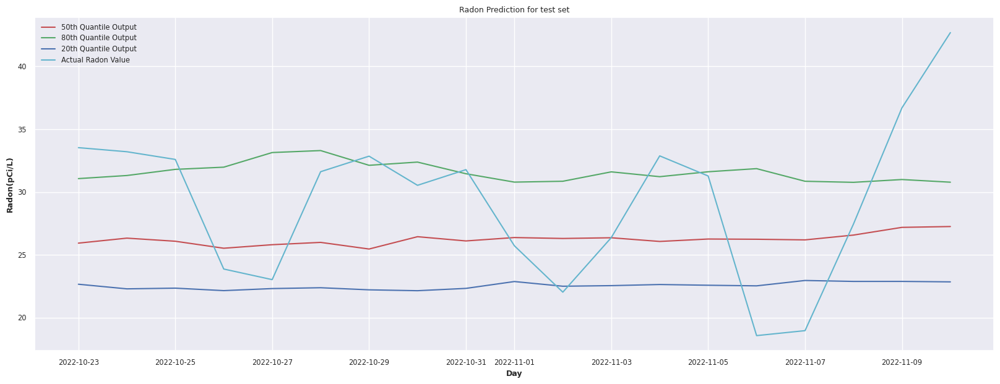

In [50]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()

# Radon 9

In [51]:
#using 21 as the example since it has the most data
df = df_radon['9']

In [52]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 4322 entries, 0 to 4321
Data columns (total 10 columns):
 #   Column       Non-Null Count  Dtype         
---  ------       --------------  -----         
 0   Serialid     4322 non-null   object        
 1   DeviceName   4322 non-null   object        
 2   SyncDate     4322 non-null   datetime64[ns]
 3   Radon        4322 non-null   float64       
 4   eC02         4322 non-null   int64         
 5   VOC          4322 non-null   int64         
 6   Temperature  4322 non-null   int64         
 7   AirPressure  4322 non-null   float64       
 8   Humidity     4322 non-null   int64         
 9   LogIndex     4322 non-null   int64         
dtypes: datetime64[ns](1), float64(2), int64(5), object(2)
memory usage: 371.4+ KB


In [53]:
df = df[['SyncDate','Temperature','Humidity','AirPressure','Radon']]

In [54]:
df

,SyncDate,Temperature,Humidity,AirPressure,Radon
0,2023-02-11 18:02:44,49,73,30.03,4.70
1,2023-02-11 17:02:44,50,69,30.07,5.50
2,2023-02-11 16:02:44,54,61,30.08,5.40
3,2023-02-11 15:02:44,55,59,30.08,6.00
4,2023-02-11 14:02:44,54,57,30.13,6.00
...,...,...,...,...,...
4317,2022-08-10 04:16:00,77,89,30.14,150.30
4318,2022-08-10 03:16:00,77,89,30.14,153.60
4319,2022-08-10 02:16:00,78,88,30.14,155.70
4320,2022-08-10 01:16:00,79,89,30.15,157.90


In [55]:
df['SyncDate'] = pd.to_datetime(df['SyncDate'])
df.sort_values(by='SyncDate', ascending=True, inplace=True)
df['SyncDate'] = df['SyncDate'].dt.floor('H')
df = df.resample('D', on = 'SyncDate').mean()
df = df.interpolate(method='linear', limit_direction='both')
df.drop_duplicates(inplace=True)

In [56]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,79.71,90.62,30.16,135.90
2022-08-11,78.83,90.75,30.10,137.16
2022-08-12,79.58,90.21,30.03,160.69
2022-08-13,77.96,89.79,30.07,120.67
2022-08-14,78.79,88.17,30.03,67.90
...,...,...,...,...
2023-02-07,53.57,59.91,30.27,1.45
2023-02-08,61.59,61.59,30.24,2.94
2023-02-09,62.78,69.74,30.12,2.90


In [57]:
df = df[df.index<= '2022-11-10']

In [58]:
df

,Temperature,Humidity,AirPressure,Radon
SyncDate,,,,
2022-08-10,79.71,90.62,30.16,135.90
2022-08-11,78.83,90.75,30.10,137.16
2022-08-12,79.58,90.21,30.03,160.69
2022-08-13,77.96,89.79,30.07,120.67
2022-08-14,78.79,88.17,30.03,67.90
...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39
2022-11-07,71.00,79.50,30.25,39.27
2022-11-08,66.96,75.75,30.31,38.11


In [59]:
weather_station = pd.read_csv('../../lilburn_weather_station.csv')

In [60]:
weather_station

,Date,Simple Date,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
0,2023-02-10T23:55:00-05:00,2023-02-10 23:55:00,49.80,0.00,0.00,5.80,337,0.00,0.41,0.27,0.41,1.53,67.44,29.09,74,0,0.00,29.09,336,0.00
1,2023-02-10T23:50:00-05:00,2023-02-10 23:50:00,49.50,0.00,0.00,5.80,328,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,331,0.00
2,2023-02-10T23:45:00-05:00,2023-02-10 23:45:00,49.80,0.00,0.00,5.80,331,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,323,0.00
3,2023-02-10T23:40:00-05:00,2023-02-10 23:40:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.09,76,0,0.00,29.09,304,0.00
4,2023-02-10T23:35:00-05:00,2023-02-10 23:35:00,49.80,0.00,0.00,5.80,319,0.00,0.41,0.27,0.41,1.53,67.44,29.10,75,0,0.00,29.10,315,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
78459,2022-05-10T00:20:00-04:00,2022-05-10 00:20:00,55.80,0.00,0.00,0.00,305,0.00,0.00,0.00,0.00,0.76,22.72,29.13,91,0,0.00,29.13,305,0.00
78460,2022-05-10T00:15:00-04:00,2022-05-10 00:15:00,55.90,0.00,0.00,0.00,309,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,309,0.00
78461,2022-05-10T00:10:00-04:00,2022-05-10 00:10:00,55.80,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,306,0.00
78462,2022-05-10T00:05:00-04:00,2022-05-10 00:05:00,55.90,0.00,0.00,0.00,306,0.00,0.00,0.00,0.00,0.76,22.72,29.13,90,0,0.00,29.13,305,0.00


In [61]:
weather_station.drop('Date', axis=1, inplace=True)
weather_station['Simple Date'] = pd.to_datetime(weather_station['Simple Date'])
weather_station.sort_values(by='Simple Date', ascending=True, inplace=True)
weather_station['Simple Date'] = weather_station['Simple Date'].dt.floor('H')
weather_station = weather_station.resample('D', on = 'Simple Date').mean()
weather_station = weather_station.interpolate(method='linear', limit_direction='both')
weather_station.drop_duplicates(inplace=True)

In [62]:
weather_station

,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
Simple Date,,,,,,,,,,,,,,,,,,
2022-05-10,65.19,0.15,0.57,3.47,294.31,0.00,0.00,0.00,0.00,0.76,22.72,29.15,66.00,1.77,203.36,29.15,305.11,0.08
2022-05-11,69.33,0.18,0.65,3.28,290.86,0.00,0.00,0.00,0.00,0.76,22.72,29.11,66.50,1.69,198.48,29.11,301.33,0.07
2022-05-12,71.16,0.28,0.94,3.61,292.67,0.00,0.00,0.00,0.00,0.76,22.72,29.03,64.87,1.99,227.44,29.03,305.13,0.17
2022-05-13,69.27,0.24,1.18,6.06,287.73,0.00,0.00,0.00,0.00,0.76,22.72,28.99,76.66,0.86,110.60,28.99,303.03,0.10
2022-05-14,70.23,0.12,0.52,4.22,294.85,0.00,0.00,0.00,0.00,0.76,22.72,28.95,76.51,1.45,173.66,28.95,297.84,0.06
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2023-02-06,50.15,0.19,0.64,3.79,309.47,0.00,0.00,0.00,0.00,1.12,67.03,29.13,67.13,1.02,122.63,29.13,318.27,0.12
2023-02-07,50.39,0.32,0.92,4.08,302.28,0.00,0.00,0.00,0.00,1.12,67.03,29.22,68.32,0.85,107.90,29.22,315.51,0.23
2023-02-08,57.42,0.14,0.63,4.05,304.45,0.00,0.00,0.00,0.00,1.12,67.03,29.19,77.53,0.35,54.57,29.19,325.23,0.10


In [63]:
for column in weather_station.columns:
    df[column] = weather_station[column]

In [64]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,79.71,90.62,30.16,135.90,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,78.83,90.75,30.10,137.16,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,79.58,90.21,30.03,160.69,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,77.96,89.79,30.07,120.67,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,78.79,88.17,30.03,67.90,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,71.00,79.50,30.25,39.27,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,66.96,75.75,30.31,38.11,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [65]:
df.dropna(inplace=True)

In [66]:
df

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),...,Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Ultra-Violet Radiation Index,Solar Radiation (W/m^2),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
SyncDate,,,,,,,,,,,,,,,,,,,,,
2022-08-10,79.71,90.62,30.16,135.90,76.12,0.19,0.75,6.67,301.81,0.00,...,0.02,2.18,37.50,29.11,85.56,0.81,108.12,29.11,308.21,0.09
2022-08-11,78.83,90.75,30.10,137.16,75.58,0.16,0.43,3.53,304.70,0.00,...,0.05,2.21,37.53,29.05,85.81,0.77,101.78,29.05,307.19,0.06
2022-08-12,79.58,90.21,30.03,160.69,76.74,0.11,0.45,3.40,307.36,0.00,...,0.11,2.27,37.59,28.98,84.00,1.32,160.11,28.98,309.54,0.05
2022-08-13,77.96,89.79,30.07,120.67,75.14,0.26,1.09,4.25,291.06,0.00,...,0.13,2.29,37.61,29.03,79.21,1.18,145.65,29.03,306.76,0.20
2022-08-14,78.79,88.17,30.03,67.90,75.74,0.21,0.65,3.83,307.88,0.00,...,0.00,2.29,37.61,28.99,78.41,1.49,177.48,28.99,309.20,0.11
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-11-06,70.96,79.29,30.12,33.39,70.78,0.21,0.75,10.24,294.75,0.00,...,0.00,0.05,44.85,29.07,86.35,0.58,77.47,29.07,305.12,0.12
2022-11-07,71.00,79.50,30.25,39.27,71.06,0.07,0.34,4.24,305.54,0.00,...,0.00,0.05,44.85,29.20,86.83,0.58,76.87,29.20,310.20,0.01
2022-11-08,66.96,75.75,30.31,38.11,68.04,0.26,0.96,4.63,296.07,0.00,...,0.00,0.05,44.85,29.26,69.77,0.82,102.09,29.26,308.71,0.15


In [67]:
df.drop(['Ultra-Violet Radiation Index','Solar Radiation (W/m^2)'], axis=1, inplace=True)

In [68]:
# any missing values?
def gaps(df):
    if df.isnull().values.any():
        print("MISSING values:\n")
        mno.matrix(df)
    else:
        print("no missing values\n")
gaps(df)

no missing values



In [69]:
df.describe()

,Temperature,Humidity,AirPressure,Radon,Outdoor h Temperature (°F),Wind Speed (mph),Wind Gust (mph),Max Daily Gust (mph),Wind Direction (°),Hourly Rain (in/hr),Event Rain (in),Daily Rain (in),Weekly Rain (in),Monthly Rain (in),Yearly Rain (in),Relative Pressure (inHg),Humidity (%),Absolute Pressure (inHg),Avg Wind Direction (10 mins) (°),Avg Wind Speed (10 mins) (mph)
count,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00,93.00
mean,69.76,78.61,30.06,63.38,67.45,0.13,0.54,3.36,296.43,0.00,0.10,0.03,0.30,1.65,42.03,29.02,77.72,29.02,304.88,0.07
std,7.62,14.56,0.10,49.22,8.11,0.12,0.49,2.50,12.64,0.01,0.28,0.10,0.52,1.24,2.25,0.10,9.98,0.10,9.92,0.08
min,51.00,53.75,29.84,0.24,45.54,0.00,0.00,0.00,258.31,0.00,0.00,0.00,0.00,0.00,37.50,28.80,54.15,28.80,267.15,0.00
25%,63.88,63.50,30.00,35.23,61.25,0.02,0.19,1.87,288.74,0.00,0.00,0.00,0.00,0.14,40.48,28.95,70.64,28.95,298.27,0.01
50%,70.29,81.97,30.06,46.72,68.04,0.11,0.46,3.40,299.35,0.00,0.00,0.00,0.00,1.99,42.52,29.01,78.96,29.01,306.57,0.05
75%,77.17,92.00,30.12,79.73,75.01,0.20,0.75,4.45,305.92,0.00,0.04,0.00,0.34,2.09,43.96,29.08,85.25,29.08,312.89,0.10
max,80.17,94.38,30.34,268.92,78.23,0.53,2.44,10.24,317.34,0.06,1.79,0.74,1.91,5.11,44.87,29.29,95.93,29.29,319.39,0.37


In [70]:
for column in df.columns:
    df[column] = df[column].astype('float32')
    if column == 'Radon':
        continue
    else:
        for i in range(1,40):
            df[column+'_lag_'+str(i)] = df[column].shift(i)

In [71]:
df.fillna(0, inplace=True)

In [72]:
# check correlations of features with price
df_corr = df.corr(method="pearson")
print(df_corr.shape)
print("correlation with price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))
df_corrP

(761, 761)
correlation with price:


,Radon
Radon,1.00
Temperature,0.60
Humidity,0.57
Outdoor h Temperature (°F),0.55
Avg Wind Direction (10 mins) (°),0.52
...,...
Avg Wind Direction (10 mins) (°)_lag_35,-0.75
Wind Direction (°)_lag_35,-0.75
Absolute Pressure (inHg)_lag_35,-0.76
Relative Pressure (inHg)_lag_35,-0.76


In [73]:
for i in df_corrP['Radon'].index:
    print(i, df_corrP['Radon'][i])

Radon 1.0
Temperature 0.599964964306622
Humidity 0.5650333240875873
Outdoor h Temperature (°F) 0.5518530170013063
Avg Wind Direction (10 mins) (°) 0.5196196715827794
Wind Direction (°) 0.5126737477672937
Event Rain (in)_lag_2 0.43720879095629384
Monthly Rain (in) 0.435766208261099
Humidity (%) 0.41230019801625345
Event Rain (in)_lag_1 0.40257056755495013
Humidity_lag_1 0.3999878602268277
Monthly Rain (in)_lag_1 0.38658896315866004
Hourly Rain (in/hr)_lag_3 0.3740128145379949
Weekly Rain (in)_lag_2 0.3563324904607044
Weekly Rain (in)_lag_1 0.3470299284196123
Weekly Rain (in) 0.346561711697015
Hourly Rain (in/hr)_lag_2 0.3405631507642825
Temperature_lag_1 0.3202504323128958
Monthly Rain (in)_lag_2 0.31631899580028794
Outdoor h Temperature (°F)_lag_1 0.3070941957188777
Weekly Rain (in)_lag_3 0.2806201527402427
Humidity (%)_lag_1 0.2751923565020737
Event Rain (in)_lag_3 0.2728922345845889
Humidity_lag_2 0.25824044320995543
Hourly Rain (in/hr)_lag_8 0.24025260899211995
Hourly Rain (in/hr)_l

In [74]:
# highest absolute correlations with price
pd.options.display.float_format = '{:,.2f}'.format
# df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.35]
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) >= 0.44]
df_corrH

,Radon
Radon,1.00
Temperature,0.60
Humidity,0.57
Outdoor h Temperature (°F),0.55
Avg Wind Direction (10 mins) (°),0.52
...,...
Avg Wind Direction (10 mins) (°)_lag_35,-0.75
Wind Direction (°)_lag_35,-0.75
Absolute Pressure (inHg)_lag_35,-0.76
Relative Pressure (inHg)_lag_35,-0.76


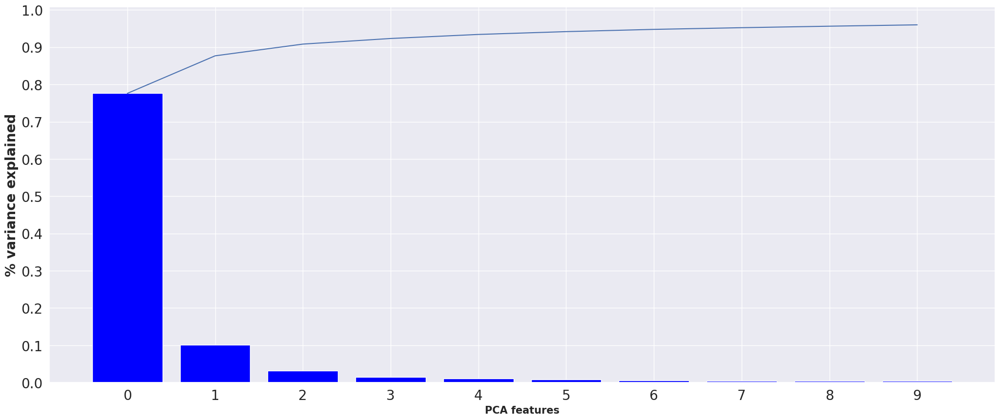

In [75]:
from sklearn.preprocessing import MinMaxScaler
from sklearn.decomposition import FastICA, PCA
df_feat = df[df_corrH.index]
df_feat = df_feat.loc[:, df_feat.columns != "Radon"]
df_feat =MinMaxScaler().fit_transform(df_feat)
pca = PCA(n_components=10)
res_pca = pca.fit_transform(df_feat)
# scree plot
features = range(pca.n_components_)
plt.figure(figsize = (25,10))
plt.bar(features, pca.explained_variance_ratio_, color="blue")
plt.plot(np.cumsum(pca.explained_variance_ratio_))
plt.xlabel("PCA features", fontsize=15)
plt.ylabel("% variance explained", fontsize=20)
plt.xticks(features, fontsize=20)
plt.yticks(ticks=np.arange(0.0, 1.0001, 0.1), fontsize=20);

In [76]:
# collect principal components in a dataframe
df_pca = pd.DataFrame(res_pca)
df_pca = df_pca.add_prefix("pca")


df3 = df.copy()
col = df3.pop("Radon")
df3.insert(0, col.name, col)     # move price column to the left

# drop the feature columns which the components summarize
df3.reset_index(inplace=True)
df3 = pd.concat([df3, df_pca], axis=1)
for col in df3.columns:
    if col != "Radon" and col != "SyncDate" and "pca" not in col:
        del df3[col]
df3.set_index("SyncDate", inplace=True)
df3.columns

Index(['Radon', 'pca0', 'pca1', 'pca2', 'pca3', 'pca4', 'pca5', 'pca6', 'pca7',
       'pca8', 'pca9'],
      dtype='object')

In [77]:
# prepare correlation matrix for principal components  
df_corr = df3.corr(method="pearson")
print("principal components with at least modest correlation to price:")
df_corrP = pd.DataFrame(df_corr["Radon"].sort_values(ascending=False))

# absolute correlations with price > 10%
pd.options.display.float_format = '{:,.2f}'.format
df_corrH = df_corrP[np.abs(df_corrP["Radon"]) > 0.10]
df_corrH

principal components with at least modest correlation to price:


,Radon
Radon,1.00
pca0,0.71
pca2,0.21
pca1,0.20
pca8,0.13
pca3,-0.14


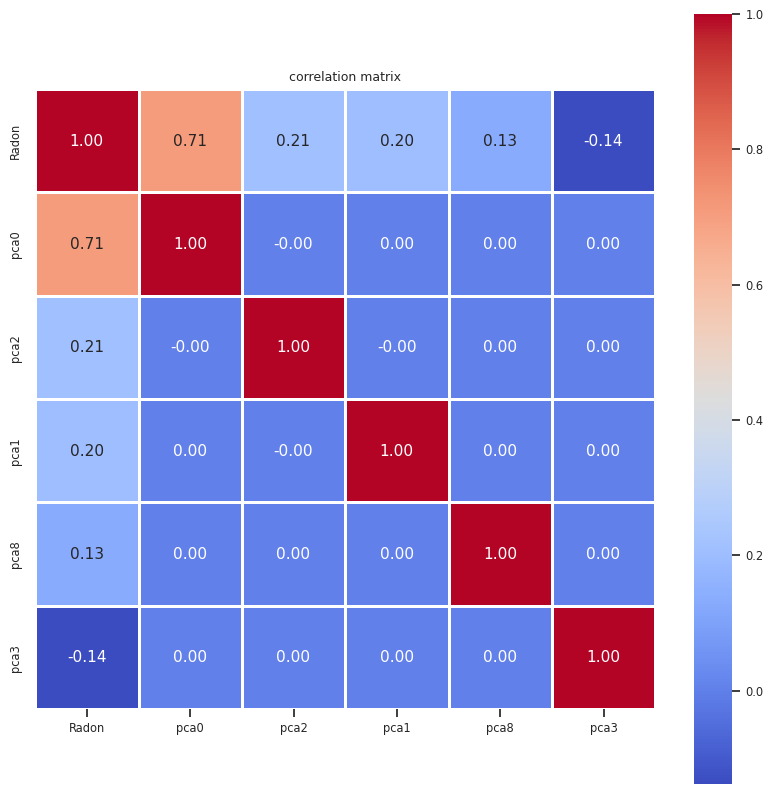

In [78]:
# helper method: correlation matrix as heatmap
def corr_heatmap(df):
    idx = df.corr().sort_values("Radon", ascending=False).index
    df_sorted = df.loc[:, idx]  # sort dataframe columns by their correlation 

    #plt.figure(figsize = (15,15))
    sns.set(font_scale=0.75)
    ax = sns.heatmap(df_sorted.corr().round(3), 
            annot=True, 
            square=True, 
            linewidths=.75, cmap="coolwarm", 
            fmt = ".2f", 
            annot_kws = {"size": 11})
    ax.xaxis.tick_bottom()
    plt.title("correlation matrix")
    plt.show()



# visualize correlations with price     
df4 = df3.copy()
df4 = df4[df_corrH.index]   # keep the components with at least modest correlations

plt.figure(figsize = (10,10))
corr_heatmap(df4)

In [79]:
df4.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 93 entries, 2022-08-10 to 2022-11-10
Data columns (total 6 columns):
 #   Column  Non-Null Count  Dtype  
---  ------  --------------  -----  
 0   Radon   93 non-null     float32
 1   pca0    93 non-null     float32
 2   pca2    93 non-null     float32
 3   pca1    93 non-null     float32
 4   pca8    93 non-null     float32
 5   pca3    93 non-null     float32
dtypes: float32(6)
memory usage: 2.9 KB


In [80]:
# create time series object for target variable
ts_P = TimeSeries.from_series(df4["Radon"], fill_missing_dates=True, freq="D") 

# check attributes of the time series
print("components:", ts_P.components)
print("duration:",ts_P.duration)
print("frequency:",ts_P.freq)
print("frequency:",ts_P.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_P.has_datetime_index)
print("deterministic:",ts_P.is_deterministic)
print("univariate:",ts_P.is_univariate)

components: Index(['Radon'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: True


In [81]:
# create time series object for the feature columns
df_covF = df4.loc[:, df4.columns != "Radon"]
ts_covF = TimeSeries.from_dataframe(df_covF, fill_missing_dates=True, freq="D")

# check attributes of the time series
print("components (columns) of feature time series:", ts_covF.components)
print("duration:",ts_covF.duration)
print("frequency:",ts_covF.freq)
print("frequency:",ts_covF.freq_str)
print("has date time index? (or else, it must have an integer index):",ts_covF.has_datetime_index)
print("deterministic:",ts_covF.is_deterministic)
print("univariate:",ts_covF.is_univariate)

components (columns) of feature time series: Index(['pca0', 'pca2', 'pca1', 'pca8', 'pca3'], dtype='object', name='component')
duration: 92 days 00:00:00
frequency: <Day>
frequency: D
has date time index? (or else, it must have an integer index): True
deterministic: True
univariate: False


In [82]:
# example: operating with time series objects:
# we can also create a 3-dimensional numpy array from a time series object
# 3 dimensions: time (rows) / components (columns) / samples
ar_covF = ts_covF.all_values()
print(type(ar_covF))
ar_covF.shape

<class 'numpy.ndarray'>


(93, 5, 1)

In [83]:
# example: operating with time series objects:
# we can also create a pandas series or dataframe from a time series object
df_covF = ts_covF.pd_dataframe()
type(df_covF)

pandas.core.frame.DataFrame

In [84]:

# train/test split and scaling of target variable
ts_train, ts_test = ts_P.split_after(split_point=0.8)
print("training start:", ts_train.start_time())
print("training end:", ts_train.end_time())
print("training duration:",ts_train.duration)
print("test start:", ts_test.start_time())
print("test end:", ts_test.end_time())
print("test duration:", ts_test.duration)


scalerP = Scaler()
scalerP.fit_transform(ts_train)
ts_ttrain = scalerP.transform(ts_train)
ts_ttest = scalerP.transform(ts_test)    
ts_t = scalerP.transform(ts_P)

# make sure data are of type float
ts_t = ts_t.astype(np.float32)
ts_ttrain = ts_ttrain.astype(np.float32)
ts_ttest = ts_ttest.astype(np.float32)

print("first and last row of scaled Radon time series:")
pd.options.display.float_format = '{:,.2f}'.format
ts_t.pd_dataframe().iloc[[0,-1]]

training start: 2022-08-10 00:00:00
training end: 2022-10-22 00:00:00
training duration: 73 days 00:00:00
test start: 2022-10-23 00:00:00
test end: 2022-11-10 00:00:00
test duration: 18 days 00:00:00
first and last row of scaled Radon time series:


component,Radon
SyncDate,
2022-08-10,0.50
2022-11-10,0.04


In [85]:
# train/test split and scaling of feature covariates
covF_train, covF_test = ts_covF.split_after(split_point=0.8)

scalerF = Scaler()
scalerF.fit_transform(covF_train)
covF_ttrain = scalerF.transform(covF_train) 
covF_ttest = scalerF.transform(covF_test)   
covF_t = scalerF.transform(ts_covF)  

# make sure data are of type float
covF_ttrain = covF_ttrain.astype(np.float32)
covF_ttest = covF_ttest.astype(np.float32)

pd.options.display.float_format = '{:.2f}'.format
print("first and last row of scaled feature covariates:")
covF_t.pd_dataframe().iloc[[0,-1]]

first and last row of scaled feature covariates:


component,pca0,pca2,pca1,pca8,pca3
SyncDate,,,,,
2022-08-10,1.00,0.67,0.00,0.49,0.38
2022-11-10,0.11,0.45,0.24,-0.01,0.41


In [86]:

print("first and last row of scaled target variable in training set: price:")
ts_ttrain.pd_dataframe().iloc[[0,-1]]

first and last row of scaled target variable in training set: price:


component,Radon
SyncDate,
2022-08-10,0.50
2022-10-22,0.16


In [87]:
# model = TFTModel(   input_chunk_length=INLEN,
#                     output_chunk_length=N_FC,
#                     hidden_size=HIDDEN,
#                     lstm_layers=LSTMLAYERS,
#                     num_attention_heads=ATTH,
#                     dropout=DROPOUT,
#                     batch_size=BATCH,
#                     n_epochs=EPOCHS,                        
#                     nr_epochs_val_period=VALWAIT, 
#                     likelihood=QuantileRegression(QUANTILES), 
#                     optimizer_kwargs={"lr": LEARN}, 
#                     model_name="TFT_EnergyES",
#                     log_tensorboard=False,
#                     random_state=RAND,
#                     force_reset=True,
#                     save_checkpoints=True,
#                     pl_trainer_kwargs={"callbacks": [EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.05,
#         mode='min',
#     )]}
#                 )

In [88]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)

In [89]:
import torch
from darts.utils.losses import SmapeLoss
from torchmetrics import MetricCollection, SymmetricMeanAbsolutePercentageError, MeanAbsolutePercentageError
def build_fit_tft_model_return(
    model_args,
    save_checkpoints=False,
    callbacks=None,
    save_model=False
):
    BATCH_SIZE=64
    MAX_EPOCHS=500
    NR_EPOCHS_VAL_PERIOD=1

    torch_metrics = MetricCollection([MeanAbsolutePercentageError(), SymmetricMeanAbsolutePercentageError()])

#     early_stopper = EarlyStopping(
#         monitor="val_loss",
#         patience=5,
#         min_delta=0.001,
#         mode='min',
#     )

#     if callbacks is None:
#         callbacks = [early_stopper]
#     else:
#         callbacks.append(early_stopper)
    
    #detect if GPU is available
#     if torch.cuda.is_available():
#         pl_trainer_kwargs = {
#             "accelerator": "gpu",
#             "gpus": -1,
#             "auto_select_gpus": True,
#             "callbacks": callbacks,
#             "enable_progress_bar":False,
#         }
#         num_workers=8
#     else:
#         pl_trainer_kwargs={
#             "callbacks": callbacks,
#         }
#         num_workers=0
    pl_trainer_kwargs={
            "accelerator": "gpu",
            "gpus":-1,
            "auto_select_gpus": True,
            "callbacks": callbacks,
            "enable_progress_bar": False,
        }
    encoders={"cyclic": {"future": ["hour"]}} if model_args['include_hour'] else None


    model = TFTModel(
        input_chunk_length=model_args['in_len'],
        output_chunk_length=model_args['out_len'],
        batch_size=BATCH_SIZE,
        n_epochs=MAX_EPOCHS,
        nr_epochs_val_period=NR_EPOCHS_VAL_PERIOD,
        model_name="TFT",
        hidden_size = int(model_args['out_len']+((2/3)*model_args['in_len'])),
        lstm_layers= model_args['lstm_layers'],
        num_attention_heads = model_args['num_attention_heads'],
        loss_fn=SmapeLoss(),
        dropout=model_args['dropout'],
        likelihood=QuantileRegression(quantiles=QUANTILES),
        optimizer_kwargs={'lr': model_args['lr']},
        add_encoders=encoders,
        log_tensorboard=False,
        force_reset=True,
        save_checkpoints=save_checkpoints,
        pl_trainer_kwargs=pl_trainer_kwargs,
        torch_metrics=torch_metrics,
        )
    val_len = int(ts_test.duration.days)
#     val_series = ts_ttrain[-((val_len) + model_args['in_len']) :]
#     ts_ttrain_input = ts_ttrain[:-(val_len )]
    model.fit(  ts_ttrain, 
                future_covariates=covF_t,
                val_series=ts_t[-((val_len)+model_args['in_len']) :],
                val_future_covariates=covF_t,)
    if save_model:
        print("have saved the model after training:", mpath)
        model.save_model(mpath)
    return model

In [90]:
from ray import tune
from ray.tune import CLIReporter
from ray.tune.integration.pytorch_lightning import TuneReportCallback
from ray.tune.schedulers import ASHAScheduler, AsyncHyperBandScheduler
from ray.tune.search.optuna import OptunaSearch
tune_callback = TuneReportCallback(
    {
        "loss":"val_loss",
        "sMAPE": "val_SymmetricMeanAbsolutePercentageError",
    },
    on="validation_end",
)

early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )

#define the hyperparameter search space
config = {
    "in_len": tune.choice([4,8,16,32,64]),
    "out_len":tune.randint(1,4),
    "lstm_layers":tune.randint(1,4),
    "num_attention_heads":tune.randint(1,12),
    "dropout":tune.uniform(0.1,0.5),
    "lr":tune.loguniform(1e-5,1e-1),
    "include_hour":tune.choice([True,False]),
}

reporter = CLIReporter(
    parameter_columns=list(config.keys()),
    metric_columns=["loss", "sMAPE", "training_iteration"])
resources_per_trial = {"cpu": 8, "gpu": 1}

num_samples = 500

algo = OptunaSearch()

scheduler = AsyncHyperBandScheduler(max_t=1000, grace_period=10, reduction_factor=2)

train_fn_with_parameters = tune.with_parameters(build_fit_tft_model, callbacks=[early_stopper,tune_callback])

analysis = tune.run(
    train_fn_with_parameters,
    resources_per_trial=resources_per_trial,
    metric="sMAPE",
    mode="min",
    config=config,
    num_samples=num_samples,
    search_alg=algo,
    scheduler = scheduler,
    progress_reporter=reporter,
    name="tft_tune",

)

print("Best hyperparameters found were: ", analysis.best_config)

== Status ==
Current time: 2023-02-23 04:16:45 (running for 00:00:00.19)
Memory usage on this node: 21.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 1/500 (1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+
| Trial name                   | status   | loc                  |   in_len |   out_len |   lstm_layers |   num_attention_heads |   dropout |          lr | include_hour   |
|------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+---------

(build_fit_tft_model pid=1396803) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1396803)   rank_zero_deprecation(
(build_fit_tft_model pid=1396803) Auto select gpus: [0]
(build_fit_tft_model pid=1396803) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1396803) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1396803) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1396803) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1396803) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1396803) 
(build_fit_tft_model pid=1396803)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1396803) ---------------

Trial name,date,done,episodes_total,experiment_id,hostname,iterations_since_restore,loss,node_ip,pid,sMAPE,time_since_restore,time_this_iter_s,time_total_s,timestamp,timesteps_since_restore,timesteps_total,training_iteration,trial_id,warmup_time
build_fit_tft_model_003fbc42,2023-02-23_04-20-42,True,,fd297c8e93184291a349bb5d12896b46,ip-172-31-10-87,20,1.30623,172.31.10.87,1400094,1.3858,10.9355,0.428141,10.9355,1677126042,0,,20,003fbc42,0.00471663
build_fit_tft_model_00950c94,2023-02-23_04-46-18,True,,6a14ab504e6f4907ada1deede542b7e7,ip-172-31-10-87,40,0.0915765,172.31.10.87,1424622,0.842682,13.8247,0.253058,13.8247,1677127578,0,,40,00950c94,0.00492334
build_fit_tft_model_00c59950,2023-02-23_05-59-37,True,,f1b0501566f7434fb96d3228da1b3abf,ip-172-31-10-87,10,0.268084,172.31.10.87,1508731,1.30161,6.85829,0.187603,6.85829,1677131977,0,,10,00c59950,0.00624418
build_fit_tft_model_014401f7,2023-02-23_04-58-35,True,,79186a9e7eaa49cdbfc5030a219e282a,ip-172-31-10-87,10,0.259724,172.31.10.87,1438382,1.28828,8.17225,0.319466,8.17225,1677128315,0,,10,014401f7,0.00531435
build_fit_tft_model_01c749d1,2023-02-23_05-39-53,True,,b67ff76d91e744fa816bb4b006be35fa,ip-172-31-10-87,10,0.25313,172.31.10.87,1485874,1.2294,6.75654,0.252436,6.75654,1677130793,0,,10,01c749d1,0.00531626
build_fit_tft_model_034a5660,2023-02-23_05-43-37,True,,a65dcc294d3a4f2980a69d6f7f7ce568,ip-172-31-10-87,10,0.752478,172.31.10.87,1490361,1.44886,6.33405,0.2565,6.33405,1677131017,0,,10,034a5660,0.00550008
build_fit_tft_model_038ed841,2023-02-23_05-45-51,True,,577aad4f60c146ccae796efe7be60656,ip-172-31-10-87,10,0.200305,172.31.10.87,1492977,1.16089,6.95091,0.203166,6.95091,1677131151,0,,10,038ed841,0.00492048
build_fit_tft_model_039a1ee7,2023-02-23_05-56-06,True,,c15e5183ab9e4bfc85f9e763554f1cb1,ip-172-31-10-87,20,0.136157,172.31.10.87,1504458,0.906972,8.94058,0.630235,8.94058,1677131766,0,,20,039a1ee7,0.00525856
build_fit_tft_model_03b074d9,2023-02-23_05-50-37,True,,9dfb186fb20a499ca26b2a2086aa0189,ip-172-31-10-87,10,0.239735,172.31.10.87,1498444,1.12837,6.78813,0.246055,6.78813,1677131437,0,,10,03b074d9,0.00571227
build_fit_tft_model_041be389,2023-02-23_04-53-24,True,,198e060ae7e24dff8381519c610de281,ip-172-31-10-87,40,0.11111,172.31.10.87,1432405,0.771674,13.865,0.218428,13.865,1677128004,0,,40,041be389,0.00813699


== Status ==
Current time: 2023-02-23 04:16:57 (running for 00:00:11.92)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: None | Iter 20.000: None | Iter 10.000: None
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 39eaf53d with sMAPE=1.4799591302871704 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.22122571522041415, 'lr': 4.107252490379961e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------+---------+----------------------+
| Trial name                   | status 

== Status ==
Current time: 2023-02-23 04:17:17 (running for 00:00:32.50)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: None | Iter 40.000: -1.3948192596435547 | Iter 20.000: -1.3285719156265259 | Iter 10.000: -1.3001039028167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 39eaf53d with sMAPE=1.4711147546768188 and parameters={'in_len': 4, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 3, 'dropout': 0.22122571522041415, 'lr': 4.107252490379961e-05, 'include_hour': True}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 2/500 (1 PENDING, 1 RUNNING)
+------------------------------+----------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------+---------+------------------

(build_fit_tft_model pid=1397319) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397319)   rank_zero_deprecation(
(build_fit_tft_model pid=1397319) Auto select gpus: [0]
(build_fit_tft_model pid=1397319) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397319) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397319) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397319) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1397319) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1397319) 
(build_fit_tft_model pid=1397319)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1397319) ---------------

== Status ==
Current time: 2023-02-23 04:17:42 (running for 00:00:57.58)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4041541814804077 | Iter 40.000: -1.3948192596435547 | Iter 20.000: -1.3285719156265259 | Iter 10.000: -1.3001039028167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 37271868 with sMAPE=0.9984524250030518 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.23763949428506503, 'lr': 0.0024153148358562523, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 3/500 (1 PENDING, 1 RUNNING, 1 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1397646) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1397646)   rank_zero_deprecation(
(build_fit_tft_model pid=1397646) Auto select gpus: [0]
(build_fit_tft_model pid=1397646) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1397646) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1397646) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1397646) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1397646) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1397646) 
(build_fit_tft_model pid=1397646)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1397646) ---------------

== Status ==
Current time: 2023-02-23 04:18:05 (running for 00:01:19.74)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.4041541814804077 | Iter 40.000: -1.1626253128051758 | Iter 20.000: -1.0935099720954895 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 37271868 with sMAPE=0.6551133394241333 and parameters={'in_len': 16, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 5, 'dropout': 0.23763949428506503, 'lr': 0.0024153148358562523, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 4/500 (1 PENDING, 1 RUNNING, 2 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:18:29 (running for 00:01:43.94)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9304313659667969 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eb706f7a with sMAPE=0.570635974407196 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.24589651918690203, 'lr': 0.01868148139523697, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

(build_fit_tft_model pid=1398104) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398104)   rank_zero_deprecation(
(build_fit_tft_model pid=1398104) Auto select gpus: [0]
(build_fit_tft_model pid=1398104) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398104) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398104) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398104) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398104) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398104) 
(build_fit_tft_model pid=1398104)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398104) ---------------

== Status ==
Current time: 2023-02-23 04:18:36 (running for 00:01:50.73)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9304313659667969 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: eb706f7a with sMAPE=0.570635974407196 and parameters={'in_len': 16, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 2, 'dropout': 0.24589651918690203, 'lr': 0.01868148139523697, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 5/500 (1 PENDING, 1 RUNNING, 3 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----------

== Status ==
Current time: 2023-02-23 04:18:55 (running for 00:02:09.94)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.08437579870224
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1398464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398464)   rank_zero_deprecation(
(build_fit_tft_model pid=1398464) Auto select gpus: [0]
(build_fit_tft_model pid=1398464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398464) 
(build_fit_tft_model pid=1398464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398464) ---------------

== Status ==
Current time: 2023-02-23 04:19:02 (running for 00:02:16.99)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=0
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.08437579870224
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 6/500 (1 PENDING, 1 RUNNING, 4 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---------

(build_fit_tft_model pid=1398703) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398703)   rank_zero_deprecation(
(build_fit_tft_model pid=1398703) Auto select gpus: [0]
(build_fit_tft_model pid=1398703) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398703) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398703) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398703) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398703) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398703) 
(build_fit_tft_model pid=1398703)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398703) ---------------

== Status ==
Current time: 2023-02-23 04:19:16 (running for 00:02:31.30)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=1
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 7/500 (1 PENDING, 1 RUNNING, 5 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--------

(build_fit_tft_model pid=1398959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1398959)   rank_zero_deprecation(
(build_fit_tft_model pid=1398959) Auto select gpus: [0]
(build_fit_tft_model pid=1398959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1398959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1398959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1398959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1398959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1398959) 
(build_fit_tft_model pid=1398959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1398959) ---------------

== Status ==
Current time: 2023-02-23 04:19:31 (running for 00:02:45.96)
Memory usage on this node: 23.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=2
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 8/500 (1 PENDING, 1 RUNNING, 6 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1399215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1399215)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1399215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399215)   rank_zero_deprecation(
(build_fit_tft_model pid=1399215) Auto select gpus: [0]
(build_fit_tft_model pid=1399215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399215) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:19:45 (running for 00:03:00.50)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=3
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.3001039028167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 9/500 (1 PENDING, 1 RUNNING, 7 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-------

(build_fit_tft_model pid=1399511) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399511)   rank_zero_deprecation(
(build_fit_tft_model pid=1399511) Auto select gpus: [0]
(build_fit_tft_model pid=1399511) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399511) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399511) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399511) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1399511) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1399511) 
(build_fit_tft_model pid=1399511)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1399511) ---------------

== Status ==
Current time: 2023-02-23 04:20:04 (running for 00:03:19.70)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=4
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 10/500 (1 PENDING, 1 RUNNING, 8 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1399725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1399725)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1399725) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1399725)   rank_zero_deprecation(
(build_fit_tft_model pid=1399725) Auto select gpus: [0]
(build_fit_tft_model pid=1399725) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1399725) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1399725) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1399725) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:20:19 (running for 00:03:34.40)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=5
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.3001039028167725
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 11/500 (1 PENDING, 1 RUNNING, 9 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1400094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1400094)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1400094) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400094)   rank_zero_deprecation(
(build_fit_tft_model pid=1400094) Auto select gpus: [0]
(build_fit_tft_model pid=1400094) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400094) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400094) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400094) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:20:35 (running for 00:03:50.23)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=6
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 12/500 (1 PENDING, 1 RUNNING, 10 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:20:48 (running for 00:04:03.00)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1400377) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400377)   rank_zero_deprecation(
(build_fit_tft_model pid=1400377) Auto select gpus: [0]
(build_fit_tft_model pid=1400377) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400377) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400377) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400377) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400377) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400377) 
(build_fit_tft_model pid=1400377)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400377) ---------------

== Status ==
Current time: 2023-02-23 04:20:54 (running for 00:04:09.66)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=7
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 13/500 (1 PENDING, 1 RUNNING, 11 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1400593) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400593)   rank_zero_deprecation(
(build_fit_tft_model pid=1400593) Auto select gpus: [0]
(build_fit_tft_model pid=1400593) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400593) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400593) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400593) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400593) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400593) 
(build_fit_tft_model pid=1400593)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400593) ---------------

== Status ==
Current time: 2023-02-23 04:21:08 (running for 00:04:23.44)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=8
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 14/500 (1 PENDING, 1 RUNNING, 12 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1400832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1400832)   rank_zero_deprecation(
(build_fit_tft_model pid=1400832) Auto select gpus: [0]
(build_fit_tft_model pid=1400832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1400832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1400832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1400832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1400832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1400832) 
(build_fit_tft_model pid=1400832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1400832) ---------------

== Status ==
Current time: 2023-02-23 04:21:25 (running for 00:04:39.99)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=9
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.9083219170570374 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 15/500 (1 PENDING, 1 RUNNING, 13 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

(build_fit_tft_model pid=1401118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401118)   rank_zero_deprecation(
(build_fit_tft_model pid=1401118) Auto select gpus: [0]
(build_fit_tft_model pid=1401118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401118) 
(build_fit_tft_model pid=1401118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401118) ---------------

== Status ==
Current time: 2023-02-23 04:21:41 (running for 00:04:55.98)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.9105136692523956 | Iter 20.000: -0.9083219170570374 | Iter 10.000: -1.2536938786506653
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:21:51 (running for 00:05:06.34)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8905959725379944 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 16/500 (1 PENDING, 1 RUNNING, 14 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:22:03 (running for 00:05:18.00)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8905959725379944 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1401528) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401528)   rank_zero_deprecation(
(build_fit_tft_model pid=1401528) Auto select gpus: [0]
(build_fit_tft_model pid=1401528) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401528) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401528) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401528) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401528) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401528) 
(build_fit_tft_model pid=1401528)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401528) ---------------

== Status ==
Current time: 2023-02-23 04:22:09 (running for 00:05:24.18)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8905959725379944 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:22:19 (running for 00:05:34.31)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8746834993362427 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 17/500 (1 PENDING, 1 RUNNING, 15 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1401810) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1401810)   rank_zero_deprecation(
(build_fit_tft_model pid=1401810) Auto select gpus: [0]
(build_fit_tft_model pid=1401810) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1401810) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1401810) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1401810) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1401810) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1401810) 
(build_fit_tft_model pid=1401810)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1401810) ---------------

== Status ==
Current time: 2023-02-23 04:22:34 (running for 00:05:49.48)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=10
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8746834993362427 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 18/500 (1 PENDING, 1 RUNNING, 16 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1402083) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402083)   rank_zero_deprecation(
(build_fit_tft_model pid=1402083) Auto select gpus: [0]
(build_fit_tft_model pid=1402083) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402083) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402083) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402083) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402083) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402083) 
(build_fit_tft_model pid=1402083)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402083) ---------------

== Status ==
Current time: 2023-02-23 04:22:49 (running for 00:06:04.63)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=11
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8746834993362427 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 19/500 (1 PENDING, 1 RUNNING, 17 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1402293) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402293)   rank_zero_deprecation(
(build_fit_tft_model pid=1402293) Auto select gpus: [0]
(build_fit_tft_model pid=1402293) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402293) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402293) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402293) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402293) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402293) 
(build_fit_tft_model pid=1402293)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402293) ---------------

== Status ==
Current time: 2023-02-23 04:23:03 (running for 00:06:18.58)
Memory usage on this node: 24.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8746834993362427 | Iter 20.000: -0.8900643587112427 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:23:14 (running for 00:06:28.83)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.858771026134491 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 20/500 (1 PENDING, 1 RUNNING, 18 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1402648) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402648)   rank_zero_deprecation(
(build_fit_tft_model pid=1402648) Auto select gpus: [0]
(build_fit_tft_model pid=1402648) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402648) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402648) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402648) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402648) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402648) 
(build_fit_tft_model pid=1402648)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402648) ---------------

== Status ==
Current time: 2023-02-23 04:23:26 (running for 00:06:41.50)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=12
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.858771026134491 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 21/500 (1 PENDING, 1 RUNNING, 19 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1402843) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1402843)   rank_zero_deprecation(
(build_fit_tft_model pid=1402843) Auto select gpus: [0]
(build_fit_tft_model pid=1402843) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1402843) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1402843) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1402843) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1402843) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1402843) 
(build_fit_tft_model pid=1402843)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1402843) ---------------

== Status ==
Current time: 2023-02-23 04:23:41 (running for 00:06:56.02)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=13
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.858771026134491 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 22/500 (1 PENDING, 1 RUNNING, 20 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1403103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403103)   rank_zero_deprecation(
(build_fit_tft_model pid=1403103) Auto select gpus: [0]
(build_fit_tft_model pid=1403103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403103) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403103) 
(build_fit_tft_model pid=1403103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403103) ---------------

== Status ==
Current time: 2023-02-23 04:23:55 (running for 00:07:10.46)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.858771026134491 | Iter 20.000: -0.8742561936378479 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+------

== Status ==
Current time: 2023-02-23 04:24:05 (running for 00:07:20.56)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -1.1095269918441772 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 23/500 (1 PENDING, 1 RUNNING, 21 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:24:19 (running for 00:07:34.02)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1403420) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403420)   rank_zero_deprecation(
(build_fit_tft_model pid=1403420) Auto select gpus: [0]
(build_fit_tft_model pid=1403420) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403420) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403420) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403420) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403420) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403420) 
(build_fit_tft_model pid=1403420)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403420) ---------------

== Status ==
Current time: 2023-02-23 04:24:25 (running for 00:07:40.61)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=14
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 24/500 (1 PENDING, 1 RUNNING, 22 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1403697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403697)   rank_zero_deprecation(
(build_fit_tft_model pid=1403697) Auto select gpus: [0]
(build_fit_tft_model pid=1403697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403697) 
(build_fit_tft_model pid=1403697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403697) ---------------

== Status ==
Current time: 2023-02-23 04:24:42 (running for 00:07:57.21)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=15
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 25/500 (1 PENDING, 1 RUNNING, 23 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1403922) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1403922)   rank_zero_deprecation(
(build_fit_tft_model pid=1403922) Auto select gpus: [0]
(build_fit_tft_model pid=1403922) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1403922) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1403922) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1403922) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1403922) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1403922) 
(build_fit_tft_model pid=1403922)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1403922) ---------------

== Status ==
Current time: 2023-02-23 04:24:56 (running for 00:08:11.53)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 26/500 (1 PENDING, 1 RUNNING, 24 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:25:10 (running for 00:08:25.06)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1404244) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404244)   rank_zero_deprecation(
(build_fit_tft_model pid=1404244) Auto select gpus: [0]
(build_fit_tft_model pid=1404244) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404244) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404244) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404244) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404244) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404244) 
(build_fit_tft_model pid=1404244)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404244) ---------------

== Status ==
Current time: 2023-02-23 04:25:16 (running for 00:08:31.54)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=16
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 27/500 (1 PENDING, 1 RUNNING, 25 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1404506) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404506)   rank_zero_deprecation(
(build_fit_tft_model pid=1404506) Auto select gpus: [0]
(build_fit_tft_model pid=1404506) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404506) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404506) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404506) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404506) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404506) 
(build_fit_tft_model pid=1404506)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404506) ---------------

== Status ==
Current time: 2023-02-23 04:25:31 (running for 00:08:46.14)
Memory usage on this node: 23.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=17
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 28/500 (1 PENDING, 1 RUNNING, 26 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1404771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1404771)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1404771) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404771)   rank_zero_deprecation(
(build_fit_tft_model pid=1404771) Auto select gpus: [0]
(build_fit_tft_model pid=1404771) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404771) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404771) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404771) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:25:47 (running for 00:09:02.33)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=18
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 29/500 (1 PENDING, 1 RUNNING, 27 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1404991) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1404991)   rank_zero_deprecation(
(build_fit_tft_model pid=1404991) Auto select gpus: [0]
(build_fit_tft_model pid=1404991) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1404991) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1404991) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1404991) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1404991) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1404991) 
(build_fit_tft_model pid=1404991)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1404991) ---------------

== Status ==
Current time: 2023-02-23 04:26:02 (running for 00:09:17.66)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.2448341250419617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:26:13 (running for 00:09:28.25)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8414570987224579 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 30/500 (1 PENDING, 1 RUNNING, 28 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:26:27 (running for 00:09:42.06)
Memory usage on this node: 23.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8241431713104248 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1405466) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405466)   rank_zero_deprecation(
(build_fit_tft_model pid=1405466) Auto select gpus: [0]
(build_fit_tft_model pid=1405466) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405466) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405466) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405466) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405466) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405466) 
(build_fit_tft_model pid=1405466)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405466) ---------------

== Status ==
Current time: 2023-02-23 04:26:34 (running for 00:09:48.95)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.8241431713104248 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:26:44 (running for 00:09:59.17)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7722137272357941 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 31/500 (1 PENDING, 1 RUNNING, 29 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1405855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1405855)   rank_zero_deprecation(
(build_fit_tft_model pid=1405855) Auto select gpus: [0]
(build_fit_tft_model pid=1405855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1405855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1405855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1405855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1405855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1405855) 
(build_fit_tft_model pid=1405855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1405855) ---------------

== Status ==
Current time: 2023-02-23 04:26:57 (running for 00:10:11.84)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=19
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7722137272357941 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 32/500 (1 PENDING, 1 RUNNING, 30 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1406149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406149)   rank_zero_deprecation(
(build_fit_tft_model pid=1406149) Auto select gpus: [0]
(build_fit_tft_model pid=1406149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406149) 
(build_fit_tft_model pid=1406149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406149) ---------------

== Status ==
Current time: 2023-02-23 04:27:13 (running for 00:10:27.73)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=20
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7722137272357941 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 33/500 (1 PENDING, 1 RUNNING, 31 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1406416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406416)   rank_zero_deprecation(
(build_fit_tft_model pid=1406416) Auto select gpus: [0]
(build_fit_tft_model pid=1406416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406416) 
(build_fit_tft_model pid=1406416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406416) ---------------

== Status ==
Current time: 2023-02-23 04:27:29 (running for 00:10:43.71)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=21
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7722137272357941 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.2448341250419617
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 34/500 (1 PENDING, 1 RUNNING, 32 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1406632) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406632)   rank_zero_deprecation(
(build_fit_tft_model pid=1406632) Auto select gpus: [0]
(build_fit_tft_model pid=1406632) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406632) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406632) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406632) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406632) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406632) 
(build_fit_tft_model pid=1406632)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406632) ---------------

== Status ==
Current time: 2023-02-23 04:27:43 (running for 00:10:57.91)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7722137272357941 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.2823843955993652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 PENDING, 1 RUNNING, 33 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:27:53 (running for 00:11:08.05)
Memory usage on this node: 22.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8477916717529297 | Iter 10.000: -1.2697861790657043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 35/500 (1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1406985) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1406985)   rank_zero_deprecation(
(build_fit_tft_model pid=1406985) Auto select gpus: [0]
(build_fit_tft_model pid=1406985) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1406985) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1406985) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1406985) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1406985) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1406985) 
(build_fit_tft_model pid=1406985)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1406985) ---------------

== Status ==
Current time: 2023-02-23 04:28:05 (running for 00:11:20.03)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=22
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8477916717529297 | Iter 10.000: -1.2697861790657043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 36/500 (1 PENDING, 1 RUNNING, 34 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1407181) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407181)   rank_zero_deprecation(
(build_fit_tft_model pid=1407181) Auto select gpus: [0]
(build_fit_tft_model pid=1407181) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407181) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407181) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407181) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407181) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407181) 
(build_fit_tft_model pid=1407181)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407181) ---------------

== Status ==
Current time: 2023-02-23 04:28:21 (running for 00:11:36.07)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=23
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.2571879625320435
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 37/500 (1 PENDING, 1 RUNNING, 35 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1407385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407385)   rank_zero_deprecation(
(build_fit_tft_model pid=1407385) Auto select gpus: [0]
(build_fit_tft_model pid=1407385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407385) 
(build_fit_tft_model pid=1407385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407385) ---------------

== Status ==
Current time: 2023-02-23 04:28:36 (running for 00:11:51.65)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=24
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.2322359085083008
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 38/500 (1 PENDING, 1 RUNNING, 36 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1407686) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407686)   rank_zero_deprecation(
(build_fit_tft_model pid=1407686) Auto select gpus: [0]
(build_fit_tft_model pid=1407686) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407686) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407686) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407686) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407686) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407686) 
(build_fit_tft_model pid=1407686)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407686) ---------------

== Status ==
Current time: 2023-02-23 04:28:52 (running for 00:12:07.64)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=25
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 39/500 (1 PENDING, 1 RUNNING, 37 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1407910) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1407910)   rank_zero_deprecation(
(build_fit_tft_model pid=1407910) Auto select gpus: [0]
(build_fit_tft_model pid=1407910) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1407910) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1407910) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1407910) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1407910) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1407910) 
(build_fit_tft_model pid=1407910)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1407910) ---------------

== Status ==
Current time: 2023-02-23 04:29:07 (running for 00:12:22.43)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=26
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.216076135635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 40/500 (1 PENDING, 1 RUNNING, 38 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1408128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408128)   rank_zero_deprecation(
(build_fit_tft_model pid=1408128) Auto select gpus: [0]
(build_fit_tft_model pid=1408128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408128) 
(build_fit_tft_model pid=1408128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408128) ---------------

== Status ==
Current time: 2023-02-23 04:29:23 (running for 00:12:37.89)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=27
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 41/500 (1 PENDING, 1 RUNNING, 39 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1408390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1408390)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1408390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408390)   rank_zero_deprecation(
(build_fit_tft_model pid=1408390) Auto select gpus: [0]
(build_fit_tft_model pid=1408390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408390) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:29:37 (running for 00:12:52.33)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=28
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.2129476070404053
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 42/500 (1 PENDING, 1 RUNNING, 40 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:29:49 (running for 00:13:04.13)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1408661) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408661)   rank_zero_deprecation(
(build_fit_tft_model pid=1408661) Auto select gpus: [0]
(build_fit_tft_model pid=1408661) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408661) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408661) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408661) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408661) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408661) 
(build_fit_tft_model pid=1408661)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408661) ---------------

== Status ==
Current time: 2023-02-23 04:29:56 (running for 00:13:11.28)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=29
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.207283854484558
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 43/500 (1 PENDING, 1 RUNNING, 41 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:30:09 (running for 00:13:24.10)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8749648034572601 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1408936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1408936)   rank_zero_deprecation(
(build_fit_tft_model pid=1408936) Auto select gpus: [0]
(build_fit_tft_model pid=1408936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1408936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1408936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1408936) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1408936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1408936) 
(build_fit_tft_model pid=1408936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1408936) ---------------

== Status ==
Current time: 2023-02-23 04:30:15 (running for 00:13:30.62)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8749648034572601 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:30:26 (running for 00:13:40.78)
Memory usage on this node: 24.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 44/500 (1 PENDING, 1 RUNNING, 42 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:30:37 (running for 00:13:52.14)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1409413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409413)   rank_zero_deprecation(
(build_fit_tft_model pid=1409413) Auto select gpus: [0]
(build_fit_tft_model pid=1409413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409413) 
(build_fit_tft_model pid=1409413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409413) ---------------

== Status ==
Current time: 2023-02-23 04:30:43 (running for 00:13:58.70)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=30
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 45/500 (1 PENDING, 1 RUNNING, 43 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1409642) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1409642)   rank_zero_deprecation(
(build_fit_tft_model pid=1409642) Auto select gpus: [0]
(build_fit_tft_model pid=1409642) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1409642) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1409642) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1409642) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1409642) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1409642) 
(build_fit_tft_model pid=1409642)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1409642) ---------------

== Status ==
Current time: 2023-02-23 04:30:57 (running for 00:14:12.59)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.2010605931282043
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:31:07 (running for 00:14:22.70)
Memory usage on this node: 25.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 46/500 (1 PENDING, 1 RUNNING, 44 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1410052) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410052)   rank_zero_deprecation(
(build_fit_tft_model pid=1410052) Auto select gpus: [0]
(build_fit_tft_model pid=1410052) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410052) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410052) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410052) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410052) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410052) 
(build_fit_tft_model pid=1410052)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410052) ---------------

== Status ==
Current time: 2023-02-23 04:31:22 (running for 00:14:37.21)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=31
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1948373317718506
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 47/500 (1 PENDING, 1 RUNNING, 45 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:31:37 (running for 00:14:52.16)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1769380569458008
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1410477) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410477)   rank_zero_deprecation(
(build_fit_tft_model pid=1410477) Auto select gpus: [0]
(build_fit_tft_model pid=1410477) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410477) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410477) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410477) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410477) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410477) 
(build_fit_tft_model pid=1410477)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410477) ---------------

== Status ==
Current time: 2023-02-23 04:31:45 (running for 00:15:00.31)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=32
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1769380569458008
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 48/500 (1 PENDING, 1 RUNNING, 46 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1410791) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1410791)   rank_zero_deprecation(
(build_fit_tft_model pid=1410791) Auto select gpus: [0]
(build_fit_tft_model pid=1410791) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1410791) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1410791) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1410791) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1410791) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1410791) 
(build_fit_tft_model pid=1410791)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1410791) ---------------

== Status ==
Current time: 2023-02-23 04:32:04 (running for 00:15:18.88)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=33
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.159038782119751
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 49/500 (1 PENDING, 1 RUNNING, 47 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:32:19 (running for 00:15:34.15)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1411221) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411221)   rank_zero_deprecation(
(build_fit_tft_model pid=1411221) Auto select gpus: [0]
(build_fit_tft_model pid=1411221) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411221) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411221) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411221) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411221) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411221) 
(build_fit_tft_model pid=1411221)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411221) ---------------

== Status ==
Current time: 2023-02-23 04:32:27 (running for 00:15:41.84)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=34
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 50/500 (1 PENDING, 1 RUNNING, 48 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1411479) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411479)   rank_zero_deprecation(
(build_fit_tft_model pid=1411479) Auto select gpus: [0]
(build_fit_tft_model pid=1411479) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411479) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411479) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411479) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411479) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411479) 
(build_fit_tft_model pid=1411479)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411479) ---------------

== Status ==
Current time: 2023-02-23 04:32:42 (running for 00:15:57.05)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=35
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.159038782119751
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 51/500 (1 PENDING, 1 RUNNING, 49 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:32:56 (running for 00:16:11.19)
Memory usage on this node: 22.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1411726) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1411726)   rank_zero_deprecation(
(build_fit_tft_model pid=1411726) Auto select gpus: [0]
(build_fit_tft_model pid=1411726) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1411726) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1411726) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1411726) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1411726) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1411726) 
(build_fit_tft_model pid=1411726)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1411726) ---------------

== Status ==
Current time: 2023-02-23 04:33:04 (running for 00:16:18.94)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=36
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 52/500 (1 PENDING, 1 RUNNING, 50 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1412053) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412053)   rank_zero_deprecation(
(build_fit_tft_model pid=1412053) Auto select gpus: [0]
(build_fit_tft_model pid=1412053) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412053) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412053) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412053) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412053) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412053) 
(build_fit_tft_model pid=1412053)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412053) ---------------

== Status ==
Current time: 2023-02-23 04:33:20 (running for 00:16:35.00)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=37
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.159038782119751
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 53/500 (1 PENDING, 1 RUNNING, 51 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1412295) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412295)   rank_zero_deprecation(
(build_fit_tft_model pid=1412295) Auto select gpus: [0]
(build_fit_tft_model pid=1412295) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412295) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412295) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412295) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412295) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412295) 
(build_fit_tft_model pid=1412295)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412295) ---------------

== Status ==
Current time: 2023-02-23 04:33:36 (running for 00:16:51.40)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=38
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.170003354549408
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 54/500 (1 PENDING, 1 RUNNING, 52 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:33:47 (running for 00:17:02.19)
Memory usage on this node: 22.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.159038782119751
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1412721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1412721)   rank_zero_deprecation(
(build_fit_tft_model pid=1412721) Auto select gpus: [0]
(build_fit_tft_model pid=1412721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1412721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1412721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1412721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1412721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1412721) 
(build_fit_tft_model pid=1412721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1412721) ---------------

== Status ==
Current time: 2023-02-23 04:33:55 (running for 00:17:10.17)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=39
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.159038782119751
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 55/500 (1 PENDING, 1 RUNNING, 53 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1413025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413025)   rank_zero_deprecation(
(build_fit_tft_model pid=1413025) Auto select gpus: [0]
(build_fit_tft_model pid=1413025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413025) 
(build_fit_tft_model pid=1413025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413025) ---------------

== Status ==
Current time: 2023-02-23 04:34:14 (running for 00:17:29.24)
Memory usage on this node: 30.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:34:24 (running for 00:17:39.55)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:34:35 (running for 00:17:49.92)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 56/500 (1 PENDING, 1 RUNNING, 54 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1413527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413527)   rank_zero_deprecation(
(build_fit_tft_model pid=1413527) Auto select gpus: [0]
(build_fit_tft_model pid=1413527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413527) 
(build_fit_tft_model pid=1413527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413527) ---------------

== Status ==
Current time: 2023-02-23 04:34:50 (running for 00:18:05.33)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=40
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 57/500 (1 PENDING, 1 RUNNING, 55 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1413853) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1413853)   rank_zero_deprecation(
(build_fit_tft_model pid=1413853) Auto select gpus: [0]
(build_fit_tft_model pid=1413853) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1413853) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1413853) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1413853) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1413853) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1413853) 
(build_fit_tft_model pid=1413853)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1413853) ---------------

== Status ==
Current time: 2023-02-23 04:35:06 (running for 00:18:20.76)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=41
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 58/500 (1 PENDING, 1 RUNNING, 56 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1414154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414154)   rank_zero_deprecation(
(build_fit_tft_model pid=1414154) Auto select gpus: [0]
(build_fit_tft_model pid=1414154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414154) 
(build_fit_tft_model pid=1414154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414154) ---------------

== Status ==
Current time: 2023-02-23 04:35:23 (running for 00:18:38.15)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=42
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 59/500 (1 PENDING, 1 RUNNING, 57 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1414496) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414496)   rank_zero_deprecation(
(build_fit_tft_model pid=1414496) Auto select gpus: [0]
(build_fit_tft_model pid=1414496) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414496) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414496) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414496) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414496) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414496) 
(build_fit_tft_model pid=1414496)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414496) ---------------

== Status ==
Current time: 2023-02-23 04:35:39 (running for 00:18:54.32)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:35:49 (running for 00:19:04.53)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 60/500 (1 PENDING, 1 RUNNING, 58 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1414914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1414914)   rank_zero_deprecation(
(build_fit_tft_model pid=1414914) Auto select gpus: [0]
(build_fit_tft_model pid=1414914) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1414914) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1414914) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1414914) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1414914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1414914) 
(build_fit_tft_model pid=1414914)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1414914) ---------------

== Status ==
Current time: 2023-02-23 04:36:04 (running for 00:19:19.57)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=43
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 61/500 (1 PENDING, 1 RUNNING, 59 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1415166) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415166)   rank_zero_deprecation(
(build_fit_tft_model pid=1415166) Auto select gpus: [0]
(build_fit_tft_model pid=1415166) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415166) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415166) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415166) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415166) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415166) 
(build_fit_tft_model pid=1415166)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415166) ---------------

== Status ==
Current time: 2023-02-23 04:36:19 (running for 00:19:34.61)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=44
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 62/500 (1 PENDING, 1 RUNNING, 60 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1415447) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415447)   rank_zero_deprecation(
(build_fit_tft_model pid=1415447) Auto select gpus: [0]
(build_fit_tft_model pid=1415447) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415447) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415447) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415447) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415447) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415447) 
(build_fit_tft_model pid=1415447)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415447) ---------------

== Status ==
Current time: 2023-02-23 04:36:35 (running for 00:19:50.51)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=45
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 63/500 (1 PENDING, 1 RUNNING, 61 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1415710) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415710)   rank_zero_deprecation(
(build_fit_tft_model pid=1415710) Auto select gpus: [0]
(build_fit_tft_model pid=1415710) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415710) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415710) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415710) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415710) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415710) 
(build_fit_tft_model pid=1415710)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415710) ---------------

== Status ==
Current time: 2023-02-23 04:36:49 (running for 00:20:04.68)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=46
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1494715213775635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 64/500 (1 PENDING, 1 RUNNING, 62 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1415976) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1415976)   rank_zero_deprecation(
(build_fit_tft_model pid=1415976) Auto select gpus: [0]
(build_fit_tft_model pid=1415976) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1415976) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1415976) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1415976) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1415976) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1415976) 
(build_fit_tft_model pid=1415976)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1415976) ---------------

== Status ==
Current time: 2023-02-23 04:37:05 (running for 00:20:20.35)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=47
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 65/500 (1 PENDING, 1 RUNNING, 63 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1416158) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416158)   rank_zero_deprecation(
(build_fit_tft_model pid=1416158) Auto select gpus: [0]
(build_fit_tft_model pid=1416158) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416158) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416158) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416158) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416158) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416158) 
(build_fit_tft_model pid=1416158)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416158) ---------------

== Status ==
Current time: 2023-02-23 04:37:20 (running for 00:20:35.53)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=48
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 66/500 (1 PENDING, 1 RUNNING, 64 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1416406) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416406)   rank_zero_deprecation(
(build_fit_tft_model pid=1416406) Auto select gpus: [0]
(build_fit_tft_model pid=1416406) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416406) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416406) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416406) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416406) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416406) 
(build_fit_tft_model pid=1416406)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416406) ---------------

== Status ==
Current time: 2023-02-23 04:37:37 (running for 00:20:51.75)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=49
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8753394484519958 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 67/500 (1 PENDING, 1 RUNNING, 65 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1416645) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416645)   rank_zero_deprecation(
(build_fit_tft_model pid=1416645) Auto select gpus: [0]
(build_fit_tft_model pid=1416645) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416645) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416645) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416645) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416645) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416645) 
(build_fit_tft_model pid=1416645)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416645) ---------------

== Status ==
Current time: 2023-02-23 04:37:50 (running for 00:21:05.52)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8753394484519958 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 68/500 (1 PENDING, 1 RUNNING, 66 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:38:04 (running for 00:21:19.26)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1416867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1416867)   rank_zero_deprecation(
(build_fit_tft_model pid=1416867) Auto select gpus: [0]
(build_fit_tft_model pid=1416867) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1416867) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1416867) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1416867) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1416867) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1416867) 
(build_fit_tft_model pid=1416867)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1416867) ---------------

== Status ==
Current time: 2023-02-23 04:38:10 (running for 00:21:25.69)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=50
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 69/500 (1 PENDING, 1 RUNNING, 67 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1417099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417099)   rank_zero_deprecation(
(build_fit_tft_model pid=1417099) Auto select gpus: [0]
(build_fit_tft_model pid=1417099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417099) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417099) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417099) 
(build_fit_tft_model pid=1417099)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417099) ---------------

== Status ==
Current time: 2023-02-23 04:38:26 (running for 00:21:40.81)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:38:36 (running for 00:21:50.99)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 70/500 (1 PENDING, 1 RUNNING, 68 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1417469) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417469)   rank_zero_deprecation(
(build_fit_tft_model pid=1417469) Auto select gpus: [0]
(build_fit_tft_model pid=1417469) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417469) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417469) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417469) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417469) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417469) 
(build_fit_tft_model pid=1417469)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417469) ---------------

== Status ==
Current time: 2023-02-23 04:38:51 (running for 00:22:06.21)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=51
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 71/500 (1 PENDING, 1 RUNNING, 69 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1417757) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1417757)   rank_zero_deprecation(
(build_fit_tft_model pid=1417757) Auto select gpus: [0]
(build_fit_tft_model pid=1417757) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1417757) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1417757) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1417757) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1417757) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1417757) 
(build_fit_tft_model pid=1417757)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1417757) ---------------

== Status ==
Current time: 2023-02-23 04:39:06 (running for 00:22:20.84)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=52
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 72/500 (1 PENDING, 1 RUNNING, 70 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1418007) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418007)   rank_zero_deprecation(
(build_fit_tft_model pid=1418007) Auto select gpus: [0]
(build_fit_tft_model pid=1418007) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418007) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418007) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418007) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418007) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418007) 
(build_fit_tft_model pid=1418007)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418007) ---------------

== Status ==
Current time: 2023-02-23 04:39:21 (running for 00:22:36.55)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=53
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 73/500 (1 PENDING, 1 RUNNING, 71 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1418237) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418237)   rank_zero_deprecation(
(build_fit_tft_model pid=1418237) Auto select gpus: [0]
(build_fit_tft_model pid=1418237) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418237) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418237) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418237) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418237) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418237) 
(build_fit_tft_model pid=1418237)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418237) ---------------

== Status ==
Current time: 2023-02-23 04:39:36 (running for 00:22:50.74)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 74/500 (1 PENDING, 1 RUNNING, 72 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:39:50 (running for 00:23:05.29)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1418580) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418580)   rank_zero_deprecation(
(build_fit_tft_model pid=1418580) Auto select gpus: [0]
(build_fit_tft_model pid=1418580) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418580) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418580) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418580) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418580) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418580) 
(build_fit_tft_model pid=1418580)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418580) ---------------

== Status ==
Current time: 2023-02-23 04:39:57 (running for 00:23:12.67)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:40:08 (running for 00:23:23.44)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=54
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7027389109134674 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.126098871231079
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 75/500 (1 PENDING, 1 RUNNING, 73 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1418936) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1418936)   rank_zero_deprecation(
(build_fit_tft_model pid=1418936) Auto select gpus: [0]
(build_fit_tft_model pid=1418936) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1418936) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1418936) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1418936) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1418936) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1418936) 
(build_fit_tft_model pid=1418936)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1418936) ---------------

== Status ==
Current time: 2023-02-23 04:40:21 (running for 00:23:36.44)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=55
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.126098871231079
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 76/500 (1 PENDING, 1 RUNNING, 74 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1419133) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419133)   rank_zero_deprecation(
(build_fit_tft_model pid=1419133) Auto select gpus: [0]
(build_fit_tft_model pid=1419133) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419133) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419133) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419133) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419133) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419133) 
(build_fit_tft_model pid=1419133)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419133) ---------------

== Status ==
Current time: 2023-02-23 04:40:36 (running for 00:23:51.51)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=56
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7044558525085449 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 77/500 (1 PENDING, 1 RUNNING, 75 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:40:49 (running for 00:24:04.25)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1164860129356384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1419405) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419405)   rank_zero_deprecation(
(build_fit_tft_model pid=1419405) Auto select gpus: [0]
(build_fit_tft_model pid=1419405) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419405) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419405) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419405) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419405) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419405) 
(build_fit_tft_model pid=1419405)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419405) ---------------

== Status ==
Current time: 2023-02-23 04:40:56 (running for 00:24:10.97)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=57
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1164860129356384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 78/500 (1 PENDING, 1 RUNNING, 76 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1419635) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419635)   rank_zero_deprecation(
(build_fit_tft_model pid=1419635) Auto select gpus: [0]
(build_fit_tft_model pid=1419635) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419635) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419635) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419635) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419635) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419635) 
(build_fit_tft_model pid=1419635)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419635) ---------------

== Status ==
Current time: 2023-02-23 04:41:11 (running for 00:24:26.37)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=58
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 79/500 (1 PENDING, 1 RUNNING, 77 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1419878) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1419878)   rank_zero_deprecation(
(build_fit_tft_model pid=1419878) Auto select gpus: [0]
(build_fit_tft_model pid=1419878) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1419878) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1419878) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1419878) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1419878) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1419878) 
(build_fit_tft_model pid=1419878)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1419878) ---------------

== Status ==
Current time: 2023-02-23 04:41:25 (running for 00:24:39.92)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=59
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.126098871231079
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 80/500 (1 PENDING, 1 RUNNING, 78 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1420099) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420099)   rank_zero_deprecation(
(build_fit_tft_model pid=1420099) Auto select gpus: [0]
(build_fit_tft_model pid=1420099) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420099) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420099) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420099) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420099) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420099) 
(build_fit_tft_model pid=1420099)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420099) ---------------

== Status ==
Current time: 2023-02-23 04:41:38 (running for 00:24:53.32)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=60
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 81/500 (1 PENDING, 1 RUNNING, 79 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1420303) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420303)   rank_zero_deprecation(
(build_fit_tft_model pid=1420303) Auto select gpus: [0]
(build_fit_tft_model pid=1420303) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420303) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420303) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420303) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420303) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420303) 
(build_fit_tft_model pid=1420303)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420303) ---------------

== Status ==
Current time: 2023-02-23 04:41:52 (running for 00:25:07.14)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=61
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 82/500 (1 PENDING, 1 RUNNING, 80 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1420583) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420583)   rank_zero_deprecation(
(build_fit_tft_model pid=1420583) Auto select gpus: [0]
(build_fit_tft_model pid=1420583) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420583) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420583) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420583) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420583) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420583) 
(build_fit_tft_model pid=1420583)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420583) ---------------

== Status ==
Current time: 2023-02-23 04:42:09 (running for 00:25:23.92)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=62
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 83/500 (1 PENDING, 1 RUNNING, 81 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1420839) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1420839)   rank_zero_deprecation(
(build_fit_tft_model pid=1420839) Auto select gpus: [0]
(build_fit_tft_model pid=1420839) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1420839) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1420839) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1420839) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1420839) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1420839) 
(build_fit_tft_model pid=1420839)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1420839) ---------------

== Status ==
Current time: 2023-02-23 04:42:23 (running for 00:25:37.73)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=63
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 84/500 (1 PENDING, 1 RUNNING, 82 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1421106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421106)   rank_zero_deprecation(
(build_fit_tft_model pid=1421106) Auto select gpus: [0]
(build_fit_tft_model pid=1421106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421106) 
(build_fit_tft_model pid=1421106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421106) ---------------

== Status ==
Current time: 2023-02-23 04:42:37 (running for 00:25:51.84)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=64
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 85/500 (1 PENDING, 1 RUNNING, 83 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1421375) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421375)   rank_zero_deprecation(
(build_fit_tft_model pid=1421375) Auto select gpus: [0]
(build_fit_tft_model pid=1421375) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421375) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421375) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421375) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421375) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421375) 
(build_fit_tft_model pid=1421375)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421375) ---------------

== Status ==
Current time: 2023-02-23 04:42:53 (running for 00:26:07.72)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=65
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 86/500 (1 PENDING, 1 RUNNING, 84 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1421636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421636)   rank_zero_deprecation(
(build_fit_tft_model pid=1421636) Auto select gpus: [0]
(build_fit_tft_model pid=1421636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421636) 
(build_fit_tft_model pid=1421636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421636) ---------------

== Status ==
Current time: 2023-02-23 04:43:06 (running for 00:26:21.44)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.139904260635376
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 87/500 (1 PENDING, 1 RUNNING, 85 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:43:18 (running for 00:26:33.31)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1421888) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1421888)   rank_zero_deprecation(
(build_fit_tft_model pid=1421888) Auto select gpus: [0]
(build_fit_tft_model pid=1421888) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1421888) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1421888) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1421888) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1421888) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1421888) 
(build_fit_tft_model pid=1421888)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1421888) ---------------

== Status ==
Current time: 2023-02-23 04:43:24 (running for 00:26:39.57)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=66
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1343494653701782
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 88/500 (1 PENDING, 1 RUNNING, 86 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1422155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1422155)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1422155) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422155)   rank_zero_deprecation(
(build_fit_tft_model pid=1422155) Auto select gpus: [0]
(build_fit_tft_model pid=1422155) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422155) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422155) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422155) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:43:41 (running for 00:26:56.27)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1287946701049805
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:43:51 (running for 00:27:06.62)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=67
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7123700678348541 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.126098871231079
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 89/500 (1 PENDING, 1 RUNNING, 87 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1422571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1422571)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1422571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1422571)   rank_zero_deprecation(
(build_fit_tft_model pid=1422571) Auto select gpus: [0]
(build_fit_tft_model pid=1422571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1422571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1422571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1422571) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 04:44:07 (running for 00:27:22.23)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.126098871231079
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:44:17 (running for 00:27:32.63)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:44:28 (running for 00:27:43.10)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 90/500 (1 PENDING, 1 RUNNING, 88 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:44:39 (running for 00:27:54.33)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1423177) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423177)   rank_zero_deprecation(
(build_fit_tft_model pid=1423177) Auto select gpus: [0]
(build_fit_tft_model pid=1423177) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423177) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423177) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423177) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423177) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423177) 
(build_fit_tft_model pid=1423177)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423177) ---------------

== Status ==
Current time: 2023-02-23 04:44:47 (running for 00:28:01.71)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=68
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.1234030723571777
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 91/500 (1 PENDING, 1 RUNNING, 89 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:44:59 (running for 00:28:14.33)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1164860129356384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1423537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423537)   rank_zero_deprecation(
(build_fit_tft_model pid=1423537) Auto select gpus: [0]
(build_fit_tft_model pid=1423537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423537) 
(build_fit_tft_model pid=1423537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423537) ---------------

== Status ==
Current time: 2023-02-23 04:45:08 (running for 00:28:22.76)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=69
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.1164860129356384
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 92/500 (1 PENDING, 1 RUNNING, 90 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:45:20 (running for 00:28:35.36)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1095689535140991
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

(build_fit_tft_model pid=1423943) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1423943)   rank_zero_deprecation(
(build_fit_tft_model pid=1423943) Auto select gpus: [0]
(build_fit_tft_model pid=1423943) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1423943) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1423943) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1423943) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1423943) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1423943) 
(build_fit_tft_model pid=1423943)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1423943) ---------------

== Status ==
Current time: 2023-02-23 04:45:28 (running for 00:28:43.08)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=70
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.713745504617691 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.1095689535140991
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 PENDING, 1 RUNNING, 91 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----

== Status ==
Current time: 2023-02-23 04:45:38 (running for 00:28:53.27)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.0969750881195068
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 93/500 (1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1424354) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424354)   rank_zero_deprecation(
(build_fit_tft_model pid=1424354) Auto select gpus: [0]
(build_fit_tft_model pid=1424354) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424354) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424354) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424354) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424354) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424354) 
(build_fit_tft_model pid=1424354)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424354) ---------------

== Status ==
Current time: 2023-02-23 04:45:50 (running for 00:29:05.66)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=71
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.0969750881195068
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 94/500 (1 PENDING, 1 RUNNING, 92 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:46:01 (running for 00:29:16.35)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1424622) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1424622)   rank_zero_deprecation(
(build_fit_tft_model pid=1424622) Auto select gpus: [0]
(build_fit_tft_model pid=1424622) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1424622) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1424622) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1424622) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1424622) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1424622) 
(build_fit_tft_model pid=1424622)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1424622) ---------------

== Status ==
Current time: 2023-02-23 04:46:09 (running for 00:29:23.82)
Memory usage on this node: 31.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=72
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8676023483276367 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 PENDING, 1 RUNNING, 93 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:46:19 (running for 00:29:34.28)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 95/500 (1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1425030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425030)   rank_zero_deprecation(
(build_fit_tft_model pid=1425030) Auto select gpus: [0]
(build_fit_tft_model pid=1425030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425030) 
(build_fit_tft_model pid=1425030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425030) ---------------

== Status ==
Current time: 2023-02-23 04:46:32 (running for 00:29:46.76)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=73
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8598652482032776 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 PENDING, 1 RUNNING, 94 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:46:42 (running for 00:29:57.32)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 96/500 (1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+---

(build_fit_tft_model pid=1425415) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425415)   rank_zero_deprecation(
(build_fit_tft_model pid=1425415) Auto select gpus: [0]
(build_fit_tft_model pid=1425415) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425415) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425415) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425415) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425415) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425415) 
(build_fit_tft_model pid=1425415)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425415) ---------------

== Status ==
Current time: 2023-02-23 04:46:55 (running for 00:30:10.01)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=74
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 97/500 (1 PENDING, 1 RUNNING, 95 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1425732) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1425732)   rank_zero_deprecation(
(build_fit_tft_model pid=1425732) Auto select gpus: [0]
(build_fit_tft_model pid=1425732) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1425732) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1425732) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1425732) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1425732) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1425732) 
(build_fit_tft_model pid=1425732)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1425732) ---------------

== Status ==
Current time: 2023-02-23 04:47:11 (running for 00:30:25.97)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8591566383838654 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:47:21 (running for 00:30:36.23)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 98/500 (1 PENDING, 1 RUNNING, 96 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1426234) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426234)   rank_zero_deprecation(
(build_fit_tft_model pid=1426234) Auto select gpus: [0]
(build_fit_tft_model pid=1426234) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426234) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426234) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426234) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426234) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426234) 
(build_fit_tft_model pid=1426234)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426234) ---------------

== Status ==
Current time: 2023-02-23 04:47:37 (running for 00:30:52.45)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=75
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 99/500 (1 PENDING, 1 RUNNING, 97 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1426527) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426527)   rank_zero_deprecation(
(build_fit_tft_model pid=1426527) Auto select gpus: [0]
(build_fit_tft_model pid=1426527) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426527) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426527) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426527) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426527) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426527) 
(build_fit_tft_model pid=1426527)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426527) ---------------

== Status ==
Current time: 2023-02-23 04:47:52 (running for 00:31:07.67)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=76
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 100/500 (1 PENDING, 1 RUNNING, 98 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1426745) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1426745)   rank_zero_deprecation(
(build_fit_tft_model pid=1426745) Auto select gpus: [0]
(build_fit_tft_model pid=1426745) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1426745) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1426745) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1426745) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1426745) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1426745) 
(build_fit_tft_model pid=1426745)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1426745) ---------------

== Status ==
Current time: 2023-02-23 04:48:08 (running for 00:31:22.88)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=77
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7278636395931244 | Iter 20.000: -0.8584480285644531 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 1 RUNNING, 99 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:48:18 (running for 00:31:33.15)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.0789052248001099
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 101/500 (1 PENDING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1427219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427219)   rank_zero_deprecation(
(build_fit_tft_model pid=1427219) Auto select gpus: [0]
(build_fit_tft_model pid=1427219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427219) 
(build_fit_tft_model pid=1427219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427219) ---------------

== Status ==
Current time: 2023-02-23 04:48:31 (running for 00:31:46.46)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=78
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 102/500 (1 PENDING, 1 RUNNING, 100 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1427508) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427508)   rank_zero_deprecation(
(build_fit_tft_model pid=1427508) Auto select gpus: [0]
(build_fit_tft_model pid=1427508) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427508) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427508) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427508) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427508) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427508) 
(build_fit_tft_model pid=1427508)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427508) ---------------

== Status ==
Current time: 2023-02-23 04:48:47 (running for 00:32:02.09)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=79
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 103/500 (1 PENDING, 1 RUNNING, 101 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1427831) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1427831)   rank_zero_deprecation(
(build_fit_tft_model pid=1427831) Auto select gpus: [0]
(build_fit_tft_model pid=1427831) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1427831) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1427831) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1427831) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1427831) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1427831) 
(build_fit_tft_model pid=1427831)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1427831) ---------------

== Status ==
Current time: 2023-02-23 04:49:02 (running for 00:32:17.17)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8537654876708984 | Iter 10.000: -1.0969750881195068
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 104/500 (1 PENDING, 1 RUNNING, 102 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:49:15 (running for 00:32:30.45)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1428176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428176)   rank_zero_deprecation(
(build_fit_tft_model pid=1428176) Auto select gpus: [0]
(build_fit_tft_model pid=1428176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428176) 
(build_fit_tft_model pid=1428176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428176) ---------------

== Status ==
Current time: 2023-02-23 04:49:23 (running for 00:32:38.37)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=80
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8490829467773438 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 1 RUNNING, 103 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:49:33 (running for 00:32:48.67)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8477916717529297 | Iter 10.000: -1.0789052248001099
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 105/500 (1 PENDING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1428606) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1428606)   rank_zero_deprecation(
(build_fit_tft_model pid=1428606) Auto select gpus: [0]
(build_fit_tft_model pid=1428606) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1428606) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1428606) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1428606) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1428606) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1428606) 
(build_fit_tft_model pid=1428606)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1428606) ---------------

== Status ==
Current time: 2023-02-23 04:49:47 (running for 00:33:02.59)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=81
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8477916717529297 | Iter 10.000: -1.0789052248001099
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 1 RUNNING, 104 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:49:58 (running for 00:33:12.81)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0734292268753052
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 106/500 (1 PENDING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1429021) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429021)   rank_zero_deprecation(
(build_fit_tft_model pid=1429021) Auto select gpus: [0]
(build_fit_tft_model pid=1429021) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429021) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429021) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429021) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429021) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429021) 
(build_fit_tft_model pid=1429021)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429021) ---------------

== Status ==
Current time: 2023-02-23 04:50:11 (running for 00:33:26.08)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:50:21 (running for 00:33:36.44)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 107/500 (1 PENDING, 1 RUNNING, 105 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1429519) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429519)   rank_zero_deprecation(
(build_fit_tft_model pid=1429519) Auto select gpus: [0]
(build_fit_tft_model pid=1429519) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429519) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429519) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429519) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429519) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429519) 
(build_fit_tft_model pid=1429519)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429519) ---------------

== Status ==
Current time: 2023-02-23 04:50:38 (running for 00:33:53.40)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=82
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 108/500 (1 PENDING, 1 RUNNING, 106 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:50:49 (running for 00:34:04.43)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1429832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1429832)   rank_zero_deprecation(
(build_fit_tft_model pid=1429832) Auto select gpus: [0]
(build_fit_tft_model pid=1429832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1429832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1429832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1429832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1429832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1429832) 
(build_fit_tft_model pid=1429832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1429832) ---------------

== Status ==
Current time: 2023-02-23 04:50:57 (running for 00:34:12.17)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=83
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 109/500 (1 PENDING, 1 RUNNING, 107 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1430128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430128)   rank_zero_deprecation(
(build_fit_tft_model pid=1430128) Auto select gpus: [0]
(build_fit_tft_model pid=1430128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430128) 
(build_fit_tft_model pid=1430128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430128) ---------------

== Status ==
Current time: 2023-02-23 04:51:13 (running for 00:34:28.31)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=84
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 1 RUNNING, 108 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:51:23 (running for 00:34:38.54)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0724022388458252
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 110/500 (1 PENDING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+-----

(build_fit_tft_model pid=1430599) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430599)   rank_zero_deprecation(
(build_fit_tft_model pid=1430599) Auto select gpus: [0]
(build_fit_tft_model pid=1430599) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430599) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430599) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430599) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430599) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430599) 
(build_fit_tft_model pid=1430599)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430599) ---------------

== Status ==
Current time: 2023-02-23 04:51:37 (running for 00:34:52.27)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=85
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 111/500 (1 PENDING, 1 RUNNING, 109 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1430923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1430923)   rank_zero_deprecation(
(build_fit_tft_model pid=1430923) Auto select gpus: [0]
(build_fit_tft_model pid=1430923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1430923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1430923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1430923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1430923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1430923) 
(build_fit_tft_model pid=1430923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1430923) ---------------

== Status ==
Current time: 2023-02-23 04:51:53 (running for 00:35:07.98)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=86
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 112/500 (1 PENDING, 1 RUNNING, 110 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1431294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431294)   rank_zero_deprecation(
(build_fit_tft_model pid=1431294) Auto select gpus: [0]
(build_fit_tft_model pid=1431294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431294) 
(build_fit_tft_model pid=1431294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431294) ---------------

== Status ==
Current time: 2023-02-23 04:52:09 (running for 00:35:24.69)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=87
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 113/500 (1 PENDING, 1 RUNNING, 111 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:52:20 (running for 00:35:35.44)
Memory usage on this node: 24.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1431597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431597)   rank_zero_deprecation(
(build_fit_tft_model pid=1431597) Auto select gpus: [0]
(build_fit_tft_model pid=1431597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431597) 
(build_fit_tft_model pid=1431597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431597) ---------------

== Status ==
Current time: 2023-02-23 04:52:28 (running for 00:35:43.14)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=88
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 114/500 (1 PENDING, 1 RUNNING, 112 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:52:43 (running for 00:35:58.46)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7524843215942383 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1431994) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1431994)   rank_zero_deprecation(
(build_fit_tft_model pid=1431994) Auto select gpus: [0]
(build_fit_tft_model pid=1431994) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1431994) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1431994) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1431994) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1431994) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1431994) 
(build_fit_tft_model pid=1431994)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1431994) ---------------

== Status ==
Current time: 2023-02-23 04:52:51 (running for 00:36:06.20)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=89
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7524843215942383 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 115/500 (1 PENDING, 1 RUNNING, 113 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:53:06 (running for 00:36:21.45)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

(build_fit_tft_model pid=1432405) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432405)   rank_zero_deprecation(
(build_fit_tft_model pid=1432405) Auto select gpus: [0]
(build_fit_tft_model pid=1432405) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432405) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432405) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432405) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432405) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432405) 
(build_fit_tft_model pid=1432405)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432405) ---------------

== Status ==
Current time: 2023-02-23 04:53:14 (running for 00:36:29.22)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=90
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 116/500 (1 PENDING, 1 RUNNING, 114 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:53:29 (running for 00:36:44.48)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1432858) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1432858)   rank_zero_deprecation(
(build_fit_tft_model pid=1432858) Auto select gpus: [0]
(build_fit_tft_model pid=1432858) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1432858) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1432858) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1432858) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1432858) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1432858) 
(build_fit_tft_model pid=1432858)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1432858) ---------------

== Status ==
Current time: 2023-02-23 04:53:37 (running for 00:36:51.89)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=91
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 PENDING, 1 RUNNING, 115 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:53:47 (running for 00:37:02.38)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 117/500 (1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-----------+--

(build_fit_tft_model pid=1433205) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433205)   rank_zero_deprecation(
(build_fit_tft_model pid=1433205) Auto select gpus: [0]
(build_fit_tft_model pid=1433205) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433205) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433205) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433205) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433205) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433205) 
(build_fit_tft_model pid=1433205)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433205) ---------------

== Status ==
Current time: 2023-02-23 04:54:00 (running for 00:37:15.65)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=92
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 118/500 (1 PENDING, 1 RUNNING, 116 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1433545) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433545)   rank_zero_deprecation(
(build_fit_tft_model pid=1433545) Auto select gpus: [0]
(build_fit_tft_model pid=1433545) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433545) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433545) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433545) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433545) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433545) 
(build_fit_tft_model pid=1433545)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433545) ---------------

== Status ==
Current time: 2023-02-23 04:54:16 (running for 00:37:31.61)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:54:27 (running for 00:37:41.97)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8344913721084595 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 119/500 (1 PENDING, 1 RUNNING, 117 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1433982) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1433982)   rank_zero_deprecation(
(build_fit_tft_model pid=1433982) Auto select gpus: [0]
(build_fit_tft_model pid=1433982) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1433982) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1433982) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1433982) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1433982) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1433982) 
(build_fit_tft_model pid=1433982)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1433982) ---------------

== Status ==
Current time: 2023-02-23 04:54:41 (running for 00:37:56.61)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=93
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8344913721084595 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 120/500 (1 PENDING, 1 RUNNING, 118 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:54:56 (running for 00:38:11.48)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1434400) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434400)   rank_zero_deprecation(
(build_fit_tft_model pid=1434400) Auto select gpus: [0]
(build_fit_tft_model pid=1434400) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434400) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434400) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434400) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434400) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434400) 
(build_fit_tft_model pid=1434400)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434400) ---------------

== Status ==
Current time: 2023-02-23 04:55:04 (running for 00:38:19.65)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=94
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 121/500 (1 PENDING, 1 RUNNING, 119 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1434784) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434784)   rank_zero_deprecation(
(build_fit_tft_model pid=1434784) Auto select gpus: [0]
(build_fit_tft_model pid=1434784) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434784) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434784) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434784) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434784) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434784) 
(build_fit_tft_model pid=1434784)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434784) ---------------

== Status ==
Current time: 2023-02-23 04:55:20 (running for 00:38:34.93)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=95
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 122/500 (1 PENDING, 1 RUNNING, 120 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1434987) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1434987)   rank_zero_deprecation(
(build_fit_tft_model pid=1434987) Auto select gpus: [0]
(build_fit_tft_model pid=1434987) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1434987) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1434987) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1434987) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1434987) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1434987) 
(build_fit_tft_model pid=1434987)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1434987) ---------------

== Status ==
Current time: 2023-02-23 04:55:35 (running for 00:38:50.03)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=96
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 123/500 (1 PENDING, 1 RUNNING, 121 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1435333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435333)   rank_zero_deprecation(
(build_fit_tft_model pid=1435333) Auto select gpus: [0]
(build_fit_tft_model pid=1435333) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435333) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435333) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435333) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435333) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435333) 
(build_fit_tft_model pid=1435333)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435333) ---------------

== Status ==
Current time: 2023-02-23 04:55:49 (running for 00:39:04.63)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=97
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 124/500 (1 PENDING, 1 RUNNING, 122 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+----

== Status ==
Current time: 2023-02-23 04:56:00 (running for 00:39:15.54)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8340001404285431 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1435688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1435688)   rank_zero_deprecation(
(build_fit_tft_model pid=1435688) Auto select gpus: [0]
(build_fit_tft_model pid=1435688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1435688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1435688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1435688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1435688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1435688) 
(build_fit_tft_model pid=1435688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1435688) ---------------

== Status ==
Current time: 2023-02-23 04:56:08 (running for 00:39:22.85)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=98
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8340001404285431 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 125/500 (1 PENDING, 1 RUNNING, 123 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:56:18 (running for 00:39:33.47)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1436092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436092)   rank_zero_deprecation(
(build_fit_tft_model pid=1436092) Auto select gpus: [0]
(build_fit_tft_model pid=1436092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436092) 
(build_fit_tft_model pid=1436092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436092) ---------------

== Status ==
Current time: 2023-02-23 04:56:26 (running for 00:39:41.15)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=99
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 126/500 (1 PENDING, 1 RUNNING, 124 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1436387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436387)   rank_zero_deprecation(
(build_fit_tft_model pid=1436387) Auto select gpus: [0]
(build_fit_tft_model pid=1436387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436387) 
(build_fit_tft_model pid=1436387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436387) ---------------

== Status ==
Current time: 2023-02-23 04:56:42 (running for 00:39:57.23)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=100
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 127/500 (1 PENDING, 1 RUNNING, 125 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1436674) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1436674)   rank_zero_deprecation(
(build_fit_tft_model pid=1436674) Auto select gpus: [0]
(build_fit_tft_model pid=1436674) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1436674) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1436674) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1436674) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1436674) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1436674) 
(build_fit_tft_model pid=1436674)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1436674) ---------------

== Status ==
Current time: 2023-02-23 04:56:58 (running for 00:40:13.35)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=101
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 128/500 (1 PENDING, 1 RUNNING, 126 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1437010) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437010)   rank_zero_deprecation(
(build_fit_tft_model pid=1437010) Auto select gpus: [0]
(build_fit_tft_model pid=1437010) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437010) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437010) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437010) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437010) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437010) 
(build_fit_tft_model pid=1437010)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437010) ---------------

== Status ==
Current time: 2023-02-23 04:57:16 (running for 00:40:31.62)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:57:27 (running for 00:40:41.84)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 129/500 (1 PENDING, 1 RUNNING, 127 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:57:38 (running for 00:40:53.55)
Memory usage on this node: 24.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1437526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437526)   rank_zero_deprecation(
(build_fit_tft_model pid=1437526) Auto select gpus: [0]
(build_fit_tft_model pid=1437526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437526) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437526) 
(build_fit_tft_model pid=1437526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437526) ---------------

== Status ==
Current time: 2023-02-23 04:57:47 (running for 00:41:02.12)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=102
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 130/500 (1 PENDING, 1 RUNNING, 128 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:57:58 (running for 00:41:13.49)
Memory usage on this node: 23.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

(build_fit_tft_model pid=1437910) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1437910)   rank_zero_deprecation(
(build_fit_tft_model pid=1437910) Auto select gpus: [0]
(build_fit_tft_model pid=1437910) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1437910) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1437910) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1437910) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1437910) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1437910) 
(build_fit_tft_model pid=1437910)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1437910) ---------------

== Status ==
Current time: 2023-02-23 04:58:06 (running for 00:41:21.66)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+---

== Status ==
Current time: 2023-02-23 04:58:17 (running for 00:41:31.95)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=103
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 131/500 (1 PENDING, 1 RUNNING, 129 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1438382) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438382)   rank_zero_deprecation(
(build_fit_tft_model pid=1438382) Auto select gpus: [0]
(build_fit_tft_model pid=1438382) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438382) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438382) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438382) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438382) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438382) 
(build_fit_tft_model pid=1438382)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438382) ---------------

== Status ==
Current time: 2023-02-23 04:58:32 (running for 00:41:47.19)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=104
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 132/500 (1 PENDING, 1 RUNNING, 130 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1438722) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1438722)   rank_zero_deprecation(
(build_fit_tft_model pid=1438722) Auto select gpus: [0]
(build_fit_tft_model pid=1438722) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1438722) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1438722) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1438722) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1438722) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1438722) 
(build_fit_tft_model pid=1438722)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1438722) ---------------

== Status ==
Current time: 2023-02-23 04:58:50 (running for 00:42:04.98)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 04:59:00 (running for 00:42:15.43)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=105
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8340001404285431 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 133/500 (1 PENDING, 1 RUNNING, 131 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

(build_fit_tft_model pid=1439273) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439273)   rank_zero_deprecation(
(build_fit_tft_model pid=1439273) Auto select gpus: [0]
(build_fit_tft_model pid=1439273) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439273) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439273) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439273) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439273) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439273) 
(build_fit_tft_model pid=1439273)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439273) ---------------

== Status ==
Current time: 2023-02-23 04:59:17 (running for 00:42:32.17)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=106
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8340001404285431 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 134/500 (1 PENDING, 1 RUNNING, 132 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1439574) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439574)   rank_zero_deprecation(
(build_fit_tft_model pid=1439574) Auto select gpus: [0]
(build_fit_tft_model pid=1439574) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439574) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439574) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439574) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439574) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439574) 
(build_fit_tft_model pid=1439574)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439574) ---------------

== Status ==
Current time: 2023-02-23 04:59:33 (running for 00:42:47.94)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=107
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8340001404285431 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 135/500 (1 PENDING, 1 RUNNING, 133 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 04:59:43 (running for 00:42:58.56)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1439945) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1439945)   rank_zero_deprecation(
(build_fit_tft_model pid=1439945) Auto select gpus: [0]
(build_fit_tft_model pid=1439945) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1439945) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1439945) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1439945) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1439945) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1439945) 
(build_fit_tft_model pid=1439945)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1439945) ---------------

== Status ==
Current time: 2023-02-23 04:59:51 (running for 00:43:06.33)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:00:02 (running for 00:43:16.76)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=108
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8343749046325684 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 136/500 (1 PENDING, 1 RUNNING, 134 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1440421) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440421)   rank_zero_deprecation(
(build_fit_tft_model pid=1440421) Auto select gpus: [0]
(build_fit_tft_model pid=1440421) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440421) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440421) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440421) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440421) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440421) 
(build_fit_tft_model pid=1440421)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440421) ---------------

== Status ==
Current time: 2023-02-23 05:00:15 (running for 00:43:30.65)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=109
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7716744542121887 | Iter 20.000: -0.8343749046325684 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 137/500 (1 PENDING, 1 RUNNING, 135 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1440747) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1440747)   rank_zero_deprecation(
(build_fit_tft_model pid=1440747) Auto select gpus: [0]
(build_fit_tft_model pid=1440747) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1440747) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1440747) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1440747) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1440747) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1440747) 
(build_fit_tft_model pid=1440747)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1440747) ---------------

== Status ==
Current time: 2023-02-23 05:00:31 (running for 00:43:45.82)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=110
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7716744542121887 | Iter 20.000: -0.8343749046325684 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 138/500 (1 PENDING, 1 RUNNING, 136 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1441066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441066)   rank_zero_deprecation(
(build_fit_tft_model pid=1441066) Auto select gpus: [0]
(build_fit_tft_model pid=1441066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441066) 
(build_fit_tft_model pid=1441066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441066) ---------------

== Status ==
Current time: 2023-02-23 05:00:46 (running for 00:44:01.30)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7716744542121887 | Iter 20.000: -0.8343749046325684 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:00:56 (running for 00:44:11.57)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 139/500 (1 PENDING, 1 RUNNING, 137 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:01:07 (running for 00:44:22.56)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1441594) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441594)   rank_zero_deprecation(
(build_fit_tft_model pid=1441594) Auto select gpus: [0]
(build_fit_tft_model pid=1441594) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441594) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441594) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441594) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441594) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441594) 
(build_fit_tft_model pid=1441594)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441594) ---------------

== Status ==
Current time: 2023-02-23 05:01:15 (running for 00:44:30.40)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=111
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 140/500 (1 PENDING, 1 RUNNING, 138 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

(build_fit_tft_model pid=1441826) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1441826)   rank_zero_deprecation(
(build_fit_tft_model pid=1441826) Auto select gpus: [0]
(build_fit_tft_model pid=1441826) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1441826) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1441826) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1441826) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1441826) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1441826) 
(build_fit_tft_model pid=1441826)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1441826) ---------------

== Status ==
Current time: 2023-02-23 05:01:30 (running for 00:44:45.32)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.7695194780826569 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+-

== Status ==
Current time: 2023-02-23 05:01:40 (running for 00:44:55.56)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.8148998022079468 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:01:51 (running for 00:45:05.94)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: e4621298 with sMAPE=0.4787712097167969 and parameters={'in_len': 32, 'out_len': 1, 'lstm_layers': 2, 'num_attention_heads': 1, 'dropout': 0.14669726503442537, 'lr': 0.005862088912211617, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:02:01 (running for 00:45:16.31)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: None | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.3499588072299957 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 141/500 (1 PENDING, 1 RUNNING, 139 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+--

== Status ==
Current time: 2023-02-23 05:02:14 (running for 00:45:29.60)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1442711) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1442711)   rank_zero_deprecation(
(build_fit_tft_model pid=1442711) Auto select gpus: [0]
(build_fit_tft_model pid=1442711) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1442711) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1442711) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1442711) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1442711) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1442711) 
(build_fit_tft_model pid=1442711)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1442711) ---------------

== Status ==
Current time: 2023-02-23 05:02:22 (running for 00:45:37.48)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.767364501953125 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:02:33 (running for 00:45:47.85)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 142/500 (1 PENDING, 1 RUNNING, 140 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1443189) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443189)   rank_zero_deprecation(
(build_fit_tft_model pid=1443189) Auto select gpus: [0]
(build_fit_tft_model pid=1443189) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443189) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443189) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443189) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443189) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443189) 
(build_fit_tft_model pid=1443189)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443189) ---------------

== Status ==
Current time: 2023-02-23 05:02:47 (running for 00:46:02.56)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=112
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 143/500 (1 PENDING, 1 RUNNING, 141 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1443487) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443487)   rank_zero_deprecation(
(build_fit_tft_model pid=1443487) Auto select gpus: [0]
(build_fit_tft_model pid=1443487) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443487) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443487) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443487) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443487) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443487) 
(build_fit_tft_model pid=1443487)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443487) ---------------

== Status ==
Current time: 2023-02-23 05:03:03 (running for 00:46:18.61)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=113
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 144/500 (1 PENDING, 1 RUNNING, 142 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1443834) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1443834)   rank_zero_deprecation(
(build_fit_tft_model pid=1443834) Auto select gpus: [0]
(build_fit_tft_model pid=1443834) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1443834) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1443834) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1443834) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1443834) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1443834) 
(build_fit_tft_model pid=1443834)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1443834) ---------------

== Status ==
Current time: 2023-02-23 05:03:19 (running for 00:46:34.58)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=114
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 145/500 (1 PENDING, 1 RUNNING, 143 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1444154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444154)   rank_zero_deprecation(
(build_fit_tft_model pid=1444154) Auto select gpus: [0]
(build_fit_tft_model pid=1444154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444154) 
(build_fit_tft_model pid=1444154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444154) ---------------

== Status ==
Current time: 2023-02-23 05:03:35 (running for 00:46:50.16)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=115
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 146/500 (1 PENDING, 1 RUNNING, 144 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1444457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444457)   rank_zero_deprecation(
(build_fit_tft_model pid=1444457) Auto select gpus: [0]
(build_fit_tft_model pid=1444457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444457) 
(build_fit_tft_model pid=1444457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444457) ---------------

== Status ==
Current time: 2023-02-23 05:03:50 (running for 00:47:05.70)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=116
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.765287846326828 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 147/500 (1 PENDING, 1 RUNNING, 145 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:04:05 (running for 00:47:20.61)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1444832) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1444832)   rank_zero_deprecation(
(build_fit_tft_model pid=1444832) Auto select gpus: [0]
(build_fit_tft_model pid=1444832) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1444832) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1444832) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1444832) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1444832) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1444832) 
(build_fit_tft_model pid=1444832)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1444832) ---------------

== Status ==
Current time: 2023-02-23 05:04:13 (running for 00:47:28.19)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0659773349761963
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 148/500 (1 PENDING, 1 RUNNING, 146 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:04:27 (running for 00:47:42.67)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1445225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445225)   rank_zero_deprecation(
(build_fit_tft_model pid=1445225) Auto select gpus: [0]
(build_fit_tft_model pid=1445225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445225) 
(build_fit_tft_model pid=1445225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445225) ---------------

== Status ==
Current time: 2023-02-23 05:04:36 (running for 00:47:51.03)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=117
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 PENDING, 1 RUNNING, 147 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:04:46 (running for 00:48:01.55)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7663428485393524 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 149/500 (1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+------------

(build_fit_tft_model pid=1445669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1445669)   rank_zero_deprecation(
(build_fit_tft_model pid=1445669) Auto select gpus: [0]
(build_fit_tft_model pid=1445669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1445669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1445669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1445669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1445669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1445669) 
(build_fit_tft_model pid=1445669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1445669) ---------------

== Status ==
Current time: 2023-02-23 05:04:59 (running for 00:48:14.16)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7663428485393524 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:05:09 (running for 00:48:24.21)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.7069305181503296 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:05:19 (running for 00:48:34.47)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 150/500 (1 PENDING, 1 RUNNING, 148 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1446262) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446262)   rank_zero_deprecation(
(build_fit_tft_model pid=1446262) Auto select gpus: [0]
(build_fit_tft_model pid=1446262) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446262) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446262) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446262) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446262) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446262) 
(build_fit_tft_model pid=1446262)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446262) ---------------

== Status ==
Current time: 2023-02-23 05:05:36 (running for 00:48:51.47)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7653211951255798 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:05:47 (running for 00:49:02.07)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7642661929130554 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 151/500 (1 PENDING, 1 RUNNING, 149 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:06:01 (running for 00:49:16.65)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7642661929130554 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1446794) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1446794)   rank_zero_deprecation(
(build_fit_tft_model pid=1446794) Auto select gpus: [0]
(build_fit_tft_model pid=1446794) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1446794) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1446794) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1446794) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1446794) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1446794) 
(build_fit_tft_model pid=1446794)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1446794) ---------------

== Status ==
Current time: 2023-02-23 05:06:09 (running for 00:49:24.28)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=118
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7642661929130554 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 152/500 (1 PENDING, 1 RUNNING, 150 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1447068) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447068)   rank_zero_deprecation(
(build_fit_tft_model pid=1447068) Auto select gpus: [0]
(build_fit_tft_model pid=1447068) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447068) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447068) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447068) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447068) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447068) 
(build_fit_tft_model pid=1447068)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447068) ---------------

== Status ==
Current time: 2023-02-23 05:06:24 (running for 00:49:39.06)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7642661929130554 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:06:34 (running for 00:49:49.53)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 153/500 (1 PENDING, 1 RUNNING, 151 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:06:45 (running for 00:50:00.68)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1447509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447509)   rank_zero_deprecation(
(build_fit_tft_model pid=1447509) Auto select gpus: [0]
(build_fit_tft_model pid=1447509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447509) 
(build_fit_tft_model pid=1447509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447509) ---------------

== Status ==
Current time: 2023-02-23 05:06:53 (running for 00:50:07.97)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=119
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 154/500 (1 PENDING, 1 RUNNING, 152 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1447848) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1447848)   rank_zero_deprecation(
(build_fit_tft_model pid=1447848) Auto select gpus: [0]
(build_fit_tft_model pid=1447848) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1447848) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1447848) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1447848) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1447848) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1447848) 
(build_fit_tft_model pid=1447848)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1447848) ---------------

== Status ==
Current time: 2023-02-23 05:07:08 (running for 00:50:23.33)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=120
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 155/500 (1 PENDING, 1 RUNNING, 153 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1448160) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448160)   rank_zero_deprecation(
(build_fit_tft_model pid=1448160) Auto select gpus: [0]
(build_fit_tft_model pid=1448160) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448160) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448160) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448160) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448160) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448160) 
(build_fit_tft_model pid=1448160)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448160) ---------------

== Status ==
Current time: 2023-02-23 05:07:23 (running for 00:50:38.46)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=121
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 156/500 (1 PENDING, 1 RUNNING, 154 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1448552) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448552)   rank_zero_deprecation(
(build_fit_tft_model pid=1448552) Auto select gpus: [0]
(build_fit_tft_model pid=1448552) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448552) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448552) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448552) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448552) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448552) 
(build_fit_tft_model pid=1448552)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448552) ---------------

== Status ==
Current time: 2023-02-23 05:07:42 (running for 00:50:56.88)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=122
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 157/500 (1 PENDING, 1 RUNNING, 155 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1448900) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1448900)   rank_zero_deprecation(
(build_fit_tft_model pid=1448900) Auto select gpus: [0]
(build_fit_tft_model pid=1448900) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1448900) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1448900) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1448900) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1448900) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1448900) 
(build_fit_tft_model pid=1448900)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1448900) ---------------

== Status ==
Current time: 2023-02-23 05:07:57 (running for 00:51:12.59)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=123
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 158/500 (1 PENDING, 1 RUNNING, 156 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1449225) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449225)   rank_zero_deprecation(
(build_fit_tft_model pid=1449225) Auto select gpus: [0]
(build_fit_tft_model pid=1449225) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449225) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449225) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449225) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449225) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449225) 
(build_fit_tft_model pid=1449225)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449225) ---------------

== Status ==
Current time: 2023-02-23 05:08:13 (running for 00:51:28.59)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=124
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 159/500 (1 PENDING, 1 RUNNING, 157 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1449573) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449573)   rank_zero_deprecation(
(build_fit_tft_model pid=1449573) Auto select gpus: [0]
(build_fit_tft_model pid=1449573) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449573) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449573) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449573) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449573) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449573) 
(build_fit_tft_model pid=1449573)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449573) ---------------

== Status ==
Current time: 2023-02-23 05:08:29 (running for 00:51:44.41)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=125
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 160/500 (1 PENDING, 1 RUNNING, 158 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1449910) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1449910)   rank_zero_deprecation(
(build_fit_tft_model pid=1449910) Auto select gpus: [0]
(build_fit_tft_model pid=1449910) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1449910) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1449910) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1449910) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1449910) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1449910) 
(build_fit_tft_model pid=1449910)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1449910) ---------------

== Status ==
Current time: 2023-02-23 05:08:44 (running for 00:51:59.38)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=126
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0700165033340454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 161/500 (1 PENDING, 1 RUNNING, 159 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1450163) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450163)   rank_zero_deprecation(
(build_fit_tft_model pid=1450163) Auto select gpus: [0]
(build_fit_tft_model pid=1450163) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450163) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450163) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450163) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450163) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450163) 
(build_fit_tft_model pid=1450163)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450163) ---------------

== Status ==
Current time: 2023-02-23 05:09:00 (running for 00:52:15.27)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=127
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 162/500 (1 PENDING, 1 RUNNING, 160 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1450541) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1450541)   rank_zero_deprecation(
(build_fit_tft_model pid=1450541) Auto select gpus: [0]
(build_fit_tft_model pid=1450541) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1450541) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1450541) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1450541) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1450541) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1450541) 
(build_fit_tft_model pid=1450541)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1450541) ---------------

== Status ==
Current time: 2023-02-23 05:09:19 (running for 00:52:33.85)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.763211190700531 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0700165033340454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:09:29 (running for 00:52:44.21)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7524843215942383 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 163/500 (1 PENDING, 1 RUNNING, 161 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:09:43 (running for 00:52:57.74)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7524843215942383 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1451118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451118)   rank_zero_deprecation(
(build_fit_tft_model pid=1451118) Auto select gpus: [0]
(build_fit_tft_model pid=1451118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451118) 
(build_fit_tft_model pid=1451118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451118) ---------------

== Status ==
Current time: 2023-02-23 05:09:51 (running for 00:53:06.13)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7524843215942383 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:10:01 (running for 00:53:16.61)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=128
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 164/500 (1 PENDING, 1 RUNNING, 162 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:10:16 (running for 00:53:30.71)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1451724) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1451724)   rank_zero_deprecation(
(build_fit_tft_model pid=1451724) Auto select gpus: [0]
(build_fit_tft_model pid=1451724) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1451724) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1451724) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1451724) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1451724) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1451724) 
(build_fit_tft_model pid=1451724)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1451724) ---------------

== Status ==
Current time: 2023-02-23 05:10:23 (running for 00:53:38.47)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=129
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 165/500 (1 PENDING, 1 RUNNING, 163 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1452067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452067)   rank_zero_deprecation(
(build_fit_tft_model pid=1452067) Auto select gpus: [0]
(build_fit_tft_model pid=1452067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452067) 
(build_fit_tft_model pid=1452067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452067) ---------------

== Status ==
Current time: 2023-02-23 05:10:40 (running for 00:53:55.39)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=130
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 166/500 (1 PENDING, 1 RUNNING, 164 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1452374) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452374)   rank_zero_deprecation(
(build_fit_tft_model pid=1452374) Auto select gpus: [0]
(build_fit_tft_model pid=1452374) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452374) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452374) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452374) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452374) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452374) 
(build_fit_tft_model pid=1452374)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452374) ---------------

== Status ==
Current time: 2023-02-23 05:10:55 (running for 00:54:10.38)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=131
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 167/500 (1 PENDING, 1 RUNNING, 165 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1452715) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1452715)   rank_zero_deprecation(
(build_fit_tft_model pid=1452715) Auto select gpus: [0]
(build_fit_tft_model pid=1452715) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1452715) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1452715) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1452715) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1452715) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1452715) 
(build_fit_tft_model pid=1452715)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1452715) ---------------

== Status ==
Current time: 2023-02-23 05:11:10 (running for 00:54:25.33)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=132
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 168/500 (1 PENDING, 1 RUNNING, 166 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1453075) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453075)   rank_zero_deprecation(
(build_fit_tft_model pid=1453075) Auto select gpus: [0]
(build_fit_tft_model pid=1453075) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453075) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453075) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453075) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453075) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453075) 
(build_fit_tft_model pid=1453075)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453075) ---------------

== Status ==
Current time: 2023-02-23 05:11:28 (running for 00:54:43.11)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 169/500 (1 PENDING, 1 RUNNING, 167 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:11:42 (running for 00:54:56.73)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1453456) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453456)   rank_zero_deprecation(
(build_fit_tft_model pid=1453456) Auto select gpus: [0]
(build_fit_tft_model pid=1453456) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453456) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453456) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453456) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453456) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453456) 
(build_fit_tft_model pid=1453456)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453456) ---------------

== Status ==
Current time: 2023-02-23 05:11:49 (running for 00:55:04.60)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=133
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 170/500 (1 PENDING, 1 RUNNING, 168 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1453735) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1453735)   rank_zero_deprecation(
(build_fit_tft_model pid=1453735) Auto select gpus: [0]
(build_fit_tft_model pid=1453735) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1453735) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1453735) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1453735) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1453735) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1453735) 
(build_fit_tft_model pid=1453735)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1453735) ---------------

== Status ==
Current time: 2023-02-23 05:12:04 (running for 00:55:18.78)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=134
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 171/500 (1 PENDING, 1 RUNNING, 169 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1454050) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454050)   rank_zero_deprecation(
(build_fit_tft_model pid=1454050) Auto select gpus: [0]
(build_fit_tft_model pid=1454050) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454050) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454050) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454050) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454050) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454050) 
(build_fit_tft_model pid=1454050)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454050) ---------------

== Status ==
Current time: 2023-02-23 05:12:22 (running for 00:55:37.18)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=135
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 172/500 (1 PENDING, 1 RUNNING, 170 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1454428) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454428)   rank_zero_deprecation(
(build_fit_tft_model pid=1454428) Auto select gpus: [0]
(build_fit_tft_model pid=1454428) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454428) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454428) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454428) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454428) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454428) 
(build_fit_tft_model pid=1454428)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454428) ---------------

== Status ==
Current time: 2023-02-23 05:12:37 (running for 00:55:52.28)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7417574524879456 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:12:48 (running for 00:56:02.82)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 173/500 (1 PENDING, 1 RUNNING, 171 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1454865) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1454865)   rank_zero_deprecation(
(build_fit_tft_model pid=1454865) Auto select gpus: [0]
(build_fit_tft_model pid=1454865) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1454865) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1454865) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1454865) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1454865) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1454865) 
(build_fit_tft_model pid=1454865)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1454865) ---------------

== Status ==
Current time: 2023-02-23 05:13:05 (running for 00:56:20.16)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=136
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7386002242565155 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 174/500 (1 PENDING, 1 RUNNING, 172 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:13:20 (running for 00:56:34.77)
Memory usage on this node: 24.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1455327) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455327)   rank_zero_deprecation(
(build_fit_tft_model pid=1455327) Auto select gpus: [0]
(build_fit_tft_model pid=1455327) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455327) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455327) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455327) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455327) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455327) 
(build_fit_tft_model pid=1455327)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455327) ---------------

== Status ==
Current time: 2023-02-23 05:13:28 (running for 00:56:42.73)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=137
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 175/500 (1 PENDING, 1 RUNNING, 173 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1455684) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455684)   rank_zero_deprecation(
(build_fit_tft_model pid=1455684) Auto select gpus: [0]
(build_fit_tft_model pid=1455684) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455684) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455684) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455684) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455684) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455684) 
(build_fit_tft_model pid=1455684)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455684) ---------------

== Status ==
Current time: 2023-02-23 05:13:44 (running for 00:56:58.78)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=138
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 176/500 (1 PENDING, 1 RUNNING, 174 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1455940) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1455940)   rank_zero_deprecation(
(build_fit_tft_model pid=1455940) Auto select gpus: [0]
(build_fit_tft_model pid=1455940) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1455940) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1455940) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1455940) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1455940) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1455940) 
(build_fit_tft_model pid=1455940)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1455940) ---------------

== Status ==
Current time: 2023-02-23 05:14:00 (running for 00:57:14.99)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=139
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 177/500 (1 PENDING, 1 RUNNING, 175 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1456280) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456280)   rank_zero_deprecation(
(build_fit_tft_model pid=1456280) Auto select gpus: [0]
(build_fit_tft_model pid=1456280) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456280) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456280) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456280) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1456280) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1456280) 
(build_fit_tft_model pid=1456280)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1456280) ---------------

== Status ==
Current time: 2023-02-23 05:14:16 (running for 00:57:30.92)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=140
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8193643093109131 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 178/500 (1 PENDING, 1 RUNNING, 176 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1456618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1456618)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1456618) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1456618)   rank_zero_deprecation(
(build_fit_tft_model pid=1456618) Auto select gpus: [0]
(build_fit_tft_model pid=1456618) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1456618) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1456618) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1456618) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:14:34 (running for 00:57:49.13)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=141
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8208194077014923 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 179/500 (1 PENDING, 1 RUNNING, 177 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:14:48 (running for 00:58:02.76)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1457031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1457031)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1457031) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457031)   rank_zero_deprecation(
(build_fit_tft_model pid=1457031) Auto select gpus: [0]
(build_fit_tft_model pid=1457031) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457031) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457031) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457031) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:14:56 (running for 00:58:11.12)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=142
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 180/500 (1 PENDING, 1 RUNNING, 178 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1457379) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457379)   rank_zero_deprecation(
(build_fit_tft_model pid=1457379) Auto select gpus: [0]
(build_fit_tft_model pid=1457379) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457379) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457379) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457379) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457379) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457379) 
(build_fit_tft_model pid=1457379)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457379) ---------------

== Status ==
Current time: 2023-02-23 05:15:13 (running for 00:58:28.23)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=143
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 181/500 (1 PENDING, 1 RUNNING, 179 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1457776) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1457776)   rank_zero_deprecation(
(build_fit_tft_model pid=1457776) Auto select gpus: [0]
(build_fit_tft_model pid=1457776) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1457776) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1457776) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1457776) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1457776) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1457776) 
(build_fit_tft_model pid=1457776)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1457776) ---------------

== Status ==
Current time: 2023-02-23 05:15:31 (running for 00:58:46.62)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=144
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 182/500 (1 PENDING, 1 RUNNING, 180 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1458084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458084)   rank_zero_deprecation(
(build_fit_tft_model pid=1458084) Auto select gpus: [0]
(build_fit_tft_model pid=1458084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458084) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458084) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458084) 
(build_fit_tft_model pid=1458084)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458084) ---------------

== Status ==
Current time: 2023-02-23 05:15:49 (running for 00:59:04.37)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=145
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 183/500 (1 PENDING, 1 RUNNING, 181 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1458459) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1458459)   rank_zero_deprecation(
(build_fit_tft_model pid=1458459) Auto select gpus: [0]
(build_fit_tft_model pid=1458459) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1458459) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1458459) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1458459) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1458459) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1458459) 
(build_fit_tft_model pid=1458459)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1458459) ---------------

== Status ==
Current time: 2023-02-23 05:16:06 (running for 00:59:21.07)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7388548851013184 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:16:16 (running for 00:59:31.41)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 184/500 (1 PENDING, 1 RUNNING, 182 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:16:28 (running for 00:59:42.80)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1459032) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459032)   rank_zero_deprecation(
(build_fit_tft_model pid=1459032) Auto select gpus: [0]
(build_fit_tft_model pid=1459032) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459032) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459032) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459032) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459032) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459032) 
(build_fit_tft_model pid=1459032)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459032) ---------------

== Status ==
Current time: 2023-02-23 05:16:35 (running for 00:59:50.46)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=146
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 185/500 (1 PENDING, 1 RUNNING, 183 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:16:46 (running for 01:00:00.78)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1459412) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459412)   rank_zero_deprecation(
(build_fit_tft_model pid=1459412) Auto select gpus: [0]
(build_fit_tft_model pid=1459412) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459412) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459412) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459412) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459412) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459412) 
(build_fit_tft_model pid=1459412)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459412) ---------------

== Status ==
Current time: 2023-02-23 05:16:53 (running for 01:00:08.03)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=147
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 186/500 (1 PENDING, 1 RUNNING, 184 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1459629) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1459629)   rank_zero_deprecation(
(build_fit_tft_model pid=1459629) Auto select gpus: [0]
(build_fit_tft_model pid=1459629) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1459629) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1459629) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1459629) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1459629) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1459629) 
(build_fit_tft_model pid=1459629)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1459629) ---------------

== Status ==
Current time: 2023-02-23 05:17:09 (running for 01:00:23.76)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=148
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 187/500 (1 PENDING, 1 RUNNING, 185 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1460030) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460030)   rank_zero_deprecation(
(build_fit_tft_model pid=1460030) Auto select gpus: [0]
(build_fit_tft_model pid=1460030) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460030) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460030) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460030) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460030) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460030) 
(build_fit_tft_model pid=1460030)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460030) ---------------

== Status ==
Current time: 2023-02-23 05:17:26 (running for 01:00:41.26)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=149
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 188/500 (1 PENDING, 1 RUNNING, 186 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1460333) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460333)   rank_zero_deprecation(
(build_fit_tft_model pid=1460333) Auto select gpus: [0]
(build_fit_tft_model pid=1460333) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460333) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460333) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460333) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460333) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460333) 
(build_fit_tft_model pid=1460333)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460333) ---------------

== Status ==
Current time: 2023-02-23 05:17:44 (running for 01:00:59.40)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7371489405632019 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:17:55 (running for 01:01:09.73)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 189/500 (1 PENDING, 1 RUNNING, 187 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1460830) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1460830)   rank_zero_deprecation(
(build_fit_tft_model pid=1460830) Auto select gpus: [0]
(build_fit_tft_model pid=1460830) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1460830) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1460830) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1460830) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1460830) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1460830) 
(build_fit_tft_model pid=1460830)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1460830) ---------------

== Status ==
Current time: 2023-02-23 05:18:12 (running for 01:01:27.24)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=150
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 190/500 (1 PENDING, 1 RUNNING, 188 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1461103) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461103)   rank_zero_deprecation(
(build_fit_tft_model pid=1461103) Auto select gpus: [0]
(build_fit_tft_model pid=1461103) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461103) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461103) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461103) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461103) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461103) 
(build_fit_tft_model pid=1461103)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461103) ---------------

== Status ==
Current time: 2023-02-23 05:18:27 (running for 01:01:42.62)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:18:38 (running for 01:01:53.10)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 191/500 (1 PENDING, 1 RUNNING, 189 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1461681) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1461681)   rank_zero_deprecation(
(build_fit_tft_model pid=1461681) Auto select gpus: [0]
(build_fit_tft_model pid=1461681) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1461681) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1461681) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1461681) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1461681) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1461681) 
(build_fit_tft_model pid=1461681)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1461681) ---------------

== Status ==
Current time: 2023-02-23 05:18:55 (running for 01:02:10.60)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=151
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 192/500 (1 PENDING, 1 RUNNING, 190 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1462037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462037)   rank_zero_deprecation(
(build_fit_tft_model pid=1462037) Auto select gpus: [0]
(build_fit_tft_model pid=1462037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462037) 
(build_fit_tft_model pid=1462037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462037) ---------------

== Status ==
Current time: 2023-02-23 05:19:13 (running for 01:02:28.28)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=152
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 193/500 (1 PENDING, 1 RUNNING, 191 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1462362) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462362)   rank_zero_deprecation(
(build_fit_tft_model pid=1462362) Auto select gpus: [0]
(build_fit_tft_model pid=1462362) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462362) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462362) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462362) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462362) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462362) 
(build_fit_tft_model pid=1462362)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462362) ---------------

== Status ==
Current time: 2023-02-23 05:19:29 (running for 01:02:43.72)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:19:39 (running for 01:02:54.06)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 194/500 (1 PENDING, 1 RUNNING, 192 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1462818) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1462818)   rank_zero_deprecation(
(build_fit_tft_model pid=1462818) Auto select gpus: [0]
(build_fit_tft_model pid=1462818) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1462818) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1462818) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1462818) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1462818) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1462818) 
(build_fit_tft_model pid=1462818)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1462818) ---------------

== Status ==
Current time: 2023-02-23 05:19:56 (running for 01:03:11.08)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=153
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 195/500 (1 PENDING, 1 RUNNING, 193 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1463139) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463139)   rank_zero_deprecation(
(build_fit_tft_model pid=1463139) Auto select gpus: [0]
(build_fit_tft_model pid=1463139) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463139) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463139) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463139) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463139) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463139) 
(build_fit_tft_model pid=1463139)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463139) ---------------

== Status ==
Current time: 2023-02-23 05:20:11 (running for 01:03:26.52)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=154
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 196/500 (1 PENDING, 1 RUNNING, 194 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1463505) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463505)   rank_zero_deprecation(
(build_fit_tft_model pid=1463505) Auto select gpus: [0]
(build_fit_tft_model pid=1463505) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463505) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463505) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463505) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463505) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463505) 
(build_fit_tft_model pid=1463505)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463505) ---------------

== Status ==
Current time: 2023-02-23 05:20:29 (running for 01:03:44.48)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=155
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 197/500 (1 PENDING, 1 RUNNING, 195 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1463804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1463804)   rank_zero_deprecation(
(build_fit_tft_model pid=1463804) Auto select gpus: [0]
(build_fit_tft_model pid=1463804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1463804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1463804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1463804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1463804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1463804) 
(build_fit_tft_model pid=1463804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1463804) ---------------

== Status ==
Current time: 2023-02-23 05:20:45 (running for 01:04:00.21)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:20:55 (running for 01:04:10.50)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 198/500 (1 PENDING, 1 RUNNING, 196 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1464222) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464222)   rank_zero_deprecation(
(build_fit_tft_model pid=1464222) Auto select gpus: [0]
(build_fit_tft_model pid=1464222) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464222) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464222) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464222) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464222) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464222) 
(build_fit_tft_model pid=1464222)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464222) ---------------

== Status ==
Current time: 2023-02-23 05:21:10 (running for 01:04:25.28)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=156
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 199/500 (1 PENDING, 1 RUNNING, 197 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1464584) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464584)   rank_zero_deprecation(
(build_fit_tft_model pid=1464584) Auto select gpus: [0]
(build_fit_tft_model pid=1464584) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464584) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464584) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464584) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464584) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464584) 
(build_fit_tft_model pid=1464584)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464584) ---------------

== Status ==
Current time: 2023-02-23 05:21:29 (running for 01:04:44.07)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=157
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0584765672683716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 200/500 (1 PENDING, 1 RUNNING, 198 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:21:40 (running for 01:04:54.89)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0570096969604492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1464918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1464918)   rank_zero_deprecation(
(build_fit_tft_model pid=1464918) Auto select gpus: [0]
(build_fit_tft_model pid=1464918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1464918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1464918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1464918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1464918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1464918) 
(build_fit_tft_model pid=1464918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1464918) ---------------

== Status ==
Current time: 2023-02-23 05:21:48 (running for 01:05:03.06)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=158
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0570096969604492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 201/500 (1 PENDING, 1 RUNNING, 199 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1465269) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465269)   rank_zero_deprecation(
(build_fit_tft_model pid=1465269) Auto select gpus: [0]
(build_fit_tft_model pid=1465269) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465269) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465269) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465269) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465269) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465269) 
(build_fit_tft_model pid=1465269)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465269) ---------------

== Status ==
Current time: 2023-02-23 05:22:03 (running for 01:05:18.54)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=159
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0584765672683716
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 202/500 (1 PENDING, 1 RUNNING, 200 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1465537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465537)   rank_zero_deprecation(
(build_fit_tft_model pid=1465537) Auto select gpus: [0]
(build_fit_tft_model pid=1465537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465537) 
(build_fit_tft_model pid=1465537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465537) ---------------

== Status ==
Current time: 2023-02-23 05:22:19 (running for 01:05:34.12)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=160
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 203/500 (1 PENDING, 1 RUNNING, 201 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1465887) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1465887)   rank_zero_deprecation(
(build_fit_tft_model pid=1465887) Auto select gpus: [0]
(build_fit_tft_model pid=1465887) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1465887) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1465887) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1465887) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1465887) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1465887) 
(build_fit_tft_model pid=1465887)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1465887) ---------------

== Status ==
Current time: 2023-02-23 05:22:35 (running for 01:05:50.33)
Memory usage on this node: 30.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=161
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 204/500 (1 PENDING, 1 RUNNING, 202 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1466298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466298)   rank_zero_deprecation(
(build_fit_tft_model pid=1466298) Auto select gpus: [0]
(build_fit_tft_model pid=1466298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466298) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466298) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466298) 
(build_fit_tft_model pid=1466298)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466298) ---------------

== Status ==
Current time: 2023-02-23 05:22:54 (running for 01:06:08.92)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=162
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 205/500 (1 PENDING, 1 RUNNING, 203 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1466587) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466587)   rank_zero_deprecation(
(build_fit_tft_model pid=1466587) Auto select gpus: [0]
(build_fit_tft_model pid=1466587) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466587) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466587) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466587) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466587) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466587) 
(build_fit_tft_model pid=1466587)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466587) ---------------

== Status ==
Current time: 2023-02-23 05:23:09 (running for 01:06:24.56)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=163
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 206/500 (1 PENDING, 1 RUNNING, 204 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:23:24 (running for 01:06:38.93)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1466923) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1466923)   rank_zero_deprecation(
(build_fit_tft_model pid=1466923) Auto select gpus: [0]
(build_fit_tft_model pid=1466923) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1466923) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1466923) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1466923) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1466923) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1466923) 
(build_fit_tft_model pid=1466923)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1466923) ---------------

== Status ==
Current time: 2023-02-23 05:23:32 (running for 01:06:47.26)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=164
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.059943437576294
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 207/500 (1 PENDING, 1 RUNNING, 205 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1467167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467167)   rank_zero_deprecation(
(build_fit_tft_model pid=1467167) Auto select gpus: [0]
(build_fit_tft_model pid=1467167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467167) 
(build_fit_tft_model pid=1467167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467167) ---------------

== Status ==
Current time: 2023-02-23 05:23:48 (running for 01:07:02.83)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=165
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0608768463134766
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 208/500 (1 PENDING, 1 RUNNING, 206 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1467509) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467509)   rank_zero_deprecation(
(build_fit_tft_model pid=1467509) Auto select gpus: [0]
(build_fit_tft_model pid=1467509) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467509) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467509) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467509) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467509) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467509) 
(build_fit_tft_model pid=1467509)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467509) ---------------

== Status ==
Current time: 2023-02-23 05:24:03 (running for 01:07:18.70)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=166
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 209/500 (1 PENDING, 1 RUNNING, 207 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1467772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1467772)   rank_zero_deprecation(
(build_fit_tft_model pid=1467772) Auto select gpus: [0]
(build_fit_tft_model pid=1467772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1467772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1467772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1467772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1467772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1467772) 
(build_fit_tft_model pid=1467772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1467772) ---------------

== Status ==
Current time: 2023-02-23 05:24:18 (running for 01:07:33.34)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=167
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 210/500 (1 PENDING, 1 RUNNING, 208 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:24:33 (running for 01:07:47.95)
Memory usage on this node: 23.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1468149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468149)   rank_zero_deprecation(
(build_fit_tft_model pid=1468149) Auto select gpus: [0]
(build_fit_tft_model pid=1468149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468149) 
(build_fit_tft_model pid=1468149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468149) ---------------

== Status ==
Current time: 2023-02-23 05:24:41 (running for 01:07:55.75)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=168
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618102550506592
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 211/500 (1 PENDING, 1 RUNNING, 209 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1468493) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468493)   rank_zero_deprecation(
(build_fit_tft_model pid=1468493) Auto select gpus: [0]
(build_fit_tft_model pid=1468493) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468493) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468493) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468493) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468493) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468493) 
(build_fit_tft_model pid=1468493)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468493) ---------------

== Status ==
Current time: 2023-02-23 05:24:57 (running for 01:08:12.19)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=169
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618210434913635
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 212/500 (1 PENDING, 1 RUNNING, 210 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1468838) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1468838)   rank_zero_deprecation(
(build_fit_tft_model pid=1468838) Auto select gpus: [0]
(build_fit_tft_model pid=1468838) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1468838) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1468838) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1468838) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1468838) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1468838) 
(build_fit_tft_model pid=1468838)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1468838) ---------------

== Status ==
Current time: 2023-02-23 05:25:13 (running for 01:08:27.96)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=170
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0618318319320679
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 213/500 (1 PENDING, 1 RUNNING, 211 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1469167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469167)   rank_zero_deprecation(
(build_fit_tft_model pid=1469167) Auto select gpus: [0]
(build_fit_tft_model pid=1469167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469167) 
(build_fit_tft_model pid=1469167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469167) ---------------

== Status ==
Current time: 2023-02-23 05:25:28 (running for 01:08:43.47)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=171
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 214/500 (1 PENDING, 1 RUNNING, 212 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1469474) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1469474)   rank_zero_deprecation(
(build_fit_tft_model pid=1469474) Auto select gpus: [0]
(build_fit_tft_model pid=1469474) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1469474) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1469474) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1469474) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1469474) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1469474) 
(build_fit_tft_model pid=1469474)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1469474) ---------------

== Status ==
Current time: 2023-02-23 05:25:45 (running for 01:08:59.81)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0700165033340454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:25:55 (running for 01:09:10.29)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 215/500 (1 PENDING, 1 RUNNING, 213 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:26:08 (running for 01:09:22.98)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1470059) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470059)   rank_zero_deprecation(
(build_fit_tft_model pid=1470059) Auto select gpus: [0]
(build_fit_tft_model pid=1470059) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470059) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470059) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470059) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470059) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470059) 
(build_fit_tft_model pid=1470059)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470059) ---------------

== Status ==
Current time: 2023-02-23 05:26:16 (running for 01:09:31.04)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=172
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 216/500 (1 PENDING, 1 RUNNING, 214 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1470335) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470335)   rank_zero_deprecation(
(build_fit_tft_model pid=1470335) Auto select gpus: [0]
(build_fit_tft_model pid=1470335) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470335) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470335) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470335) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470335) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470335) 
(build_fit_tft_model pid=1470335)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470335) ---------------

== Status ==
Current time: 2023-02-23 05:26:31 (running for 01:09:46.68)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=173
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0700165033340454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 PENDING, 1 RUNNING, 215 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:26:43 (running for 01:09:57.86)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 217/500 (1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+------------

(build_fit_tft_model pid=1470789) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1470789)   rank_zero_deprecation(
(build_fit_tft_model pid=1470789) Auto select gpus: [0]
(build_fit_tft_model pid=1470789) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1470789) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1470789) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1470789) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1470789) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1470789) 
(build_fit_tft_model pid=1470789)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1470789) ---------------

== Status ==
Current time: 2023-02-23 05:26:56 (running for 01:10:10.75)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=174
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0659241676330566
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 218/500 (1 PENDING, 1 RUNNING, 216 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1471078) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471078)   rank_zero_deprecation(
(build_fit_tft_model pid=1471078) Auto select gpus: [0]
(build_fit_tft_model pid=1471078) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471078) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471078) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471078) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471078) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471078) 
(build_fit_tft_model pid=1471078)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471078) ---------------

== Status ==
Current time: 2023-02-23 05:27:11 (running for 01:10:26.35)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=175
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0700165033340454
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 219/500 (1 PENDING, 1 RUNNING, 217 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1471416) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471416)   rank_zero_deprecation(
(build_fit_tft_model pid=1471416) Auto select gpus: [0]
(build_fit_tft_model pid=1471416) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471416) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471416) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471416) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471416) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471416) 
(build_fit_tft_model pid=1471416)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471416) ---------------

== Status ==
Current time: 2023-02-23 05:27:26 (running for 01:10:41.61)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=176
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 220/500 (1 PENDING, 1 RUNNING, 218 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1471780) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1471780)   rank_zero_deprecation(
(build_fit_tft_model pid=1471780) Auto select gpus: [0]
(build_fit_tft_model pid=1471780) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1471780) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1471780) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1471780) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1471780) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1471780) 
(build_fit_tft_model pid=1471780)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1471780) ---------------

== Status ==
Current time: 2023-02-23 05:27:43 (running for 01:10:57.89)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=177
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8222745060920715 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 221/500 (1 PENDING, 1 RUNNING, 219 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1472132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472132)   rank_zero_deprecation(
(build_fit_tft_model pid=1472132) Auto select gpus: [0]
(build_fit_tft_model pid=1472132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472132) 
(build_fit_tft_model pid=1472132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472132) ---------------

== Status ==
Current time: 2023-02-23 05:28:00 (running for 01:11:15.38)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=178
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 222/500 (1 PENDING, 1 RUNNING, 220 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1472372) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472372)   rank_zero_deprecation(
(build_fit_tft_model pid=1472372) Auto select gpus: [0]
(build_fit_tft_model pid=1472372) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472372) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472372) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472372) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472372) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472372) 
(build_fit_tft_model pid=1472372)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472372) ---------------

== Status ==
Current time: 2023-02-23 05:28:16 (running for 01:11:30.75)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=179
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8229454457759857 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 223/500 (1 PENDING, 1 RUNNING, 221 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:28:27 (running for 01:11:41.97)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1472698) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1472698)   rank_zero_deprecation(
(build_fit_tft_model pid=1472698) Auto select gpus: [0]
(build_fit_tft_model pid=1472698) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1472698) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1472698) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1472698) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1472698) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1472698) 
(build_fit_tft_model pid=1472698)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1472698) ---------------

== Status ==
Current time: 2023-02-23 05:28:35 (running for 01:11:49.75)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=180
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 224/500 (1 PENDING, 1 RUNNING, 222 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1473013) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473013)   rank_zero_deprecation(
(build_fit_tft_model pid=1473013) Auto select gpus: [0]
(build_fit_tft_model pid=1473013) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473013) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473013) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473013) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473013) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473013) 
(build_fit_tft_model pid=1473013)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473013) ---------------

== Status ==
Current time: 2023-02-23 05:28:50 (running for 01:12:05.65)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=181
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 225/500 (1 PENDING, 1 RUNNING, 223 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1473296) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473296)   rank_zero_deprecation(
(build_fit_tft_model pid=1473296) Auto select gpus: [0]
(build_fit_tft_model pid=1473296) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473296) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473296) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473296) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473296) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473296) 
(build_fit_tft_model pid=1473296)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473296) ---------------

== Status ==
Current time: 2023-02-23 05:29:09 (running for 01:12:23.96)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=182
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.070069670677185
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 226/500 (1 PENDING, 1 RUNNING, 224 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1473639) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473639)   rank_zero_deprecation(
(build_fit_tft_model pid=1473639) Auto select gpus: [0]
(build_fit_tft_model pid=1473639) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473639) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473639) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473639) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473639) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473639) 
(build_fit_tft_model pid=1473639)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473639) ---------------

== Status ==
Current time: 2023-02-23 05:29:25 (running for 01:12:40.20)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=183
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 227/500 (1 PENDING, 1 RUNNING, 225 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1473919) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1473919)   rank_zero_deprecation(
(build_fit_tft_model pid=1473919) Auto select gpus: [0]
(build_fit_tft_model pid=1473919) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1473919) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1473919) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1473919) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1473919) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1473919) 
(build_fit_tft_model pid=1473919)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1473919) ---------------

== Status ==
Current time: 2023-02-23 05:29:41 (running for 01:12:56.05)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=184
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 228/500 (1 PENDING, 1 RUNNING, 226 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1474264) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474264)   rank_zero_deprecation(
(build_fit_tft_model pid=1474264) Auto select gpus: [0]
(build_fit_tft_model pid=1474264) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474264) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474264) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474264) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474264) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474264) 
(build_fit_tft_model pid=1474264)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474264) ---------------

== Status ==
Current time: 2023-02-23 05:29:57 (running for 01:13:11.73)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=185
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 229/500 (1 PENDING, 1 RUNNING, 227 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1474560) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474560)   rank_zero_deprecation(
(build_fit_tft_model pid=1474560) Auto select gpus: [0]
(build_fit_tft_model pid=1474560) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474560) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474560) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474560) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474560) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474560) 
(build_fit_tft_model pid=1474560)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474560) ---------------

== Status ==
Current time: 2023-02-23 05:30:12 (running for 01:13:27.15)
Memory usage on this node: 30.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=186
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 230/500 (1 PENDING, 1 RUNNING, 228 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1474855) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1474855)   rank_zero_deprecation(
(build_fit_tft_model pid=1474855) Auto select gpus: [0]
(build_fit_tft_model pid=1474855) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1474855) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1474855) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1474855) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1474855) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1474855) 
(build_fit_tft_model pid=1474855)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1474855) ---------------

== Status ==
Current time: 2023-02-23 05:30:28 (running for 01:13:43.36)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:30:38 (running for 01:13:53.56)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5989612340927124 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:30:49 (running for 01:14:03.89)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 231/500 (1 PENDING, 1 RUNNING, 229 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1475533) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475533)   rank_zero_deprecation(
(build_fit_tft_model pid=1475533) Auto select gpus: [0]
(build_fit_tft_model pid=1475533) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475533) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475533) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475533) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475533) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475533) 
(build_fit_tft_model pid=1475533)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475533) ---------------

== Status ==
Current time: 2023-02-23 05:31:04 (running for 01:14:18.93)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=187
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8236163854598999 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 232/500 (1 PENDING, 1 RUNNING, 230 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1475938) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1475938)   rank_zero_deprecation(
(build_fit_tft_model pid=1475938) Auto select gpus: [0]
(build_fit_tft_model pid=1475938) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1475938) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1475938) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1475938) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1475938) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1475938) 
(build_fit_tft_model pid=1475938)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1475938) ---------------

== Status ==
Current time: 2023-02-23 05:31:22 (running for 01:14:37.00)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=188
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 233/500 (1 PENDING, 1 RUNNING, 231 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:31:33 (running for 01:14:48.01)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1476265) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476265)   rank_zero_deprecation(
(build_fit_tft_model pid=1476265) Auto select gpus: [0]
(build_fit_tft_model pid=1476265) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476265) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476265) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476265) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476265) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476265) 
(build_fit_tft_model pid=1476265)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476265) ---------------

== Status ==
Current time: 2023-02-23 05:31:41 (running for 01:14:55.85)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=189
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 234/500 (1 PENDING, 1 RUNNING, 232 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:31:55 (running for 01:15:10.12)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1476696) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1476696)   rank_zero_deprecation(
(build_fit_tft_model pid=1476696) Auto select gpus: [0]
(build_fit_tft_model pid=1476696) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1476696) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1476696) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1476696) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1476696) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1476696) 
(build_fit_tft_model pid=1476696)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1476696) ---------------

== Status ==
Current time: 2023-02-23 05:32:03 (running for 01:15:18.42)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=190
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 235/500 (1 PENDING, 1 RUNNING, 233 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1477037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477037)   rank_zero_deprecation(
(build_fit_tft_model pid=1477037) Auto select gpus: [0]
(build_fit_tft_model pid=1477037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477037) 
(build_fit_tft_model pid=1477037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477037) ---------------

== Status ==
Current time: 2023-02-23 05:32:18 (running for 01:15:33.57)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=191
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8267516493797302 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 236/500 (1 PENDING, 1 RUNNING, 234 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1477337) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477337)   rank_zero_deprecation(
(build_fit_tft_model pid=1477337) Auto select gpus: [0]
(build_fit_tft_model pid=1477337) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477337) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477337) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477337) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477337) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477337) 
(build_fit_tft_model pid=1477337)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477337) ---------------

== Status ==
Current time: 2023-02-23 05:32:37 (running for 01:15:52.28)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=192
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 237/500 (1 PENDING, 1 RUNNING, 235 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1477667) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1477667)   rank_zero_deprecation(
(build_fit_tft_model pid=1477667) Auto select gpus: [0]
(build_fit_tft_model pid=1477667) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1477667) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1477667) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1477667) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1477667) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1477667) 
(build_fit_tft_model pid=1477667)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1477667) ---------------

== Status ==
Current time: 2023-02-23 05:32:53 (running for 01:16:08.17)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=193
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 238/500 (1 PENDING, 1 RUNNING, 236 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1478041) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478041)   rank_zero_deprecation(
(build_fit_tft_model pid=1478041) Auto select gpus: [0]
(build_fit_tft_model pid=1478041) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478041) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478041) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478041) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478041) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478041) 
(build_fit_tft_model pid=1478041)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478041) ---------------

== Status ==
Current time: 2023-02-23 05:33:11 (running for 01:16:25.78)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=194
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 239/500 (1 PENDING, 1 RUNNING, 237 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1478282) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478282)   rank_zero_deprecation(
(build_fit_tft_model pid=1478282) Auto select gpus: [0]
(build_fit_tft_model pid=1478282) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478282) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478282) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478282) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478282) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478282) 
(build_fit_tft_model pid=1478282)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478282) ---------------

== Status ==
Current time: 2023-02-23 05:33:26 (running for 01:16:41.08)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:33:36 (running for 01:16:51.33)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 240/500 (1 PENDING, 1 RUNNING, 238 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1478772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1478772)   rank_zero_deprecation(
(build_fit_tft_model pid=1478772) Auto select gpus: [0]
(build_fit_tft_model pid=1478772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1478772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1478772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1478772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1478772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1478772) 
(build_fit_tft_model pid=1478772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1478772) ---------------

== Status ==
Current time: 2023-02-23 05:33:50 (running for 01:17:05.41)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=195
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0701228380203247
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 241/500 (1 PENDING, 1 RUNNING, 239 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1479028) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479028)   rank_zero_deprecation(
(build_fit_tft_model pid=1479028) Auto select gpus: [0]
(build_fit_tft_model pid=1479028) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479028) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479028) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479028) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479028) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479028) 
(build_fit_tft_model pid=1479028)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479028) ---------------

== Status ==
Current time: 2023-02-23 05:34:05 (running for 01:17:20.67)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=196
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.071262538433075
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 242/500 (1 PENDING, 1 RUNNING, 240 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1479290) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479290)   rank_zero_deprecation(
(build_fit_tft_model pid=1479290) Auto select gpus: [0]
(build_fit_tft_model pid=1479290) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479290) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479290) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479290) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479290) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479290) 
(build_fit_tft_model pid=1479290)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479290) ---------------

== Status ==
Current time: 2023-02-23 05:34:21 (running for 01:17:35.87)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=197
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 243/500 (1 PENDING, 1 RUNNING, 241 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1479634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1479634)   rank_zero_deprecation(
(build_fit_tft_model pid=1479634) Auto select gpus: [0]
(build_fit_tft_model pid=1479634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1479634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1479634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1479634) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1479634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1479634) 
(build_fit_tft_model pid=1479634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1479634) ---------------

== Status ==
Current time: 2023-02-23 05:34:36 (running for 01:17:50.88)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=198
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 244/500 (1 PENDING, 1 RUNNING, 242 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:34:51 (running for 01:18:06.16)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8272295594215393 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1480058) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480058)   rank_zero_deprecation(
(build_fit_tft_model pid=1480058) Auto select gpus: [0]
(build_fit_tft_model pid=1480058) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480058) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480058) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480058) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480058) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480058) 
(build_fit_tft_model pid=1480058)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480058) ---------------

== Status ==
Current time: 2023-02-23 05:34:59 (running for 01:18:13.93)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=199
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8272295594215393 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 245/500 (1 PENDING, 1 RUNNING, 243 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1480395) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480395)   rank_zero_deprecation(
(build_fit_tft_model pid=1480395) Auto select gpus: [0]
(build_fit_tft_model pid=1480395) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480395) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480395) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480395) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480395) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480395) 
(build_fit_tft_model pid=1480395)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480395) ---------------

== Status ==
Current time: 2023-02-23 05:35:14 (running for 01:18:28.82)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=200
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8272295594215393 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 246/500 (1 PENDING, 1 RUNNING, 244 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1480612) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480612)   rank_zero_deprecation(
(build_fit_tft_model pid=1480612) Auto select gpus: [0]
(build_fit_tft_model pid=1480612) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480612) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480612) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480612) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480612) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480612) 
(build_fit_tft_model pid=1480612)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480612) ---------------

== Status ==
Current time: 2023-02-23 05:35:29 (running for 01:18:44.03)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=201
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8272295594215393 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 247/500 (1 PENDING, 1 RUNNING, 245 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1480959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1480959)   rank_zero_deprecation(
(build_fit_tft_model pid=1480959) Auto select gpus: [0]
(build_fit_tft_model pid=1480959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1480959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1480959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1480959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1480959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1480959) 
(build_fit_tft_model pid=1480959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1480959) ---------------

== Status ==
Current time: 2023-02-23 05:35:45 (running for 01:19:00.29)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=202
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8272295594215393 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 248/500 (1 PENDING, 1 RUNNING, 246 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1481322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481322)   rank_zero_deprecation(
(build_fit_tft_model pid=1481322) Auto select gpus: [0]
(build_fit_tft_model pid=1481322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481322) 
(build_fit_tft_model pid=1481322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481322) ---------------

== Status ==
Current time: 2023-02-23 05:36:03 (running for 01:19:18.15)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=203
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 249/500 (1 PENDING, 1 RUNNING, 247 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1481690) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1481690)   rank_zero_deprecation(
(build_fit_tft_model pid=1481690) Auto select gpus: [0]
(build_fit_tft_model pid=1481690) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1481690) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1481690) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1481690) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1481690) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1481690) 
(build_fit_tft_model pid=1481690)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1481690) ---------------

== Status ==
Current time: 2023-02-23 05:36:21 (running for 01:19:35.93)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=204
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 250/500 (1 PENDING, 1 RUNNING, 248 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:36:35 (running for 01:19:50.12)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1482149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482149)   rank_zero_deprecation(
(build_fit_tft_model pid=1482149) Auto select gpus: [0]
(build_fit_tft_model pid=1482149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482149) 
(build_fit_tft_model pid=1482149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482149) ---------------

== Status ==
Current time: 2023-02-23 05:36:43 (running for 01:19:58.22)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=205
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 251/500 (1 PENDING, 1 RUNNING, 249 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1482517) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482517)   rank_zero_deprecation(
(build_fit_tft_model pid=1482517) Auto select gpus: [0]
(build_fit_tft_model pid=1482517) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482517) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482517) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482517) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482517) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482517) 
(build_fit_tft_model pid=1482517)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482517) ---------------

== Status ==
Current time: 2023-02-23 05:36:59 (running for 01:20:13.79)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=206
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 252/500 (1 PENDING, 1 RUNNING, 250 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:37:09 (running for 01:20:24.13)
Memory usage on this node: 25.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1482800) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1482800)   rank_zero_deprecation(
(build_fit_tft_model pid=1482800) Auto select gpus: [0]
(build_fit_tft_model pid=1482800) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1482800) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1482800) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1482800) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1482800) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1482800) 
(build_fit_tft_model pid=1482800)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1482800) ---------------

== Status ==
Current time: 2023-02-23 05:37:17 (running for 01:20:32.39)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=207
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 253/500 (1 PENDING, 1 RUNNING, 251 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1483154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483154)   rank_zero_deprecation(
(build_fit_tft_model pid=1483154) Auto select gpus: [0]
(build_fit_tft_model pid=1483154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483154) 
(build_fit_tft_model pid=1483154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483154) ---------------

== Status ==
Current time: 2023-02-23 05:37:34 (running for 01:20:49.55)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=208
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 254/500 (1 PENDING, 1 RUNNING, 252 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1483497) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483497)   rank_zero_deprecation(
(build_fit_tft_model pid=1483497) Auto select gpus: [0]
(build_fit_tft_model pid=1483497) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483497) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483497) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483497) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483497) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483497) 
(build_fit_tft_model pid=1483497)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483497) ---------------

== Status ==
Current time: 2023-02-23 05:37:50 (running for 01:21:04.81)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=209
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 255/500 (1 PENDING, 1 RUNNING, 253 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1483769) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1483769)   rank_zero_deprecation(
(build_fit_tft_model pid=1483769) Auto select gpus: [0]
(build_fit_tft_model pid=1483769) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1483769) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1483769) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1483769) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1483769) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1483769) 
(build_fit_tft_model pid=1483769)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1483769) ---------------

== Status ==
Current time: 2023-02-23 05:38:05 (running for 01:21:20.03)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:38:15 (running for 01:21:30.48)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 256/500 (1 PENDING, 1 RUNNING, 254 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1484298) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484298)   rank_zero_deprecation(
(build_fit_tft_model pid=1484298) Auto select gpus: [0]
(build_fit_tft_model pid=1484298) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484298) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484298) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484298) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484298) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484298) 
(build_fit_tft_model pid=1484298)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484298) ---------------

== Status ==
Current time: 2023-02-23 05:38:31 (running for 01:21:45.74)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=210
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 257/500 (1 PENDING, 1 RUNNING, 255 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:38:41 (running for 01:21:56.23)
Memory usage on this node: 23.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1484685) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1484685)   rank_zero_deprecation(
(build_fit_tft_model pid=1484685) Auto select gpus: [0]
(build_fit_tft_model pid=1484685) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1484685) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1484685) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1484685) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1484685) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1484685) 
(build_fit_tft_model pid=1484685)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1484685) ---------------

== Status ==
Current time: 2023-02-23 05:38:49 (running for 01:22:04.02)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=211
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 258/500 (1 PENDING, 1 RUNNING, 256 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1485040) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485040)   rank_zero_deprecation(
(build_fit_tft_model pid=1485040) Auto select gpus: [0]
(build_fit_tft_model pid=1485040) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485040) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485040) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485040) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485040) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485040) 
(build_fit_tft_model pid=1485040)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485040) ---------------

== Status ==
Current time: 2023-02-23 05:39:05 (running for 01:22:19.92)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:39:15 (running for 01:22:30.35)
Memory usage on this node: 29.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 259/500 (1 PENDING, 1 RUNNING, 257 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1485532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485532)   rank_zero_deprecation(
(build_fit_tft_model pid=1485532) Auto select gpus: [0]
(build_fit_tft_model pid=1485532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485532) 
(build_fit_tft_model pid=1485532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485532) ---------------

== Status ==
Current time: 2023-02-23 05:39:32 (running for 01:22:47.34)
Memory usage on this node: 30.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=212
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 260/500 (1 PENDING, 1 RUNNING, 258 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1485874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1485874)   rank_zero_deprecation(
(build_fit_tft_model pid=1485874) Auto select gpus: [0]
(build_fit_tft_model pid=1485874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1485874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1485874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1485874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1485874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1485874) 
(build_fit_tft_model pid=1485874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1485874) ---------------

== Status ==
Current time: 2023-02-23 05:39:51 (running for 01:23:06.68)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=213
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0724022388458252
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 261/500 (1 PENDING, 1 RUNNING, 259 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1486215) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486215)   rank_zero_deprecation(
(build_fit_tft_model pid=1486215) Auto select gpus: [0]
(build_fit_tft_model pid=1486215) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486215) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486215) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486215) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486215) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486215) 
(build_fit_tft_model pid=1486215)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486215) ---------------

== Status ==
Current time: 2023-02-23 05:40:07 (running for 01:23:22.55)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=214
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 262/500 (1 PENDING, 1 RUNNING, 260 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1486539) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486539)   rank_zero_deprecation(
(build_fit_tft_model pid=1486539) Auto select gpus: [0]
(build_fit_tft_model pid=1486539) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486539) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486539) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486539) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486539) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486539) 
(build_fit_tft_model pid=1486539)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486539) ---------------

== Status ==
Current time: 2023-02-23 05:40:23 (running for 01:23:38.64)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=215
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 263/500 (1 PENDING, 1 RUNNING, 261 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1486914) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1486914)   rank_zero_deprecation(
(build_fit_tft_model pid=1486914) Auto select gpus: [0]
(build_fit_tft_model pid=1486914) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1486914) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1486914) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1486914) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1486914) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1486914) 
(build_fit_tft_model pid=1486914)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1486914) ---------------

== Status ==
Current time: 2023-02-23 05:40:42 (running for 01:23:57.10)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=216
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 264/500 (1 PENDING, 1 RUNNING, 262 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1487268) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487268)   rank_zero_deprecation(
(build_fit_tft_model pid=1487268) Auto select gpus: [0]
(build_fit_tft_model pid=1487268) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487268) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487268) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487268) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487268) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487268) 
(build_fit_tft_model pid=1487268)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487268) ---------------

== Status ==
Current time: 2023-02-23 05:40:58 (running for 01:24:13.36)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:41:09 (running for 01:24:23.87)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 265/500 (1 PENDING, 1 RUNNING, 263 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1487729) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1487729)   rank_zero_deprecation(
(build_fit_tft_model pid=1487729) Auto select gpus: [0]
(build_fit_tft_model pid=1487729) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1487729) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1487729) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1487729) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1487729) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1487729) 
(build_fit_tft_model pid=1487729)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1487729) ---------------

== Status ==
Current time: 2023-02-23 05:41:24 (running for 01:24:39.33)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=217
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 266/500 (1 PENDING, 1 RUNNING, 264 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1488071) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488071)   rank_zero_deprecation(
(build_fit_tft_model pid=1488071) Auto select gpus: [0]
(build_fit_tft_model pid=1488071) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488071) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488071) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488071) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488071) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488071) 
(build_fit_tft_model pid=1488071)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488071) ---------------

== Status ==
Current time: 2023-02-23 05:41:40 (running for 01:24:55.02)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=218
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 267/500 (1 PENDING, 1 RUNNING, 265 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1488353) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488353)   rank_zero_deprecation(
(build_fit_tft_model pid=1488353) Auto select gpus: [0]
(build_fit_tft_model pid=1488353) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488353) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488353) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488353) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488353) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488353) 
(build_fit_tft_model pid=1488353)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488353) ---------------

== Status ==
Current time: 2023-02-23 05:41:55 (running for 01:25:09.95)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=219
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 268/500 (1 PENDING, 1 RUNNING, 266 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:42:05 (running for 01:25:20.19)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1488623) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488623)   rank_zero_deprecation(
(build_fit_tft_model pid=1488623) Auto select gpus: [0]
(build_fit_tft_model pid=1488623) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488623) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488623) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488623) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488623) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488623) 
(build_fit_tft_model pid=1488623)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488623) ---------------

== Status ==
Current time: 2023-02-23 05:42:13 (running for 01:25:28.15)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=220
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 269/500 (1 PENDING, 1 RUNNING, 267 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:42:24 (running for 01:25:39.13)
Memory usage on this node: 24.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1488998) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1488998)   rank_zero_deprecation(
(build_fit_tft_model pid=1488998) Auto select gpus: [0]
(build_fit_tft_model pid=1488998) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1488998) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1488998) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1488998) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1488998) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1488998) 
(build_fit_tft_model pid=1488998)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1488998) ---------------

== Status ==
Current time: 2023-02-23 05:42:32 (running for 01:25:46.82)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=221
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0729157328605652
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 270/500 (1 PENDING, 1 RUNNING, 268 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1489352) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489352)   rank_zero_deprecation(
(build_fit_tft_model pid=1489352) Auto select gpus: [0]
(build_fit_tft_model pid=1489352) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489352) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489352) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489352) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489352) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489352) 
(build_fit_tft_model pid=1489352)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489352) ---------------

== Status ==
Current time: 2023-02-23 05:42:48 (running for 01:26:03.12)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=222
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 271/500 (1 PENDING, 1 RUNNING, 269 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1489701) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1489701)   rank_zero_deprecation(
(build_fit_tft_model pid=1489701) Auto select gpus: [0]
(build_fit_tft_model pid=1489701) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1489701) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1489701) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1489701) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1489701) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1489701) 
(build_fit_tft_model pid=1489701)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1489701) ---------------

== Status ==
Current time: 2023-02-23 05:43:04 (running for 01:26:19.05)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=223
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 272/500 (1 PENDING, 1 RUNNING, 270 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1490019) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490019)   rank_zero_deprecation(
(build_fit_tft_model pid=1490019) Auto select gpus: [0]
(build_fit_tft_model pid=1490019) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490019) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490019) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490019) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490019) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490019) 
(build_fit_tft_model pid=1490019)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490019) ---------------

== Status ==
Current time: 2023-02-23 05:43:20 (running for 01:26:35.03)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=224
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 273/500 (1 PENDING, 1 RUNNING, 271 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1490361) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490361)   rank_zero_deprecation(
(build_fit_tft_model pid=1490361) Auto select gpus: [0]
(build_fit_tft_model pid=1490361) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490361) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490361) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490361) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490361) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490361) 
(build_fit_tft_model pid=1490361)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490361) ---------------

== Status ==
Current time: 2023-02-23 05:43:35 (running for 01:26:49.93)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=225
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 274/500 (1 PENDING, 1 RUNNING, 272 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1490609) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490609)   rank_zero_deprecation(
(build_fit_tft_model pid=1490609) Auto select gpus: [0]
(build_fit_tft_model pid=1490609) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490609) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490609) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490609) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490609) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490609) 
(build_fit_tft_model pid=1490609)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490609) ---------------

== Status ==
Current time: 2023-02-23 05:43:50 (running for 01:27:05.17)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=226
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 275/500 (1 PENDING, 1 RUNNING, 273 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1490928) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1490928)   rank_zero_deprecation(
(build_fit_tft_model pid=1490928) Auto select gpus: [0]
(build_fit_tft_model pid=1490928) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1490928) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1490928) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1490928) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1490928) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1490928) 
(build_fit_tft_model pid=1490928)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1490928) ---------------

== Status ==
Current time: 2023-02-23 05:44:05 (running for 01:27:20.21)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=227
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 276/500 (1 PENDING, 1 RUNNING, 274 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1491324) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491324)   rank_zero_deprecation(
(build_fit_tft_model pid=1491324) Auto select gpus: [0]
(build_fit_tft_model pid=1491324) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491324) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491324) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491324) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491324) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491324) 
(build_fit_tft_model pid=1491324)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491324) ---------------

== Status ==
Current time: 2023-02-23 05:44:24 (running for 01:27:39.29)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=228
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.836776614189148 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 277/500 (1 PENDING, 1 RUNNING, 275 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:44:35 (running for 01:27:50.25)
Memory usage on this node: 24.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1491694) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1491694)   rank_zero_deprecation(
(build_fit_tft_model pid=1491694) Auto select gpus: [0]
(build_fit_tft_model pid=1491694) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1491694) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1491694) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1491694) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1491694) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1491694) 
(build_fit_tft_model pid=1491694)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1491694) ---------------

== Status ==
Current time: 2023-02-23 05:44:43 (running for 01:27:58.61)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=229
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 278/500 (1 PENDING, 1 RUNNING, 276 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1492039) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492039)   rank_zero_deprecation(
(build_fit_tft_model pid=1492039) Auto select gpus: [0]
(build_fit_tft_model pid=1492039) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492039) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492039) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492039) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492039) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492039) 
(build_fit_tft_model pid=1492039)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492039) ---------------

== Status ==
Current time: 2023-02-23 05:44:59 (running for 01:28:13.91)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=230
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 279/500 (1 PENDING, 1 RUNNING, 277 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1492385) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492385)   rank_zero_deprecation(
(build_fit_tft_model pid=1492385) Auto select gpus: [0]
(build_fit_tft_model pid=1492385) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492385) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492385) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492385) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492385) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492385) 
(build_fit_tft_model pid=1492385)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492385) ---------------

== Status ==
Current time: 2023-02-23 05:45:16 (running for 01:28:31.49)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=231
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 280/500 (1 PENDING, 1 RUNNING, 278 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1492626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1492626)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1492626) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492626)   rank_zero_deprecation(
(build_fit_tft_model pid=1492626) Auto select gpus: [0]
(build_fit_tft_model pid=1492626) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492626) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492626) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492626) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:45:32 (running for 01:28:47.01)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=232
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 281/500 (1 PENDING, 1 RUNNING, 279 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1492977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1492977)   rank_zero_deprecation(
(build_fit_tft_model pid=1492977) Auto select gpus: [0]
(build_fit_tft_model pid=1492977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1492977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1492977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1492977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1492977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1492977) 
(build_fit_tft_model pid=1492977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1492977) ---------------

== Status ==
Current time: 2023-02-23 05:45:49 (running for 01:29:04.30)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=233
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 282/500 (1 PENDING, 1 RUNNING, 280 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1493287) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493287)   rank_zero_deprecation(
(build_fit_tft_model pid=1493287) Auto select gpus: [0]
(build_fit_tft_model pid=1493287) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493287) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493287) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493287) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493287) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493287) 
(build_fit_tft_model pid=1493287)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493287) ---------------

== Status ==
Current time: 2023-02-23 05:46:05 (running for 01:29:20.48)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=234
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 283/500 (1 PENDING, 1 RUNNING, 281 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1493634) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1493634)   rank_zero_deprecation(
(build_fit_tft_model pid=1493634) Auto select gpus: [0]
(build_fit_tft_model pid=1493634) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1493634) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1493634) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1493634) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1493634) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1493634) 
(build_fit_tft_model pid=1493634)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1493634) ---------------

== Status ==
Current time: 2023-02-23 05:46:21 (running for 01:29:35.98)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=235
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 284/500 (1 PENDING, 1 RUNNING, 282 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:46:36 (running for 01:29:51.27)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1494025) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494025)   rank_zero_deprecation(
(build_fit_tft_model pid=1494025) Auto select gpus: [0]
(build_fit_tft_model pid=1494025) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494025) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494025) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494025) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494025) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494025) 
(build_fit_tft_model pid=1494025)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494025) ---------------

== Status ==
Current time: 2023-02-23 05:46:44 (running for 01:29:58.79)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=236
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 285/500 (1 PENDING, 1 RUNNING, 283 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1494299) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494299)   rank_zero_deprecation(
(build_fit_tft_model pid=1494299) Auto select gpus: [0]
(build_fit_tft_model pid=1494299) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494299) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494299) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494299) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494299) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494299) 
(build_fit_tft_model pid=1494299)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494299) ---------------

== Status ==
Current time: 2023-02-23 05:46:59 (running for 01:30:14.32)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=237
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8374449908733368 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 286/500 (1 PENDING, 1 RUNNING, 284 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1494575) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494575)   rank_zero_deprecation(
(build_fit_tft_model pid=1494575) Auto select gpus: [0]
(build_fit_tft_model pid=1494575) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494575) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494575) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494575) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494575) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494575) 
(build_fit_tft_model pid=1494575)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494575) ---------------

== Status ==
Current time: 2023-02-23 05:47:17 (running for 01:30:32.16)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=238
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 287/500 (1 PENDING, 1 RUNNING, 285 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1494961) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1494961)   rank_zero_deprecation(
(build_fit_tft_model pid=1494961) Auto select gpus: [0]
(build_fit_tft_model pid=1494961) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1494961) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1494961) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1494961) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1494961) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1494961) 
(build_fit_tft_model pid=1494961)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1494961) ---------------

== Status ==
Current time: 2023-02-23 05:47:33 (running for 01:30:48.43)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=239
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 288/500 (1 PENDING, 1 RUNNING, 286 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1495270) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495270)   rank_zero_deprecation(
(build_fit_tft_model pid=1495270) Auto select gpus: [0]
(build_fit_tft_model pid=1495270) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495270) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495270) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495270) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495270) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495270) 
(build_fit_tft_model pid=1495270)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495270) ---------------

== Status ==
Current time: 2023-02-23 05:47:49 (running for 01:31:04.12)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=240
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 289/500 (1 PENDING, 1 RUNNING, 287 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1495643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1495643)   rank_zero_deprecation(
(build_fit_tft_model pid=1495643) Auto select gpus: [0]
(build_fit_tft_model pid=1495643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1495643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1495643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1495643) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1495643) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1495643) 
(build_fit_tft_model pid=1495643)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1495643) ---------------

== Status ==
Current time: 2023-02-23 05:48:07 (running for 01:31:21.81)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

== Status ==
Current time: 2023-02-23 05:48:17 (running for 01:31:32.19)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 290/500 (1 PENDING, 1 RUNNING, 288 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1496120) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496120)   rank_zero_deprecation(
(build_fit_tft_model pid=1496120) Auto select gpus: [0]
(build_fit_tft_model pid=1496120) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496120) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496120) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496120) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496120) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496120) 
(build_fit_tft_model pid=1496120)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496120) ---------------

== Status ==
Current time: 2023-02-23 05:48:36 (running for 01:31:51.13)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=241
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 291/500 (1 PENDING, 1 RUNNING, 289 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1496418) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496418)   rank_zero_deprecation(
(build_fit_tft_model pid=1496418) Auto select gpus: [0]
(build_fit_tft_model pid=1496418) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496418) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496418) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496418) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496418) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496418) 
(build_fit_tft_model pid=1496418)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496418) ---------------

== Status ==
Current time: 2023-02-23 05:48:52 (running for 01:32:07.65)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=242
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 292/500 (1 PENDING, 1 RUNNING, 290 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1496762) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1496762)   rank_zero_deprecation(
(build_fit_tft_model pid=1496762) Auto select gpus: [0]
(build_fit_tft_model pid=1496762) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1496762) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1496762) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1496762) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1496762) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1496762) 
(build_fit_tft_model pid=1496762)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1496762) ---------------

== Status ==
Current time: 2023-02-23 05:49:11 (running for 01:32:26.18)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=243
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 293/500 (1 PENDING, 1 RUNNING, 291 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----

(build_fit_tft_model pid=1497100) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497100)   rank_zero_deprecation(
(build_fit_tft_model pid=1497100) Auto select gpus: [0]
(build_fit_tft_model pid=1497100) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497100) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497100) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497100) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497100) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497100) 
(build_fit_tft_model pid=1497100)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497100) ---------------

== Status ==
Current time: 2023-02-23 05:49:27 (running for 01:32:42.28)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=244
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 294/500 (1 PENDING, 1 RUNNING, 292 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1497422) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497422)   rank_zero_deprecation(
(build_fit_tft_model pid=1497422) Auto select gpus: [0]
(build_fit_tft_model pid=1497422) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497422) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497422) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497422) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497422) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497422) 
(build_fit_tft_model pid=1497422)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497422) ---------------

== Status ==
Current time: 2023-02-23 05:49:44 (running for 01:32:58.80)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=245
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 295/500 (1 PENDING, 1 RUNNING, 293 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:49:54 (running for 01:33:09.31)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1497773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1497773)   rank_zero_deprecation(
(build_fit_tft_model pid=1497773) Auto select gpus: [0]
(build_fit_tft_model pid=1497773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1497773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1497773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1497773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1497773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1497773) 
(build_fit_tft_model pid=1497773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1497773) ---------------

== Status ==
Current time: 2023-02-23 05:50:02 (running for 01:33:16.81)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=246
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 296/500 (1 PENDING, 1 RUNNING, 294 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1498121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498121)   rank_zero_deprecation(
(build_fit_tft_model pid=1498121) Auto select gpus: [0]
(build_fit_tft_model pid=1498121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498121) 
(build_fit_tft_model pid=1498121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498121) ---------------

== Status ==
Current time: 2023-02-23 05:50:17 (running for 01:33:31.75)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=247
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 297/500 (1 PENDING, 1 RUNNING, 295 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1498444) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498444)   rank_zero_deprecation(
(build_fit_tft_model pid=1498444) Auto select gpus: [0]
(build_fit_tft_model pid=1498444) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498444) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498444) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498444) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498444) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498444) 
(build_fit_tft_model pid=1498444)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498444) ---------------

== Status ==
Current time: 2023-02-23 05:50:35 (running for 01:33:49.95)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=248
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 298/500 (1 PENDING, 1 RUNNING, 296 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1498742) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1498742)   rank_zero_deprecation(
(build_fit_tft_model pid=1498742) Auto select gpus: [0]
(build_fit_tft_model pid=1498742) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1498742) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1498742) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1498742) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1498742) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1498742) 
(build_fit_tft_model pid=1498742)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1498742) ---------------

== Status ==
Current time: 2023-02-23 05:50:51 (running for 01:34:05.85)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 299/500 (1 PENDING, 1 RUNNING, 297 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:51:05 (running for 01:34:20.36)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1499129) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499129)   rank_zero_deprecation(
(build_fit_tft_model pid=1499129) Auto select gpus: [0]
(build_fit_tft_model pid=1499129) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499129) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499129) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499129) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499129) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499129) 
(build_fit_tft_model pid=1499129)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499129) ---------------

== Status ==
Current time: 2023-02-23 05:51:13 (running for 01:34:28.03)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=249
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 300/500 (1 PENDING, 1 RUNNING, 298 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1499471) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499471)   rank_zero_deprecation(
(build_fit_tft_model pid=1499471) Auto select gpus: [0]
(build_fit_tft_model pid=1499471) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499471) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499471) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499471) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499471) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499471) 
(build_fit_tft_model pid=1499471)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499471) ---------------

== Status ==
Current time: 2023-02-23 05:51:28 (running for 01:34:43.58)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=250
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 301/500 (1 PENDING, 1 RUNNING, 299 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1499812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1499812)   rank_zero_deprecation(
(build_fit_tft_model pid=1499812) Auto select gpus: [0]
(build_fit_tft_model pid=1499812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1499812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1499812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1499812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1499812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1499812) 
(build_fit_tft_model pid=1499812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1499812) ---------------

== Status ==
Current time: 2023-02-23 05:51:46 (running for 01:35:01.25)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=251
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 302/500 (1 PENDING, 1 RUNNING, 300 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1500192) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500192)   rank_zero_deprecation(
(build_fit_tft_model pid=1500192) Auto select gpus: [0]
(build_fit_tft_model pid=1500192) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500192) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500192) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500192) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500192) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500192) 
(build_fit_tft_model pid=1500192)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500192) ---------------

== Status ==
Current time: 2023-02-23 05:52:04 (running for 01:35:19.20)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=252
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 303/500 (1 PENDING, 1 RUNNING, 301 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1500529) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500529)   rank_zero_deprecation(
(build_fit_tft_model pid=1500529) Auto select gpus: [0]
(build_fit_tft_model pid=1500529) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500529) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500529) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500529) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500529) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500529) 
(build_fit_tft_model pid=1500529)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500529) ---------------

== Status ==
Current time: 2023-02-23 05:52:22 (running for 01:35:37.18)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=253
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 304/500 (1 PENDING, 1 RUNNING, 302 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1500815) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1500815)   rank_zero_deprecation(
(build_fit_tft_model pid=1500815) Auto select gpus: [0]
(build_fit_tft_model pid=1500815) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1500815) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1500815) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1500815) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1500815) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1500815) 
(build_fit_tft_model pid=1500815)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1500815) ---------------

== Status ==
Current time: 2023-02-23 05:52:38 (running for 01:35:53.36)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=254
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 305/500 (1 PENDING, 1 RUNNING, 303 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1501128) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501128)   rank_zero_deprecation(
(build_fit_tft_model pid=1501128) Auto select gpus: [0]
(build_fit_tft_model pid=1501128) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501128) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501128) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501128) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501128) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501128) 
(build_fit_tft_model pid=1501128)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501128) ---------------

== Status ==
Current time: 2023-02-23 05:52:56 (running for 01:36:10.97)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:53:06 (running for 01:36:21.48)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 306/500 (1 PENDING, 1 RUNNING, 304 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1501535) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501535)   rank_zero_deprecation(
(build_fit_tft_model pid=1501535) Auto select gpus: [0]
(build_fit_tft_model pid=1501535) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501535) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501535) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501535) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501535) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501535) 
(build_fit_tft_model pid=1501535)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501535) ---------------

== Status ==
Current time: 2023-02-23 05:53:21 (running for 01:36:35.84)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=255
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 307/500 (1 PENDING, 1 RUNNING, 305 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1501867) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1501867)   rank_zero_deprecation(
(build_fit_tft_model pid=1501867) Auto select gpus: [0]
(build_fit_tft_model pid=1501867) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1501867) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1501867) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1501867) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1501867) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1501867) 
(build_fit_tft_model pid=1501867)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1501867) ---------------

== Status ==
Current time: 2023-02-23 05:53:36 (running for 01:36:51.07)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=256
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 308/500 (1 PENDING, 1 RUNNING, 306 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1502130) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502130)   rank_zero_deprecation(
(build_fit_tft_model pid=1502130) Auto select gpus: [0]
(build_fit_tft_model pid=1502130) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502130) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502130) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502130) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1502130) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1502130) 
(build_fit_tft_model pid=1502130)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1502130) ---------------

== Status ==
Current time: 2023-02-23 05:53:51 (running for 01:37:06.08)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=257
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 309/500 (1 PENDING, 1 RUNNING, 307 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

== Status ==
Current time: 2023-02-23 05:54:05 (running for 01:37:20.41)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1502526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1502526)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1502526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1502526)   rank_zero_deprecation(
(build_fit_tft_model pid=1502526) Auto select gpus: [0]
(build_fit_tft_model pid=1502526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1502526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1502526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1502526) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:54:14 (running for 01:37:29.28)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:54:25 (running for 01:37:40.05)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=258
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 310/500 (1 PENDING, 1 RUNNING, 308 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:54:36 (running for 01:37:51.40)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1503045) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503045)   rank_zero_deprecation(
(build_fit_tft_model pid=1503045) Auto select gpus: [0]
(build_fit_tft_model pid=1503045) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503045) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503045) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503045) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503045) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503045) 
(build_fit_tft_model pid=1503045)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503045) ---------------

== Status ==
Current time: 2023-02-23 05:54:45 (running for 01:37:59.84)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=259
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 311/500 (1 PENDING, 1 RUNNING, 309 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:54:58 (running for 01:38:13.37)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1503476) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503476)   rank_zero_deprecation(
(build_fit_tft_model pid=1503476) Auto select gpus: [0]
(build_fit_tft_model pid=1503476) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503476) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503476) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503476) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503476) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503476) 
(build_fit_tft_model pid=1503476)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503476) ---------------

== Status ==
Current time: 2023-02-23 05:55:06 (running for 01:38:20.94)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=260
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 312/500 (1 PENDING, 1 RUNNING, 310 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 05:55:20 (running for 01:38:35.43)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1503852) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1503852)   rank_zero_deprecation(
(build_fit_tft_model pid=1503852) Auto select gpus: [0]
(build_fit_tft_model pid=1503852) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1503852) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1503852) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1503852) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1503852) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1503852) 
(build_fit_tft_model pid=1503852)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1503852) ---------------

== Status ==
Current time: 2023-02-23 05:55:28 (running for 01:38:43.20)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=261
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 313/500 (1 PENDING, 1 RUNNING, 311 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1504150) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504150)   rank_zero_deprecation(
(build_fit_tft_model pid=1504150) Auto select gpus: [0]
(build_fit_tft_model pid=1504150) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504150) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504150) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504150) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504150) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504150) 
(build_fit_tft_model pid=1504150)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504150) ---------------

== Status ==
Current time: 2023-02-23 05:55:46 (running for 01:39:01.28)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=262
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 314/500 (1 PENDING, 1 RUNNING, 312 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1504458) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504458)   rank_zero_deprecation(
(build_fit_tft_model pid=1504458) Auto select gpus: [0]
(build_fit_tft_model pid=1504458) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504458) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504458) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504458) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504458) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504458) 
(build_fit_tft_model pid=1504458)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504458) ---------------

== Status ==
Current time: 2023-02-23 05:56:02 (running for 01:39:17.05)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=263
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 315/500 (1 PENDING, 1 RUNNING, 313 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1504893) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1504893)   rank_zero_deprecation(
(build_fit_tft_model pid=1504893) Auto select gpus: [0]
(build_fit_tft_model pid=1504893) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1504893) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1504893) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1504893) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1504893) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1504893) 
(build_fit_tft_model pid=1504893)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1504893) ---------------

== Status ==
Current time: 2023-02-23 05:56:20 (running for 01:39:35.66)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=264
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 316/500 (1 PENDING, 1 RUNNING, 314 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1505191) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505191)   rank_zero_deprecation(
(build_fit_tft_model pid=1505191) Auto select gpus: [0]
(build_fit_tft_model pid=1505191) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505191) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505191) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505191) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505191) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505191) 
(build_fit_tft_model pid=1505191)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505191) ---------------

== Status ==
Current time: 2023-02-23 05:56:39 (running for 01:39:54.48)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=265
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 317/500 (1 PENDING, 1 RUNNING, 315 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1505549) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505549)   rank_zero_deprecation(
(build_fit_tft_model pid=1505549) Auto select gpus: [0]
(build_fit_tft_model pid=1505549) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505549) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505549) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505549) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505549) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505549) 
(build_fit_tft_model pid=1505549)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505549) ---------------

== Status ==
Current time: 2023-02-23 05:56:55 (running for 01:40:10.09)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=266
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 318/500 (1 PENDING, 1 RUNNING, 316 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1505872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1505872)   rank_zero_deprecation(
(build_fit_tft_model pid=1505872) Auto select gpus: [0]
(build_fit_tft_model pid=1505872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1505872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1505872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1505872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1505872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1505872) 
(build_fit_tft_model pid=1505872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1505872) ---------------

== Status ==
Current time: 2023-02-23 05:57:10 (running for 01:40:25.26)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=267
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 319/500 (1 PENDING, 1 RUNNING, 317 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1506167) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506167)   rank_zero_deprecation(
(build_fit_tft_model pid=1506167) Auto select gpus: [0]
(build_fit_tft_model pid=1506167) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506167) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506167) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506167) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506167) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506167) 
(build_fit_tft_model pid=1506167)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506167) ---------------

== Status ==
Current time: 2023-02-23 05:57:25 (running for 01:40:40.70)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=268
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 320/500 (1 PENDING, 1 RUNNING, 318 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1506510) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506510)   rank_zero_deprecation(
(build_fit_tft_model pid=1506510) Auto select gpus: [0]
(build_fit_tft_model pid=1506510) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506510) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506510) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506510) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506510) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506510) 
(build_fit_tft_model pid=1506510)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506510) ---------------

== Status ==
Current time: 2023-02-23 05:57:41 (running for 01:40:56.40)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=269
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 321/500 (1 PENDING, 1 RUNNING, 319 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1506849) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1506849)   rank_zero_deprecation(
(build_fit_tft_model pid=1506849) Auto select gpus: [0]
(build_fit_tft_model pid=1506849) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1506849) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1506849) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1506849) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1506849) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1506849) 
(build_fit_tft_model pid=1506849)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1506849) ---------------

== Status ==
Current time: 2023-02-23 05:57:58 (running for 01:41:12.84)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=270
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 322/500 (1 PENDING, 1 RUNNING, 320 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1507154) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507154)   rank_zero_deprecation(
(build_fit_tft_model pid=1507154) Auto select gpus: [0]
(build_fit_tft_model pid=1507154) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507154) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507154) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507154) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507154) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507154) 
(build_fit_tft_model pid=1507154)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507154) ---------------

== Status ==
Current time: 2023-02-23 05:58:13 (running for 01:41:28.33)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=271
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 323/500 (1 PENDING, 1 RUNNING, 321 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1507504) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507504)   rank_zero_deprecation(
(build_fit_tft_model pid=1507504) Auto select gpus: [0]
(build_fit_tft_model pid=1507504) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507504) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507504) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507504) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1507504) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1507504) 
(build_fit_tft_model pid=1507504)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1507504) ---------------

== Status ==
Current time: 2023-02-23 05:58:29 (running for 01:41:44.07)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=272
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 PENDING, 1 RUNNING, 322 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:58:40 (running for 01:41:55.29)
Memory usage on this node: 24.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 324/500 (1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--------------

(build_fit_tft_model pid=1507964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1507964)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1507964) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1507964)   rank_zero_deprecation(
(build_fit_tft_model pid=1507964) Auto select gpus: [0]
(build_fit_tft_model pid=1507964) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1507964) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1507964) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1507964) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 05:58:53 (running for 01:42:08.49)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=273
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 325/500 (1 PENDING, 1 RUNNING, 323 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1508322) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508322)   rank_zero_deprecation(
(build_fit_tft_model pid=1508322) Auto select gpus: [0]
(build_fit_tft_model pid=1508322) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508322) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508322) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508322) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508322) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508322) 
(build_fit_tft_model pid=1508322)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508322) ---------------

== Status ==
Current time: 2023-02-23 05:59:10 (running for 01:42:25.70)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 PENDING, 1 RUNNING, 324 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 05:59:21 (running for 01:42:36.41)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 326/500 (1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--------------

(build_fit_tft_model pid=1508731) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1508731)   rank_zero_deprecation(
(build_fit_tft_model pid=1508731) Auto select gpus: [0]
(build_fit_tft_model pid=1508731) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1508731) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1508731) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1508731) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1508731) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1508731) 
(build_fit_tft_model pid=1508731)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1508731) ---------------

== Status ==
Current time: 2023-02-23 05:59:35 (running for 01:42:49.85)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=274
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 327/500 (1 PENDING, 1 RUNNING, 325 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1509066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509066)   rank_zero_deprecation(
(build_fit_tft_model pid=1509066) Auto select gpus: [0]
(build_fit_tft_model pid=1509066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509066) 
(build_fit_tft_model pid=1509066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509066) ---------------

== Status ==
Current time: 2023-02-23 05:59:51 (running for 01:43:05.83)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=275
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 328/500 (1 PENDING, 1 RUNNING, 326 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1509413) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509413)   rank_zero_deprecation(
(build_fit_tft_model pid=1509413) Auto select gpus: [0]
(build_fit_tft_model pid=1509413) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509413) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509413) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509413) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509413) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509413) 
(build_fit_tft_model pid=1509413)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509413) ---------------

== Status ==
Current time: 2023-02-23 06:00:07 (running for 01:43:22.28)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=276
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 329/500 (1 PENDING, 1 RUNNING, 327 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1509736) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1509736)   rank_zero_deprecation(
(build_fit_tft_model pid=1509736) Auto select gpus: [0]
(build_fit_tft_model pid=1509736) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1509736) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1509736) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1509736) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1509736) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1509736) 
(build_fit_tft_model pid=1509736)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1509736) ---------------

== Status ==
Current time: 2023-02-23 06:00:25 (running for 01:43:40.43)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=277
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 330/500 (1 PENDING, 1 RUNNING, 328 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1510056) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510056)   rank_zero_deprecation(
(build_fit_tft_model pid=1510056) Auto select gpus: [0]
(build_fit_tft_model pid=1510056) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510056) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510056) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510056) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510056) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510056) 
(build_fit_tft_model pid=1510056)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510056) ---------------

== Status ==
Current time: 2023-02-23 06:00:41 (running for 01:43:56.28)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=278
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0926141738891602
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 331/500 (1 PENDING, 1 RUNNING, 329 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:00:56 (running for 01:44:11.49)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1510451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510451)   rank_zero_deprecation(
(build_fit_tft_model pid=1510451) Auto select gpus: [0]
(build_fit_tft_model pid=1510451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510451) 
(build_fit_tft_model pid=1510451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510451) ---------------

== Status ==
Current time: 2023-02-23 06:01:05 (running for 01:44:19.90)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=279
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 332/500 (1 PENDING, 1 RUNNING, 330 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1510828) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1510828)   rank_zero_deprecation(
(build_fit_tft_model pid=1510828) Auto select gpus: [0]
(build_fit_tft_model pid=1510828) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1510828) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1510828) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1510828) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1510828) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1510828) 
(build_fit_tft_model pid=1510828)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1510828) ---------------

== Status ==
Current time: 2023-02-23 06:01:22 (running for 01:44:37.27)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7354429960250854 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

== Status ==
Current time: 2023-02-23 06:01:33 (running for 01:44:47.73)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 333/500 (1 PENDING, 1 RUNNING, 331 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1511294) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511294)   rank_zero_deprecation(
(build_fit_tft_model pid=1511294) Auto select gpus: [0]
(build_fit_tft_model pid=1511294) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511294) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511294) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511294) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511294) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511294) 
(build_fit_tft_model pid=1511294)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511294) ---------------

== Status ==
Current time: 2023-02-23 06:01:52 (running for 01:45:06.73)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:02:02 (running for 01:45:17.17)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 334/500 (1 PENDING, 1 RUNNING, 332 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1511664) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511664)   rank_zero_deprecation(
(build_fit_tft_model pid=1511664) Auto select gpus: [0]
(build_fit_tft_model pid=1511664) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511664) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511664) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511664) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511664) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511664) 
(build_fit_tft_model pid=1511664)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511664) ---------------

== Status ==
Current time: 2023-02-23 06:02:16 (running for 01:45:31.57)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=280
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 335/500 (1 PENDING, 1 RUNNING, 333 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1511977) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1511977)   rank_zero_deprecation(
(build_fit_tft_model pid=1511977) Auto select gpus: [0]
(build_fit_tft_model pid=1511977) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1511977) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1511977) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1511977) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1511977) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1511977) 
(build_fit_tft_model pid=1511977)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1511977) ---------------

== Status ==
Current time: 2023-02-23 06:02:32 (running for 01:45:47.32)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:02:42 (running for 01:45:57.57)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 336/500 (1 PENDING, 1 RUNNING, 334 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:02:55 (running for 01:46:10.51)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1512532) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512532)   rank_zero_deprecation(
(build_fit_tft_model pid=1512532) Auto select gpus: [0]
(build_fit_tft_model pid=1512532) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512532) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512532) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512532) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512532) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512532) 
(build_fit_tft_model pid=1512532)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512532) ---------------

== Status ==
Current time: 2023-02-23 06:03:03 (running for 01:46:18.35)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 337/500 (1 PENDING, 1 RUNNING, 335 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:03:17 (running for 01:46:32.52)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1512798) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1512798)   rank_zero_deprecation(
(build_fit_tft_model pid=1512798) Auto select gpus: [0]
(build_fit_tft_model pid=1512798) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1512798) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1512798) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1512798) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1512798) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1512798) 
(build_fit_tft_model pid=1512798)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1512798) ---------------

== Status ==
Current time: 2023-02-23 06:03:26 (running for 01:46:41.32)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=281
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 338/500 (1 PENDING, 1 RUNNING, 336 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1513176) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513176)   rank_zero_deprecation(
(build_fit_tft_model pid=1513176) Auto select gpus: [0]
(build_fit_tft_model pid=1513176) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513176) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513176) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513176) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513176) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513176) 
(build_fit_tft_model pid=1513176)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513176) ---------------

== Status ==
Current time: 2023-02-23 06:03:45 (running for 01:46:59.93)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=282
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 339/500 (1 PENDING, 1 RUNNING, 337 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1513537) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513537)   rank_zero_deprecation(
(build_fit_tft_model pid=1513537) Auto select gpus: [0]
(build_fit_tft_model pid=1513537) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513537) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513537) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513537) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513537) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513537) 
(build_fit_tft_model pid=1513537)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513537) ---------------

== Status ==
Current time: 2023-02-23 06:04:03 (running for 01:47:18.39)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=283
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 340/500 (1 PENDING, 1 RUNNING, 338 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1513804) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1513804)   rank_zero_deprecation(
(build_fit_tft_model pid=1513804) Auto select gpus: [0]
(build_fit_tft_model pid=1513804) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1513804) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1513804) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1513804) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1513804) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1513804) 
(build_fit_tft_model pid=1513804)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1513804) ---------------

== Status ==
Current time: 2023-02-23 06:04:19 (running for 01:47:34.35)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=284
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 341/500 (1 PENDING, 1 RUNNING, 339 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1514070) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514070)   rank_zero_deprecation(
(build_fit_tft_model pid=1514070) Auto select gpus: [0]
(build_fit_tft_model pid=1514070) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514070) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514070) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514070) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514070) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514070) 
(build_fit_tft_model pid=1514070)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514070) ---------------

== Status ==
Current time: 2023-02-23 06:04:36 (running for 01:47:50.78)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=285
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 342/500 (1 PENDING, 1 RUNNING, 340 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:04:46 (running for 01:48:01.55)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1514486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514486)   rank_zero_deprecation(
(build_fit_tft_model pid=1514486) Auto select gpus: [0]
(build_fit_tft_model pid=1514486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514486) 
(build_fit_tft_model pid=1514486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514486) ---------------

== Status ==
Current time: 2023-02-23 06:04:54 (running for 01:48:08.83)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=286
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 343/500 (1 PENDING, 1 RUNNING, 341 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1514782) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1514782)   rank_zero_deprecation(
(build_fit_tft_model pid=1514782) Auto select gpus: [0]
(build_fit_tft_model pid=1514782) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1514782) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1514782) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1514782) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1514782) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1514782) 
(build_fit_tft_model pid=1514782)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1514782) ---------------

== Status ==
Current time: 2023-02-23 06:05:10 (running for 01:48:25.40)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=287
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 344/500 (1 PENDING, 1 RUNNING, 342 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:05:24 (running for 01:48:39.58)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1515175) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515175)   rank_zero_deprecation(
(build_fit_tft_model pid=1515175) Auto select gpus: [0]
(build_fit_tft_model pid=1515175) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515175) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515175) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515175) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515175) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515175) 
(build_fit_tft_model pid=1515175)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515175) ---------------

== Status ==
Current time: 2023-02-23 06:05:32 (running for 01:48:47.25)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=288
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 345/500 (1 PENDING, 1 RUNNING, 343 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1515438) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515438)   rank_zero_deprecation(
(build_fit_tft_model pid=1515438) Auto select gpus: [0]
(build_fit_tft_model pid=1515438) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515438) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515438) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515438) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515438) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515438) 
(build_fit_tft_model pid=1515438)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515438) ---------------

== Status ==
Current time: 2023-02-23 06:05:47 (running for 01:49:02.68)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=289
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 346/500 (1 PENDING, 1 RUNNING, 344 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1515818) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1515818)   rank_zero_deprecation(
(build_fit_tft_model pid=1515818) Auto select gpus: [0]
(build_fit_tft_model pid=1515818) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1515818) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1515818) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1515818) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1515818) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1515818) 
(build_fit_tft_model pid=1515818)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1515818) ---------------

== Status ==
Current time: 2023-02-23 06:06:05 (running for 01:49:20.53)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=290
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 347/500 (1 PENDING, 1 RUNNING, 345 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1516174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516174)   rank_zero_deprecation(
(build_fit_tft_model pid=1516174) Auto select gpus: [0]
(build_fit_tft_model pid=1516174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516174) 
(build_fit_tft_model pid=1516174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516174) ---------------

== Status ==
Current time: 2023-02-23 06:06:21 (running for 01:49:36.24)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=291
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 348/500 (1 PENDING, 1 RUNNING, 346 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1516526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516526)   rank_zero_deprecation(
(build_fit_tft_model pid=1516526) Auto select gpus: [0]
(build_fit_tft_model pid=1516526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516526) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516526) 
(build_fit_tft_model pid=1516526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516526) ---------------

== Status ==
Current time: 2023-02-23 06:06:36 (running for 01:49:51.11)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=292
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 349/500 (1 PENDING, 1 RUNNING, 347 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1516797) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1516797)   rank_zero_deprecation(
(build_fit_tft_model pid=1516797) Auto select gpus: [0]
(build_fit_tft_model pid=1516797) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1516797) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1516797) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1516797) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1516797) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1516797) 
(build_fit_tft_model pid=1516797)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1516797) ---------------

== Status ==
Current time: 2023-02-23 06:06:52 (running for 01:50:07.62)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=293
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 350/500 (1 PENDING, 1 RUNNING, 348 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:07:03 (running for 01:50:18.56)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1517134) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517134)   rank_zero_deprecation(
(build_fit_tft_model pid=1517134) Auto select gpus: [0]
(build_fit_tft_model pid=1517134) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517134) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517134) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517134) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517134) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517134) 
(build_fit_tft_model pid=1517134)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517134) ---------------

== Status ==
Current time: 2023-02-23 06:07:11 (running for 01:50:26.38)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=294
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 351/500 (1 PENDING, 1 RUNNING, 349 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1517472) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517472)   rank_zero_deprecation(
(build_fit_tft_model pid=1517472) Auto select gpus: [0]
(build_fit_tft_model pid=1517472) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517472) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517472) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517472) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517472) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517472) 
(build_fit_tft_model pid=1517472)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517472) ---------------

== Status ==
Current time: 2023-02-23 06:07:27 (running for 01:50:42.12)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=295
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 352/500 (1 PENDING, 1 RUNNING, 350 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1517750) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1517750)   rank_zero_deprecation(
(build_fit_tft_model pid=1517750) Auto select gpus: [0]
(build_fit_tft_model pid=1517750) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1517750) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1517750) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1517750) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1517750) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1517750) 
(build_fit_tft_model pid=1517750)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1517750) ---------------

== Status ==
Current time: 2023-02-23 06:07:43 (running for 01:50:57.90)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=296
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 353/500 (1 PENDING, 1 RUNNING, 351 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1518086) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518086)   rank_zero_deprecation(
(build_fit_tft_model pid=1518086) Auto select gpus: [0]
(build_fit_tft_model pid=1518086) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518086) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518086) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518086) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518086) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518086) 
(build_fit_tft_model pid=1518086)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518086) ---------------

== Status ==
Current time: 2023-02-23 06:07:58 (running for 01:51:13.23)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=297
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.092214822769165
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 354/500 (1 PENDING, 1 RUNNING, 352 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1518387) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518387)   rank_zero_deprecation(
(build_fit_tft_model pid=1518387) Auto select gpus: [0]
(build_fit_tft_model pid=1518387) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518387) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518387) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518387) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518387) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518387) 
(build_fit_tft_model pid=1518387)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518387) ---------------

== Status ==
Current time: 2023-02-23 06:08:16 (running for 01:51:31.28)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=298
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.09181547164917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 355/500 (1 PENDING, 1 RUNNING, 353 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1518720) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1518720)   rank_zero_deprecation(
(build_fit_tft_model pid=1518720) Auto select gpus: [0]
(build_fit_tft_model pid=1518720) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1518720) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1518720) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1518720) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1518720) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1518720) 
(build_fit_tft_model pid=1518720)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1518720) ---------------

== Status ==
Current time: 2023-02-23 06:08:34 (running for 01:51:49.18)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=299
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 356/500 (1 PENDING, 1 RUNNING, 354 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1519057) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519057)   rank_zero_deprecation(
(build_fit_tft_model pid=1519057) Auto select gpus: [0]
(build_fit_tft_model pid=1519057) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519057) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519057) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519057) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519057) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519057) 
(build_fit_tft_model pid=1519057)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519057) ---------------

== Status ==
Current time: 2023-02-23 06:08:52 (running for 01:52:07.66)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=300
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8467545509338379 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 357/500 (1 PENDING, 1 RUNNING, 355 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1519358) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519358)   rank_zero_deprecation(
(build_fit_tft_model pid=1519358) Auto select gpus: [0]
(build_fit_tft_model pid=1519358) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519358) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519358) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519358) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519358) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519358) 
(build_fit_tft_model pid=1519358)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519358) ---------------

== Status ==
Current time: 2023-02-23 06:09:08 (running for 01:52:23.32)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=301
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8467545509338379 | Iter 10.000: -1.0880983471870422
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 358/500 (1 PENDING, 1 RUNNING, 356 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:09:22 (running for 01:52:37.61)
Memory usage on this node: 24.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1519773) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1519773)   rank_zero_deprecation(
(build_fit_tft_model pid=1519773) Auto select gpus: [0]
(build_fit_tft_model pid=1519773) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1519773) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1519773) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1519773) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1519773) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1519773) 
(build_fit_tft_model pid=1519773)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1519773) ---------------

== Status ==
Current time: 2023-02-23 06:09:30 (running for 01:52:45.27)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7346303761005402 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:09:41 (running for 01:52:55.74)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 359/500 (1 PENDING, 1 RUNNING, 357 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1520297) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520297)   rank_zero_deprecation(
(build_fit_tft_model pid=1520297) Auto select gpus: [0]
(build_fit_tft_model pid=1520297) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520297) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520297) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520297) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1520297) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1520297) 
(build_fit_tft_model pid=1520297)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1520297) ---------------

== Status ==
Current time: 2023-02-23 06:09:58 (running for 01:53:12.73)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:10:08 (running for 01:53:23.19)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 360/500 (1 PENDING, 1 RUNNING, 358 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1520793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1520793)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1520793) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1520793)   rank_zero_deprecation(
(build_fit_tft_model pid=1520793) Auto select gpus: [0]
(build_fit_tft_model pid=1520793) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1520793) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1520793) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1520793) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:10:25 (running for 01:53:40.23)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=302
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 361/500 (1 PENDING, 1 RUNNING, 359 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:10:38 (running for 01:53:53.67)
Memory usage on this node: 25.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1521218) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521218)   rank_zero_deprecation(
(build_fit_tft_model pid=1521218) Auto select gpus: [0]
(build_fit_tft_model pid=1521218) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521218) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521218) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521218) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521218) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521218) 
(build_fit_tft_model pid=1521218)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521218) ---------------

== Status ==
Current time: 2023-02-23 06:10:46 (running for 01:54:01.63)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=303
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 362/500 (1 PENDING, 1 RUNNING, 360 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1521564) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1521564)   rank_zero_deprecation(
(build_fit_tft_model pid=1521564) Auto select gpus: [0]
(build_fit_tft_model pid=1521564) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1521564) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1521564) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1521564) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1521564) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1521564) 
(build_fit_tft_model pid=1521564)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1521564) ---------------

== Status ==
Current time: 2023-02-23 06:11:02 (running for 01:54:17.42)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:11:13 (running for 01:54:27.86)
Memory usage on this node: 27.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 363/500 (1 PENDING, 1 RUNNING, 361 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:11:25 (running for 01:54:40.67)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1522159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522159)   rank_zero_deprecation(
(build_fit_tft_model pid=1522159) Auto select gpus: [0]
(build_fit_tft_model pid=1522159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522159) 
(build_fit_tft_model pid=1522159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522159) ---------------

== Status ==
Current time: 2023-02-23 06:11:33 (running for 01:54:48.62)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=304
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 364/500 (1 PENDING, 1 RUNNING, 362 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1522437) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522437)   rank_zero_deprecation(
(build_fit_tft_model pid=1522437) Auto select gpus: [0]
(build_fit_tft_model pid=1522437) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522437) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522437) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522437) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522437) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522437) 
(build_fit_tft_model pid=1522437)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522437) ---------------

== Status ==
Current time: 2023-02-23 06:11:49 (running for 01:55:04.40)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 365/500 (1 PENDING, 1 RUNNING, 363 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:12:02 (running for 01:55:17.66)
Memory usage on this node: 25.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1522862) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1522862)   rank_zero_deprecation(
(build_fit_tft_model pid=1522862) Auto select gpus: [0]
(build_fit_tft_model pid=1522862) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1522862) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1522862) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1522862) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1522862) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1522862) 
(build_fit_tft_model pid=1522862)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1522862) ---------------

== Status ==
Current time: 2023-02-23 06:12:10 (running for 01:55:25.19)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=305
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 366/500 (1 PENDING, 1 RUNNING, 364 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1523149) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523149)   rank_zero_deprecation(
(build_fit_tft_model pid=1523149) Auto select gpus: [0]
(build_fit_tft_model pid=1523149) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523149) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523149) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523149) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523149) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523149) 
(build_fit_tft_model pid=1523149)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523149) ---------------

== Status ==
Current time: 2023-02-23 06:12:25 (running for 01:55:40.19)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=306
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 367/500 (1 PENDING, 1 RUNNING, 365 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1523503) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523503)   rank_zero_deprecation(
(build_fit_tft_model pid=1523503) Auto select gpus: [0]
(build_fit_tft_model pid=1523503) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523503) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523503) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523503) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523503) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523503) 
(build_fit_tft_model pid=1523503)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523503) ---------------

== Status ==
Current time: 2023-02-23 06:12:44 (running for 01:55:59.20)
Memory usage on this node: 29.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=307
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 368/500 (1 PENDING, 1 RUNNING, 366 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1523880) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1523880)   rank_zero_deprecation(
(build_fit_tft_model pid=1523880) Auto select gpus: [0]
(build_fit_tft_model pid=1523880) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1523880) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1523880) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1523880) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1523880) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1523880) 
(build_fit_tft_model pid=1523880)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1523880) ---------------

== Status ==
Current time: 2023-02-23 06:13:02 (running for 01:56:17.55)
Memory usage on this node: 25.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=308
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 369/500 (1 PENDING, 1 RUNNING, 367 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1524228) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524228)   rank_zero_deprecation(
(build_fit_tft_model pid=1524228) Auto select gpus: [0]
(build_fit_tft_model pid=1524228) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524228) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524228) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524228) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524228) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524228) 
(build_fit_tft_model pid=1524228)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524228) ---------------

== Status ==
Current time: 2023-02-23 06:13:20 (running for 01:56:35.54)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=309
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 370/500 (1 PENDING, 1 RUNNING, 368 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1524576) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524576)   rank_zero_deprecation(
(build_fit_tft_model pid=1524576) Auto select gpus: [0]
(build_fit_tft_model pid=1524576) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524576) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524576) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524576) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524576) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524576) 
(build_fit_tft_model pid=1524576)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524576) ---------------

== Status ==
Current time: 2023-02-23 06:13:37 (running for 01:56:51.92)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=310
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 371/500 (1 PENDING, 1 RUNNING, 369 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1524872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1524872)   rank_zero_deprecation(
(build_fit_tft_model pid=1524872) Auto select gpus: [0]
(build_fit_tft_model pid=1524872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1524872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1524872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1524872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1524872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1524872) 
(build_fit_tft_model pid=1524872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1524872) ---------------

== Status ==
Current time: 2023-02-23 06:13:52 (running for 01:57:07.30)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=311
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 372/500 (1 PENDING, 1 RUNNING, 370 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1525174) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525174)   rank_zero_deprecation(
(build_fit_tft_model pid=1525174) Auto select gpus: [0]
(build_fit_tft_model pid=1525174) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525174) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525174) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525174) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525174) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525174) 
(build_fit_tft_model pid=1525174)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525174) ---------------

== Status ==
Current time: 2023-02-23 06:14:07 (running for 01:57:22.00)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8466274738311768 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:14:17 (running for 01:57:32.39)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 373/500 (1 PENDING, 1 RUNNING, 371 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1525669) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525669)   rank_zero_deprecation(
(build_fit_tft_model pid=1525669) Auto select gpus: [0]
(build_fit_tft_model pid=1525669) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525669) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525669) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525669) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525669) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525669) 
(build_fit_tft_model pid=1525669)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525669) ---------------

== Status ==
Current time: 2023-02-23 06:14:35 (running for 01:57:50.69)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=312
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 374/500 (1 PENDING, 1 RUNNING, 372 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1525990) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1525990)   rank_zero_deprecation(
(build_fit_tft_model pid=1525990) Auto select gpus: [0]
(build_fit_tft_model pid=1525990) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1525990) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1525990) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1525990) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1525990) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1525990) 
(build_fit_tft_model pid=1525990)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1525990) ---------------

== Status ==
Current time: 2023-02-23 06:14:53 (running for 01:58:08.19)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=313
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 375/500 (1 PENDING, 1 RUNNING, 373 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1526305) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526305)   rank_zero_deprecation(
(build_fit_tft_model pid=1526305) Auto select gpus: [0]
(build_fit_tft_model pid=1526305) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526305) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526305) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526305) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526305) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526305) 
(build_fit_tft_model pid=1526305)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526305) ---------------

== Status ==
Current time: 2023-02-23 06:15:10 (running for 01:58:25.16)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:15:20 (running for 01:58:35.52)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 376/500 (1 PENDING, 1 RUNNING, 374 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1526917) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1526917)   rank_zero_deprecation(
(build_fit_tft_model pid=1526917) Auto select gpus: [0]
(build_fit_tft_model pid=1526917) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1526917) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1526917) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1526917) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1526917) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1526917) 
(build_fit_tft_model pid=1526917)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1526917) ---------------

== Status ==
Current time: 2023-02-23 06:15:36 (running for 01:58:51.05)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=314
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 377/500 (1 PENDING, 1 RUNNING, 375 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:15:47 (running for 01:59:01.73)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1527339) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527339)   rank_zero_deprecation(
(build_fit_tft_model pid=1527339) Auto select gpus: [0]
(build_fit_tft_model pid=1527339) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527339) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527339) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527339) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527339) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527339) 
(build_fit_tft_model pid=1527339)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527339) ---------------

== Status ==
Current time: 2023-02-23 06:15:56 (running for 01:59:11.03)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=315
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 378/500 (1 PENDING, 1 RUNNING, 376 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1527786) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1527786)   rank_zero_deprecation(
(build_fit_tft_model pid=1527786) Auto select gpus: [0]
(build_fit_tft_model pid=1527786) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1527786) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1527786) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1527786) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1527786) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1527786) 
(build_fit_tft_model pid=1527786)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1527786) ---------------

== Status ==
Current time: 2023-02-23 06:16:13 (running for 01:59:27.74)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=316
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 379/500 (1 PENDING, 1 RUNNING, 377 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1528130) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528130)   rank_zero_deprecation(
(build_fit_tft_model pid=1528130) Auto select gpus: [0]
(build_fit_tft_model pid=1528130) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528130) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528130) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528130) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528130) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528130) 
(build_fit_tft_model pid=1528130)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528130) ---------------

== Status ==
Current time: 2023-02-23 06:16:29 (running for 01:59:44.65)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=317
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 380/500 (1 PENDING, 1 RUNNING, 378 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1528558) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1528558)   rank_zero_deprecation(
(build_fit_tft_model pid=1528558) Auto select gpus: [0]
(build_fit_tft_model pid=1528558) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1528558) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1528558) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1528558) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1528558) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1528558) 
(build_fit_tft_model pid=1528558)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1528558) ---------------

== Status ==
Current time: 2023-02-23 06:16:47 (running for 02:00:02.40)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=318
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8465003967285156 | Iter 10.000: -1.0843812227249146
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 381/500 (1 PENDING, 1 RUNNING, 379 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:17:03 (running for 02:00:17.74)
Memory usage on this node: 26.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1529085) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529085)   rank_zero_deprecation(
(build_fit_tft_model pid=1529085) Auto select gpus: [0]
(build_fit_tft_model pid=1529085) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529085) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529085) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529085) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529085) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529085) 
(build_fit_tft_model pid=1529085)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529085) ---------------

== Status ==
Current time: 2023-02-23 06:17:12 (running for 02:00:27.43)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:17:23 (running for 02:00:38.17)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=319
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 382/500 (1 PENDING, 1 RUNNING, 380 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1529656) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1529656)   rank_zero_deprecation(
(build_fit_tft_model pid=1529656) Auto select gpus: [0]
(build_fit_tft_model pid=1529656) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1529656) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1529656) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1529656) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1529656) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1529656) 
(build_fit_tft_model pid=1529656)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1529656) ---------------

== Status ==
Current time: 2023-02-23 06:17:39 (running for 02:00:53.81)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=320
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 383/500 (1 PENDING, 1 RUNNING, 381 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:17:51 (running for 02:01:05.76)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1530159) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530159)   rank_zero_deprecation(
(build_fit_tft_model pid=1530159) Auto select gpus: [0]
(build_fit_tft_model pid=1530159) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530159) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530159) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530159) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530159) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530159) 
(build_fit_tft_model pid=1530159)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530159) ---------------

== Status ==
Current time: 2023-02-23 06:18:00 (running for 02:01:15.37)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:18:11 (running for 02:01:26.52)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=321
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 384/500 (1 PENDING, 1 RUNNING, 382 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1530693) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1530693)   rank_zero_deprecation(
(build_fit_tft_model pid=1530693) Auto select gpus: [0]
(build_fit_tft_model pid=1530693) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1530693) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1530693) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1530693) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1530693) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1530693) 
(build_fit_tft_model pid=1530693)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1530693) ---------------

== Status ==
Current time: 2023-02-23 06:18:27 (running for 02:01:41.82)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=322
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 385/500 (1 PENDING, 1 RUNNING, 383 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1531124) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531124)   rank_zero_deprecation(
(build_fit_tft_model pid=1531124) Auto select gpus: [0]
(build_fit_tft_model pid=1531124) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531124) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531124) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531124) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531124) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531124) 
(build_fit_tft_model pid=1531124)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531124) ---------------

== Status ==
Current time: 2023-02-23 06:18:45 (running for 02:02:00.48)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7338177561759949 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:18:56 (running for 02:02:10.95)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 386/500 (1 PENDING, 1 RUNNING, 384 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:19:09 (running for 02:02:23.78)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1531636) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1531636)   rank_zero_deprecation(
(build_fit_tft_model pid=1531636) Auto select gpus: [0]
(build_fit_tft_model pid=1531636) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1531636) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1531636) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1531636) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1531636) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1531636) 
(build_fit_tft_model pid=1531636)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1531636) ---------------

== Status ==
Current time: 2023-02-23 06:19:18 (running for 02:02:33.02)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=323
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 387/500 (1 PENDING, 1 RUNNING, 385 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1532037) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532037)   rank_zero_deprecation(
(build_fit_tft_model pid=1532037) Auto select gpus: [0]
(build_fit_tft_model pid=1532037) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532037) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532037) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532037) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532037) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532037) 
(build_fit_tft_model pid=1532037)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532037) ---------------

== Status ==
Current time: 2023-02-23 06:19:36 (running for 02:02:51.40)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=324
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 388/500 (1 PENDING, 1 RUNNING, 386 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:19:48 (running for 02:03:02.78)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1532581) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532581)   rank_zero_deprecation(
(build_fit_tft_model pid=1532581) Auto select gpus: [0]
(build_fit_tft_model pid=1532581) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532581) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532581) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532581) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532581) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532581) 
(build_fit_tft_model pid=1532581)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532581) ---------------

== Status ==
Current time: 2023-02-23 06:19:57 (running for 02:03:12.27)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=325
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 389/500 (1 PENDING, 1 RUNNING, 387 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1532974) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1532974)   rank_zero_deprecation(
(build_fit_tft_model pid=1532974) Auto select gpus: [0]
(build_fit_tft_model pid=1532974) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1532974) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1532974) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1532974) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1532974) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1532974) 
(build_fit_tft_model pid=1532974)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1532974) ---------------

== Status ==
Current time: 2023-02-23 06:20:15 (running for 02:03:30.35)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=326
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 390/500 (1 PENDING, 1 RUNNING, 388 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:20:27 (running for 02:03:41.77)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1533384) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533384)   rank_zero_deprecation(
(build_fit_tft_model pid=1533384) Auto select gpus: [0]
(build_fit_tft_model pid=1533384) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533384) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533384) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533384) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533384) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533384) 
(build_fit_tft_model pid=1533384)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533384) ---------------

== Status ==
Current time: 2023-02-23 06:20:36 (running for 02:03:50.77)
Memory usage on this node: 26.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=327
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 391/500 (1 PENDING, 1 RUNNING, 389 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1533823) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1533823)   rank_zero_deprecation(
(build_fit_tft_model pid=1533823) Auto select gpus: [0]
(build_fit_tft_model pid=1533823) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1533823) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1533823) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1533823) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1533823) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1533823) 
(build_fit_tft_model pid=1533823)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1533823) ---------------

== Status ==
Current time: 2023-02-23 06:20:54 (running for 02:04:09.46)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=328
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 392/500 (1 PENDING, 1 RUNNING, 390 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1534199) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1534199)   rank_zero_deprecation(
(build_fit_tft_model pid=1534199) Auto select gpus: [0]
(build_fit_tft_model pid=1534199) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1534199) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1534199) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1534199) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1534199) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1534199) 
(build_fit_tft_model pid=1534199)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1534199) ---------------

== Status ==
Current time: 2023-02-23 06:21:12 (running for 02:04:26.87)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:21:22 (running for 02:04:37.30)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7336889803409576 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:21:32 (running for 02:04:47.48)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5818390548229218 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 393/500 (1 PENDING, 1 RUNNING, 391 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1535067) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535067)   rank_zero_deprecation(
(build_fit_tft_model pid=1535067) Auto select gpus: [0]
(build_fit_tft_model pid=1535067) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535067) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535067) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535067) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535067) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535067) 
(build_fit_tft_model pid=1535067)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535067) ---------------

== Status ==
Current time: 2023-02-23 06:21:52 (running for 02:05:06.81)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=329
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 394/500 (1 PENDING, 1 RUNNING, 392 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1535495) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535495)   rank_zero_deprecation(
(build_fit_tft_model pid=1535495) Auto select gpus: [0]
(build_fit_tft_model pid=1535495) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535495) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535495) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535495) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535495) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535495) 
(build_fit_tft_model pid=1535495)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535495) ---------------

== Status ==
Current time: 2023-02-23 06:22:10 (running for 02:05:25.16)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=330
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 395/500 (1 PENDING, 1 RUNNING, 393 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1535950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1535950)   rank_zero_deprecation(
(build_fit_tft_model pid=1535950) Auto select gpus: [0]
(build_fit_tft_model pid=1535950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1535950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1535950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1535950) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1535950) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1535950) 
(build_fit_tft_model pid=1535950)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1535950) ---------------

== Status ==
Current time: 2023-02-23 06:22:30 (running for 02:05:45.05)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:22:40 (running for 02:05:55.64)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7335602045059204 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 396/500 (1 PENDING, 1 RUNNING, 394 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1536571) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536571)   rank_zero_deprecation(
(build_fit_tft_model pid=1536571) Auto select gpus: [0]
(build_fit_tft_model pid=1536571) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536571) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536571) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536571) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536571) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536571) 
(build_fit_tft_model pid=1536571)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536571) ---------------

== Status ==
Current time: 2023-02-23 06:22:58 (running for 02:06:12.96)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=331
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 397/500 (1 PENDING, 1 RUNNING, 395 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1536958) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1536958)   rank_zero_deprecation(
(build_fit_tft_model pid=1536958) Auto select gpus: [0]
(build_fit_tft_model pid=1536958) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1536958) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1536958) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1536958) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1536958) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1536958) 
(build_fit_tft_model pid=1536958)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1536958) ---------------

== Status ==
Current time: 2023-02-23 06:23:18 (running for 02:06:32.91)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=332
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 398/500 (1 PENDING, 1 RUNNING, 396 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1537384) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537384)   rank_zero_deprecation(
(build_fit_tft_model pid=1537384) Auto select gpus: [0]
(build_fit_tft_model pid=1537384) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537384) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537384) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537384) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537384) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537384) 
(build_fit_tft_model pid=1537384)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537384) ---------------

== Status ==
Current time: 2023-02-23 06:23:36 (running for 02:06:50.82)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=333
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 399/500 (1 PENDING, 1 RUNNING, 397 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1537818) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1537818)   rank_zero_deprecation(
(build_fit_tft_model pid=1537818) Auto select gpus: [0]
(build_fit_tft_model pid=1537818) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1537818) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1537818) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1537818) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1537818) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1537818) 
(build_fit_tft_model pid=1537818)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1537818) ---------------

== Status ==
Current time: 2023-02-23 06:23:53 (running for 02:07:08.55)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=334
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 400/500 (1 PENDING, 1 RUNNING, 398 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1538203) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538203)   rank_zero_deprecation(
(build_fit_tft_model pid=1538203) Auto select gpus: [0]
(build_fit_tft_model pid=1538203) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538203) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538203) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538203) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538203) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538203) 
(build_fit_tft_model pid=1538203)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538203) ---------------

== Status ==
Current time: 2023-02-23 06:24:11 (running for 02:07:26.50)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=335
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 401/500 (1 PENDING, 1 RUNNING, 399 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1538578) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1538578)   rank_zero_deprecation(
(build_fit_tft_model pid=1538578) Auto select gpus: [0]
(build_fit_tft_model pid=1538578) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1538578) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1538578) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1538578) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1538578) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1538578) 
(build_fit_tft_model pid=1538578)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1538578) ---------------

== Status ==
Current time: 2023-02-23 06:24:29 (running for 02:07:44.64)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8437871932983398 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:24:40 (running for 02:07:54.81)
Memory usage on this node: 32.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 402/500 (1 PENDING, 1 RUNNING, 400 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1539122) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539122)   rank_zero_deprecation(
(build_fit_tft_model pid=1539122) Auto select gpus: [0]
(build_fit_tft_model pid=1539122) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539122) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539122) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539122) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539122) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539122) 
(build_fit_tft_model pid=1539122)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539122) ---------------

== Status ==
Current time: 2023-02-23 06:24:58 (running for 02:08:12.97)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=336
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 403/500 (1 PENDING, 1 RUNNING, 401 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1539488) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1539488)   rank_zero_deprecation(
(build_fit_tft_model pid=1539488) Auto select gpus: [0]
(build_fit_tft_model pid=1539488) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1539488) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1539488) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1539488) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1539488) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1539488) 
(build_fit_tft_model pid=1539488)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1539488) ---------------

== Status ==
Current time: 2023-02-23 06:25:15 (running for 02:08:29.88)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8410739898681641 | Iter 10.000: -1.0796557664871216
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:25:25 (running for 02:08:40.14)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 404/500 (1 PENDING, 1 RUNNING, 402 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1540138) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540138)   rank_zero_deprecation(
(build_fit_tft_model pid=1540138) Auto select gpus: [0]
(build_fit_tft_model pid=1540138) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540138) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540138) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540138) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540138) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540138) 
(build_fit_tft_model pid=1540138)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540138) ---------------

== Status ==
Current time: 2023-02-23 06:25:44 (running for 02:08:59.11)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=337
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8400849103927612 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 PENDING, 1 RUNNING, 403 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:25:54 (running for 02:09:09.69)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 405/500 (1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-------------

(build_fit_tft_model pid=1540688) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1540688)   rank_zero_deprecation(
(build_fit_tft_model pid=1540688) Auto select gpus: [0]
(build_fit_tft_model pid=1540688) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1540688) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1540688) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1540688) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1540688) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1540688) 
(build_fit_tft_model pid=1540688)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1540688) ---------------

== Status ==
Current time: 2023-02-23 06:26:09 (running for 02:09:24.51)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=338
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8390958309173584 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 PENDING, 1 RUNNING, 404 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:26:20 (running for 02:09:35.69)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 406/500 (1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-------------

(build_fit_tft_model pid=1541183) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1541183)   rank_zero_deprecation(
(build_fit_tft_model pid=1541183) Auto select gpus: [0]
(build_fit_tft_model pid=1541183) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1541183) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1541183) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1541183) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1541183) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1541183) 
(build_fit_tft_model pid=1541183)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1541183) ---------------

== Status ==
Current time: 2023-02-23 06:26:35 (running for 02:09:49.86)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.838604599237442 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:26:45 (running for 02:10:00.17)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=339
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5647168755531311 | Iter 40.000: -0.7329319715499878 | Iter 20.000: -0.8381133675575256 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 407/500 (1 PENDING, 1 RUNNING, 405 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:28:42 (running for 02:11:56.76)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.555579423904419 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.836776614189148 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

== Status ==
Current time: 2023-02-23 06:28:52 (running for 02:12:07.25)
Memory usage on this node: 26.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.836776614189148 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 411/500 (1 PENDING, 1 RUNNING, 409 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1544342) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544342)   rank_zero_deprecation(
(build_fit_tft_model pid=1544342) Auto select gpus: [0]
(build_fit_tft_model pid=1544342) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544342) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544342) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544342) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1544342) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544342) 
(build_fit_tft_model pid=1544342)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544342) ---------------

== Status ==
Current time: 2023-02-23 06:29:12 (running for 02:12:27.33)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.836776614189148 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:29:23 (running for 02:12:37.88)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.07277250289917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 412/500 (1 PENDING, 1 RUNNING, 410 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----

(build_fit_tft_model pid=1544989) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1544989)   rank_zero_deprecation(
(build_fit_tft_model pid=1544989) Auto select gpus: [0]
(build_fit_tft_model pid=1544989) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1544989) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1544989) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1544989) HPU available: False, using: 0 HPUs


== Status ==
Current time: 2023-02-23 06:29:47 (running for 02:13:02.52)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.07277250289917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----

(build_fit_tft_model pid=1544989) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1544989) 
(build_fit_tft_model pid=1544989)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1544989) ----------------------------------------------------------------------------------------
(build_fit_tft_model pid=1544989) 0  | criterion                         | SmapeLoss                        | 0     
(build_fit_tft_model pid=1544989) 1  | train_metrics                     | MetricCollection                 | 0     
(build_fit_tft_model pid=1544989) 2  | val_metrics                       | MetricCollection                 | 0     
(build_fit_tft_model pid=1544989) 3  | input_embeddings                  | _MultiEmbedding                  | 0     
(build_fit_tft_model pid=1544989) 4  | static_covariates_vsn             | _VariableSelectionNetwork        | 0     
(build_fit_tft_model pid=1544989) 5  | encoder_vsn              

== Status ==
Current time: 2023-02-23 06:29:53 (running for 02:13:07.75)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=342
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.07277250289917
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 413/500 (1 PENDING, 1 RUNNING, 411 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----

(build_fit_tft_model pid=1545390) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545390)   rank_zero_deprecation(
(build_fit_tft_model pid=1545390) Auto select gpus: [0]
(build_fit_tft_model pid=1545390) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545390) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545390) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545390) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545390) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545390) 
(build_fit_tft_model pid=1545390)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545390) ---------------

== Status ==
Current time: 2023-02-23 06:30:09 (running for 02:13:23.81)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=343
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 414/500 (1 PENDING, 1 RUNNING, 412 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1545752) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1545752)   rank_zero_deprecation(
(build_fit_tft_model pid=1545752) Auto select gpus: [0]
(build_fit_tft_model pid=1545752) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1545752) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1545752) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1545752) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1545752) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1545752) 
(build_fit_tft_model pid=1545752)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1545752) ---------------

== Status ==
Current time: 2023-02-23 06:30:27 (running for 02:13:42.04)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 PENDING, 1 RUNNING, 413 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:30:38 (running for 02:13:52.83)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 415/500 (1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-------------

(build_fit_tft_model pid=1546301) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546301)   rank_zero_deprecation(
(build_fit_tft_model pid=1546301) Auto select gpus: [0]
(build_fit_tft_model pid=1546301) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546301) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546301) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546301) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546301) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546301) 
(build_fit_tft_model pid=1546301)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546301) ---------------

== Status ==
Current time: 2023-02-23 06:30:52 (running for 02:14:06.93)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=344
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0731008648872375
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 416/500 (1 PENDING, 1 RUNNING, 414 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1546721) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1546721)   rank_zero_deprecation(
(build_fit_tft_model pid=1546721) Auto select gpus: [0]
(build_fit_tft_model pid=1546721) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1546721) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1546721) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1546721) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1546721) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1546721) 
(build_fit_tft_model pid=1546721)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1546721) ---------------

== Status ==
Current time: 2023-02-23 06:31:09 (running for 02:14:24.70)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=345
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 417/500 (1 PENDING, 1 RUNNING, 415 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1547157) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547157)   rank_zero_deprecation(
(build_fit_tft_model pid=1547157) Auto select gpus: [0]
(build_fit_tft_model pid=1547157) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547157) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547157) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547157) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547157) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547157) 
(build_fit_tft_model pid=1547157)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547157) ---------------

== Status ==
Current time: 2023-02-23 06:31:28 (running for 02:14:43.64)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=346
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 418/500 (1 PENDING, 1 RUNNING, 416 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+---

(build_fit_tft_model pid=1547552) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547552)   rank_zero_deprecation(
(build_fit_tft_model pid=1547552) Auto select gpus: [0]
(build_fit_tft_model pid=1547552) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547552) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547552) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547552) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547552) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547552) 
(build_fit_tft_model pid=1547552)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547552) ---------------

== Status ==
Current time: 2023-02-23 06:31:46 (running for 02:15:01.63)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=347
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 419/500 (1 PENDING, 1 RUNNING, 417 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1547965) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1547965)   rank_zero_deprecation(
(build_fit_tft_model pid=1547965) Auto select gpus: [0]
(build_fit_tft_model pid=1547965) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1547965) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1547965) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1547965) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1547965) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1547965) 
(build_fit_tft_model pid=1547965)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1547965) ---------------

== Status ==
Current time: 2023-02-23 06:32:04 (running for 02:15:19.30)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=348
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 420/500 (1 PENDING, 1 RUNNING, 418 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1548276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548276)   rank_zero_deprecation(
(build_fit_tft_model pid=1548276) Auto select gpus: [0]
(build_fit_tft_model pid=1548276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548276) 
(build_fit_tft_model pid=1548276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548276) ---------------

== Status ==
Current time: 2023-02-23 06:32:21 (running for 02:15:36.52)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=349
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 421/500 (1 PENDING, 1 RUNNING, 419 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1548707) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1548707)   rank_zero_deprecation(
(build_fit_tft_model pid=1548707) Auto select gpus: [0]
(build_fit_tft_model pid=1548707) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1548707) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1548707) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1548707) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1548707) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1548707) 
(build_fit_tft_model pid=1548707)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1548707) ---------------

== Status ==
Current time: 2023-02-23 06:32:40 (running for 02:15:54.88)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=350
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0829117894172668
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 422/500 (1 PENDING, 1 RUNNING, 420 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1549116) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549116)   rank_zero_deprecation(
(build_fit_tft_model pid=1549116) Auto select gpus: [0]
(build_fit_tft_model pid=1549116) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549116) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549116) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549116) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549116) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549116) 
(build_fit_tft_model pid=1549116)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549116) ---------------

== Status ==
Current time: 2023-02-23 06:32:59 (running for 02:16:14.53)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=351
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 423/500 (1 PENDING, 1 RUNNING, 421 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1549403) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549403)   rank_zero_deprecation(
(build_fit_tft_model pid=1549403) Auto select gpus: [0]
(build_fit_tft_model pid=1549403) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549403) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549403) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549403) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549403) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549403) 
(build_fit_tft_model pid=1549403)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549403) ---------------

== Status ==
Current time: 2023-02-23 06:33:17 (running for 02:16:32.65)
Memory usage on this node: 30.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:33:28 (running for 02:16:43.12)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=352
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 424/500 (1 PENDING, 1 RUNNING, 422 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1549950) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1549950)   rank_zero_deprecation(
(build_fit_tft_model pid=1549950) Auto select gpus: [0]
(build_fit_tft_model pid=1549950) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1549950) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1549950) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1549950) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1549950) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1549950) 
(build_fit_tft_model pid=1549950)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1549950) ---------------

== Status ==
Current time: 2023-02-23 06:33:44 (running for 02:16:58.95)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7323037385940552 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:33:55 (running for 02:17:09.77)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 425/500 (1 PENDING, 1 RUNNING, 423 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:34:09 (running for 02:17:24.00)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1550643) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1550643)   rank_zero_deprecation(
(build_fit_tft_model pid=1550643) Auto select gpus: [0]
(build_fit_tft_model pid=1550643) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1550643) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1550643) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1550643) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1550643) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1550643) 
(build_fit_tft_model pid=1550643)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1550643) ---------------

== Status ==
Current time: 2023-02-23 06:34:18 (running for 02:17:33.12)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.728091299533844 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:34:28 (running for 02:17:43.69)
Memory usage on this node: 32.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 426/500 (1 PENDING, 1 RUNNING, 424 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:34:43 (running for 02:17:58.02)
Memory usage on this node: 26.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1551276) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551276)   rank_zero_deprecation(
(build_fit_tft_model pid=1551276) Auto select gpus: [0]
(build_fit_tft_model pid=1551276) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551276) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551276) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551276) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551276) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551276) 
(build_fit_tft_model pid=1551276)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551276) ---------------

== Status ==
Current time: 2023-02-23 06:34:52 (running for 02:18:07.18)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=353
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 427/500 (1 PENDING, 1 RUNNING, 425 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1551697) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1551697)   rank_zero_deprecation(
(build_fit_tft_model pid=1551697) Auto select gpus: [0]
(build_fit_tft_model pid=1551697) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1551697) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1551697) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1551697) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1551697) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1551697) 
(build_fit_tft_model pid=1551697)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1551697) ---------------

== Status ==
Current time: 2023-02-23 06:35:10 (running for 02:18:25.06)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=354
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 428/500 (1 PENDING, 1 RUNNING, 426 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1552110) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552110)   rank_zero_deprecation(
(build_fit_tft_model pid=1552110) Auto select gpus: [0]
(build_fit_tft_model pid=1552110) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552110) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552110) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552110) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552110) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552110) 
(build_fit_tft_model pid=1552110)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552110) ---------------

== Status ==
Current time: 2023-02-23 06:35:27 (running for 02:18:42.49)
Memory usage on this node: 31.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=355
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 429/500 (1 PENDING, 1 RUNNING, 427 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1552434) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552434)   rank_zero_deprecation(
(build_fit_tft_model pid=1552434) Auto select gpus: [0]
(build_fit_tft_model pid=1552434) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552434) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552434) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552434) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552434) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552434) 
(build_fit_tft_model pid=1552434)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552434) ---------------

== Status ==
Current time: 2023-02-23 06:35:46 (running for 02:19:01.04)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=356
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 430/500 (1 PENDING, 1 RUNNING, 428 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1552872) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1552872)   rank_zero_deprecation(
(build_fit_tft_model pid=1552872) Auto select gpus: [0]
(build_fit_tft_model pid=1552872) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1552872) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1552872) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1552872) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1552872) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1552872) 
(build_fit_tft_model pid=1552872)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1552872) ---------------

== Status ==
Current time: 2023-02-23 06:36:05 (running for 02:19:19.73)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=357
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 431/500 (1 PENDING, 1 RUNNING, 429 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1553241) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553241)   rank_zero_deprecation(
(build_fit_tft_model pid=1553241) Auto select gpus: [0]
(build_fit_tft_model pid=1553241) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553241) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553241) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553241) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553241) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553241) 
(build_fit_tft_model pid=1553241)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553241) ---------------

== Status ==
Current time: 2023-02-23 06:36:22 (running for 02:19:36.82)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=358
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.083724021911621
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 432/500 (1 PENDING, 1 RUNNING, 430 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:36:34 (running for 02:19:49.05)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1553772) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1553772)   rank_zero_deprecation(
(build_fit_tft_model pid=1553772) Auto select gpus: [0]
(build_fit_tft_model pid=1553772) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1553772) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1553772) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1553772) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1553772) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1553772) 
(build_fit_tft_model pid=1553772)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1553772) ---------------

== Status ==
Current time: 2023-02-23 06:36:44 (running for 02:19:58.72)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=359
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 433/500 (1 PENDING, 1 RUNNING, 431 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:36:55 (running for 02:20:10.06)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1554219) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554219)   rank_zero_deprecation(
(build_fit_tft_model pid=1554219) Auto select gpus: [0]
(build_fit_tft_model pid=1554219) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554219) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554219) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554219) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1554219) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1554219) 
(build_fit_tft_model pid=1554219)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1554219) ---------------

== Status ==
Current time: 2023-02-23 06:37:04 (running for 02:20:19.03)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=360
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 434/500 (1 PENDING, 1 RUNNING, 432 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1554598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1554598)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1554598) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1554598)   rank_zero_deprecation(
(build_fit_tft_model pid=1554598) Auto select gpus: [0]
(build_fit_tft_model pid=1554598) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1554598) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1554598) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1554598) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:37:21 (running for 02:20:36.51)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=361
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 435/500 (1 PENDING, 1 RUNNING, 433 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:37:36 (running for 02:20:51.06)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1555084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1555084)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1555084) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555084)   rank_zero_deprecation(
(build_fit_tft_model pid=1555084) Auto select gpus: [0]
(build_fit_tft_model pid=1555084) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555084) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555084) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555084) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:37:46 (running for 02:21:00.96)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=362
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 436/500 (1 PENDING, 1 RUNNING, 434 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:37:57 (running for 02:21:12.10)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1555551) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1555551)   rank_zero_deprecation(
(build_fit_tft_model pid=1555551) Auto select gpus: [0]
(build_fit_tft_model pid=1555551) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1555551) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1555551) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1555551) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1555551) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1555551) 
(build_fit_tft_model pid=1555551)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1555551) ---------------

== Status ==
Current time: 2023-02-23 06:38:09 (running for 02:21:23.73)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8345449268817902 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:38:19 (running for 02:21:34.04)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 437/500 (1 PENDING, 1 RUNNING, 435 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1556110) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556110)   rank_zero_deprecation(
(build_fit_tft_model pid=1556110) Auto select gpus: [0]
(build_fit_tft_model pid=1556110) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556110) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556110) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556110) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556110) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556110) 
(build_fit_tft_model pid=1556110)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556110) ---------------

== Status ==
Current time: 2023-02-23 06:38:35 (running for 02:21:50.05)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=363
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 438/500 (1 PENDING, 1 RUNNING, 436 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1556470) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556470)   rank_zero_deprecation(
(build_fit_tft_model pid=1556470) Auto select gpus: [0]
(build_fit_tft_model pid=1556470) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556470) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556470) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556470) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556470) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556470) 
(build_fit_tft_model pid=1556470)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556470) ---------------

== Status ==
Current time: 2023-02-23 06:38:54 (running for 02:22:08.83)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8323132395744324 | Iter 10.000: -1.0830668210983276
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:39:04 (running for 02:22:18.96)
Memory usage on this node: 30.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 439/500 (1 PENDING, 1 RUNNING, 437 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1556959) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1556959)   rank_zero_deprecation(
(build_fit_tft_model pid=1556959) Auto select gpus: [0]
(build_fit_tft_model pid=1556959) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1556959) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1556959) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1556959) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1556959) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1556959) 
(build_fit_tft_model pid=1556959)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1556959) ---------------

== Status ==
Current time: 2023-02-23 06:39:20 (running for 02:22:35.19)
Memory usage on this node: 31.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7238788604736328 | Iter 20.000: -0.8314748406410217 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:39:31 (running for 02:22:46.28)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 440/500 (1 PENDING, 1 RUNNING, 438 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1557536) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1557536)   rank_zero_deprecation(
(build_fit_tft_model pid=1557536) Auto select gpus: [0]
(build_fit_tft_model pid=1557536) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1557536) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1557536) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1557536) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1557536) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1557536) 
(build_fit_tft_model pid=1557536)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1557536) ---------------

== Status ==
Current time: 2023-02-23 06:39:51 (running for 02:23:06.35)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8306364417076111 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:40:02 (running for 02:23:16.93)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 441/500 (1 PENDING, 1 RUNNING, 439 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:40:15 (running for 02:23:30.09)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1558146) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558146)   rank_zero_deprecation(
(build_fit_tft_model pid=1558146) Auto select gpus: [0]
(build_fit_tft_model pid=1558146) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558146) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558146) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558146) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558146) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558146) 
(build_fit_tft_model pid=1558146)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558146) ---------------

== Status ==
Current time: 2023-02-23 06:40:24 (running for 02:23:39.35)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=364
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 1 RUNNING, 440 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:40:35 (running for 02:23:50.63)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0749303102493286
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 442/500 (1 PENDING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1558673) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1558673)   rank_zero_deprecation(
(build_fit_tft_model pid=1558673) Auto select gpus: [0]
(build_fit_tft_model pid=1558673) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1558673) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1558673) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1558673) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1558673) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1558673) 
(build_fit_tft_model pid=1558673)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1558673) ---------------

== Status ==
Current time: 2023-02-23 06:40:51 (running for 02:24:06.44)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=365
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 443/500 (1 PENDING, 1 RUNNING, 441 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:41:03 (running for 02:24:18.16)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1559066) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559066)   rank_zero_deprecation(
(build_fit_tft_model pid=1559066) Auto select gpus: [0]
(build_fit_tft_model pid=1559066) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559066) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559066) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559066) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559066) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559066) 
(build_fit_tft_model pid=1559066)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559066) ---------------

== Status ==
Current time: 2023-02-23 06:41:12 (running for 02:24:27.42)
Memory usage on this node: 29.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=366
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 444/500 (1 PENDING, 1 RUNNING, 442 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1559464) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559464)   rank_zero_deprecation(
(build_fit_tft_model pid=1559464) Auto select gpus: [0]
(build_fit_tft_model pid=1559464) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559464) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559464) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559464) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559464) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559464) 
(build_fit_tft_model pid=1559464)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559464) ---------------

== Status ==
Current time: 2023-02-23 06:41:31 (running for 02:24:45.74)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8302616775035858 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:41:41 (running for 02:24:56.47)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7220815718173981 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 445/500 (1 PENDING, 1 RUNNING, 443 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1559884) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1559884)   rank_zero_deprecation(
(build_fit_tft_model pid=1559884) Auto select gpus: [0]
(build_fit_tft_model pid=1559884) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1559884) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1559884) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1559884) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1559884) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1559884) 
(build_fit_tft_model pid=1559884)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1559884) ---------------

== Status ==
Current time: 2023-02-23 06:41:59 (running for 02:25:14.17)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:42:09 (running for 02:25:24.64)
Memory usage on this node: 30.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:42:20 (running for 02:25:35.11)
Memory usage on this node: 28.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 446/500 (1 PENDING, 1 RUNNING, 444 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1560594) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1560594)   rank_zero_deprecation(
(build_fit_tft_model pid=1560594) Auto select gpus: [0]
(build_fit_tft_model pid=1560594) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1560594) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1560594) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1560594) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1560594) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1560594) 
(build_fit_tft_model pid=1560594)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1560594) ---------------

== Status ==
Current time: 2023-02-23 06:42:38 (running for 02:25:52.84)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=367
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 447/500 (1 PENDING, 1 RUNNING, 445 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1561033) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561033)   rank_zero_deprecation(
(build_fit_tft_model pid=1561033) Auto select gpus: [0]
(build_fit_tft_model pid=1561033) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561033) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561033) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561033) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561033) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561033) 
(build_fit_tft_model pid=1561033)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561033) ---------------

== Status ==
Current time: 2023-02-23 06:42:55 (running for 02:26:10.31)
Memory usage on this node: 28.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=368
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 448/500 (1 PENDING, 1 RUNNING, 446 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:43:07 (running for 02:26:22.20)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1561526) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561526)   rank_zero_deprecation(
(build_fit_tft_model pid=1561526) Auto select gpus: [0]
(build_fit_tft_model pid=1561526) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561526) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561526) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561526) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561526) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561526) 
(build_fit_tft_model pid=1561526)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561526) ---------------

== Status ==
Current time: 2023-02-23 06:43:17 (running for 02:26:32.48)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=369
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 449/500 (1 PENDING, 1 RUNNING, 447 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1561918) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1561918)   rank_zero_deprecation(
(build_fit_tft_model pid=1561918) Auto select gpus: [0]
(build_fit_tft_model pid=1561918) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1561918) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1561918) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1561918) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1561918) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1561918) 
(build_fit_tft_model pid=1561918)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1561918) ---------------

== Status ==
Current time: 2023-02-23 06:43:37 (running for 02:26:52.22)
Memory usage on this node: 30.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=370
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 450/500 (1 PENDING, 1 RUNNING, 448 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1562393) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562393)   rank_zero_deprecation(
(build_fit_tft_model pid=1562393) Auto select gpus: [0]
(build_fit_tft_model pid=1562393) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562393) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562393) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562393) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562393) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562393) 
(build_fit_tft_model pid=1562393)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562393) ---------------

== Status ==
Current time: 2023-02-23 06:43:55 (running for 02:27:10.70)
Memory usage on this node: 31.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=371
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 451/500 (1 PENDING, 1 RUNNING, 449 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1562812) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1562812)   rank_zero_deprecation(
(build_fit_tft_model pid=1562812) Auto select gpus: [0]
(build_fit_tft_model pid=1562812) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1562812) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1562812) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1562812) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1562812) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1562812) 
(build_fit_tft_model pid=1562812)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1562812) ---------------

== Status ==
Current time: 2023-02-23 06:44:15 (running for 02:27:30.27)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=372
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 452/500 (1 PENDING, 1 RUNNING, 450 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1563224) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563224)   rank_zero_deprecation(
(build_fit_tft_model pid=1563224) Auto select gpus: [0]
(build_fit_tft_model pid=1563224) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563224) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563224) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563224) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563224) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563224) 
(build_fit_tft_model pid=1563224)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563224) ---------------

== Status ==
Current time: 2023-02-23 06:44:34 (running for 02:27:48.98)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8298869132995605 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:44:44 (running for 02:27:59.33)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 453/500 (1 PENDING, 1 RUNNING, 451 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1563805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1563805)   rank_zero_deprecation(
(build_fit_tft_model pid=1563805) Auto select gpus: [0]
(build_fit_tft_model pid=1563805) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1563805) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1563805) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1563805) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1563805) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1563805) 
(build_fit_tft_model pid=1563805)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1563805) ---------------

== Status ==
Current time: 2023-02-23 06:45:02 (running for 02:28:16.99)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=373
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0781863331794739
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 454/500 (1 PENDING, 1 RUNNING, 452 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1564173) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564173)   rank_zero_deprecation(
(build_fit_tft_model pid=1564173) Auto select gpus: [0]
(build_fit_tft_model pid=1564173) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564173) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564173) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564173) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564173) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564173) 
(build_fit_tft_model pid=1564173)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564173) ---------------

== Status ==
Current time: 2023-02-23 06:45:20 (running for 02:28:35.26)
Memory usage on this node: 29.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=374
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 455/500 (1 PENDING, 1 RUNNING, 453 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1564567) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1564567)   rank_zero_deprecation(
(build_fit_tft_model pid=1564567) Auto select gpus: [0]
(build_fit_tft_model pid=1564567) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1564567) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1564567) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1564567) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1564567) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1564567) 
(build_fit_tft_model pid=1564567)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1564567) ---------------

== Status ==
Current time: 2023-02-23 06:45:40 (running for 02:28:55.61)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0822545886039734
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 PENDING, 1 RUNNING, 454 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:45:51 (running for 02:29:06.15)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 456/500 (1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+------------

(build_fit_tft_model pid=1565121) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565121)   rank_zero_deprecation(
(build_fit_tft_model pid=1565121) Auto select gpus: [0]
(build_fit_tft_model pid=1565121) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565121) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565121) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565121) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565121) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565121) 
(build_fit_tft_model pid=1565121)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565121) ---------------

== Status ==
Current time: 2023-02-23 06:46:06 (running for 02:29:21.62)
Memory usage on this node: 29.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=375
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 457/500 (1 PENDING, 1 RUNNING, 455 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:46:18 (running for 02:29:33.24)
Memory usage on this node: 25.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1565572) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1565572)   rank_zero_deprecation(
(build_fit_tft_model pid=1565572) Auto select gpus: [0]
(build_fit_tft_model pid=1565572) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1565572) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1565572) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1565572) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1565572) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1565572) 
(build_fit_tft_model pid=1565572)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1565572) ---------------

== Status ==
Current time: 2023-02-23 06:46:27 (running for 02:29:42.28)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=376
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 458/500 (1 PENDING, 1 RUNNING, 456 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1566012) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566012)   rank_zero_deprecation(
(build_fit_tft_model pid=1566012) Auto select gpus: [0]
(build_fit_tft_model pid=1566012) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566012) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566012) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566012) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566012) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566012) 
(build_fit_tft_model pid=1566012)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566012) ---------------

== Status ==
Current time: 2023-02-23 06:46:47 (running for 02:30:02.06)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8296872079372406 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:46:57 (running for 02:30:12.69)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:47:08 (running for 02:30:23.39)
Memory usage on this node: 29.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5544269680976868 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 459/500 (1 PENDING, 1 RUNNING, 457 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:47:21 (running for 02:30:36.26)
Memory usage on this node: 24.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1566809) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1566809)   rank_zero_deprecation(
(build_fit_tft_model pid=1566809) Auto select gpus: [0]
(build_fit_tft_model pid=1566809) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1566809) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1566809) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1566809) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1566809) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1566809) 
(build_fit_tft_model pid=1566809)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1566809) ---------------

== Status ==
Current time: 2023-02-23 06:47:31 (running for 02:30:46.21)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8294875025749207 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:47:42 (running for 02:30:57.27)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=377
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8282957673072815 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 460/500 (1 PENDING, 1 RUNNING, 458 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1567349) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567349)   rank_zero_deprecation(
(build_fit_tft_model pid=1567349) Auto select gpus: [0]
(build_fit_tft_model pid=1567349) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567349) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567349) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567349) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567349) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567349) 
(build_fit_tft_model pid=1567349)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567349) ---------------

== Status ==
Current time: 2023-02-23 06:47:59 (running for 02:31:13.77)
Memory usage on this node: 30.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=378
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8282957673072815 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 461/500 (1 PENDING, 1 RUNNING, 459 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1567659) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1567659)   rank_zero_deprecation(
(build_fit_tft_model pid=1567659) Auto select gpus: [0]
(build_fit_tft_model pid=1567659) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1567659) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1567659) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1567659) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1567659) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1567659) 
(build_fit_tft_model pid=1567659)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1567659) ---------------

== Status ==
Current time: 2023-02-23 06:48:16 (running for 02:31:30.76)
Memory usage on this node: 28.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=379
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8282957673072815 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 462/500 (1 PENDING, 1 RUNNING, 460 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1568092) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568092)   rank_zero_deprecation(
(build_fit_tft_model pid=1568092) Auto select gpus: [0]
(build_fit_tft_model pid=1568092) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568092) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568092) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568092) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568092) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568092) 
(build_fit_tft_model pid=1568092)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568092) ---------------

== Status ==
Current time: 2023-02-23 06:48:33 (running for 02:31:48.54)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8282957673072815 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:48:44 (running for 02:31:59.10)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=380
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8271040320396423 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 463/500 (1 PENDING, 1 RUNNING, 461 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1568625) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1568625)   rank_zero_deprecation(
(build_fit_tft_model pid=1568625) Auto select gpus: [0]
(build_fit_tft_model pid=1568625) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1568625) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1568625) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1568625) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1568625) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1568625) 
(build_fit_tft_model pid=1568625)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1568625) ---------------

== Status ==
Current time: 2023-02-23 06:48:59 (running for 02:32:14.12)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=381
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8271040320396423 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 1 RUNNING, 462 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:49:09 (running for 02:32:24.69)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0797041654586792
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 464/500 (1 PENDING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1569108) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569108)   rank_zero_deprecation(
(build_fit_tft_model pid=1569108) Auto select gpus: [0]
(build_fit_tft_model pid=1569108) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569108) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569108) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569108) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569108) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569108) 
(build_fit_tft_model pid=1569108)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569108) ---------------

== Status ==
Current time: 2023-02-23 06:49:26 (running for 02:32:40.75)
Memory usage on this node: 26.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=382
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 465/500 (1 PENDING, 1 RUNNING, 463 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1569521) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1569521)   rank_zero_deprecation(
(build_fit_tft_model pid=1569521) Auto select gpus: [0]
(build_fit_tft_model pid=1569521) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1569521) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1569521) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1569521) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1569521) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1569521) 
(build_fit_tft_model pid=1569521)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1569521) ---------------

== Status ==
Current time: 2023-02-23 06:49:43 (running for 02:32:58.19)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:49:54 (running for 02:33:08.82)
Memory usage on this node: 29.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 466/500 (1 PENDING, 1 RUNNING, 464 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:50:06 (running for 02:33:21.39)
Memory usage on this node: 27.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1570162) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570162)   rank_zero_deprecation(
(build_fit_tft_model pid=1570162) Auto select gpus: [0]
(build_fit_tft_model pid=1570162) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570162) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570162) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570162) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570162) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570162) 
(build_fit_tft_model pid=1570162)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570162) ---------------

== Status ==
Current time: 2023-02-23 06:50:15 (running for 02:33:30.66)
Memory usage on this node: 33.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=383
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 467/500 (1 PENDING, 1 RUNNING, 465 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1570445) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570445)   rank_zero_deprecation(
(build_fit_tft_model pid=1570445) Auto select gpus: [0]
(build_fit_tft_model pid=1570445) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570445) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570445) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570445) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570445) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570445) 
(build_fit_tft_model pid=1570445)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570445) ---------------

== Status ==
Current time: 2023-02-23 06:50:33 (running for 02:33:48.44)
Memory usage on this node: 32.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=384
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 468/500 (1 PENDING, 1 RUNNING, 466 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1570908) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1570908)   rank_zero_deprecation(
(build_fit_tft_model pid=1570908) Auto select gpus: [0]
(build_fit_tft_model pid=1570908) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1570908) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1570908) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1570908) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1570908) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1570908) 
(build_fit_tft_model pid=1570908)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1570908) ---------------

== Status ==
Current time: 2023-02-23 06:50:51 (running for 02:34:05.86)
Memory usage on this node: 30.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=385
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0814423561096191
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 469/500 (1 PENDING, 1 RUNNING, 467 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:51:03 (running for 02:34:18.37)
Memory usage on this node: 26.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1571345) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571345)   rank_zero_deprecation(
(build_fit_tft_model pid=1571345) Auto select gpus: [0]
(build_fit_tft_model pid=1571345) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571345) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571345) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571345) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571345) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571345) 
(build_fit_tft_model pid=1571345)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571345) ---------------

== Status ==
Current time: 2023-02-23 06:51:13 (running for 02:34:27.77)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=386
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0805732607841492
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 470/500 (1 PENDING, 1 RUNNING, 468 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:51:25 (running for 02:34:40.35)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8271040320396423 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1571895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1571895)   rank_zero_deprecation(
(build_fit_tft_model pid=1571895) Auto select gpus: [0]
(build_fit_tft_model pid=1571895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1571895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1571895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1571895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1571895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1571895) 
(build_fit_tft_model pid=1571895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1571895) ---------------

== Status ==
Current time: 2023-02-23 06:51:35 (running for 02:34:50.51)
Memory usage on this node: 25.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=387
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8271040320396423 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 1 RUNNING, 469 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:51:46 (running for 02:35:01.09)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.077317237854004
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 471/500 (1 PENDING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------+

(build_fit_tft_model pid=1572427) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572427)   rank_zero_deprecation(
(build_fit_tft_model pid=1572427) Auto select gpus: [0]
(build_fit_tft_model pid=1572427) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572427) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572427) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572427) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1572427) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1572427) 
(build_fit_tft_model pid=1572427)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1572427) ---------------

== Status ==
Current time: 2023-02-23 06:52:02 (running for 02:35:16.77)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.077317237854004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 472/500 (1 PENDING, 1 RUNNING, 470 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:52:16 (running for 02:35:31.33)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1572868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1572868)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1572868) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1572868)   rank_zero_deprecation(
(build_fit_tft_model pid=1572868) Auto select gpus: [0]
(build_fit_tft_model pid=1572868) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1572868) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1572868) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1572868) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:52:24 (running for 02:35:39.50)
Memory usage on this node: 27.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:52:35 (running for 02:35:50.62)
Memory usage on this node: 28.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 473/500 (1 PENDING, 1 RUNNING, 471 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1573334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/torch/nn/init.py:405: UserWarning: Initializing zero-element tensors is a no-op
(build_fit_tft_model pid=1573334)   warnings.warn("Initializing zero-element tensors is a no-op")
(build_fit_tft_model pid=1573334) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573334)   rank_zero_deprecation(
(build_fit_tft_model pid=1573334) Auto select gpus: [0]
(build_fit_tft_model pid=1573334) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573334) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573334) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573334) HPU available: False, using: 0 HPUs
(build_fit_tft

== Status ==
Current time: 2023-02-23 06:52:50 (running for 02:36:05.66)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=388
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 474/500 (1 PENDING, 1 RUNNING, 472 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1573652) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1573652)   rank_zero_deprecation(
(build_fit_tft_model pid=1573652) Auto select gpus: [0]
(build_fit_tft_model pid=1573652) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1573652) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1573652) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1573652) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1573652) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1573652) 
(build_fit_tft_model pid=1573652)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1573652) ---------------

== Status ==
Current time: 2023-02-23 06:53:08 (running for 02:36:23.45)
Memory usage on this node: 31.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7212201654911041 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:53:19 (running for 02:36:34.06)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 475/500 (1 PENDING, 1 RUNNING, 473 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:53:32 (running for 02:36:47.36)
Memory usage on this node: 23.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1574132) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574132)   rank_zero_deprecation(
(build_fit_tft_model pid=1574132) Auto select gpus: [0]
(build_fit_tft_model pid=1574132) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574132) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574132) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574132) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574132) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574132) 
(build_fit_tft_model pid=1574132)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574132) ---------------

== Status ==
Current time: 2023-02-23 06:53:40 (running for 02:36:55.56)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=389
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 476/500 (1 PENDING, 1 RUNNING, 474 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1574486) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574486)   rank_zero_deprecation(
(build_fit_tft_model pid=1574486) Auto select gpus: [0]
(build_fit_tft_model pid=1574486) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574486) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574486) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574486) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574486) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574486) 
(build_fit_tft_model pid=1574486)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574486) ---------------

== Status ==
Current time: 2023-02-23 06:53:59 (running for 02:37:13.89)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=390
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 477/500 (1 PENDING, 1 RUNNING, 475 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1574797) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1574797)   rank_zero_deprecation(
(build_fit_tft_model pid=1574797) Auto select gpus: [0]
(build_fit_tft_model pid=1574797) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1574797) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1574797) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1574797) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1574797) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1574797) 
(build_fit_tft_model pid=1574797)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1574797) ---------------

== Status ==
Current time: 2023-02-23 06:54:15 (running for 02:37:30.07)
Memory usage on this node: 29.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=391
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 478/500 (1 PENDING, 1 RUNNING, 476 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1575106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575106)   rank_zero_deprecation(
(build_fit_tft_model pid=1575106) Auto select gpus: [0]
(build_fit_tft_model pid=1575106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575106) 
(build_fit_tft_model pid=1575106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575106) ---------------

== Status ==
Current time: 2023-02-23 06:54:31 (running for 02:37:46.14)
Memory usage on this node: 26.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=392
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 479/500 (1 PENDING, 1 RUNNING, 477 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1575451) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575451)   rank_zero_deprecation(
(build_fit_tft_model pid=1575451) Auto select gpus: [0]
(build_fit_tft_model pid=1575451) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575451) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575451) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575451) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575451) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575451) 
(build_fit_tft_model pid=1575451)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575451) ---------------

== Status ==
Current time: 2023-02-23 06:54:50 (running for 02:38:04.72)
Memory usage on this node: 27.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=393
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 480/500 (1 PENDING, 1 RUNNING, 478 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1575805) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1575805)   rank_zero_deprecation(
(build_fit_tft_model pid=1575805) Auto select gpus: [0]
(build_fit_tft_model pid=1575805) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1575805) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1575805) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1575805) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1575805) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1575805) 
(build_fit_tft_model pid=1575805)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1575805) ---------------

== Status ==
Current time: 2023-02-23 06:55:07 (running for 02:38:22.70)
Memory usage on this node: 26.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=394
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 481/500 (1 PENDING, 1 RUNNING, 479 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1576118) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576118)   rank_zero_deprecation(
(build_fit_tft_model pid=1576118) Auto select gpus: [0]
(build_fit_tft_model pid=1576118) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576118) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576118) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576118) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576118) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576118) 
(build_fit_tft_model pid=1576118)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576118) ---------------

== Status ==
Current time: 2023-02-23 06:55:23 (running for 02:38:38.32)
Memory usage on this node: 28.0/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:55:33 (running for 02:38:48.56)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 482/500 (1 PENDING, 1 RUNNING, 480 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1576627) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576627)   rank_zero_deprecation(
(build_fit_tft_model pid=1576627) Auto select gpus: [0]
(build_fit_tft_model pid=1576627) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576627) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576627) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576627) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576627) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576627) 
(build_fit_tft_model pid=1576627)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576627) ---------------

== Status ==
Current time: 2023-02-23 06:55:52 (running for 02:39:07.20)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=395
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 483/500 (1 PENDING, 1 RUNNING, 481 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1576895) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1576895)   rank_zero_deprecation(
(build_fit_tft_model pid=1576895) Auto select gpus: [0]
(build_fit_tft_model pid=1576895) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1576895) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1576895) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1576895) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1576895) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1576895) 
(build_fit_tft_model pid=1576895)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1576895) ---------------

== Status ==
Current time: 2023-02-23 06:56:08 (running for 02:39:23.66)
Memory usage on this node: 26.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=396
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 484/500 (1 PENDING, 1 RUNNING, 482 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1577248) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577248)   rank_zero_deprecation(
(build_fit_tft_model pid=1577248) Auto select gpus: [0]
(build_fit_tft_model pid=1577248) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577248) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577248) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577248) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577248) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577248) 
(build_fit_tft_model pid=1577248)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577248) ---------------

== Status ==
Current time: 2023-02-23 06:56:24 (running for 02:39:39.66)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=397
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 485/500 (1 PENDING, 1 RUNNING, 483 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1577597) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577597)   rank_zero_deprecation(
(build_fit_tft_model pid=1577597) Auto select gpus: [0]
(build_fit_tft_model pid=1577597) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577597) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577597) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577597) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577597) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577597) 
(build_fit_tft_model pid=1577597)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577597) ---------------

== Status ==
Current time: 2023-02-23 06:56:40 (running for 02:39:55.43)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=398
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.077317237854004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 486/500 (1 PENDING, 1 RUNNING, 484 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1577874) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1577874)   rank_zero_deprecation(
(build_fit_tft_model pid=1577874) Auto select gpus: [0]
(build_fit_tft_model pid=1577874) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1577874) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1577874) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1577874) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1577874) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1577874) 
(build_fit_tft_model pid=1577874)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1577874) ---------------

== Status ==
Current time: 2023-02-23 06:56:56 (running for 02:40:11.23)
Memory usage on this node: 28.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=399
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0797041654586792
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 487/500 (1 PENDING, 1 RUNNING, 485 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1578200) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578200)   rank_zero_deprecation(
(build_fit_tft_model pid=1578200) Auto select gpus: [0]
(build_fit_tft_model pid=1578200) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578200) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578200) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578200) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578200) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578200) 
(build_fit_tft_model pid=1578200)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578200) ---------------

== Status ==
Current time: 2023-02-23 06:57:15 (running for 02:40:29.84)
Memory usage on this node: 29.4/59.9 GiB 
Using AsyncHyperBand: num_stopped=400
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.077317237854004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 1 RUNNING, 486 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:57:25 (running for 02:40:40.16)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 0/8 CPUs, 0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 488/500 (1 PENDING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+----------------

(build_fit_tft_model pid=1578658) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1578658)   rank_zero_deprecation(
(build_fit_tft_model pid=1578658) Auto select gpus: [0]
(build_fit_tft_model pid=1578658) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1578658) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1578658) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1578658) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1578658) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1578658) 
(build_fit_tft_model pid=1578658)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1578658) ---------------

== Status ==
Current time: 2023-02-23 06:57:39 (running for 02:40:54.03)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=401
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 489/500 (1 PENDING, 1 RUNNING, 487 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1579038) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579038)   rank_zero_deprecation(
(build_fit_tft_model pid=1579038) Auto select gpus: [0]
(build_fit_tft_model pid=1579038) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579038) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579038) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579038) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579038) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579038) 
(build_fit_tft_model pid=1579038)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579038) ---------------

== Status ==
Current time: 2023-02-23 06:57:55 (running for 02:41:10.28)
Memory usage on this node: 25.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=402
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.077317237854004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 490/500 (1 PENDING, 1 RUNNING, 488 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1579394) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579394)   rank_zero_deprecation(
(build_fit_tft_model pid=1579394) Auto select gpus: [0]
(build_fit_tft_model pid=1579394) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579394) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579394) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579394) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579394) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579394) 
(build_fit_tft_model pid=1579394)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579394) ---------------

== Status ==
Current time: 2023-02-23 06:58:13 (running for 02:41:28.12)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=403
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 491/500 (1 PENDING, 1 RUNNING, 489 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1579687) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1579687)   rank_zero_deprecation(
(build_fit_tft_model pid=1579687) Auto select gpus: [0]
(build_fit_tft_model pid=1579687) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1579687) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1579687) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1579687) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1579687) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1579687) 
(build_fit_tft_model pid=1579687)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1579687) ---------------

== Status ==
Current time: 2023-02-23 06:58:29 (running for 02:41:44.30)
Memory usage on this node: 27.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7202842831611633 | Iter 20.000: -0.8270930051803589 | Iter 10.000: -1.077317237854004
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:58:40 (running for 02:41:54.77)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 492/500 (1 PENDING, 1 RUNNING, 490 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

(build_fit_tft_model pid=1580112) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580112)   rank_zero_deprecation(
(build_fit_tft_model pid=1580112) Auto select gpus: [0]
(build_fit_tft_model pid=1580112) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580112) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580112) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580112) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580112) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580112) 
(build_fit_tft_model pid=1580112)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580112) ---------------

== Status ==
Current time: 2023-02-23 06:58:56 (running for 02:42:11.40)
Memory usage on this node: 29.3/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7184050381183624 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:59:07 (running for 02:42:22.03)
Memory usage on this node: 27.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 493/500 (1 PENDING, 1 RUNNING, 491 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 06:59:21 (running for 02:42:36.38)
Memory usage on this node: 25.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1580783) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1580783)   rank_zero_deprecation(
(build_fit_tft_model pid=1580783) Auto select gpus: [0]
(build_fit_tft_model pid=1580783) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1580783) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1580783) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1580783) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1580783) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1580783) 
(build_fit_tft_model pid=1580783)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1580783) ---------------

== Status ==
Current time: 2023-02-23 06:59:30 (running for 02:42:44.81)
Memory usage on this node: 28.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=404
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 494/500 (1 PENDING, 1 RUNNING, 492 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1581106) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581106)   rank_zero_deprecation(
(build_fit_tft_model pid=1581106) Auto select gpus: [0]
(build_fit_tft_model pid=1581106) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581106) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581106) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581106) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581106) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581106) 
(build_fit_tft_model pid=1581106)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581106) ---------------

== Status ==
Current time: 2023-02-23 06:59:46 (running for 02:43:01.68)
Memory usage on this node: 27.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=405
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 495/500 (1 PENDING, 1 RUNNING, 493 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 06:59:57 (running for 02:43:12.46)
Memory usage on this node: 25.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=406
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1581457) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581457)   rank_zero_deprecation(
(build_fit_tft_model pid=1581457) Auto select gpus: [0]
(build_fit_tft_model pid=1581457) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581457) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581457) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581457) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581457) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581457) 
(build_fit_tft_model pid=1581457)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581457) ---------------

== Status ==
Current time: 2023-02-23 07:00:05 (running for 02:43:20.08)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=406
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 496/500 (1 PENDING, 1 RUNNING, 494 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1581836) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1581836)   rank_zero_deprecation(
(build_fit_tft_model pid=1581836) Auto select gpus: [0]
(build_fit_tft_model pid=1581836) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1581836) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1581836) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1581836) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1581836) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1581836) 
(build_fit_tft_model pid=1581836)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1581836) ---------------

== Status ==
Current time: 2023-02-23 07:00:22 (running for 02:43:37.30)
Memory usage on this node: 28.2/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7165257930755615 | Iter 20.000: -0.8270819783210754 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 07:00:32 (running for 02:43:47.48)
Memory usage on this node: 27.1/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7164340913295746 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 497/500 (1 PENDING, 1 RUNNING, 495 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1582320) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582320)   rank_zero_deprecation(
(build_fit_tft_model pid=1582320) Auto select gpus: [0]
(build_fit_tft_model pid=1582320) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582320) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582320) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582320) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582320) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582320) 
(build_fit_tft_model pid=1582320)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582320) ---------------

== Status ==
Current time: 2023-02-23 07:00:49 (running for 02:44:04.13)
Memory usage on this node: 28.8/59.9 GiB 
Using AsyncHyperBand: num_stopped=407
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7164340913295746 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 498/500 (1 PENDING, 1 RUNNING, 496 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1582616) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1582616)   rank_zero_deprecation(
(build_fit_tft_model pid=1582616) Auto select gpus: [0]
(build_fit_tft_model pid=1582616) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1582616) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1582616) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1582616) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1582616) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1582616) 
(build_fit_tft_model pid=1582616)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1582616) ---------------

== Status ==
Current time: 2023-02-23 07:01:06 (running for 02:44:20.94)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7164340913295746 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0749303102493286
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+-

== Status ==
Current time: 2023-02-23 07:01:16 (running for 02:44:31.69)
Memory usage on this node: 26.9/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7163423895835876 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 499/500 (1 PENDING, 1 RUNNING, 497 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

== Status ==
Current time: 2023-02-23 07:01:28 (running for 02:44:43.49)
Memory usage on this node: 27.6/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7163423895835876 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1583204) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583204)   rank_zero_deprecation(
(build_fit_tft_model pid=1583204) Auto select gpus: [0]
(build_fit_tft_model pid=1583204) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583204) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583204) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583204) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583204) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583204) 
(build_fit_tft_model pid=1583204)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583204) ---------------

== Status ==
Current time: 2023-02-23 07:01:36 (running for 02:44:51.56)
Memory usage on this node: 27.5/59.9 GiB 
Using AsyncHyperBand: num_stopped=408
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7163423895835876 | Iter 20.000: -0.8268294334411621 | Iter 10.000: -1.074179768562317
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 PENDING, 1 RUNNING, 498 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+--

(build_fit_tft_model pid=1583524) /home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
(build_fit_tft_model pid=1583524)   rank_zero_deprecation(
(build_fit_tft_model pid=1583524) Auto select gpus: [0]
(build_fit_tft_model pid=1583524) GPU available: True (cuda), used: True
(build_fit_tft_model pid=1583524) TPU available: False, using: 0 TPU cores
(build_fit_tft_model pid=1583524) IPU available: False, using: 0 IPUs
(build_fit_tft_model pid=1583524) HPU available: False, using: 0 HPUs
(build_fit_tft_model pid=1583524) LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
(build_fit_tft_model pid=1583524) 
(build_fit_tft_model pid=1583524)    | Name                              | Type                             | Params
(build_fit_tft_model pid=1583524) ---------------

== Status ==
Current time: 2023-02-23 07:01:56 (running for 02:45:10.92)
Memory usage on this node: 28.7/59.9 GiB 
Using AsyncHyperBand: num_stopped=409
Bracket: Iter 640.000: None | Iter 320.000: None | Iter 160.000: -0.41149091720581055 | Iter 80.000: -0.5504344701766968 | Iter 40.000: -0.7163423895835876 | Iter 20.000: -0.8269557058811188 | Iter 10.000: -1.0734292268753052
Resources requested: 8.0/8 CPUs, 1.0/1 GPUs, 0.0/33.19 GiB heap, 0.0/16.6 GiB objects (0.0/1.0 accelerator_type:V100)
Current best trial: 7117ff14 with sMAPE=0.36916863918304443 and parameters={'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}
Result logdir: /home/ubuntu/ray_results/tft_tune
Number of trials: 500/500 (1 RUNNING, 499 TERMINATED)
+------------------------------+------------+----------------------+----------+-----------+---------------+-----------------------+-----------+-------------+------------

Best hyperparameters found were:  {'in_len': 32, 'out_len': 3, 'lstm_layers': 2, 'num_attention_heads': 4, 'dropout': 0.12635386536173981, 'lr': 0.006141370621801999, 'include_hour': False}


In [91]:
analysis.best_config

{'in_len': 32,
 'out_len': 3,
 'lstm_layers': 2,
 'num_attention_heads': 4,
 'dropout': 0.12635386536173981,
 'lr': 0.006141370621801999,
 'include_hour': False}

In [92]:
early_stopper = EarlyStopping(
        monitor="val_SymmetricMeanAbsolutePercentageError",
        patience=20,
        min_delta=0.001,
        mode='min',
    )
best_model = build_fit_tft_model_return(analysis.best_config, callbacks=[early_stopper])

/home/ubuntu/anaconda3/lib/python3.9/site-packages/pytorch_lightning/trainer/connectors/accelerator_connector.py:441: LightningDeprecationWarning: Setting `Trainer(gpus=-1)` is deprecated in v1.7 and will be removed in v2.0. Please use `Trainer(accelerator='gpu', devices=-1)` instead.
  rank_zero_deprecation(


In [93]:
# testing: generate predictions
ts_tpred = best_model.predict(   series=ts_ttrain,
                            future_covariates=covF_t,
                            n=len(ts_ttest), 
                            num_samples=1000,   
                            n_jobs=1, 
                            verbose=True)

Predicting: 0it [00:00, ?it/s]

In [94]:
# retrieve forecast series for chosen quantiles, 
# inverse-transform each series,
# insert them as columns in a new dataframe dfY
q50_RMSE = np.inf
q50_MAPE = np.inf
ts_q50 = None
pd.options.display.float_format = '{:,.2f}'.format
dfY = pd.DataFrame()
dfY["Actual"] = TimeSeries.pd_series(ts_test)


# helper function: get forecast values for selected quantile q and insert them in dataframe dfY
def predQ(ts_t, q):
    ts_tq = ts_t.quantile_timeseries(q)
    ts_q = scalerP.inverse_transform(ts_tq)
    s = TimeSeries.pd_series(ts_q)
    header = "Q" + format(int(q*100), "02d")
    dfY[header] = s
    if q==0.5:
        ts_q50 = ts_q
        q50_RMSE = rmse(ts_q50, ts_test)
        q50_MAPE = mape(ts_q50, ts_test)
        q50_SMAPE = smape(ts_q50, ts_test) 
        print("50th RMSE:", f'{q50_RMSE:.2f}')
        print("50th MAPE:", f'{q50_MAPE:.2f}')
        print("50th SMAPE:", f'{q50_SMAPE:.2f}')
    if q==0.8:
        ts_q80 = ts_q
        q80_RMSE = rmse(ts_q80, ts_test)
        q80_MAPE = mape(ts_q80, ts_test)
        q80_SMAPE = smape(ts_q80, ts_test) 
        print("80th RMSE:", f'{q80_RMSE:.2f}')
        print("80th MAPE:", f'{q80_MAPE:.2f}')
        print("80th SMAPE:", f'{q80_SMAPE:.2f}')
    if q==0.9:
        ts_q90 = ts_q
        q90_RMSE = rmse(ts_q90, ts_test)
        q90_MAPE = mape(ts_q90, ts_test)
        q90_SMAPE = smape(ts_q90, ts_test) 
        print("90th RMSE:", f'{q90_RMSE:.2f}')
        print("90th MAPE:", f'{q90_MAPE:.2f}')
        print("90th SMAPE:", f'{q90_SMAPE:.2f}')
# call helper function predQ, once for every quantile
_ = [predQ(ts_tpred, q) for q in QUANTILES]

# move Q50 column to the left of the Actual column
col = dfY.pop("Q50")
dfY.insert(1, col.name, col)
dfY.iloc[np.r_[0:2, -2:0]]

50th RMSE: 14.37
50th MAPE: 27.26
50th SMAPE: 35.59
80th RMSE: 15.96
80th MAPE: 28.11
80th SMAPE: 37.90
90th RMSE: 32.70
90th MAPE: 38.73
90th SMAPE: 55.02


,Actual,Q50,Q01,Q10,Q20,Q80,Q90,Q99
SyncDate,,,,,,,,
2022-10-23,47.17,37.51,-40.91,16.80,28.59,41.80,43.48,325.99
2022-10-24,45.37,38.03,-39.09,14.70,28.94,41.31,42.31,330.40
2022-11-09,18.49,42.24,-40.37,11.08,27.50,42.55,47.41,334.94
2022-11-10,10.56,42.24,-40.18,2.23,25.78,42.68,88.99,337.46


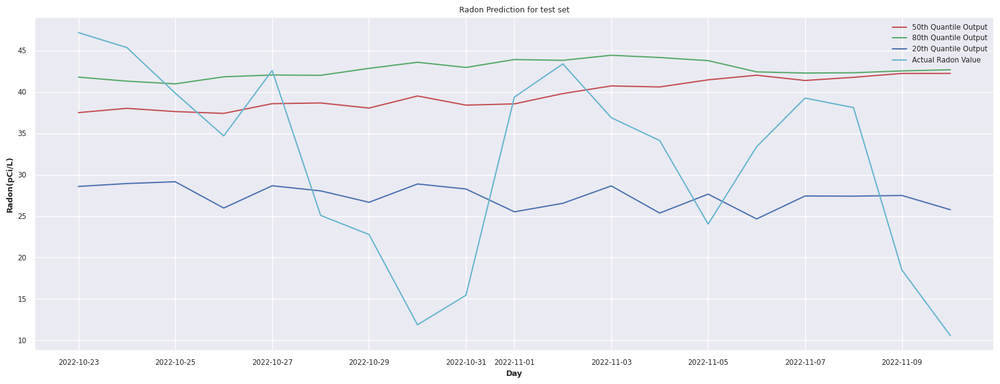

In [95]:
# plot the forecast
plt.figure(100, figsize=(20, 7))
plt.plot(dfY.index, dfY['Q50'], color='r', label='50th Quantile Output')
plt.plot(dfY.index, dfY['Q80'], color='g', label='80th Quantile Output')
plt.plot(dfY.index, dfY['Q20'], color='b', label='20th Quantile Output')
plt.plot(dfY.index, dfY['Actual'], color='c', label='Actual Radon Value')
plt.legend()
plt.title('Radon Prediction for test set')
plt.xlabel('Day')
plt.ylabel('Radon(pCi/L)')
plt.show()